
# Imports

In [2]:
from cs670 import get_csv_df
import requests

# Init AppIds

In [31]:
import requests
import time
import importlib
import cs670
importlib.reload(cs670)

cs670.save_steam_appid_df()

Data successfully saved to app_ids.csv


# Clean appid

In [2]:
import requests
import time
import importlib
import cs670
importlib.reload(cs670)

df = cs670.get_csv_df()
df.dropna()

Successfully loaded CSV from default_path.csv


,appid,name
2,216938,Pieterw test app76 ( 216938 )
3,660010,test2
4,660130,test3
38,974010,Zero spring episode 2
39,974040,BattleMore
...,...,...
237286,2369850,Dolven
237287,2772820,ButtKnight
237288,1313290,Let Them Trade
237289,2879840,Escape Simulator 2


In [5]:
import time
import pandas as pd
from tqdm import tqdm

# First, add a new column for player count if it doesn't exist
if 'player_count' not in df.columns:
    df['player_count'] = None

# Define how often to save (e.g., every 10 apps)
save_frequency = 1000
total_apps = len(df)

# Use tqdm for progress bar
for i, row in tqdm(enumerate(df.itertuples()), total=total_apps, desc="Processing apps"):
    app_id = row.appid  # Assuming column name is 'appid'
    
    # Get player count
    try:
        player_count = cs670.SteamCaller.get_current_players(app_id)
        # Update the DataFrame with the player count
        df.at[row.Index, 'player_count'] = player_count
    except Exception as e:
        print(f"Error processing app ID {app_id}: {e}")
        
    # Save the DataFrame periodically
    if (i + 1) % save_frequency == 0 or i == total_apps - 1:
        df.to_csv('app_player_counts.csv', index=False)
        print(f"Saved progress after processing {i+1}/{total_apps} apps")
    
    # Optional: add a small delay to avoid rate limiting (if needed)
    

# Final save
df.to_csv('app_player_counts_final.csv', index=False)
print("Processing complete!")

Processing apps:   0%|▎                                                            | 1000/237291 [04:53<25:12:55,  2.60it/s]

Saved progress after processing 1000/237291 apps


Processing apps:   0%|▎                                                            | 1072/237291 [06:07<22:29:29,  2.92it/s]


KeyboardInterrupt: 

# Validating steam daily concurent users

In [7]:
import requests
import time
import importlib
import cs670
importlib.reload(cs670)
# You'll need to register for a Steam API key at https://steamcommunity.com/dev/apikey


# Assuming cs670 is your class instance
# If SteamAPI is your cs670 class, use this code:

# Game IDs for The Witcher series
witcher1_id = 20900  # The Witcher: Enhanced Edition
witcher2_id = 20920  # The Witcher 2: Assassins of Kings
witcher3_id = 292030  # The Witcher 3: Wild Hunt

# Check all Witcher games
witcher1_count = cs670.SteamCaller.get_current_players(witcher1_id)
witcher2_count = cs670.SteamCaller.get_current_players(witcher2_id)
witcher3_count = cs670.SteamCaller.get_current_players(witcher3_id)

print(f"Current players for The Witcher: Enhanced Edition: {witcher1_count}")
print(f"Current players for The Witcher 2: Assassins of Kings: {witcher2_count}")
print(f"Current players for The Witcher 3: Wild Hunt: {witcher3_count}")

Current players for The Witcher: Enhanced Edition: 266
Current players for The Witcher 2: Assassins of Kings: 187
Current players for The Witcher 3: Wild Hunt: 7993


# App Details


In [26]:
import requests
import time
import importlib
import cs670
import pandas as pd
from pandas import json_normalize
importlib.reload(cs670)

# Game IDs for The Witcher series
witcher1_id = 20900  # The Witcher: Enhanced Edition
witcher2_id = 20920  # The Witcher 2: Assassins of Kings
witcher3_id = 292030  # The Witcher 3: Wild Hunt


# If get_app_details returns a dictionary:
w3_df = cs670.SteamCaller.get_app_details_df(witcher3_id)

In [27]:
w3_df

,type,name,steam_appid,required_age,is_free,dlc,detailed_description,about_the_game,short_description,supported_languages,...,screenshots,movies,recommendations,achievements,release_date,support_info,background,background_raw,content_descriptors,ratings
0,game,The Witcher 3: Wild Hunt,292030,17,False,"[355880, 378649, 370000, 370001, 370002, 37000...",<h1>DISCOVER THE STORY BEFORE THE WITCHER IV</...,"<p class=""bb_paragraph"">One of the most acclai...","You are Geralt of Rivia, mercenary monster sla...","English<strong>*</strong>, French<strong>*</st...",...,"[{'id': 0, 'path_thumbnail': 'https://shared.a...","[{'id': 256927229, 'name': 'W3NG ESRB The Witc...",{'total': 762625},"{'total': 78, 'highlighted': [{'name': 'Lilac ...","{'coming_soon': False, 'date': 'May 18, 2015'}","{'url': 'http://en.cdprojektred.com/support', ...",https://store.akamai.steamstatic.com/images/st...,https://shared.akamai.steamstatic.com/store_it...,"{'ids': [1, 5], 'notes': 'The Witcher 3: Wild ...","{'esrb': {'rating': 'm', 'descriptors': 'Blood..."


# Appid Sanitization

# Steam Spy

In [8]:
def get_steamspy_data(app_id):
    """
    Get SteamSpy data for a specific Steam app ID.
    
    Args:
        app_id: The Steam app ID (integer)
        
    Returns:
        dict: SteamSpy data for the app, or None if request failed
    """
    url = f"https://steamspy.com/api.php?request=appdetails&appid={app_id}"
    
    try:
        response = requests.get(url)
        response.raise_for_status()  # Raise exception for HTTP errors
        return response.json()
    except requests.exceptions.RequestException as e:
        print(f"Error fetching SteamSpy data for app ID {app_id}: {e}")
        return None

In [10]:
get_steamspy_data(2772820)

{'appid': 2772820,
 'name': 'ButtKnight',
 'developer': '',
 'publisher': '',
 'score_rank': '',
 'positive': 0,
 'negative': 0,
 'userscore': 0,
 'owners': '0 .. 20,000',
 'average_forever': 0,
 'average_2weeks': 0,
 'median_forever': 0,
 'median_2weeks': 0,
 'price': None,
 'initialprice': None,
 'discount': None,
 'ccu': 0,
 'languages': None,
 'genre': '',
 'tags': []}

# kaggle Dataset Exploration

## Download

In [12]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("artermiloff/steam-games-dataset")

print("Path to dataset files:", path)

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 418M/418M [01:13<00:00, 5.97MB/s]

Extracting files...


Path to dataset files: /home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2


## Set Chached fpath for steam instead of the other one I have coded

## Init df

In [21]:
import requests
import time
import importlib
import cs670
import pandas as pd
import csv
import polars as pl
import matplotlib.pyplot as plt
import seaborn as sns
importlib.reload(cs670)
fpath_cached = "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2"
new_fpath = fpath_cached + "/games_march2025_cleaned.csv"
import os
os.environ["CSV_STEAM2025"]=new_fpath
pd_df = pd.read_csv(new_fpath)
df = pd_df
df.columns

Index(['appid', 'name', 'release_date', 'required_age', 'price', 'dlc_count',
       'detailed_description', 'about_the_game', 'short_description',
       'reviews', 'header_image', 'website', 'support_url', 'support_email',
       'windows', 'mac', 'linux', 'metacritic_score', 'metacritic_url',
       'achievements', 'recommendations', 'notes', 'supported_languages',
       'full_audio_languages', 'packages', 'developers', 'publishers',
       'categories', 'genres', 'screenshots', 'movies', 'user_score',
       'score_rank', 'positive', 'negative', 'estimated_owners',
       'average_playtime_forever', 'average_playtime_2weeks',
       'median_playtime_forever', 'median_playtime_2weeks', 'discount',
       'peak_ccu', 'tags', 'pct_pos_total', 'num_reviews_total',
       'pct_pos_recent', 'num_reviews_recent'],
      dtype='object')

## cols

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import numpy as np

# Load the data
fpath_cached = "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2"
new_fpath = fpath_cached + "/games_march2025_cleaned.csv"
df = pd.read_csv(new_fpath)

In [30]:
df["website"]


0                        http://counter-strike.net/
1                              https://www.pubg.com
2                             http://www.dota2.com/
3                  https://www.rockstargames.com/V/
4                          http://rainbow6.ubi.com/
                            ...                    
89613    https://sidesaladontop.itch.io/outrun-them
89614                https://www.landsofpharaoh.com
89615                                           NaN
89616                                           NaN
89617              http://www.ragtagadventurers.com
Name: website, Length: 89618, dtype: object

In [ ]:
df["tags"]

In [ ]:
import nltk
nltk.download()  # This opens a graphical downloader

## Auto Vis

# head Counts

### Total Number of Games

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime

# Load the data
fpath_cached = "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2"
new_fpath = fpath_cached + "/games_march2025_cleaned.csv"
df = pd.read_csv(new_fpath)

# Convert release_date to datetime format
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')

# Drop rows with invalid dates
df = df.dropna(subset=['release_date'])

# Sort dataframe by release_date
df_sorted = df.sort_values('release_date')

# Create a time series of game releases
releases_by_date = df_sorted['release_date'].value_counts().sort_index().cumsum()

# Plot the cumulative sum
plt.figure(figsize=(16, 8))
sns.set_style("whitegrid")

plt.plot(releases_by_date.index, releases_by_date.values, linewidth=2.5, color='#1f77b4')

# Add title and labels
plt.title('Cumulative Number of Steam Games Released Over Time', fontsize=18)
plt.xlabel('Release Date', fontsize=14)
plt.ylabel('Cumulative Number of Games', fontsize=14)

# Format x-axis to show years
plt.xticks(fontsize=12, rotation=45)
plt.yticks(fontsize=12)

# Add grid
plt.grid(True, alpha=0.3)

# Add current total
latest_total = releases_by_date.iloc[-1]
plt.annotate(f'Total: {latest_total:,} games', 
             xy=(releases_by_date.index[-1], latest_total),
             xytext=(-100, -30), textcoords='offset points',
             fontsize=12, color='darkblue',
             arrowprops=dict(arrowstyle='->', color='darkblue'))

# Add visualization of growth rate changes
# Find time points where growth rate changed significantly
years = pd.date_range(start=releases_by_date.index.min(), 
                      end=releases_by_date.index.max(), 
                      freq='2Y')

# Ensure the plot displays all data
plt.xlim(releases_by_date.index.min(), releases_by_date.index.max())
plt.tight_layout()

# Save the figure if needed
plt.savefig('steam_games_cumulative_growth.png', dpi=300)

# Show the plot
plt.show()

#### Liniar Modeling

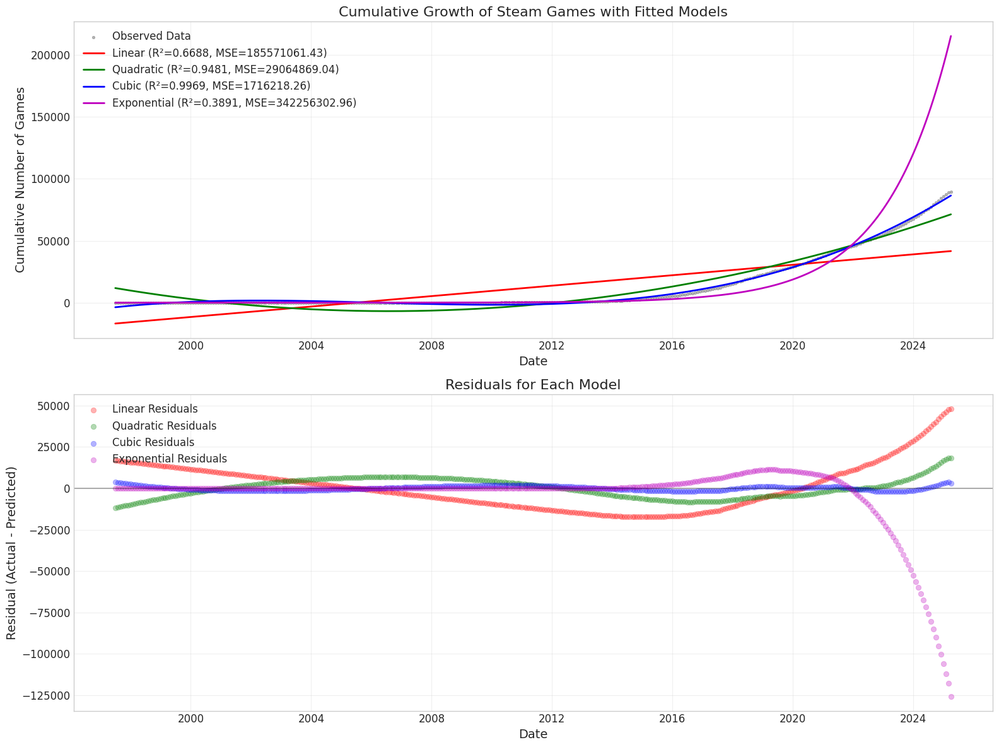


Model Performance Summary:
Linear Model:      R² = 0.6688, MSE = 185571061.43
Quadratic Model:   R² = 0.9481, MSE = 29064869.04
Cubic Model:       R² = 0.9969, MSE = 1716218.26
Exponential Model: R² = 0.3891, MSE = 342256302.96

Linear Model Coefficients:
Intercept: -16827.22
Slope: 5.7714 games per day
Estimated annual growth rate: 2106.57 games per year

Quadratic Model Coefficients:
Intercept: 11802.90
X coefficient: -11.202438
X² coefficient: 0.00168476


In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import train_test_split

# Load the data
fpath_cached = "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2"
new_fpath = fpath_cached + "/games_march2025_cleaned.csv"
df = pd.read_csv(new_fpath)

# Convert release_date to datetime format
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])88

# Create a numerical representation of dates for modeling
# Convert dates to ordinal (number of days since 1970-01-01)
df['date_ordinal'] = df['release_date'].apply(lambda x: x.toordinal())
min_date = df['date_ordinal'].min()
df['date_scaled'] = df['date_ordinal'] - min_date  # Days since first game

# Sort by date and calculate cumulative sum
df_sorted = df.sort_values('date_ordinal')
df_sorted['cumulative_count'] = range(1, len(df_sorted) + 1)

# Resample to monthly frequency for better visualization
monthly_data = pd.DataFrame({
    'date': df_sorted['release_date'],
    'count': 1
}).set_index('date').resample('M').count().reset_index()

monthly_data['cumulative_count'] = monthly_data['count'].cumsum()
monthly_data['date_ordinal'] = monthly_data['date'].apply(lambda x: x.toordinal())
monthly_data['date_scaled'] = monthly_data['date_ordinal'] - min_date

# Create feature matrix X and target vector y
X = monthly_data[['date_scaled']].values
y = monthly_data[['cumulative_count']].values

# Split data for training and testing
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Linear model
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)
y_linear_pred = linear_model.predict(X)
y_linear_test_pred = linear_model.predict(X_test)
linear_r2 = r2_score(y_test, y_linear_test_pred)
linear_mse = mean_squared_error(y_test, y_linear_test_pred)

# Quadratic model
poly_features_2 = PolynomialFeatures(degree=2)
X_poly_2 = poly_features_2.fit_transform(X)
X_train_poly_2 = poly_features_2.transform(X_train)
X_test_poly_2 = poly_features_2.transform(X_test)

quad_model = LinearRegression()
quad_model.fit(X_train_poly_2, y_train)
y_quad_pred = quad_model.predict(X_poly_2)
y_quad_test_pred = quad_model.predict(X_test_poly_2)
quad_r2 = r2_score(y_test, y_quad_test_pred)
quad_mse = mean_squared_error(y_test, y_quad_test_pred)

# Cubic model
poly_features_3 = PolynomialFeatures(degree=3)
X_poly_3 = poly_features_3.fit_transform(X)
X_train_poly_3 = poly_features_3.transform(X_train)
X_test_poly_3 = poly_features_3.transform(X_test)

cubic_model = LinearRegression()
cubic_model.fit(X_train_poly_3, y_train)
y_cubic_pred = cubic_model.predict(X_poly_3)
y_cubic_test_pred = cubic_model.predict(X_test_poly_3)
cubic_r2 = r2_score(y_test, y_cubic_test_pred)
cubic_mse = mean_squared_error(y_test, y_cubic_test_pred)

# Exponential model (log transform)
log_y = np.log(y)
log_model = LinearRegression()
log_model.fit(X_train, np.log(y_train))
y_log_pred = np.exp(log_model.predict(X))
y_log_test_pred = np.exp(log_model.predict(X_test))
log_r2 = r2_score(y_test, y_log_test_pred)
log_mse = mean_squared_error(y_test, y_log_test_pred)

# Plotting
plt.figure(figsize=(16, 12))
plt.subplot(2, 1, 1)

# Plot actual data
plt.scatter(monthly_data['date'], monthly_data['cumulative_count'], 
            s=10, alpha=0.6, color='gray', label='Observed Data')

# Plot the models
plt.plot(monthly_data['date'], y_linear_pred, 'r-', 
         linewidth=2, label=f'Linear (R²={linear_r2:.4f}, MSE={linear_mse:.2f})')
plt.plot(monthly_data['date'], y_quad_pred, 'g-', 
         linewidth=2, label=f'Quadratic (R²={quad_r2:.4f}, MSE={quad_mse:.2f})')
plt.plot(monthly_data['date'], y_cubic_pred, 'b-', 
         linewidth=2, label=f'Cubic (R²={cubic_r2:.4f}, MSE={cubic_mse:.2f})')
plt.plot(monthly_data['date'], y_log_pred, 'm-', 
         linewidth=2, label=f'Exponential (R²={log_r2:.4f}, MSE={log_mse:.2f})')

plt.title('Cumulative Growth of Steam Games with Fitted Models', fontsize=16)
plt.ylabel('Cumulative Number of Games', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.grid(True, alpha=0.3)

# Subplot for residuals
plt.subplot(2, 1, 2)
plt.scatter(monthly_data['date'], y - y_linear_pred, color='r', alpha=0.3, label='Linear Residuals')
plt.scatter(monthly_data['date'], y - y_quad_pred, color='g', alpha=0.3, label='Quadratic Residuals')
plt.scatter(monthly_data['date'], y - y_cubic_pred, color='b', alpha=0.3, label='Cubic Residuals')
plt.scatter(monthly_data['date'], y - y_log_pred, color='m', alpha=0.3, label='Exponential Residuals')
plt.axhline(y=0, color='black', linestyle='-', alpha=0.3)
plt.title('Residuals for Each Model', fontsize=16)
plt.ylabel('Residual (Actual - Predicted)', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('steam_games_growth_models.png', dpi=300)
plt.show()

# Print summary statistics
print("\nModel Performance Summary:")
print(f"Linear Model:      R² = {linear_r2:.4f}, MSE = {linear_mse:.2f}")
print(f"Quadratic Model:   R² = {quad_r2:.4f}, MSE = {quad_mse:.2f}")
print(f"Cubic Model:       R² = {cubic_r2:.4f}, MSE = {cubic_mse:.2f}")
print(f"Exponential Model: R² = {log_r2:.4f}, MSE = {log_mse:.2f}")

# Estimate coefficients for interpretability
print("\nLinear Model Coefficients:")
print(f"Intercept: {linear_model.intercept_[0]:.2f}")
print(f"Slope: {linear_model.coef_[0][0]:.4f} games per day")
print(f"Estimated annual growth rate: {linear_model.coef_[0][0] * 365:.2f} games per year")

# For quadratic model
print("\nQuadratic Model Coefficients:")
print(f"Intercept: {quad_model.intercept_[0]:.2f}")
print(f"X coefficient: {quad_model.coef_[0][1]:.6f}")
print(f"X² coefficient: {quad_model.coef_[0][2]:.8f}")

#### Games total: end of 2025 prediction

Cubic Model Coefficients:
Intercept: -3389.1360
X coefficient: 6.74478302
X² coefficient: -0.002708040567
X³ coefficient: 0.0000002874125258

Prediction for January 1st, 2026:
Predicted total number of games: 97,679
Current number of games (as of today): 85,570
Last recorded number in dataset (as of 2025-03-31): 89,618
Projected increase from today to Jan 1, 2026: 12,109 games


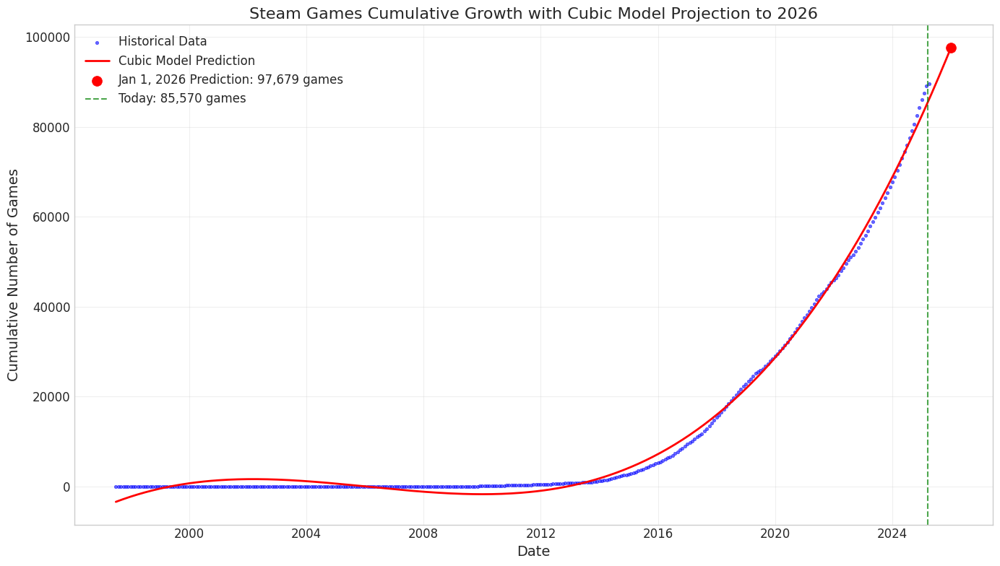

In [19]:
8

#### How much is being used

/tmp/ipykernel_24445/722633609.py:39: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  }).set_index('date').resample('M').sum().reset_index()
/tmp/ipykernel_24445/722633609.py:92: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  future_months = pd.date_range(start=monthly_data['date'].min(), end=future_date, freq='M')


Cubic Model Projections for January 1st, 2026:
Total games: 97,679
Games with <10 reviews: 37,029 (37.9% of total)
Games with <5 reviews: 37,029 (37.9% of total)

Current Estimates (March 19, 2025):
Total games: 85,570
Games with <10 reviews: 31,950 (37.3% of total)
Games with <5 reviews: 31,950 (37.3% of total)


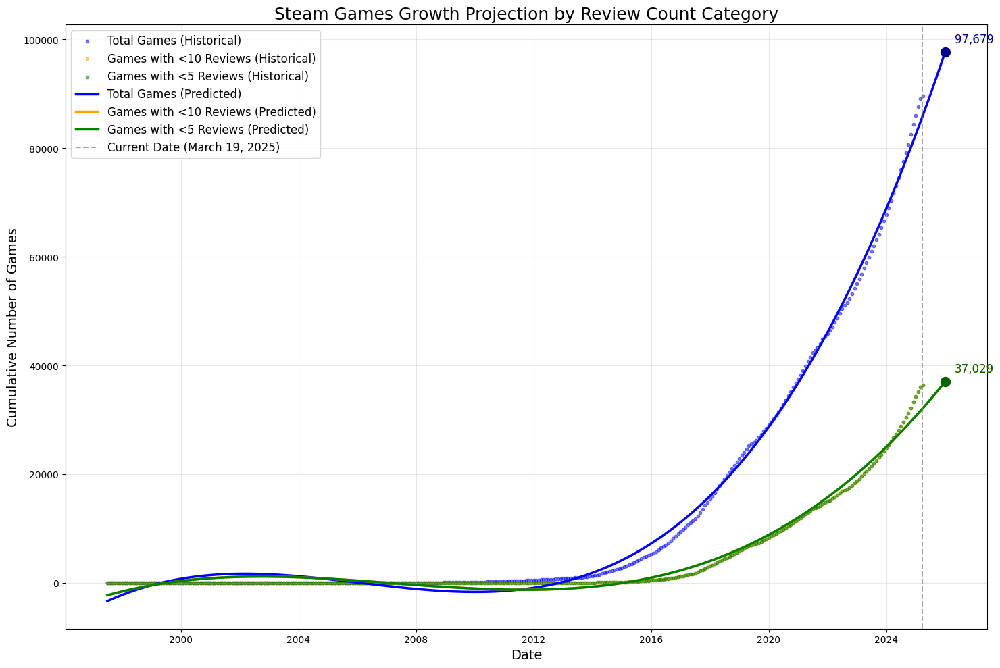

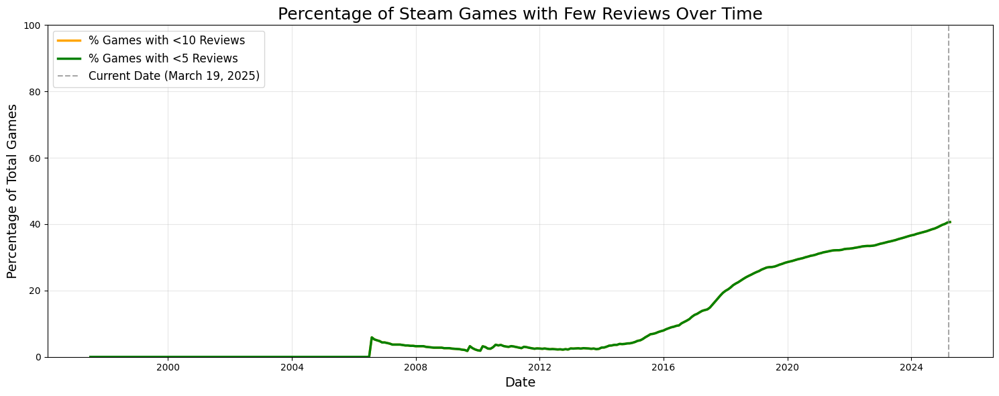

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score

# Load the data
fpath_cached = "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2"
new_fpath = fpath_cached + "/games_march2025_cleaned.csv"
df = pd.read_csv(new_fpath)

# Convert release_date to datetime format
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Create features for games with fewer than 10 and 5 reviews
df['less_than_10_reviews'] = df['num_reviews_total'] < 10
df['less_than_5_reviews'] = df['num_reviews_total'] < 5

# Create a numerical representation of dates for modeling
df['date_ordinal'] = df['release_date'].apply(lambda x: x.toordinal())
min_date = df['date_ordinal'].min()
df['date_scaled'] = df['date_ordinal'] - min_date  # Days since first game

# Sort by date and calculate cumulative sums
df_sorted = df.sort_values('date_ordinal')
df_sorted['cumulative_count'] = range(1, len(df_sorted) + 1)
df_sorted['cumulative_lt10'] = df_sorted['less_than_10_reviews'].cumsum()
df_sorted['cumulative_lt5'] = df_sorted['less_than_5_reviews'].cumsum()

# Resample to monthly frequency for modeling and visualization
monthly_data = pd.DataFrame({
    'date': df_sorted['release_date'],
    'count': 1,
    'lt10': df_sorted['less_than_10_reviews'],
    'lt5': df_sorted['less_than_5_reviews']
}).set_index('date').resample('M').sum().reset_index()

monthly_data['cumulative_count'] = monthly_data['count'].cumsum()
monthly_data['cumulative_lt10'] = monthly_data['lt10'].cumsum()
monthly_data['cumulative_lt5'] = monthly_data['lt5'].cumsum()
monthly_data['date_ordinal'] = monthly_data['date'].apply(lambda x: x.toordinal())
monthly_data['date_scaled'] = monthly_data['date_ordinal'] - min_date

# Create feature matrix X and target vector y for total games
X = monthly_data[['date_scaled']].values
y = monthly_data[['cumulative_count']].values

# Fit cubic model for total games
poly_features_3 = PolynomialFeatures(degree=3)
X_poly_3 = poly_features_3.fit_transform(X)

cubic_model = LinearRegression()
cubic_model.fit(X_poly_3, y)

# Fit cubic models for games with <10 and <5 reviews
y_lt10 = monthly_data[['cumulative_lt10']].values
cubic_model_lt10 = LinearRegression()
cubic_model_lt10.fit(X_poly_3, y_lt10)

y_lt5 = monthly_data[['cumulative_lt5']].values
cubic_model_lt5 = LinearRegression()
cubic_model_lt5.fit(X_poly_3, y_lt5)

# Create future date (January 1st, 2026)
future_date = datetime(2026, 1, 1)
future_ordinal = future_date.toordinal()
future_scaled = future_ordinal - min_date

# Transform future date for prediction
future_X = np.array([[future_scaled]])
future_X_poly = poly_features_3.transform(future_X)

# Make predictions for January 1st, 2026
predicted_games_total = cubic_model.predict(future_X_poly)[0][0]
predicted_games_lt10 = cubic_model_lt10.predict(future_X_poly)[0][0]
predicted_games_lt5 = cubic_model_lt5.predict(future_X_poly)[0][0]

# Get current date's values for comparison
current_date = datetime.now()
current_ordinal = current_date.toordinal()
current_scaled = current_ordinal - min_date
current_X = np.array([[current_scaled]])
current_X_poly = poly_features_3.transform(current_X)
current_games_total = cubic_model.predict(current_X_poly)[0][0]
current_games_lt10 = cubic_model_lt10.predict(current_X_poly)[0][0]
current_games_lt5 = cubic_model_lt5.predict(current_X_poly)[0][0]

# Create a visualization showing historical data and projections
future_months = pd.date_range(start=monthly_data['date'].min(), end=future_date, freq='M')
future_scaled_values = [(date.toordinal() - min_date) for date in future_months]
future_X_array = np.array([[x] for x in future_scaled_values])
future_X_poly_array = poly_features_3.transform(future_X_array)

# Predictions for all categories
future_predictions_total = cubic_model.predict(future_X_poly_array)
future_predictions_lt10 = cubic_model_lt10.predict(future_X_poly_array)
future_predictions_lt5 = cubic_model_lt5.predict(future_X_poly_array)

# Create dataframe for plotting
future_df = pd.DataFrame({
    'date': future_months,
    'predicted_total': [val[0] for val in future_predictions_total],
    'predicted_lt10': [val[0] for val in future_predictions_lt10],
    'predicted_lt5': [val[0] for val in future_predictions_lt5]
})

# Plot
plt.figure(figsize=(15, 10))

# Historical data
plt.scatter(monthly_data['date'], monthly_data['cumulative_count'], 
            s=10, alpha=0.5, color='blue', label='Total Games (Historical)')
plt.scatter(monthly_data['date'], monthly_data['cumulative_lt10'], 
            s=10, alpha=0.5, color='orange', label='Games with <10 Reviews (Historical)')
plt.scatter(monthly_data['date'], monthly_data['cumulative_lt5'], 
            s=10, alpha=0.5, color='green', label='Games with <5 Reviews (Historical)')

# Predictions
plt.plot(future_df['date'], future_df['predicted_total'], 'b-', 
         linewidth=2.5, label='Total Games (Predicted)')
plt.plot(future_df['date'], future_df['predicted_lt10'], 'orange', 
         linewidth=2.5, label='Games with <10 Reviews (Predicted)')
plt.plot(future_df['date'], future_df['predicted_lt5'], 'g-', 
         linewidth=2.5, label='Games with <5 Reviews (Predicted)')

# Highlight the prediction points for Jan 1, 2026
plt.scatter([future_date], [predicted_games_total], color='darkblue', s=100, zorder=5)
plt.scatter([future_date], [predicted_games_lt10], color='darkorange', s=100, zorder=5)
plt.scatter([future_date], [predicted_games_lt5], color='darkgreen', s=100, zorder=5)

# Add text annotations for the predictions
plt.annotate(f'{int(predicted_games_total):,}', 
             xy=(future_date, predicted_games_total),
             xytext=(10, 10), textcoords='offset points',
             fontsize=12, color='darkblue')
plt.annotate(f'{int(predicted_games_lt10):,}', 
             xy=(future_date, predicted_games_lt10),
             xytext=(10, 10), textcoords='offset points',
             fontsize=12, color='darkorange')
plt.annotate(f'{int(predicted_games_lt5):,}', 
             xy=(future_date, predicted_games_lt5),
             xytext=(10, 10), textcoords='offset points',
             fontsize=12, color='darkgreen')

# Mark current date
plt.axvline(x=current_date, color='gray', linestyle='--', alpha=0.7, 
            label=f'Current Date (March 19, 2025)')

# Format the plot
plt.title('Steam Games Growth Projection by Review Count Category', fontsize=18)
plt.ylabel('Cumulative Number of Games', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()

# Print statistics and projections
print(f"Cubic Model Projections for January 1st, 2026:")
print(f"Total games: {int(predicted_games_total):,}")
print(f"Games with <10 reviews: {int(predicted_games_lt10):,} ({predicted_games_lt10/predicted_games_total*100:.1f}% of total)")
print(f"Games with <5 reviews: {int(predicted_games_lt5):,} ({predicted_games_lt5/predicted_games_total*100:.1f}% of total)")

print(f"\nCurrent Estimates (March 19, 2025):")
print(f"Total games: {int(current_games_total):,}")
print(f"Games with <10 reviews: {int(current_games_lt10):,} ({current_games_lt10/current_games_total*100:.1f}% of total)")
print(f"Games with <5 reviews: {int(current_games_lt5):,} ({current_games_lt5/current_games_total*100:.1f}% of total)")

# Calculate percentages over time
monthly_data['pct_lt10'] = (monthly_data['cumulative_lt10'] / monthly_data['cumulative_count']) * 100
monthly_data['pct_lt5'] = (monthly_data['cumulative_lt5'] / monthly_data['cumulative_count']) * 100

# Second plot for percentages
plt.figure(figsize=(15, 6))
plt.plot(monthly_data['date'], monthly_data['pct_lt10'], 'orange', 
         linewidth=2.5, label='% Games with <10 Reviews')
plt.plot(monthly_data['date'], monthly_data['pct_lt5'], 'g-', 
         linewidth=2.5, label='% Games with <5 Reviews')

plt.axvline(x=current_date, color='gray', linestyle='--', alpha=0.7, 
            label=f'Current Date (March 19, 2025)')

plt.title('Percentage of Steam Games with Few Reviews Over Time', fontsize=18)
plt.ylabel('Percentage of Total Games', fontsize=14)
plt.xlabel('Date', fontsize=14)
plt.ylim(0, 100)
plt.legend(loc='upper left', fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()

plt.savefig('steam_games_projection_by_reviews.png', dpi=300)
plt.show()

#### More informed desition of bounds

Before cleaning:
Infinities in release_date_numeric: 0
NaNs in release_date_numeric: 0
Infinities in log_reviews: 36419
NaNs in log_reviews: 0

After cleaning: 53199 rows remain

Cluster Analysis (KMeans):
Cluster 1: 18432 games (34.6%)
  - Release years: 2020 to 2025 (avg: 2022.7)
  - Reviews: median=22, Q1=14, Q3=37
  - Review range: 10 to 85
Cluster 2: 6862 games (12.9%)
  - Release years: 1997 to 2019 (avg: 2015.6)
  - Reviews: median=318, Q1=172, Q3=689
  - Review range: 33 to 20821
Cluster 3: 4271 games (8.0%)
  - Release years: 2004 to 2025 (avg: 2019.5)
  - Reviews: median=5357, Q1=2722, Q3=14334
  - Review range: 1066 to 8632939
Cluster 4: 10207 games (19.2%)
  - Release years: 2019 to 2025 (avg: 2022.2)
  - Reviews: median=222, Q1=129, Q3=479
  - Review range: 73 to 2495
Cluster 5: 13427 games (25.2%)
  - Release years: 2009 to 2020 (avg: 2017.7)
  - Reviews: median=30, Q1=17, Q3=53
  - Review range: 10 to 152

Percentage of games by review count:
0 reviews: 0 games (0.0%)
1-

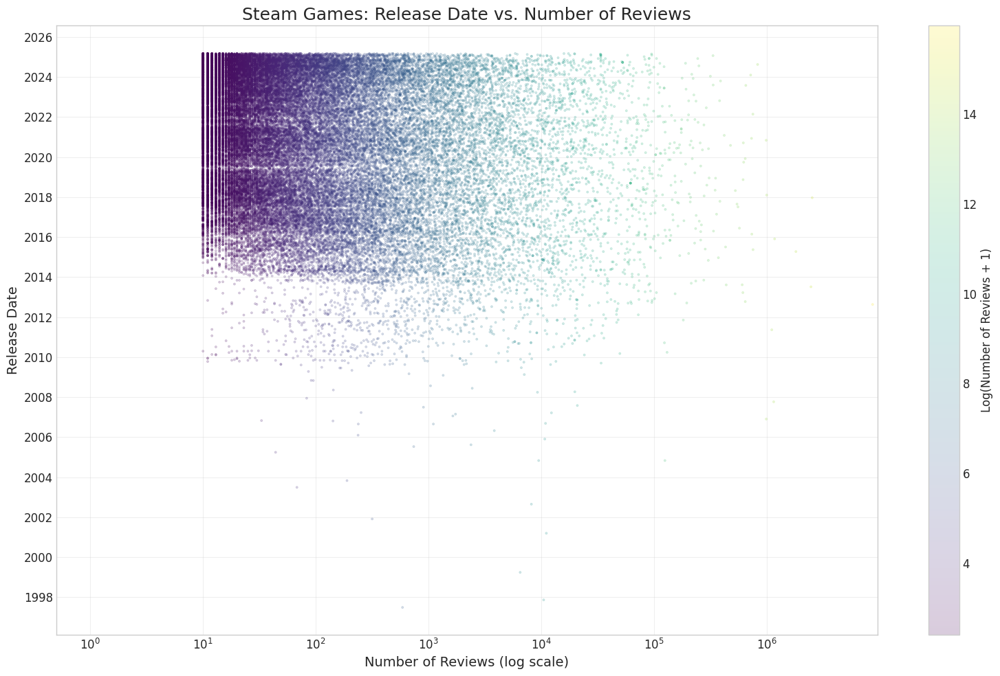

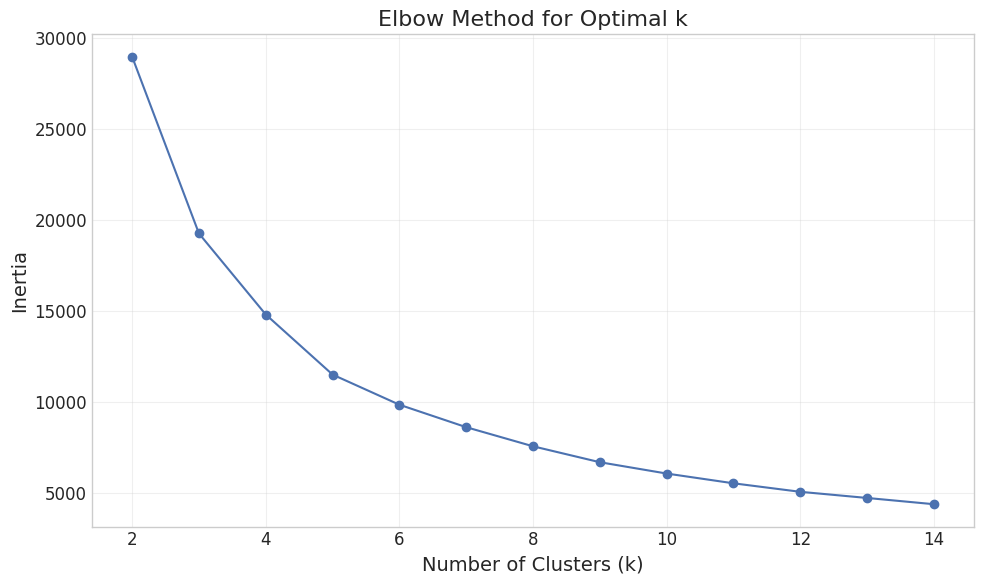

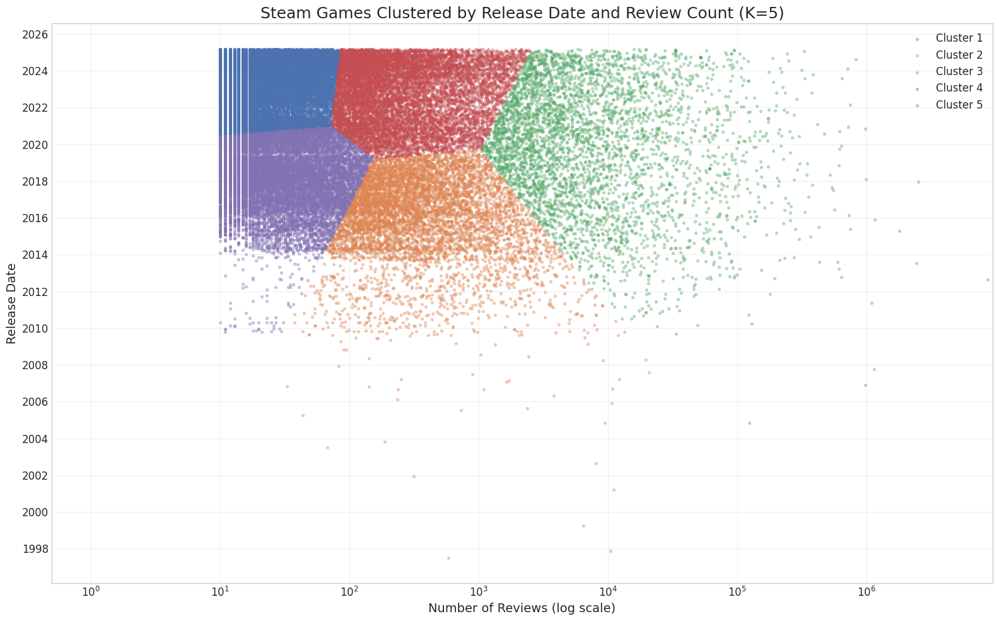

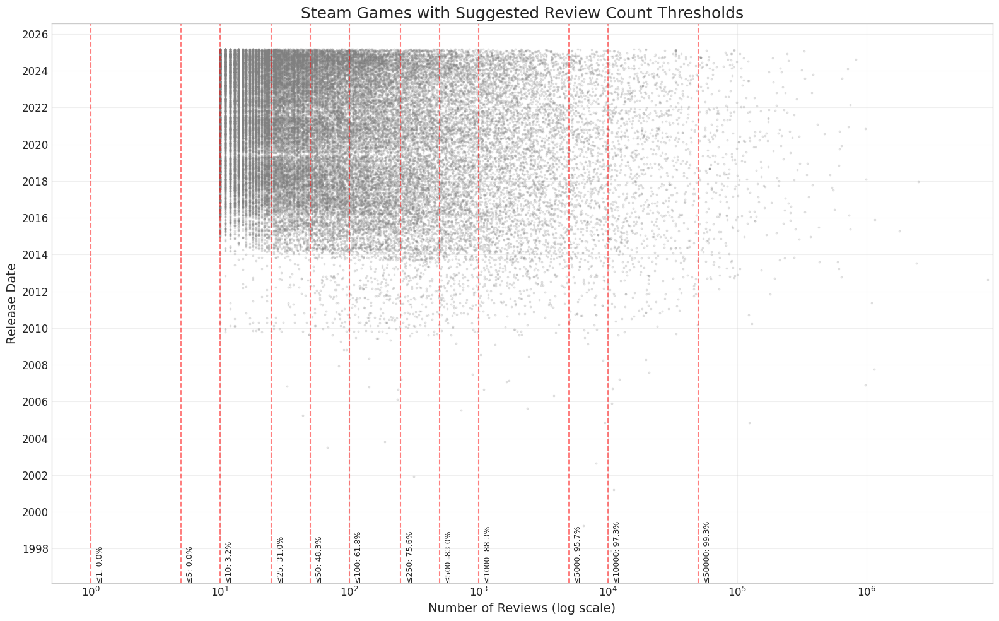

In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans, DBSCAN
from sklearn.preprocessing import StandardScaler, RobustScaler
from datetime import datetime
import matplotlib.dates as mdates
from sklearn.metrics import silhouette_score

# Load the data
fpath_cached = "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2"
new_fpath = fpath_cached + "/games_march2025_cleaned.csv"
df = pd.read_csv(new_fpath)

# Convert release_date to datetime format
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Create a copy of the dataframe with just the columns we need
plot_df = df[['release_date', 'num_reviews_total']].copy()
plot_df['num_reviews_total'] = plot_df['num_reviews_total'].fillna(0)

# Convert to numeric for clustering
plot_df['release_date_numeric'] = plot_df['release_date'].apply(lambda x: x.toordinal())

# Log-transform the review counts to better visualize the distribution
# Add 1 to handle zeros
plot_df['log_reviews'] = np.log1p(plot_df['num_reviews_total'])

# Create the scatter plot
plt.figure(figsize=(16, 10))

# Create the main scatter plot with transparency to show density
scatter = plt.scatter(plot_df['num_reviews_total'], 
                      plot_df['release_date'],
                      alpha=0.2, s=5, c=plot_df['log_reviews'], cmap='viridis')

# Use log scale for x-axis due to the skewed distribution of reviews
plt.xscale('log')

# Add small value to handle zeros
plt.xlim(0.5, plot_df['num_reviews_total'].max()*1.1)

# Format the y-axis as dates
plt.gca().yaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.gca().yaxis.set_major_locator(mdates.YearLocator(2))  # Show every 2 years

# Add labels and title
plt.xlabel('Number of Reviews (log scale)', fontsize=14)
plt.ylabel('Release Date', fontsize=14)
plt.title('Steam Games: Release Date vs. Number of Reviews', fontsize=18)

# Add a colorbar to show the log review count
cbar = plt.colorbar(scatter)
cbar.set_label('Log(Number of Reviews + 1)', fontsize=12)

# Add grid for better readability
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('steam_games_review_date_scatter.png', dpi=300)

# Prepare data for clustering
# Check for and remove any infinities or NaNs
X = plot_df[['release_date_numeric', 'log_reviews']].copy()

# Print info about any problematic values before cleaning
print("Before cleaning:")
print(f"Infinities in release_date_numeric: {np.isinf(X['release_date_numeric']).sum()}")
print(f"NaNs in release_date_numeric: {np.isnan(X['release_date_numeric']).sum()}")
print(f"Infinities in log_reviews: {np.isinf(X['log_reviews']).sum()}")
print(f"NaNs in log_reviews: {np.isnan(X['log_reviews']).sum()}")

# Replace infinities with NaNs and then drop rows with NaNs
X = X.replace([np.inf, -np.inf], np.nan).dropna()
print(f"\nAfter cleaning: {len(X)} rows remain")

# Use RobustScaler which is less sensitive to outliers
scaler = RobustScaler()
X_scaled = scaler.fit_transform(X)

# Determine a good number of clusters using the elbow method
inertias = []
K_range = range(2, 15)
for k in K_range:
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(X_scaled)
    inertias.append(kmeans.inertia_)

# Plot the elbow curve
plt.figure(figsize=(10, 6))
plt.plot(K_range, inertias, 'o-')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('steam_games_kmeans_elbow.png', dpi=300)

# Apply KMeans clustering with k=5 (or choose based on the elbow plot)
k = 5  # You can adjust this based on the elbow plot
kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
labels = kmeans.fit_predict(X_scaled)

# Add the cluster labels back to our dataframe
X['cluster'] = labels
plot_df = plot_df.reset_index().merge(X.reset_index(), left_on='index', right_on='index', how='inner')

# Create a new figure for the clustered plot
plt.figure(figsize=(16, 10))

# Plot each cluster with a different color
for cluster_id in range(k):
    cluster_data = plot_df[plot_df['cluster'] == cluster_id]
    plt.scatter(cluster_data['num_reviews_total'], 
                cluster_data['release_date'],
                alpha=0.4, s=10, label=f'Cluster {cluster_id+1}')

# Use log scale for x-axis
plt.xscale('log')
plt.xlim(0.5, plot_df['num_reviews_total'].max()*1.1)

# Format the y-axis as dates
plt.gca().yaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.gca().yaxis.set_major_locator(mdates.YearLocator(2))  # Show every 2 years

# Add labels and title
plt.xlabel('Number of Reviews (log scale)', fontsize=14)
plt.ylabel('Release Date', fontsize=14)
plt.title(f'Steam Games Clustered by Release Date and Review Count (K={k})', fontsize=18)
plt.legend(fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('steam_games_kmeans_clusters.png', dpi=300)

# Analyze the clusters
print("\nCluster Analysis (KMeans):")
for cluster_id in range(k):
    cluster_data = plot_df[plot_df['cluster'] == cluster_id]
    min_reviews = cluster_data['num_reviews_total'].min()
    max_reviews = cluster_data['num_reviews_total'].max()
    median_reviews = cluster_data['num_reviews_total'].median()
    avg_year = cluster_data['release_date'].dt.year.mean()
    size = len(cluster_data)
    pct = size / len(plot_df) * 100
    
    # Calculate review range thresholds for this cluster
    q1 = cluster_data['num_reviews_total'].quantile(0.25)
    q3 = cluster_data['num_reviews_total'].quantile(0.75)
    min_year = cluster_data['release_date'].min().year
    max_year = cluster_data['release_date'].max().year
    
    print(f"Cluster {cluster_id+1}: {size} games ({pct:.1f}%)")
    print(f"  - Release years: {min_year} to {max_year} (avg: {avg_year:.1f})")
    print(f"  - Reviews: median={median_reviews:.0f}, Q1={q1:.0f}, Q3={q3:.0f}")
    print(f"  - Review range: {min_reviews:.0f} to {max_reviews:.0f}")

# Extract meaningful thresholds from the clusters
thresholds = []
for cluster_id in range(k):
    cluster_data = plot_df[plot_df['cluster'] == cluster_id]
    thresholds.extend([
        cluster_data['num_reviews_total'].min(),
        cluster_data['num_reviews_total'].quantile(0.25),
        cluster_data['num_reviews_total'].median(),
        cluster_data['num_reviews_total'].quantile(0.75),
        cluster_data['num_reviews_total'].max()
    ])

# Round to nice numbers and add some standard thresholds
thresholds = sorted(list(set([int(np.round(t)) for t in thresholds])))
standard_thresholds = [0, 1, 5, 10, 20, 50, 100, 250, 500, 1000, 5000, 10000, 50000, 100000]
thresholds.extend(standard_thresholds)
thresholds = sorted(list(set(thresholds)))  # Remove duplicates and sort

# Create a new figure for suggested thresholds
plt.figure(figsize=(16, 10))

# Plot all games
plt.scatter(plot_df['num_reviews_total'], 
            plot_df['release_date'],
            alpha=0.2, s=5, c='gray')

# Use log scale for x-axis
plt.xscale('log')
plt.xlim(0.5, plot_df['num_reviews_total'].max()*1.1)

# Format the y-axis as dates
plt.gca().yaxis.set_major_formatter(mdates.DateFormatter('%Y'))
plt.gca().yaxis.set_major_locator(mdates.YearLocator(2))

# Add labels and title
plt.xlabel('Number of Reviews (log scale)', fontsize=14)
plt.ylabel('Release Date', fontsize=14)
plt.title('Steam Games with Suggested Review Count Thresholds', fontsize=18)

# Filter thresholds to show a reasonable number on the plot
display_thresholds = [1, 5, 10, 25, 50, 100, 250, 500, 1000, 5000, 10000, 50000]
display_thresholds = [t for t in display_thresholds if t <= plot_df['num_reviews_total'].max()]

# Add vertical lines for selected thresholds
for threshold in display_thresholds:
    if threshold > 0:  # Skip 0 as it won't show on log scale
        plt.axvline(x=threshold, color='r', linestyle='--', alpha=0.5)
        pct = len(plot_df[plot_df['num_reviews_total'] <= threshold]) / len(plot_df) * 100
        plt.text(threshold*1.1, plt.ylim()[0], 
                 f'≤{threshold}: {pct:.1f}%', 
                 fontsize=9, rotation=90, verticalalignment='bottom')

plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.savefig('steam_games_review_thresholds.png', dpi=300)

# Calculate the percentage of games in each review count bracket
print("\nPercentage of games by review count:")
brackets = [(0, 0), (1, 4), (5, 9), (10, 24), (25, 49), (50, 99), (100, 499), (500, 999), (1000, 9999), (10000, float('inf'))]
for low, high in brackets:
    if low == 0 and high == 0:
        count = len(plot_df[plot_df['num_reviews_total'] == 0])
        pct = count / len(plot_df) * 100
        print(f"0 reviews: {count} games ({pct:.1f}%)")
    else:
        count = len(plot_df[(plot_df['num_reviews_total'] >= low) & (plot_df['num_reviews_total'] <= high)])
        pct = count / len(plot_df) * 100
        print(f"{low}-{high} reviews: {count} games ({pct:.1f}%)")

plt.show()

#### Developers

Parsing tags and developers...

Top 20 tags:
Indie: 25971
Singleplayer: 25227
Adventure: 19426
Action: 18920
Casual: 17651
2D: 12854
Simulation: 10576
Strategy: 9716
Atmospheric: 9417
RPG: 9157
Puzzle: 8340
Story Rich: 8188
3D: 7569
Exploration: 7008
Pixel Graphics: 6873
Cute: 6693
First-Person: 6558
Multiplayer: 6543
Colorful: 6446
Fantasy: 5806

Top 20 developers:
Laush Dmitriy Sergeevich: 123
Choice of Games: 118
KOEI TECMO GAMES CO., LTD.: 104
Sokpop Collective: 94
Square Enix: 81
Dnovel: 81
Gamesforgames: 80
Hosted Games: 73
Ripknot Systems: 61
Tero Lunkka: 59
Creobit: 58
RewindApp: 55
EpiXR Games UG: 53
LTZinc: 52
Cyber Keks: 49
Dharker Studios: 47
GentleDriver: 47
Winged Cloud: 46
Octo Games: 43
Kairosoft Co.,Ltd: 42

Total number of features for PCA: 58

Missing values in each column:
score_rank    51474
dtype: int64


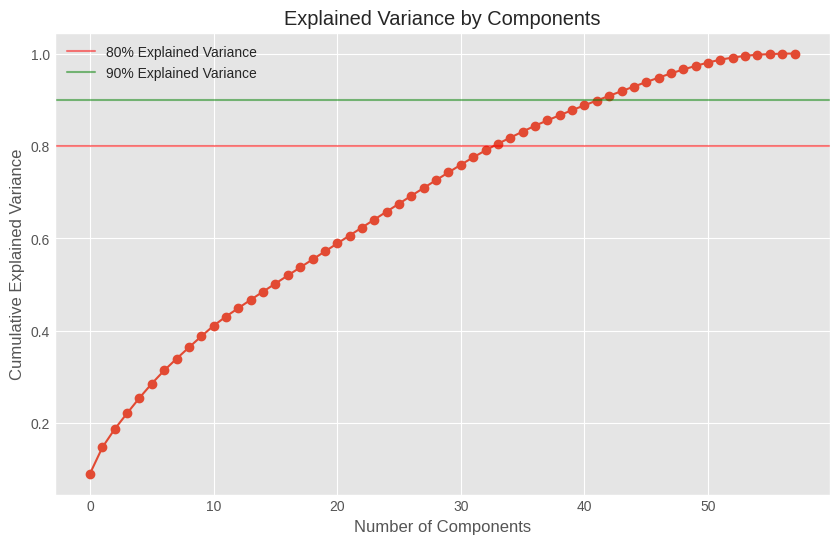

Number of components explaining 80% variance: 34

Explained variance ratio by component:
PC1: 0.0908 (9.08%)
PC2: 0.0568 (5.68%)
PC3: 0.0397 (3.97%)
PC4: 0.0341 (3.41%)
PC5: 0.0333 (3.33%)
PC6: 0.0310 (3.10%)
PC7: 0.0284 (2.84%)
PC8: 0.0254 (2.54%)
PC9: 0.0244 (2.44%)
PC10: 0.0240 (2.40%)
Total variance explained: 38.79%

Top 10 feature loadings for first 2 components:

PC1 (positive):
num_reviews_total     0.423213
positive              0.418508
recommendations       0.398656
negative              0.387318
num_reviews_recent    0.380748
peak_ccu              0.371645
log_revenue           0.131020
pct_pos_recent        0.098844
metacritic_score      0.077794
price                 0.065610
Name: PC1, dtype: float64

PC1 (negative):
release_year                   -0.024173
tag_Casual                     -0.013157
tag_Indie                      -0.006042
dev_Cyber Keks                 -0.004042
dev_Laush Dmitriy Sergeevich   -0.003733
dev_GentleDriver               -0.003707
dev_Tero Lun

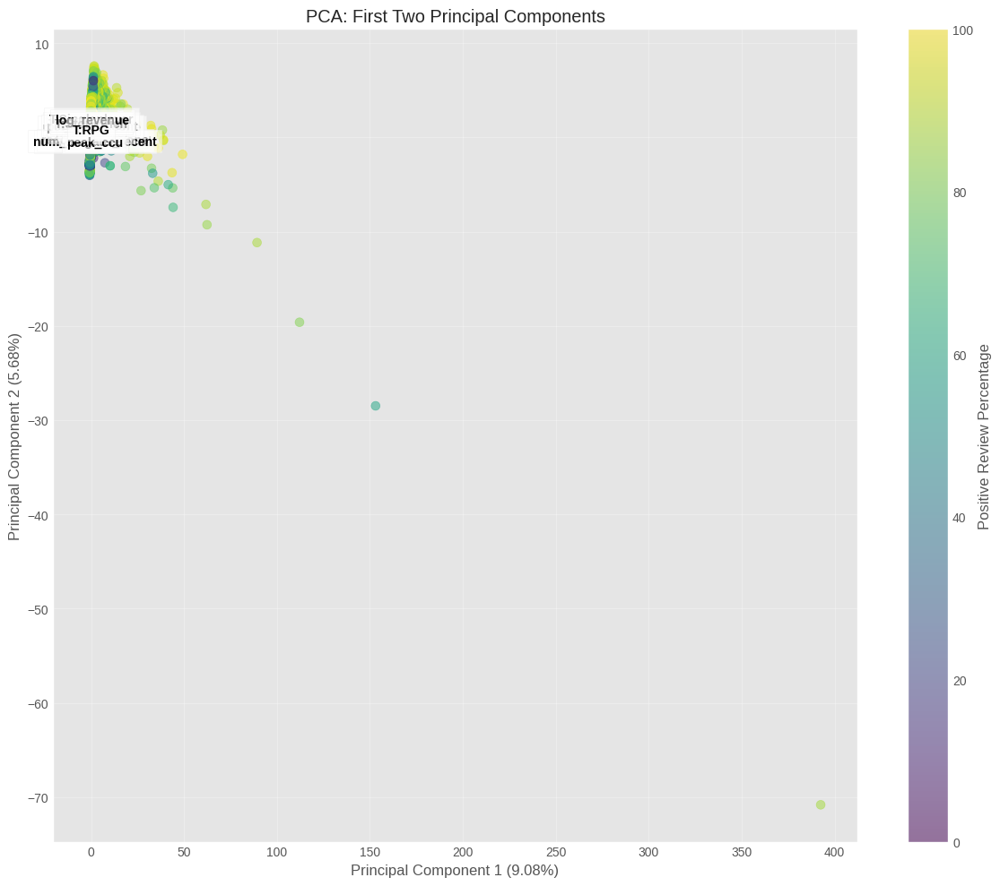

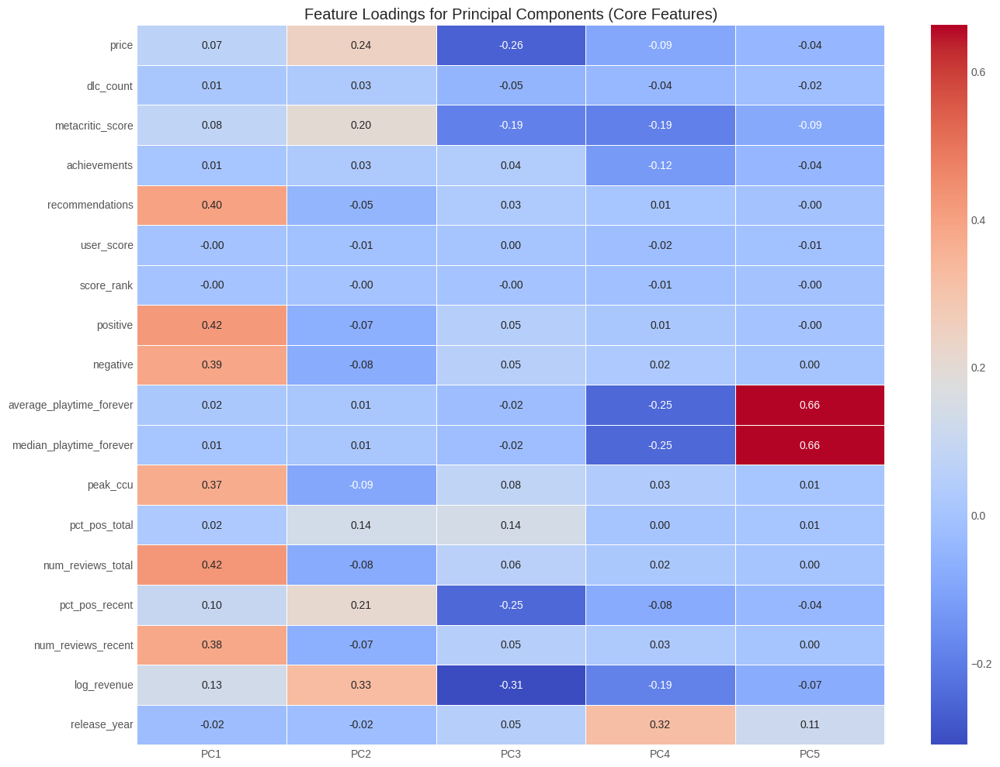

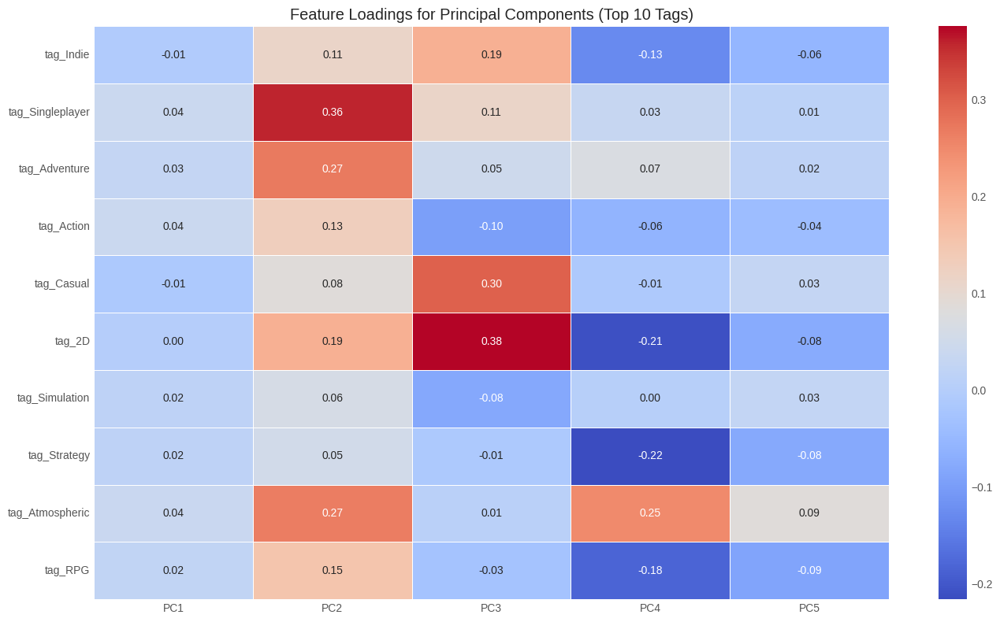

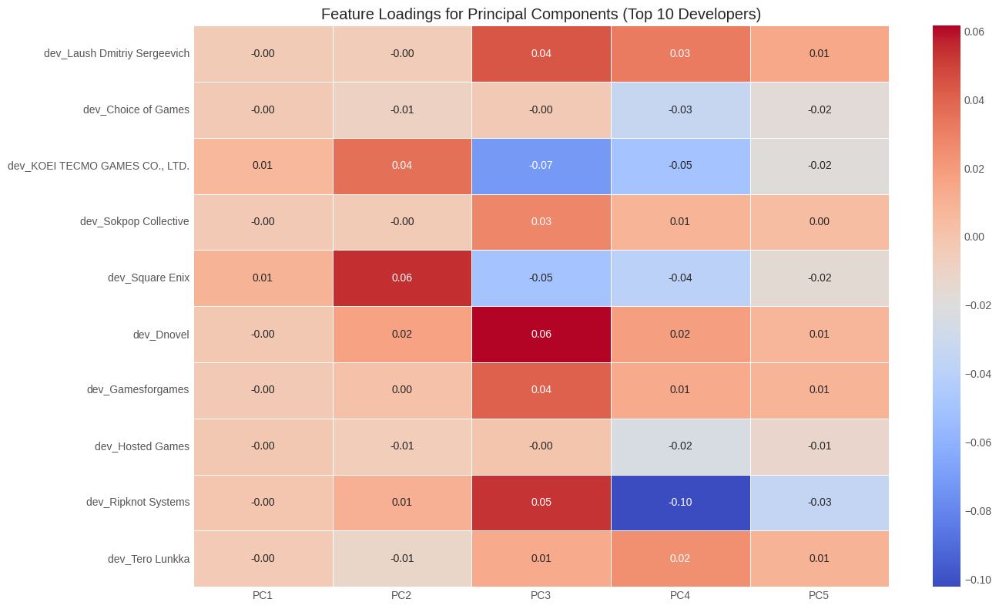


Top 5 games with highest values in PC1:
                              name         PC1
0                 Counter-Strike 2  392.443156
1              PUBG: BATTLEGROUNDS  153.031566
2                           Dota 2  112.122020
3        Grand Theft Auto V Legacy   89.255591
4  Tom Clancy's Rainbow Six® Siege   62.357088

Top 5 games with lowest values in PC1:
                       name       PC1
50254            Hot Milf 8 -0.785275
47636            Honey Milf -0.759245
48935            Hot Milf 3 -0.758173
39561   Hentai Monster Quiz -0.756554
50473  Horny Goddesses Quiz -0.756172

Top 5 games with highest values in PC2:
                                                   name       PC2
4563  Atelier Ryza 3: Alchemist of the End & the Sec...  7.582587
4238  Atelier Sophie 2: The Alchemist of the Mysteri...  7.499756
5749                 KINGDOM HEARTS III + Re Mind (DLC)  7.340958
3218    Atelier Ryza 2: Lost Legends & the Secret Fairy  7.326719
1829   Atelier Ryza: Ever Darkness & t

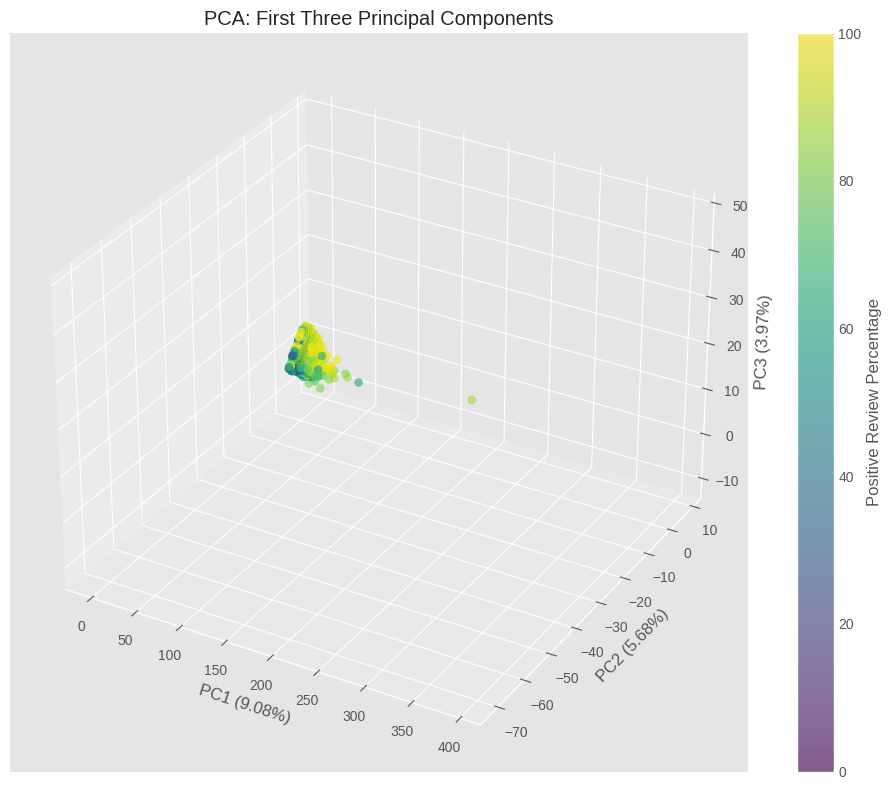


Principal Component Interpretation:

PC1 (9.08% of variance):
  Positive correlation with:
    - num_reviews_total: 0.423
    - positive: 0.419
    - recommendations: 0.399
    - negative: 0.387
    - num_reviews_recent: 0.381
    - peak_ccu: 0.372
    - log_revenue: 0.131
    - pct_pos_recent: 0.099
    - metacritic_score: 0.078
    - price: 0.066
  Negative correlation with:
    - release_year: -0.024
    - Tag: Casual: -0.013
    - Tag: Indie: -0.006
    - Developer: Cyber Keks: -0.004
    - Developer: Laush Dmitriy Sergeevich: -0.004
    - Developer: GentleDriver: -0.004
    - Developer: Tero Lunkka: -0.003
    - Developer: Gamesforgames: -0.003
    - Developer: Sokpop Collective: -0.003
    - Developer: Octo Games: -0.002

PC2 (5.68% of variance):
  Positive correlation with:
    - Tag: Singleplayer: 0.359
    - log_revenue: 0.327
    - Tag: Story Rich: 0.273
    - Tag: Adventure: 0.271
    - Tag: Atmospheric: 0.265
    - price: 0.245
    - Tag: Exploration: 0.237
    - pct_pos_r

In [21]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import ast
import json
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import warnings
warnings.filterwarnings('ignore')

# Set plotting parameters
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [12, 8]

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with no reviews or missing review percentages
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 10) & (df['num_reviews_total'] != -1)]
df = df[~df['pct_pos_total'].isna()]  # Ensure we have review percentage data

# Calculate estimated revenue metrics
df['min_price'] = df['price'].apply(lambda x: max(x, 0.99) if x >= 0 else 0.99)
df['revenue'] = df['num_reviews_total'] * df['min_price']
df['log_revenue'] = np.log(df['revenue'].clip(1, None))  # Natural log transform

# Extract release year as a feature
df['release_year'] = df['release_date'].dt.year

# Process tags column - handle different formats
def parse_tags(tag_str):
    if pd.isna(tag_str):
        return []
    
    try:
        # Try to evaluate as Python literal (list or dict)
        parsed = ast.literal_eval(tag_str)
        
        # If it's a dictionary, extract the keys
        if isinstance(parsed, dict):
            return list(parsed.keys())
        # If it's a list, return it as is
        elif isinstance(parsed, list):
            return parsed
        else:
            return []
    except:
        # If ast.literal_eval fails, try json parsing
        try:
            parsed = json.loads(tag_str)
            if isinstance(parsed, dict):
                return list(parsed.keys())
            elif isinstance(parsed, list):
                return parsed
            else:
                return []
        except:
            # If all parsing attempts fail
            return []

# Process developers column
def parse_developers(dev_str):
    if pd.isna(dev_str):
        return []
    
    try:
        parsed = ast.literal_eval(dev_str)
        if isinstance(parsed, list):
            return parsed
        else:
            return []
    except:
        return []

# Apply parsing functions with error handling
print("Parsing tags and developers...")
df['tags_list'] = df['tags'].apply(parse_tags)
df['developers_list'] = df['developers'].apply(parse_developers)

# Count tag occurrences
tag_counter = {}
for tags in df['tags_list']:
    for tag in tags:
        tag = str(tag).strip()  # Ensure the tag is a string and remove whitespace
        if tag in tag_counter:
            tag_counter[tag] += 1
        else:
            tag_counter[tag] = 1

# Get top tags
top_tags = sorted(tag_counter.items(), key=lambda x: x[1], reverse=True)[:20]
top_tag_names = [tag[0] for tag in top_tags]

print("\nTop 20 tags:")
for tag, count in top_tags:
    print(f"{tag}: {count}")

# Create binary features for top tags
for tag in top_tag_names:
    df[f'tag_{tag}'] = df['tags_list'].apply(lambda x: 1 if tag in x else 0)

# Count developer occurrences
dev_counter = {}
for devs in df['developers_list']:
    for dev in devs:
        dev = str(dev).strip()  # Ensure the developer is a string and remove whitespace
        if dev in dev_counter:
            dev_counter[dev] += 1
        else:
            dev_counter[dev] = 1

# Get top developers
top_devs = sorted(dev_counter.items(), key=lambda x: x[1], reverse=True)[:20]
top_dev_names = [dev[0] for dev in top_devs]

print("\nTop 20 developers:")
for dev, count in top_devs:
    print(f"{dev}: {count}")

# Create binary features for top developers
for dev in top_dev_names:
    df[f'dev_{dev}'] = df['developers_list'].apply(lambda x: 1 if dev in x else 0)

# Select numeric features for PCA
numeric_features = [
    'price', 
    'dlc_count',
    'metacritic_score', 
    'achievements',
    'recommendations',
    'user_score',
    'score_rank',
    'positive', 
    'negative',
    'average_playtime_forever',
    'median_playtime_forever',
    'peak_ccu',
    'pct_pos_total',
    'num_reviews_total',
    'pct_pos_recent',
    'num_reviews_recent',
    'log_revenue',
    'release_year'
]

# Add encoded tag features
tag_features = [f'tag_{tag}' for tag in top_tag_names]
numeric_features.extend(tag_features)

# Add encoded developer features
dev_features = [f'dev_{dev}' for dev in top_dev_names]
numeric_features.extend(dev_features)

print(f"\nTotal number of features for PCA: {len(numeric_features)}")

# Create a copy of the dataframe with only the selected features
X = df[numeric_features].copy()

# Check for and handle any remaining missing values
print("\nMissing values in each column:")
missing_counts = X.isna().sum()
print(missing_counts[missing_counts > 0])

# Replace missing values with median
X = X.fillna(X.median())

# Standardize the data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Determine optimal number of components
pca_full = PCA()
pca_full.fit(X_scaled)

# Plot explained variance
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca_full.explained_variance_ratio_), marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.axhline(y=0.8, color='r', linestyle='-', alpha=0.5, label='80% Explained Variance')
plt.axhline(y=0.9, color='g', linestyle='-', alpha=0.5, label='90% Explained Variance')
plt.title('Explained Variance by Components')
plt.legend()
plt.grid(True)
plt.show()

# Find number of components that explain at least 80% of variance
n_components = np.argmax(np.cumsum(pca_full.explained_variance_ratio_) >= 0.8) + 1
print(f"Number of components explaining 80% variance: {n_components}")

# Limit to a reasonable number of components for visualization
n_components = min(n_components, 10)

# Perform PCA with the selected number of components
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)

# Create a DataFrame with principal components
pca_df = pd.DataFrame(
    data=principal_components,
    columns=[f'PC{i+1}' for i in range(n_components)]
)

# Add back the game name for reference
pca_df['name'] = df['name'].values

# Print explained variance for each component
print("\nExplained variance ratio by component:")
for i, var in enumerate(pca.explained_variance_ratio_):
    print(f"PC{i+1}: {var:.4f} ({var*100:.2f}%)")
print(f"Total variance explained: {sum(pca.explained_variance_ratio_)*100:.2f}%")

# Feature importance (loadings)
loadings = pd.DataFrame(
    pca.components_.T,
    columns=[f'PC{i+1}' for i in range(n_components)],
    index=numeric_features
)

# Print loadings for the first 2 components
print("\nTop 10 feature loadings for first 2 components:")
# For PC1
print("\nPC1 (positive):")
print(loadings['PC1'].sort_values(ascending=False).head(10))
print("\nPC1 (negative):")
print(loadings['PC1'].sort_values(ascending=True).head(10))

# For PC2
print("\nPC2 (positive):")
print(loadings['PC2'].sort_values(ascending=False).head(10))
print("\nPC2 (negative):")
print(loadings['PC2'].sort_values(ascending=True).head(10))

# Visualization of the first two principal components
plt.figure(figsize=(12, 10))
scatter = plt.scatter(
    pca_df['PC1'], 
    pca_df['PC2'],
    c=df['pct_pos_total'],  # Color by review percentage
    cmap='viridis',
    alpha=0.5,
    s=50
)
plt.colorbar(scatter, label='Positive Review Percentage')
plt.xlabel(f'Principal Component 1 ({pca.explained_variance_ratio_[0]:.2%})')
plt.ylabel(f'Principal Component 2 ({pca.explained_variance_ratio_[1]:.2%})')
plt.title('PCA: First Two Principal Components')
plt.grid(True, alpha=0.3)

# Get the top contributing features for visualization
# Only plot the top 15 for readability
loadings_pc1 = loadings.iloc[:, 0].abs().sort_values(ascending=False)
loadings_pc2 = loadings.iloc[:, 1].abs().sort_values(ascending=False)
top_features = list(set(loadings_pc1.index[:15]).union(set(loadings_pc2.index[:15])))

# Scale factor for arrows
scale_factor = 5

for feature in top_features:
    i = numeric_features.index(feature)
    plt.arrow(
        0, 0,  # Start at origin
        loadings.iloc[i, 0] * scale_factor,  # PC1 loading
        loadings.iloc[i, 1] * scale_factor,  # PC2 loading
        head_width=0.2,
        head_length=0.2,
        fc='red',
        ec='red',
        alpha=0.6
    )
    # Shorten feature names for tags and developers
    display_name = feature
    if feature.startswith('tag_'):
        display_name = 'T:' + feature[4:]
    elif feature.startswith('dev_'):
        display_name = 'D:' + feature[4:]
        
    plt.text(
        loadings.iloc[i, 0] * scale_factor * 1.1,
        loadings.iloc[i, 1] * scale_factor * 1.1,
        display_name,
        color='black',
        ha='center',
        va='center',
        fontweight='bold',
        bbox=dict(facecolor='white', alpha=0.6)
    )

plt.tight_layout()
plt.show()

# Heatmap of the component loadings (just showing numeric features, not all tag/dev features)
# Select a subset of features for the heatmap for readability
core_features = [
    'price', 'dlc_count', 'metacritic_score', 'achievements',
    'recommendations', 'user_score', 'score_rank', 'positive', 
    'negative', 'average_playtime_forever', 'median_playtime_forever',
    'peak_ccu', 'pct_pos_total', 'num_reviews_total', 
    'pct_pos_recent', 'num_reviews_recent', 'log_revenue', 'release_year'
]

# Fix the slicing issue - use iloc for integer-based slicing of columns
plt.figure(figsize=(14, 10))
# Use the first 5 components or all if less than 5
num_components_to_show = min(5, n_components)
columns_to_use = [f'PC{i+1}' for i in range(num_components_to_show)]

sns.heatmap(
    loadings.loc[core_features, columns_to_use], 
    annot=True, 
    cmap='coolwarm', 
    fmt='.2f', 
    linewidths=0.5
)
plt.title('Feature Loadings for Principal Components (Core Features)')
plt.tight_layout()
plt.show()

# Tag features heatmap (top 10 tags)
top_10_tags = [f'tag_{tag}' for tag in top_tag_names[:10]]
plt.figure(figsize=(14, 8))
sns.heatmap(
    loadings.loc[top_10_tags, columns_to_use], 
    annot=True, 
    cmap='coolwarm', 
    fmt='.2f', 
    linewidths=0.5
)
plt.title('Feature Loadings for Principal Components (Top 10 Tags)')
plt.tight_layout()
plt.show()

# Developer features heatmap (top 10 developers)
top_10_devs = [f'dev_{dev}' for dev in top_dev_names[:10]]
plt.figure(figsize=(14, 8))
sns.heatmap(
    loadings.loc[top_10_devs, columns_to_use], 
    annot=True, 
    cmap='coolwarm', 
    fmt='.2f', 
    linewidths=0.5
)
plt.title('Feature Loadings for Principal Components (Top 10 Developers)')
plt.tight_layout()
plt.show()

# Find games with extreme values in the principal components
for i in range(min(3, n_components)):
    print(f"\nTop 5 games with highest values in PC{i+1}:")
    top_games = pca_df.sort_values(f'PC{i+1}', ascending=False).head(5)
    print(top_games[['name', f'PC{i+1}']])
    
    print(f"\nTop 5 games with lowest values in PC{i+1}:")
    bottom_games = pca_df.sort_values(f'PC{i+1}', ascending=True).head(5)
    print(bottom_games[['name', f'PC{i+1}']])

# Optional: 3D plot of first three components if available
if n_components >= 3:
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(
        principal_components[:, 0],
        principal_components[:, 1],
        principal_components[:, 2],
        c=df['pct_pos_total'],
        cmap='viridis',
        alpha=0.6,
        s=30
    )
    plt.colorbar(scatter, ax=ax, label='Positive Review Percentage')
    ax.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.2%})')
    ax.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.2%})')
    ax.set_zlabel(f'PC3 ({pca.explained_variance_ratio_[2]:.2%})')
    ax.set_title('PCA: First Three Principal Components')
    plt.tight_layout()
    plt.show()

# Create an interpretable report of what each principal component represents
print("\nPrincipal Component Interpretation:")
for i in range(min(3, n_components)):
    print(f"\nPC{i+1} ({pca.explained_variance_ratio_[i]:.2%} of variance):")
    
    # Get the top positive contributing features
    top_pos = loadings[f'PC{i+1}'].sort_values(ascending=False).head(10)
    print("  Positive correlation with:")
    for feat, val in top_pos.items():
        feat_name = feat
        if feat.startswith('tag_'):
            feat_name = f"Tag: {feat[4:]}"
        elif feat.startswith('dev_'):
            feat_name = f"Developer: {feat[4:]}"
        print(f"    - {feat_name}: {val:.3f}")
    
    # Get the top negative contributing features
    top_neg = loadings[f'PC{i+1}'].sort_values(ascending=True).head(10)
    print("  Negative correlation with:")
    for feat, val in top_neg.items():
        feat_name = feat
        if feat.startswith('tag_'):
            feat_name = f"Tag: {feat[4:]}"
        elif feat.startswith('dev_'):
            feat_name = f"Developer: {feat[4:]}"
        print(f"    - {feat_name}: {val:.3f}")

## pair plots

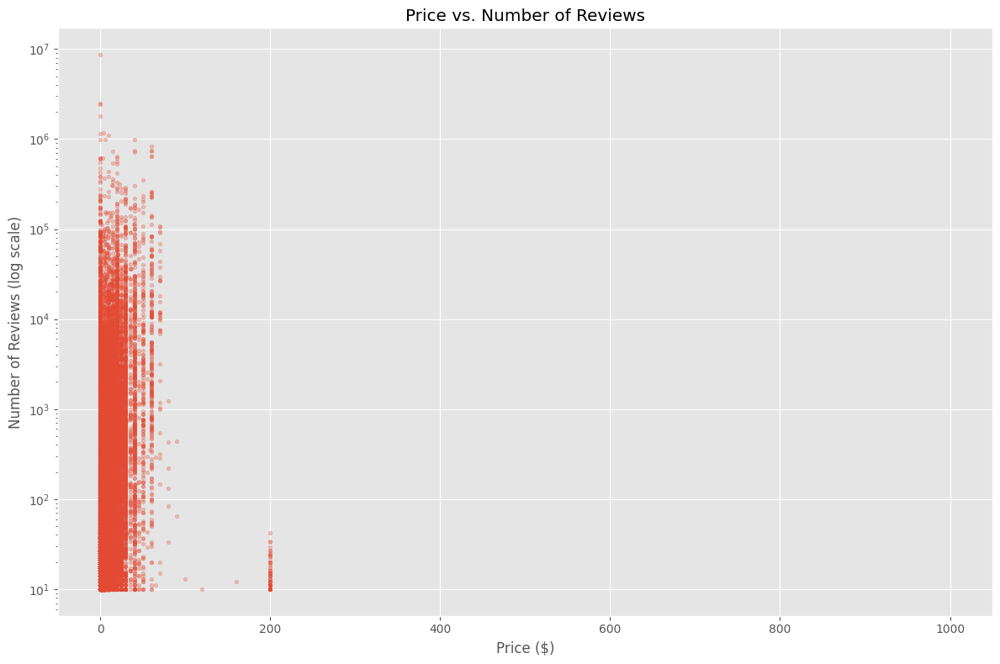

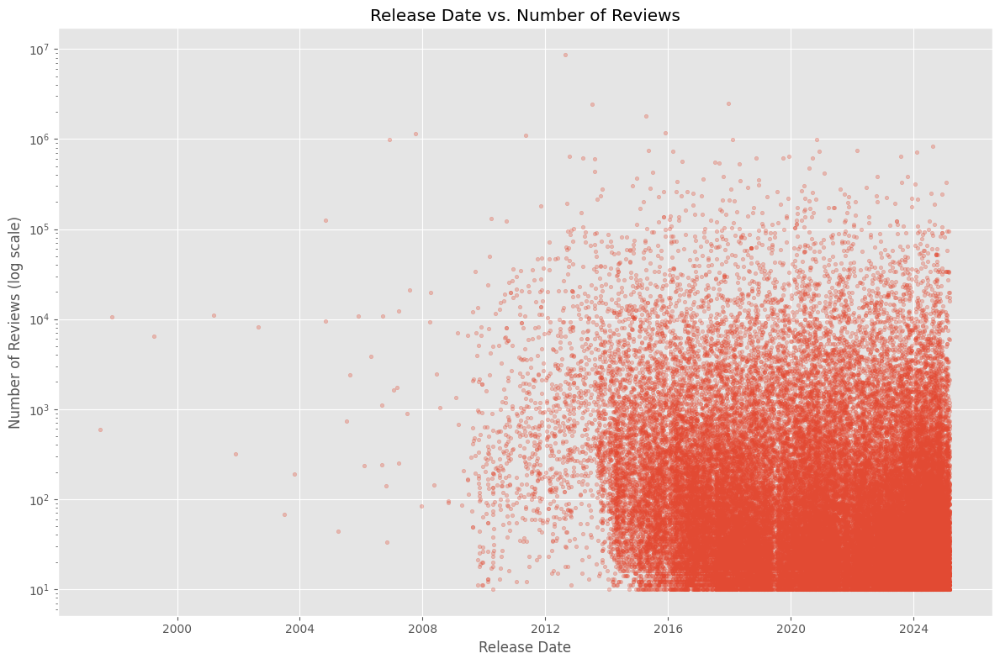

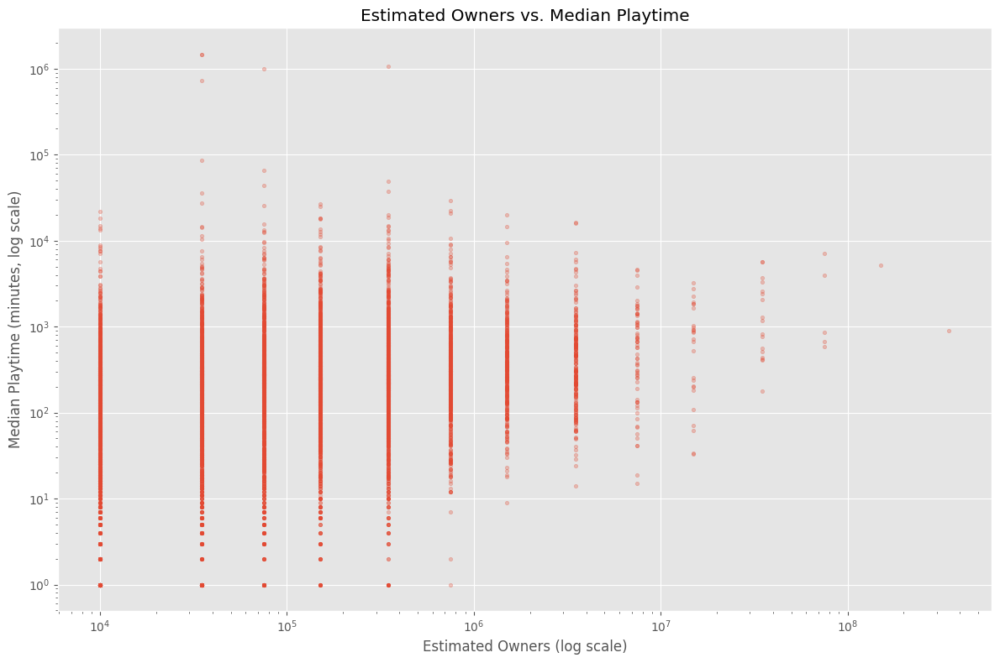

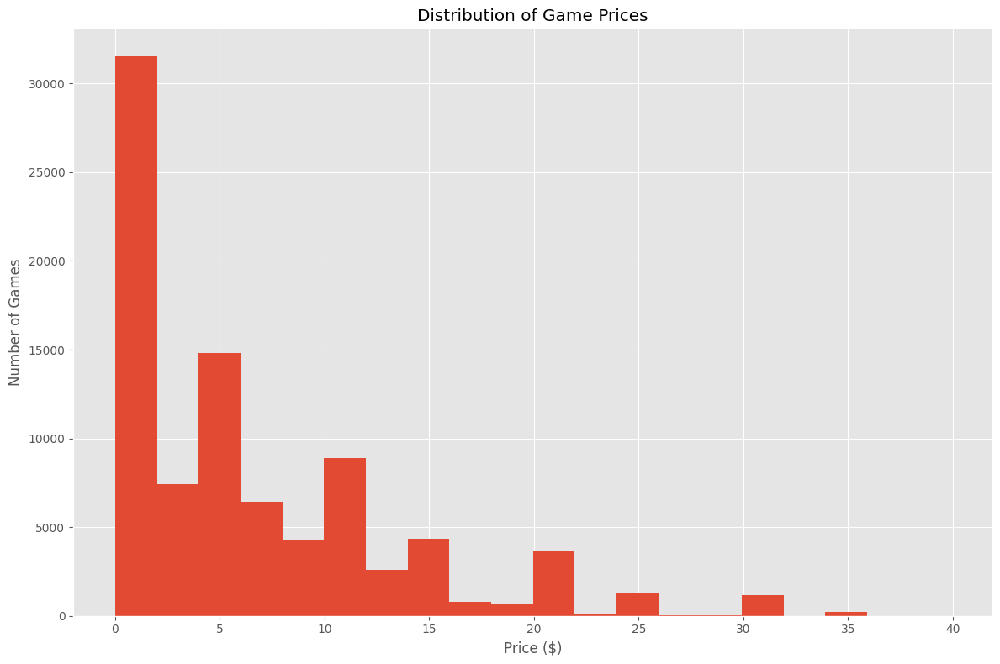

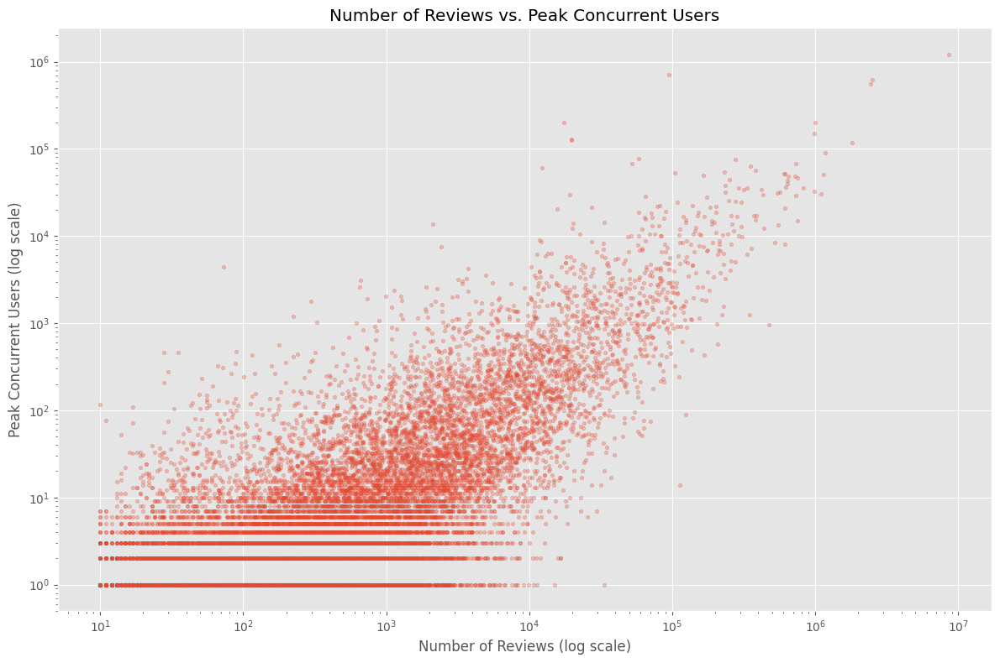

...

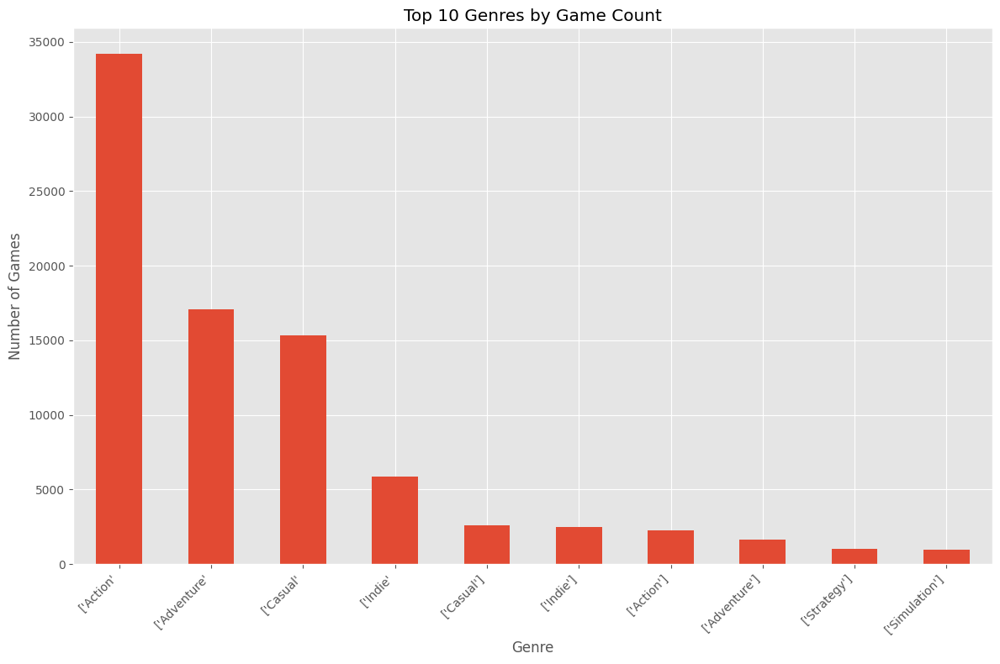

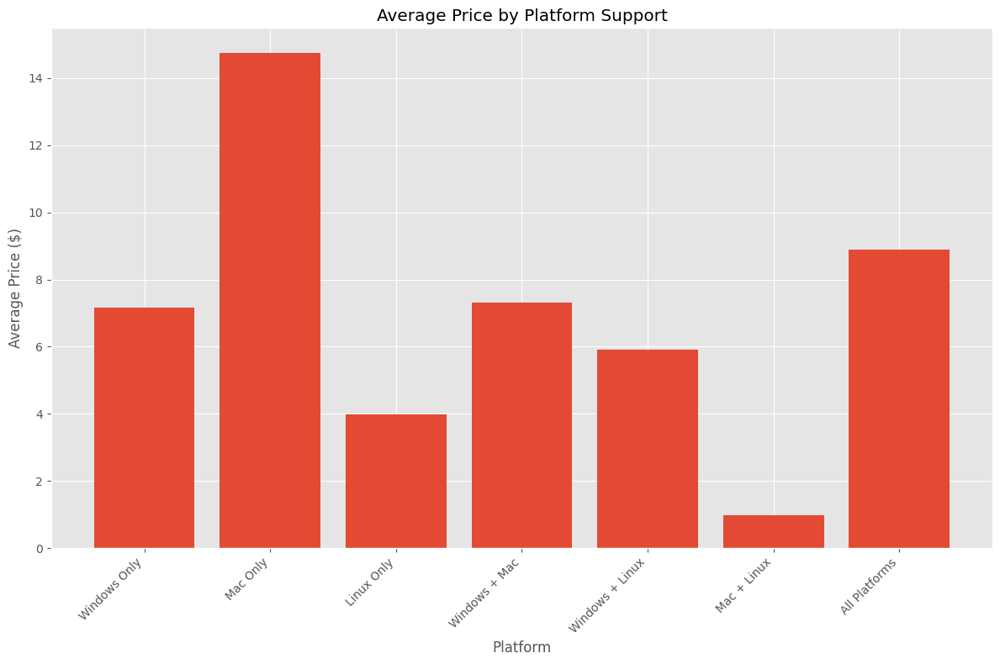

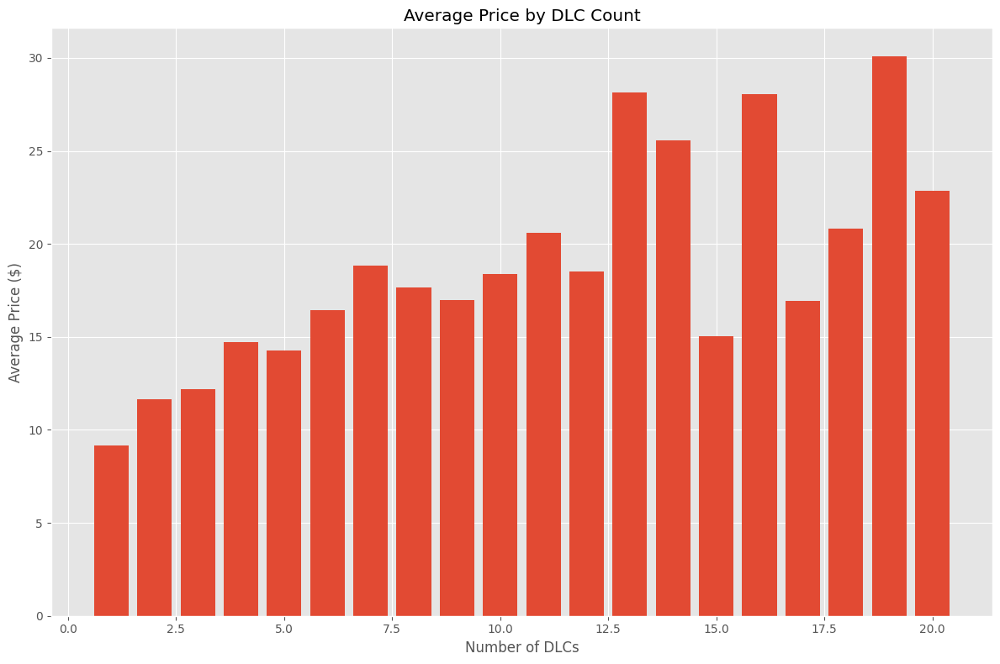

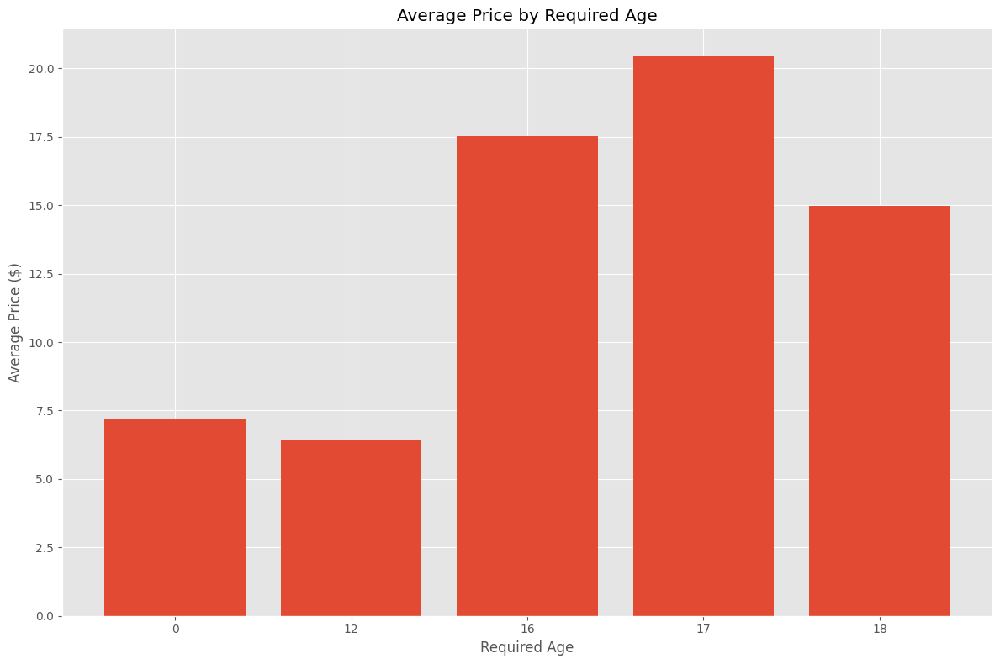

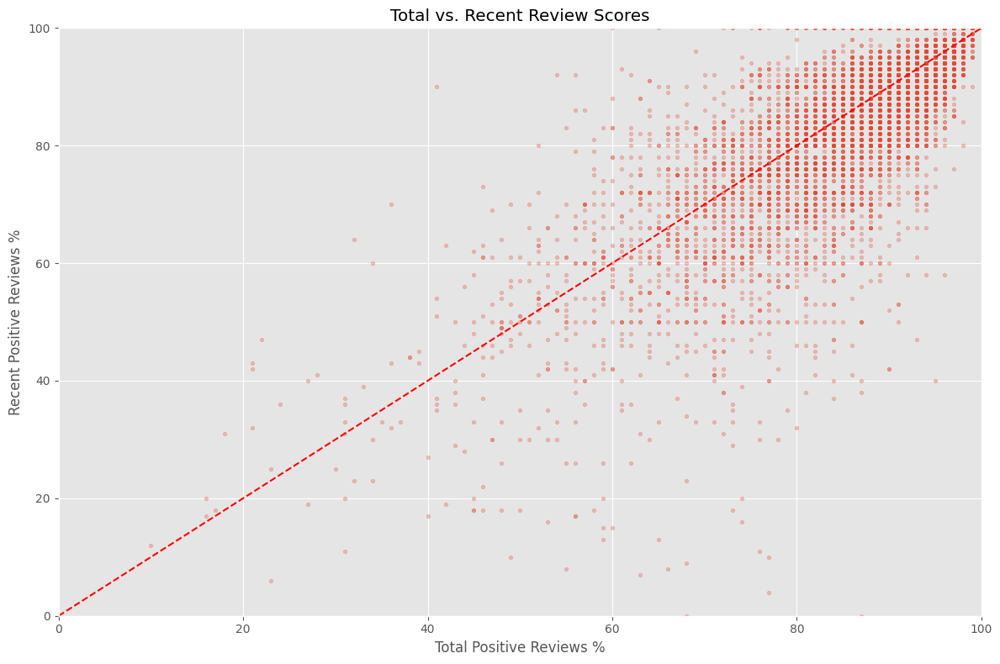

Summary Statistics:
Total number of games: 89618
Date range: 1997-06-30 to 2025-03-10
Average price: $7.31
Median price: $4.99
Average positive review percentage: 45.35%
Median playtime: 0 minutes

Price Distribution:
Free: 0 games (0.0%)
$0.01-$4.99: 39388 games (44.0%)
$5.00-$9.99: 19090 games (21.3%)
$10.00-$14.99: 7669 games (8.6%)
$15.00-$19.99: 5062 games (5.6%)
$20.00-$29.99: 2558 games (2.9%)
$30.00-$49.99: 1111 games (1.2%)
$50.00-$99.99: 396 games (0.4%)
$100+: 184 games (0.2%)

Platform Support:
Windows: 89588 games (100.0%)
Mac: 17438 games (19.5%)
Linux: 12627 games (14.1%)


In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import re

# Enable inline plotting for Jupyter notebooks
%matplotlib inline

# Make figures larger by default
plt.rcParams['figure.figsize'] = [12, 8]

# Set a simple style similar to R default
plt.style.use('ggplot')

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Simple data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Extract numeric owners from estimated_owners string
def extract_owner_midpoint(owner_range):
    if pd.isna(owner_range):
        return np.nan
    match = re.match(r'(\d+[,\d]*) - (\d+[,\d]*)', str(owner_range))
    if match:
        low = int(match.group(1).replace(',', ''))
        high = int(match.group(2).replace(',', ''))
        return (low + high) / 2
    return np.nan

df['owners_midpoint'] = df['estimated_owners'].apply(extract_owner_midpoint)

# 1. Price vs. Reviews
plt.figure()
plt.scatter(df['price'], df['num_reviews_total'], alpha=0.3, s=10)
plt.yscale('log')
plt.xlabel('Price ($)')
plt.ylabel('Number of Reviews (log scale)')
plt.title('Price vs. Number of Reviews')
plt.tight_layout()
plt.show()

# 2. Release Date vs. Reviews
plt.figure()
plt.scatter(df['release_date'], df['num_reviews_total'], alpha=0.3, s=10)
plt.yscale('log')
plt.xlabel('Release Date')
plt.ylabel('Number of Reviews (log scale)')
plt.title('Release Date vs. Number of Reviews')
plt.tight_layout()
plt.show()

# 3. Estimated Owners vs. Playtime
# Filter to remove NaNs and zeros
playtime_df = df[(df['owners_midpoint'].notna()) & 
                 (df['median_playtime_forever'].notna()) &
                 (df['owners_midpoint'] > 0) &
                 (df['median_playtime_forever'] > 0)]

plt.figure()
plt.scatter(playtime_df['owners_midpoint'], playtime_df['median_playtime_forever'], alpha=0.3, s=10)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Estimated Owners (log scale)')
plt.ylabel('Median Playtime (minutes, log scale)')
plt.title('Estimated Owners vs. Median Playtime')
plt.tight_layout()
plt.show()

# 4. Price Distribution
plt.figure()
# Filter out extreme prices
price_df = df[df['price'] < df['price'].quantile(0.99)]
plt.hist(price_df['price'], bins=20)
plt.xlabel('Price ($)')
plt.ylabel('Number of Games')
plt.title('Distribution of Game Prices')
plt.tight_layout()
plt.show()

# 5. Reviews vs. Peak CCU
ccu_df = df[(df['num_reviews_total'] > 0) & (df['peak_ccu'] > 0)]
plt.figure()
plt.scatter(ccu_df['num_reviews_total'], ccu_df['peak_ccu'], alpha=0.3, s=10)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Number of Reviews (log scale)')
plt.ylabel('Peak Concurrent Users (log scale)')
plt.title('Number of Reviews vs. Peak Concurrent Users')
plt.tight_layout()
plt.show()

# 6. Simple Correlation Matrix
numeric_cols = ['price', 'dlc_count', 'achievements', 'recommendations', 
                'average_playtime_forever', 'median_playtime_forever',
                'peak_ccu', 'num_reviews_total', 'num_reviews_recent', 
                'pct_pos_total', 'pct_pos_recent']

# Create correlation matrix for numeric columns
corr_df = df[numeric_cols].copy()
# Fill NAs with appropriate values
for col in corr_df.columns:
    if col.startswith('pct_'):
        corr_df[col] = corr_df[col].fillna(corr_df[col].median())
    else:
        corr_df[col] = corr_df[col].fillna(0)

corr_matrix = corr_df.corr()

# Simple correlation heatmap (R-style)
plt.figure(figsize=(14, 12))
sns.heatmap(corr_matrix, annot=True, cmap='RdBu_r', fmt=".2f")
plt.title('Correlation Between Steam Game Metrics')
plt.tight_layout()
plt.show()

# 7. Achievements vs. Playtime
ach_df = df[(df['achievements'] > 0) & (df['median_playtime_forever'] > 0)]
plt.figure()
plt.scatter(ach_df['achievements'], ach_df['median_playtime_forever'], alpha=0.3, s=10)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Number of Achievements (log scale)')
plt.ylabel('Median Playtime (minutes, log scale)')
plt.title('Achievements vs. Median Playtime')
plt.tight_layout()
plt.show()

# 8. Simple Platform Distribution
platforms = ['Windows Only', 'Mac Only', 'Linux Only', 'Windows + Mac', 
             'Windows + Linux', 'Mac + Linux', 'All Platforms']
platform_counts = [
    len(df[(df['windows'] == True) & (df['mac'] == False) & (df['linux'] == False)]),
    len(df[(df['windows'] == False) & (df['mac'] == True) & (df['linux'] == False)]),
    len(df[(df['windows'] == False) & (df['mac'] == False) & (df['linux'] == True)]),
    len(df[(df['windows'] == True) & (df['mac'] == True) & (df['linux'] == False)]),
    len(df[(df['windows'] == True) & (df['mac'] == False) & (df['linux'] == True)]),
    len(df[(df['windows'] == False) & (df['mac'] == True) & (df['linux'] == True)]),
    len(df[(df['windows'] == True) & (df['mac'] == True) & (df['linux'] == True)])
]

plt.figure()
plt.bar(platforms, platform_counts)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Platform')
plt.ylabel('Number of Games')
plt.title('Games by Platform Support')
plt.tight_layout()
plt.show()

# 9. Review Percentages Distribution
plt.figure()
plt.hist(df['pct_pos_total'].dropna(), bins=20)
plt.xlabel('Positive Review Percentage')
plt.ylabel('Number of Games')
plt.title('Distribution of Positive Review Percentages')
plt.tight_layout()
plt.show()

# 10. Average Price by Year
df['release_year'] = df['release_date'].dt.year
year_price = df.groupby('release_year')['price'].mean().reset_index()
year_price = year_price[(year_price['release_year'] >= 2005) & (year_price['release_year'] <= 2024)]

plt.figure()
plt.bar(year_price['release_year'], year_price['price'])
plt.xlabel('Release Year')
plt.ylabel('Average Price ($)')
plt.title('Average Game Price by Release Year')
plt.tight_layout()
plt.show()

# 11. Review Count vs Positive Percentage
review_df = df[(df['num_reviews_total'] > 10) & (df['pct_pos_total'].notna())]
plt.figure()
plt.scatter(review_df['num_reviews_total'], review_df['pct_pos_total'], alpha=0.3, s=10)
plt.xscale('log')
plt.xlabel('Number of Reviews (log scale)')
plt.ylabel('Positive Review Percentage')
plt.title('Number of Reviews vs. Positive Percentage')
plt.tight_layout()
plt.show()

# 12. Top Genres by Game Count
# Extract primary genre for each game and count
df['primary_genre'] = df['genres'].str.split(',').str[0]
top_genres = df['primary_genre'].value_counts().head(10)

plt.figure()
top_genres.plot(kind='bar')
plt.xlabel('Genre')
plt.ylabel('Number of Games')
plt.title('Top 10 Genres by Game Count')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# 13. Price by Platform Combination
plt.figure()
platform_price_data = []
for platform in platforms:
    if platform == 'Windows Only':
        price_data = df[(df['windows'] == True) & (df['mac'] == False) & (df['linux'] == False)]['price']
    elif platform == 'Mac Only':
        price_data = df[(df['windows'] == False) & (df['mac'] == True) & (df['linux'] == False)]['price']
    elif platform == 'Linux Only':
        price_data = df[(df['windows'] == False) & (df['mac'] == False) & (df['linux'] == True)]['price']
    elif platform == 'Windows + Mac':
        price_data = df[(df['windows'] == True) & (df['mac'] == True) & (df['linux'] == False)]['price']
    elif platform == 'Windows + Linux':
        price_data = df[(df['windows'] == True) & (df['mac'] == False) & (df['linux'] == True)]['price']
    elif platform == 'Mac + Linux':
        price_data = df[(df['windows'] == False) & (df['mac'] == True) & (df['linux'] == True)]['price']
    elif platform == 'All Platforms':
        price_data = df[(df['windows'] == True) & (df['mac'] == True) & (df['linux'] == True)]['price']
    
    platform_price_data.append(price_data.mean())

plt.bar(platforms, platform_price_data)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Platform')
plt.ylabel('Average Price ($)')
plt.title('Average Price by Platform Support')
plt.tight_layout()
plt.show()

# 14. DLC Count vs Price
dlc_df = df[df['dlc_count'] > 0]
dlc_grouped = dlc_df.groupby('dlc_count')['price'].mean().reset_index()
# Limit to reasonable DLC counts for visualization
dlc_grouped = dlc_grouped[dlc_grouped['dlc_count'] <= 20]

plt.figure()
plt.bar(dlc_grouped['dlc_count'], dlc_grouped['price'])
plt.xlabel('Number of DLCs')
plt.ylabel('Average Price ($)')
plt.title('Average Price by DLC Count')
plt.tight_layout()
plt.show()

# 15. Price by Age Rating
age_df = df[df['required_age'].isin([0, 12, 16, 17, 18])]
age_grouped = age_df.groupby('required_age')['price'].mean().reset_index()

plt.figure()
plt.bar(age_grouped['required_age'].astype(str), age_grouped['price'])
plt.xlabel('Required Age')
plt.ylabel('Average Price ($)')
plt.title('Average Price by Required Age')
plt.tight_layout()
plt.show()

# 16. Recent vs Total Review Scores
review_compare = df[(df['pct_pos_total'].notna()) & (df['pct_pos_recent'].notna())]
review_compare = review_compare[review_compare['num_reviews_total'] > 100]

plt.figure()
plt.scatter(review_compare['pct_pos_total'], review_compare['pct_pos_recent'], alpha=0.3, s=10)
plt.plot([0, 100], [0, 100], 'r--')  # Add diagonal line
plt.xlabel('Total Positive Reviews %')
plt.ylabel('Recent Positive Reviews %')
plt.title('Total vs. Recent Review Scores')
plt.xlim(0, 100)
plt.ylim(0, 100)
plt.tight_layout()
plt.show()

# Print summary information
print("Summary Statistics:")
print(f"Total number of games: {len(df)}")
print(f"Date range: {df['release_date'].min().date()} to {df['release_date'].max().date()}")
print(f"Average price: ${df['price'].mean():.2f}")
print(f"Median price: ${df['price'].median():.2f}")
print(f"Average positive review percentage: {df['pct_pos_total'].mean():.2f}%")
print(f"Median playtime: {df['median_playtime_forever'].median():.0f} minutes")

# Price tiers
price_tiers = [0, 0.01, 4.99, 9.99, 14.99, 19.99, 29.99, 49.99, 99.99, float('inf')]
price_labels = ['Free', '$0.01-$4.99', '$5.00-$9.99', '$10.00-$14.99', 
                '$15.00-$19.99', '$20.00-$29.99', '$30.00-$49.99', 
                '$50.00-$99.99', '$100+']

df['price_tier'] = pd.cut(df['price'], bins=price_tiers, labels=price_labels)
price_distribution = df['price_tier'].value_counts().sort_index()

print("\nPrice Distribution:")
for tier, count in price_distribution.items():
    print(f"{tier}: {count} games ({count/len(df)*100:.1f}%)")

# Platform distribution
windows_count = df['windows'].sum()
mac_count = df['mac'].sum()
linux_count = df['linux'].sum()

print("\nPlatform Support:")
print(f"Windows: {windows_count} games ({windows_count/len(df)*100:.1f}%)")
print(f"Mac: {mac_count} games ({mac_count/len(df)*100:.1f}%)")
print(f"Linux: {linux_count} games ({linux_count/len(df)*100:.1f}%)")

### pair plot v2

After filtering: 6621 games with valid review data


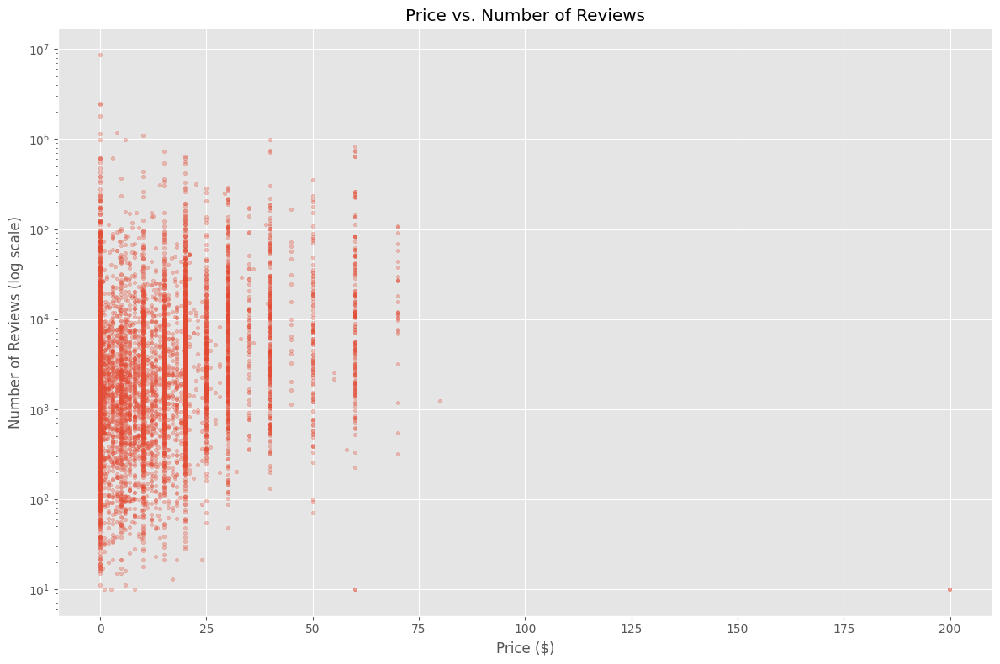

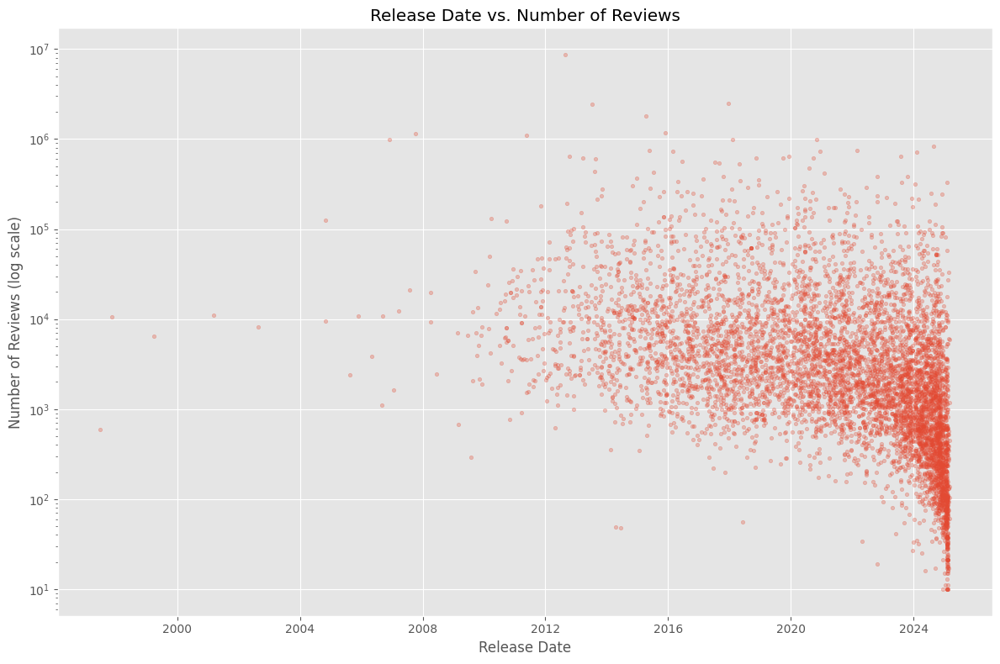

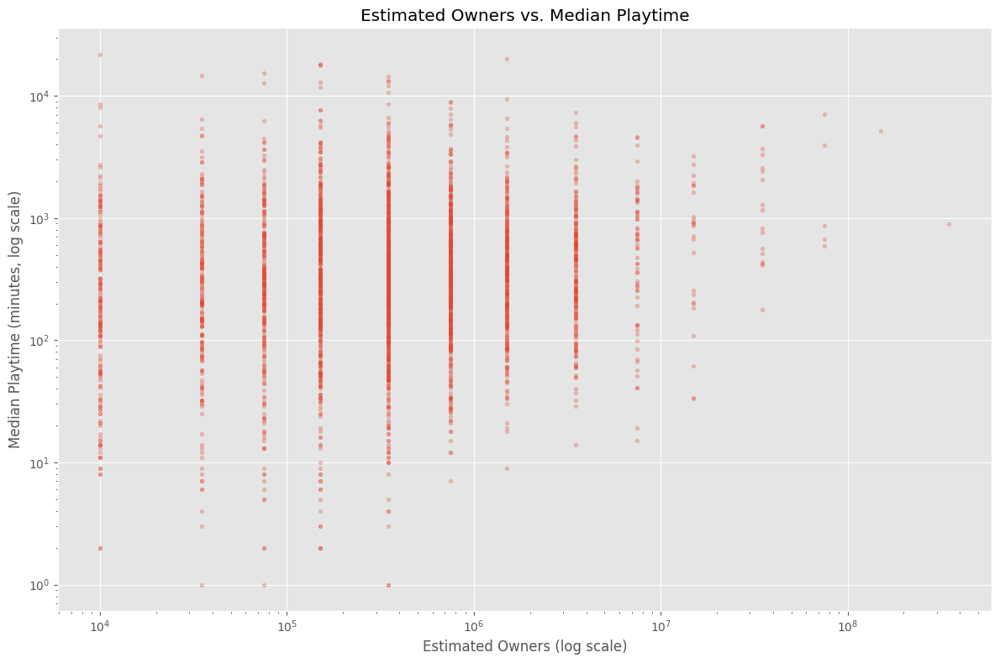

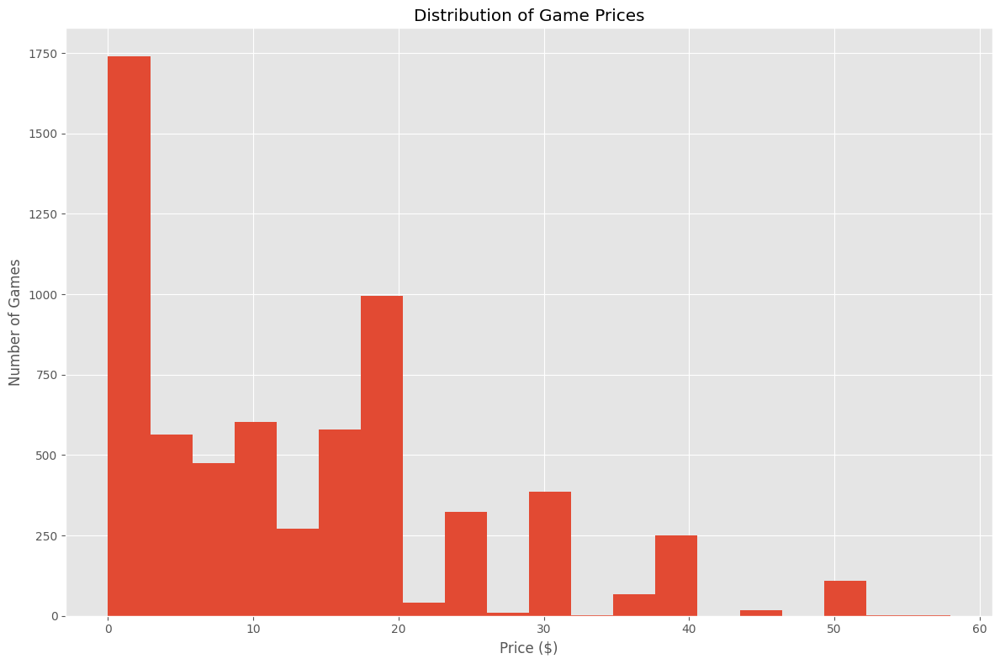

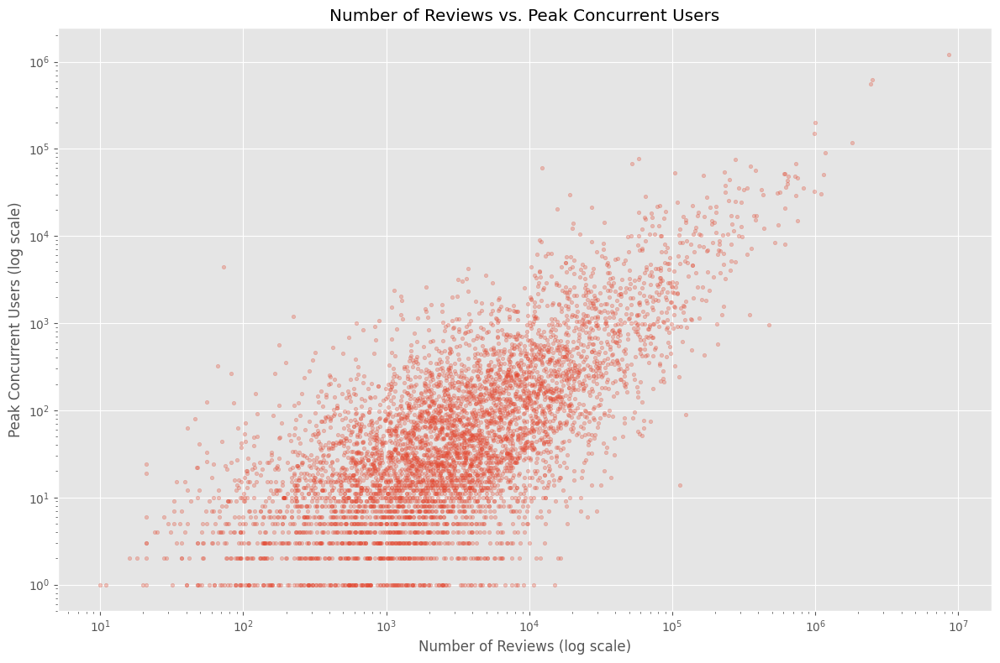

...

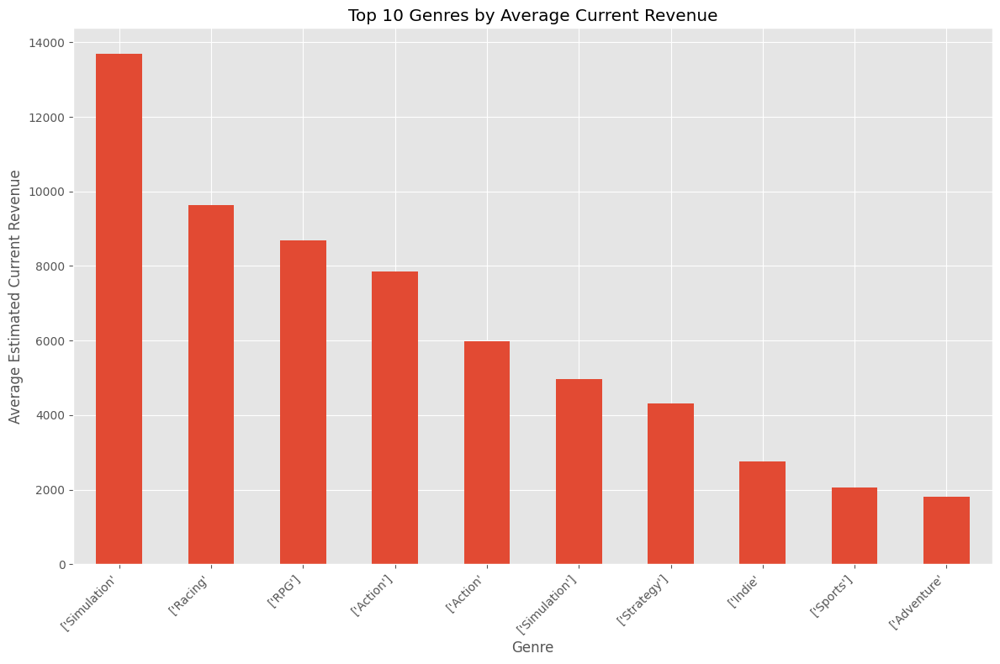

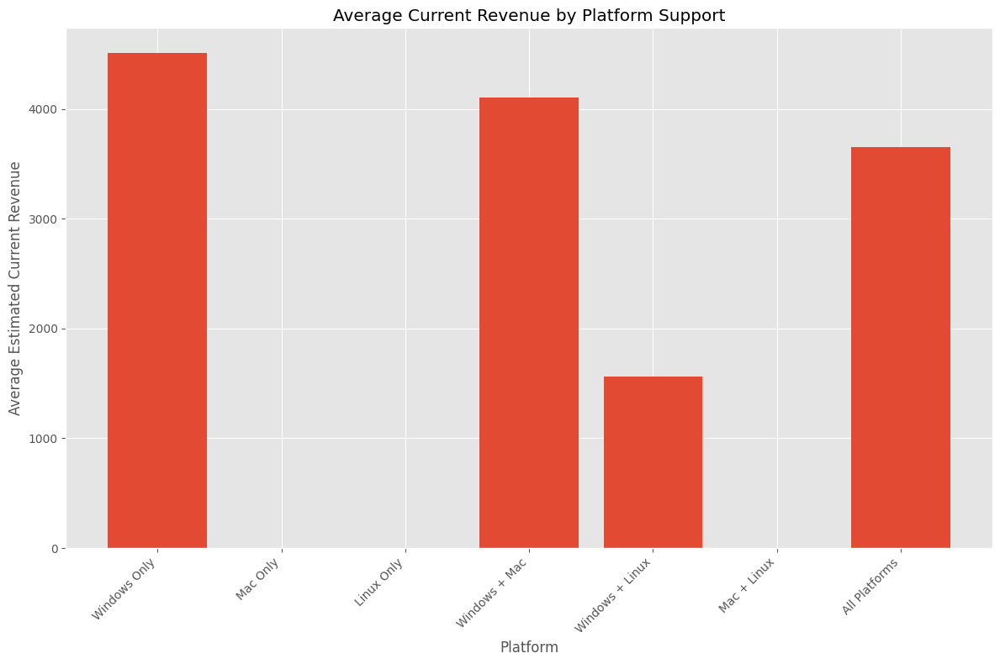

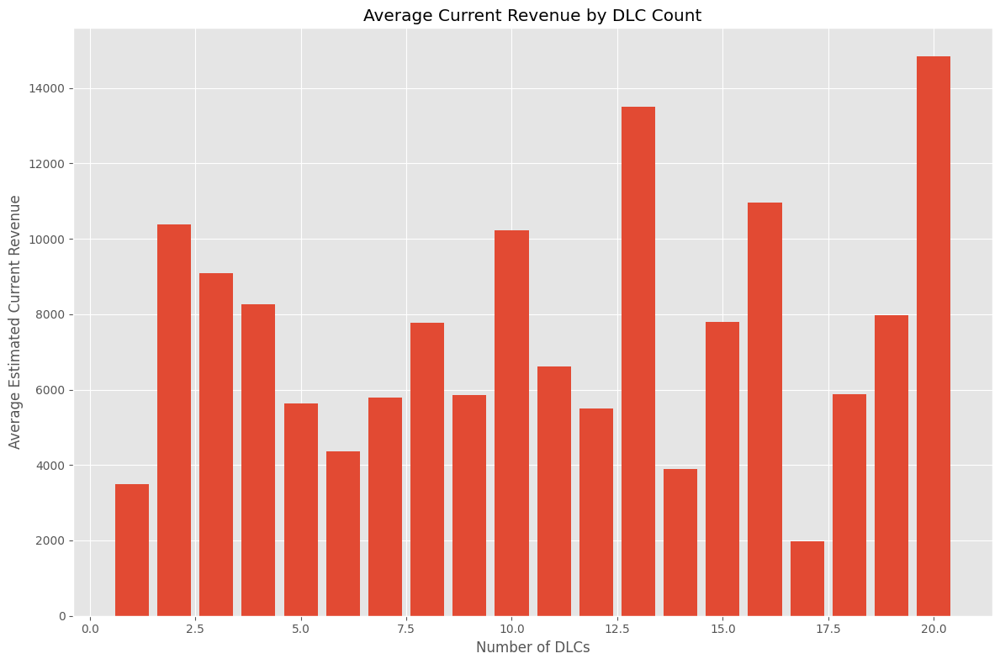

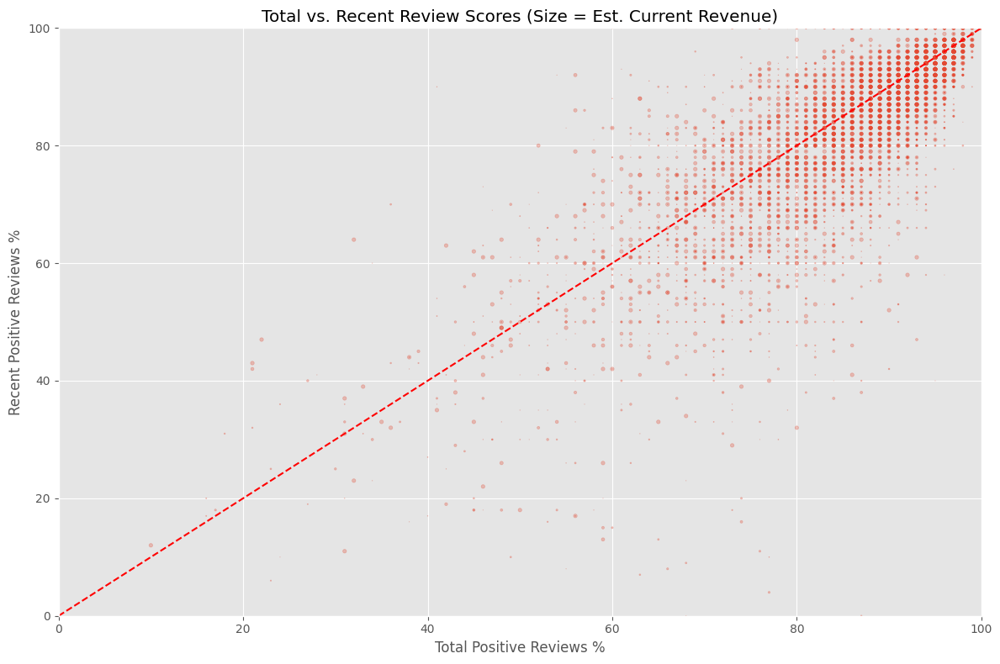

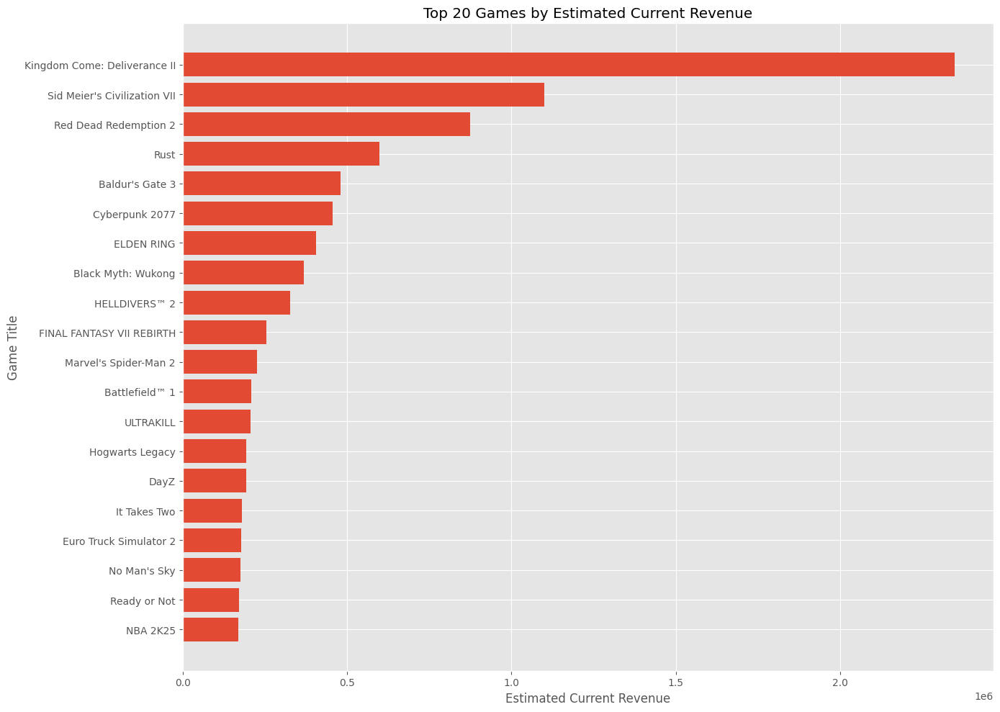

Summary Statistics:
Total number of games with reviews: 6621
Date range: 1997-06-30 to 2025-03-07
Average price: $14.40
Median price: $10.04
Average positive review percentage: 84.74%
Median playtime: 0 minutes
Average estimated current revenue: $4232.68
Median estimated current revenue: $311.87

Price Distribution:
Free: 0 games (0.0%)
$0.01-$4.99: 883 games (13.3%)
$5.00-$9.99: 1027 games (15.5%)
$10.00-$14.99: 829 games (12.5%)
$15.00-$19.99: 1091 games (16.5%)
$20.00-$29.99: 762 games (11.5%)
$30.00-$49.99: 445 games (6.7%)
$50.00-$99.99: 184 games (2.8%)
$100+: 2 games (0.0%)

Platform Support:
Windows: 6621 games (100.0%)
Mac: 1802 games (27.2%)
Linux: 1223 games (18.5%)


In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import re

# Enable inline plotting for Jupyter notebooks
%matplotlib inline

# Make figures larger by default
plt.rcParams['figure.figsize'] = [12, 8]

# Set a simple style similar to R default
plt.style.use('ggplot')

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Simple data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with no reviews (nan, 0, or -1)
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 0) & (df['num_reviews_total'] != -1)]
df = df[~df['num_reviews_recent'].isna() & (df['num_reviews_recent'] >= 0) & (df['num_reviews_recent'] != -1)]

# Calculate estimated current revenue (recent reviews * price)
# For free games, use a minimum value of $0.99 to avoid zeros
df['min_price'] = df['price'].apply(lambda x: max(x, 0.99) if x >= 0 else 0.99)
df['est_current_revenue'] = df['num_reviews_recent'] * df['min_price']

print(f"After filtering: {len(df)} games with valid review data")

# Extract numeric owners from estimated_owners string
def extract_owner_midpoint(owner_range):
    if pd.isna(owner_range):
        return np.nan
    match = re.match(r'(\d+[,\d]*) - (\d+[,\d]*)', str(owner_range))
    if match:
        low = int(match.group(1).replace(',', ''))
        high = int(match.group(2).replace(',', ''))
        return (low + high) / 2
    return np.nan

df['owners_midpoint'] = df['estimated_owners'].apply(extract_owner_midpoint)

# 1. Price vs. Reviews
plt.figure()
plt.scatter(df['price'], df['num_reviews_total'], alpha=0.3, s=10)
plt.yscale('log')
plt.xlabel('Price ($)')
plt.ylabel('Number of Reviews (log scale)')
plt.title('Price vs. Number of Reviews')
plt.tight_layout()
plt.show()

# 2. Release Date vs. Reviews
plt.figure()
plt.scatter(df['release_date'], df['num_reviews_total'], alpha=0.3, s=10)
plt.yscale('log')
plt.xlabel('Release Date')
plt.ylabel('Number of Reviews (log scale)')
plt.title('Release Date vs. Number of Reviews')
plt.tight_layout()
plt.show()

# 3. Estimated Owners vs. Playtime
# Filter to remove NaNs and zeros
playtime_df = df[(df['owners_midpoint'].notna()) & 
                 (df['median_playtime_forever'].notna()) &
                 (df['owners_midpoint'] > 0) &
                 (df['median_playtime_forever'] > 0)]

plt.figure()
plt.scatter(playtime_df['owners_midpoint'], playtime_df['median_playtime_forever'], alpha=0.3, s=10)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Estimated Owners (log scale)')
plt.ylabel('Median Playtime (minutes, log scale)')
plt.title('Estimated Owners vs. Median Playtime')
plt.tight_layout()
plt.show()

# 4. Price Distribution
plt.figure()
# Filter out extreme prices
price_df = df[df['price'] < df['price'].quantile(0.99)]
plt.hist(price_df['price'], bins=20)
plt.xlabel('Price ($)')
plt.ylabel('Number of Games')
plt.title('Distribution of Game Prices')
plt.tight_layout()
plt.show()

# 5. Reviews vs. Peak CCU
ccu_df = df[df['peak_ccu'] > 0]
plt.figure()
plt.scatter(ccu_df['num_reviews_total'], ccu_df['peak_ccu'], alpha=0.3, s=10)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Number of Reviews (log scale)')
plt.ylabel('Peak Concurrent Users (log scale)')
plt.title('Number of Reviews vs. Peak Concurrent Users')
plt.tight_layout()
plt.show()

# 6. Simple Correlation Matrix
numeric_cols = ['price', 'dlc_count', 'achievements', 'recommendations', 
                'average_playtime_forever', 'median_playtime_forever',
                'peak_ccu', 'num_reviews_total', 'num_reviews_recent', 
                'pct_pos_total', 'pct_pos_recent', 'est_current_revenue']

# Create correlation matrix for numeric columns
corr_df = df[numeric_cols].copy()
# Fill NAs with appropriate values
for col in corr_df.columns:
    if col.startswith('pct_'):
        corr_df[col] = corr_df[col].fillna(corr_df[col].median())
    else:
        corr_df[col] = corr_df[col].fillna(0)

corr_matrix = corr_df.corr()

# Simple correlation heatmap (R-style)
plt.figure(figsize=(14, 12))
sns.heatmap(corr_matrix, annot=True, cmap='RdBu_r', fmt=".2f")
plt.title('Correlation Between Steam Game Metrics')
plt.tight_layout()
plt.show()

# 7. Estimated Current Revenue vs. Total Reviews
plt.figure()
plt.scatter(df['num_reviews_total'], df['est_current_revenue'], alpha=0.3, s=10)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Total Reviews (log scale)')
plt.ylabel('Estimated Current Revenue - Recent Reviews × Price (log scale)')
plt.title('Total Reviews vs. Estimated Current Revenue')
plt.tight_layout()
plt.show()

# 8. Estimated Current Revenue vs. Release Date
plt.figure()
# Remove extreme outliers for better visualization
revenue_df = df[df['est_current_revenue'] < df['est_current_revenue'].quantile(0.99)]
plt.scatter(revenue_df['release_date'], revenue_df['est_current_revenue'], alpha=0.3, s=10)
plt.yscale('log')
plt.xlabel('Release Date')
plt.ylabel('Estimated Current Revenue (log scale)')
plt.title('Release Date vs. Estimated Current Revenue')
plt.tight_layout()
plt.show()

# 9. Achievements vs. Playtime
ach_df = df[(df['achievements'] > 0) & (df['median_playtime_forever'] > 0)]
plt.figure()
plt.scatter(ach_df['achievements'], ach_df['median_playtime_forever'], alpha=0.3, s=10)
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Number of Achievements (log scale)')
plt.ylabel('Median Playtime (minutes, log scale)')
plt.title('Achievements vs. Median Playtime')
plt.tight_layout()
plt.show()

# 10. Simple Platform Distribution
platforms = ['Windows Only', 'Mac Only', 'Linux Only', 'Windows + Mac', 
             'Windows + Linux', 'Mac + Linux', 'All Platforms']
platform_counts = [
    len(df[(df['windows'] == True) & (df['mac'] == False) & (df['linux'] == False)]),
    len(df[(df['windows'] == False) & (df['mac'] == True) & (df['linux'] == False)]),
    len(df[(df['windows'] == False) & (df['mac'] == False) & (df['linux'] == True)]),
    len(df[(df['windows'] == True) & (df['mac'] == True) & (df['linux'] == False)]),
    len(df[(df['windows'] == True) & (df['mac'] == False) & (df['linux'] == True)]),
    len(df[(df['windows'] == False) & (df['mac'] == True) & (df['linux'] == True)]),
    len(df[(df['windows'] == True) & (df['mac'] == True) & (df['linux'] == True)])
]

plt.figure()
plt.bar(platforms, platform_counts)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Platform')
plt.ylabel('Number of Games')
plt.title('Games by Platform Support')
plt.tight_layout()
plt.show()

# 11. Review Percentages Distribution
plt.figure()
plt.hist(df['pct_pos_total'].dropna(), bins=20)
plt.xlabel('Positive Review Percentage')
plt.ylabel('Number of Games')
plt.title('Distribution of Positive Review Percentages')
plt.tight_layout()
plt.show()

# 12. Average Price by Year
df['release_year'] = df['release_date'].dt.year
year_price = df.groupby('release_year')['price'].mean().reset_index()
year_price = year_price[(year_price['release_year'] >= 2005) & (year_price['release_year'] <= 2024)]

plt.figure()
plt.bar(year_price['release_year'], year_price['price'])
plt.xlabel('Release Year')
plt.ylabel('Average Price ($)')
plt.title('Average Game Price by Release Year')
plt.tight_layout()
plt.show()

# 13. Estimated Current Revenue by Year
year_revenue = df.groupby('release_year')['est_current_revenue'].mean().reset_index()
year_revenue = year_revenue[(year_revenue['release_year'] >= 2005) & (year_revenue['release_year'] <= 2024)]

plt.figure()
plt.bar(year_revenue['release_year'], year_revenue['est_current_revenue'])
plt.xlabel('Release Year')
plt.ylabel('Average Estimated Current Revenue')
plt.title('Average Estimated Current Revenue by Release Year')
plt.tight_layout()
plt.show()

# 14. Review Count vs Positive Percentage
plt.figure()
plt.scatter(df['num_reviews_total'], df['pct_pos_total'], alpha=0.3, s=10)
plt.xscale('log')
plt.xlabel('Number of Reviews (log scale)')
plt.ylabel('Positive Review Percentage')
plt.title('Number of Reviews vs. Positive Percentage')
plt.tight_layout()
plt.show()

# 15. Estimated Current Revenue vs Positive Percentage
plt.figure()
plt.scatter(df['est_current_revenue'], df['pct_pos_total'], alpha=0.3, s=10)
plt.xscale('log')
plt.xlabel('Estimated Current Revenue (log scale)')
plt.ylabel('Positive Review Percentage')
plt.title('Estimated Current Revenue vs. Positive Percentage')
plt.tight_layout()
plt.show()

# 16. Top Genres by Current Revenue
# Extract primary genre for each game and calculate mean revenue
df['primary_genre'] = df['genres'].str.split(',').str[0]
genre_revenue = df.groupby('primary_genre')['est_current_revenue'].mean().sort_values(ascending=False).head(10)

plt.figure()
genre_revenue.plot(kind='bar')
plt.xlabel('Genre')
plt.ylabel('Average Estimated Current Revenue')
plt.title('Top 10 Genres by Average Current Revenue')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# 17. Average Current Revenue by Platform Combination 
plt.figure()
platform_revenue = []
for platform in platforms:
    if platform == 'Windows Only':
        revenue_data = df[(df['windows'] == True) & (df['mac'] == False) & (df['linux'] == False)]['est_current_revenue']
    elif platform == 'Mac Only':
        revenue_data = df[(df['windows'] == False) & (df['mac'] == True) & (df['linux'] == False)]['est_current_revenue']
    elif platform == 'Linux Only':
        revenue_data = df[(df['windows'] == False) & (df['mac'] == False) & (df['linux'] == True)]['est_current_revenue']
    elif platform == 'Windows + Mac':
        revenue_data = df[(df['windows'] == True) & (df['mac'] == True) & (df['linux'] == False)]['est_current_revenue']
    elif platform == 'Windows + Linux':
        revenue_data = df[(df['windows'] == True) & (df['mac'] == False) & (df['linux'] == True)]['est_current_revenue']
    elif platform == 'Mac + Linux':
        revenue_data = df[(df['windows'] == False) & (df['mac'] == True) & (df['linux'] == True)]['est_current_revenue']
    elif platform == 'All Platforms':
        revenue_data = df[(df['windows'] == True) & (df['mac'] == True) & (df['linux'] == True)]['est_current_revenue']
    
    platform_revenue.append(revenue_data.mean())

plt.bar(platforms, platform_revenue)
plt.xticks(rotation=45, ha='right')
plt.xlabel('Platform')
plt.ylabel('Average Estimated Current Revenue')
plt.title('Average Current Revenue by Platform Support')
plt.tight_layout()
plt.show()

# 18. DLC Count vs Revenue
dlc_df = df[df['dlc_count'] > 0]
dlc_grouped = dlc_df.groupby('dlc_count')['est_current_revenue'].mean().reset_index()
# Limit to reasonable DLC counts for visualization
dlc_grouped = dlc_grouped[dlc_grouped['dlc_count'] <= 20]

plt.figure()
plt.bar(dlc_grouped['dlc_count'], dlc_grouped['est_current_revenue'])
plt.xlabel('Number of DLCs')
plt.ylabel('Average Estimated Current Revenue')
plt.title('Average Current Revenue by DLC Count')
plt.tight_layout()
plt.show()

# 19. Recent vs Total Review Scores
review_compare = df[(df['pct_pos_total'].notna()) & (df['pct_pos_recent'].notna())]

plt.figure()
plt.scatter(review_compare['pct_pos_total'], review_compare['pct_pos_recent'], 
           alpha=0.3, s=review_compare['est_current_revenue'].clip(1, 1000)/100)
plt.plot([0, 100], [0, 100], 'r--')  # Add diagonal line
plt.xlabel('Total Positive Reviews %')
plt.ylabel('Recent Positive Reviews %')
plt.title('Total vs. Recent Review Scores (Size = Est. Current Revenue)')
plt.xlim(0, 100)
plt.ylim(0, 100)
plt.tight_layout()
plt.show()

# 20. Top Games by Estimated Current Revenue
top_revenue = df.sort_values('est_current_revenue', ascending=False).head(20)
plt.figure(figsize=(14, 10))
plt.barh(top_revenue['name'][::-1], top_revenue['est_current_revenue'][::-1])
plt.xlabel('Estimated Current Revenue')
plt.ylabel('Game Title')
plt.title('Top 20 Games by Estimated Current Revenue')
plt.tight_layout()
plt.show()

# Print summary information
print("Summary Statistics:")
print(f"Total number of games with reviews: {len(df)}")
print(f"Date range: {df['release_date'].min().date()} to {df['release_date'].max().date()}")
print(f"Average price: ${df['price'].mean():.2f}")
print(f"Median price: ${df['price'].median():.2f}")
print(f"Average positive review percentage: {df['pct_pos_total'].mean():.2f}%")
print(f"Median playtime: {df['median_playtime_forever'].median():.0f} minutes")
print(f"Average estimated current revenue: ${df['est_current_revenue'].mean():.2f}")
print(f"Median estimated current revenue: ${df['est_current_revenue'].median():.2f}")

# Price tiers
price_tiers = [0, 0.01, 4.99, 9.99, 14.99, 19.99, 29.99, 49.99, 99.99, float('inf')]
price_labels = ['Free', '$0.01-$4.99', '$5.00-$9.99', '$10.00-$14.99', 
                '$15.00-$19.99', '$20.00-$29.99', '$30.00-$49.99', 
                '$50.00-$99.99', '$100+']

df['price_tier'] = pd.cut(df['price'], bins=price_tiers, labels=price_labels)
price_distribution = df['price_tier'].value_counts().sort_index()

print("\nPrice Distribution:")
for tier, count in price_distribution.items():
    print(f"{tier}: {count} games ({count/len(df)*100:.1f}%)")

# Platform distribution
windows_count = df['windows'].sum()
mac_count = df['mac'].sum()
linux_count = df['linux'].sum()

print("\nPlatform Support:")
print(f"Windows: {windows_count} games ({windows_count/len(df)*100:.1f}%)")
print(f"Mac: {mac_count} games ({mac_count/len(df)*100:.1f}%)")
print(f"Linux: {linux_count} games ({linux_count/len(df)*100:.1f}%)")

## revenue proxy

Dataset contains 6621 games with valid review data
Analyzing 15 top genres


<Figure size 1600x1000 with 0 Axes>

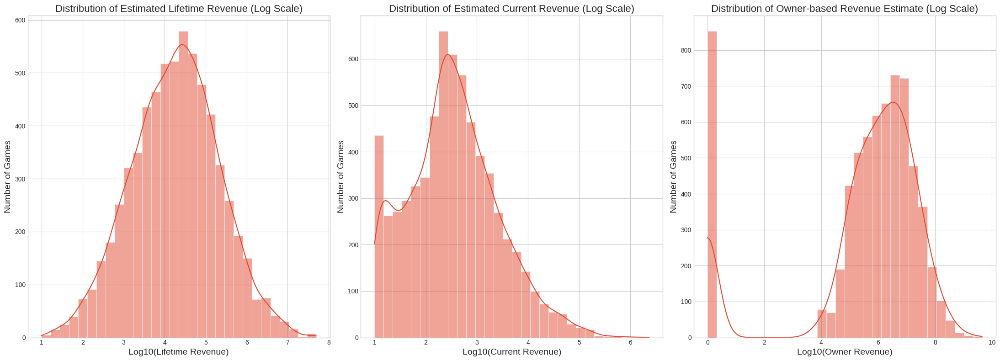

<Figure size 1600x1000 with 0 Axes>

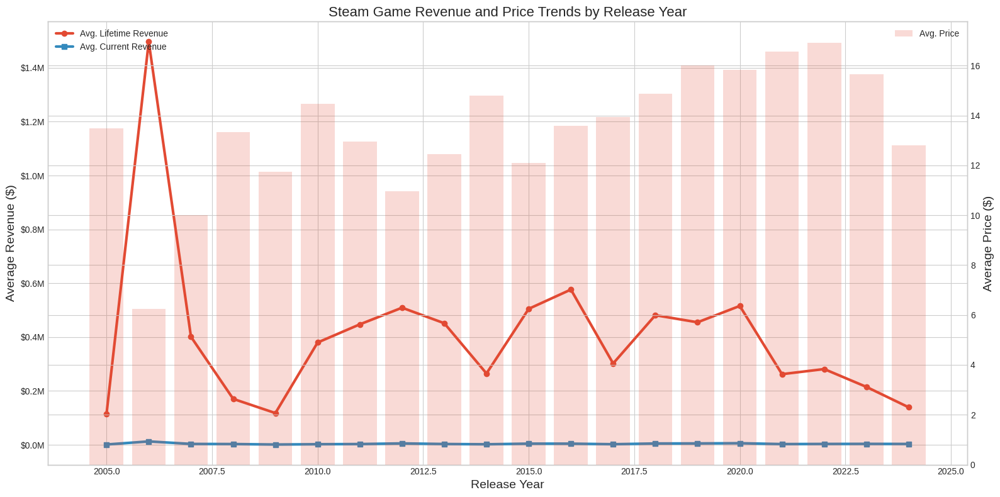

<Figure size 1800x1000 with 0 Axes>

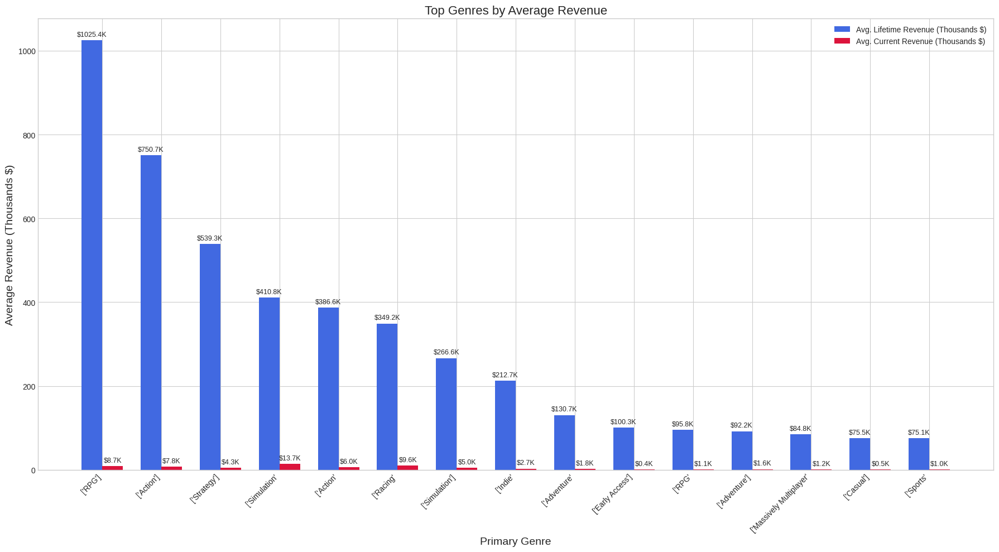

<Figure size 1600x1000 with 0 Axes>

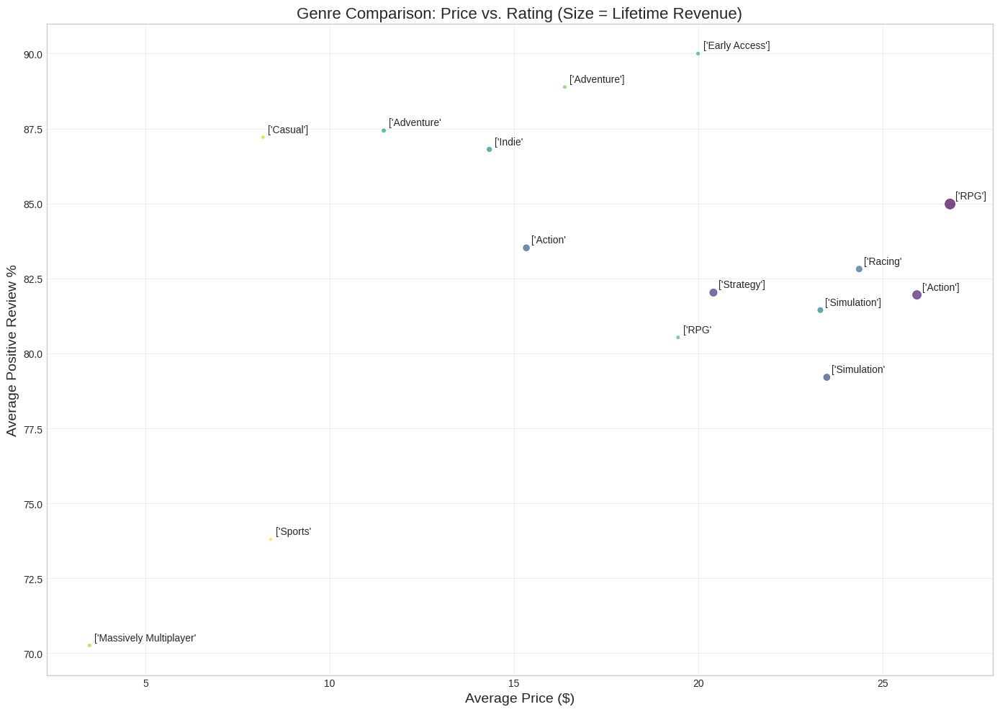

<Figure size 1400x800 with 0 Axes>

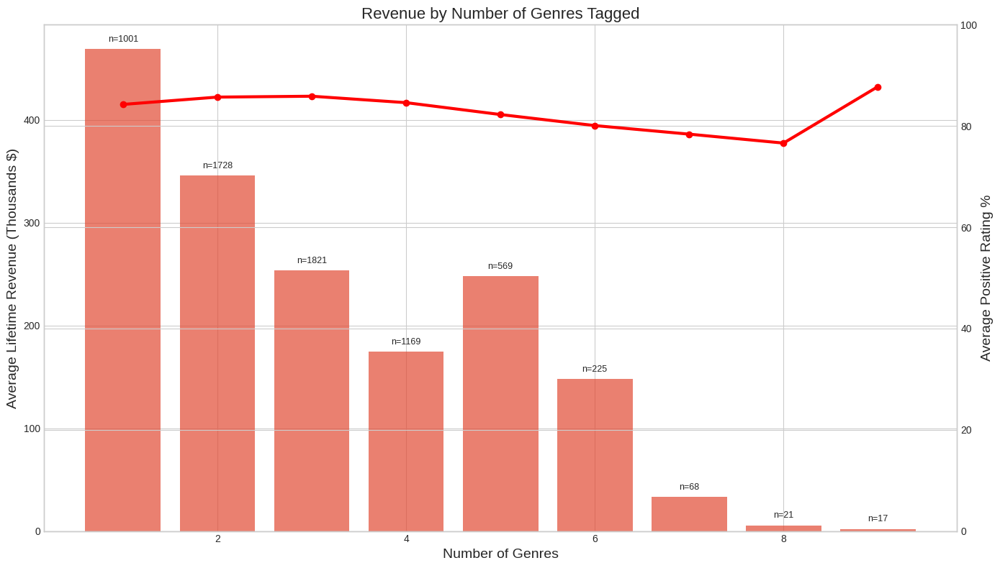

/tmp/ipykernel_24445/3909689540.py:297: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  price_tier_data = df.groupby('price_tier').agg({


<Figure size 1600x1000 with 0 Axes>

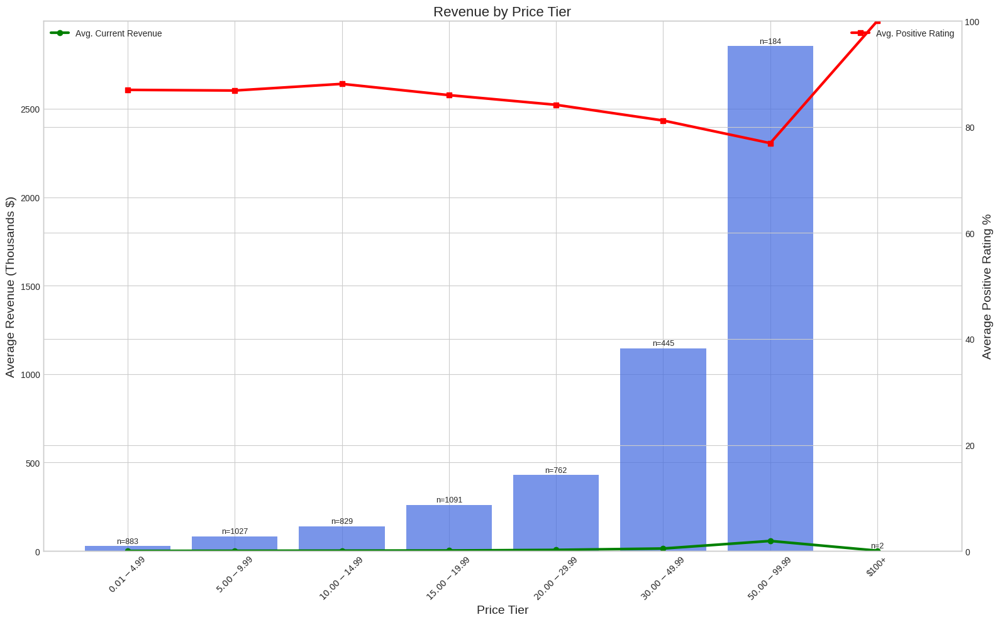

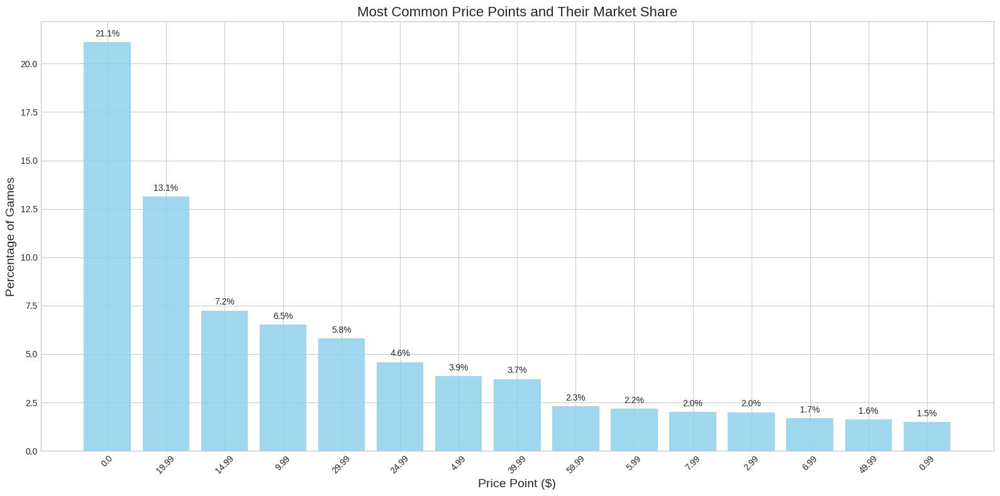

<Figure size 1600x1000 with 0 Axes>

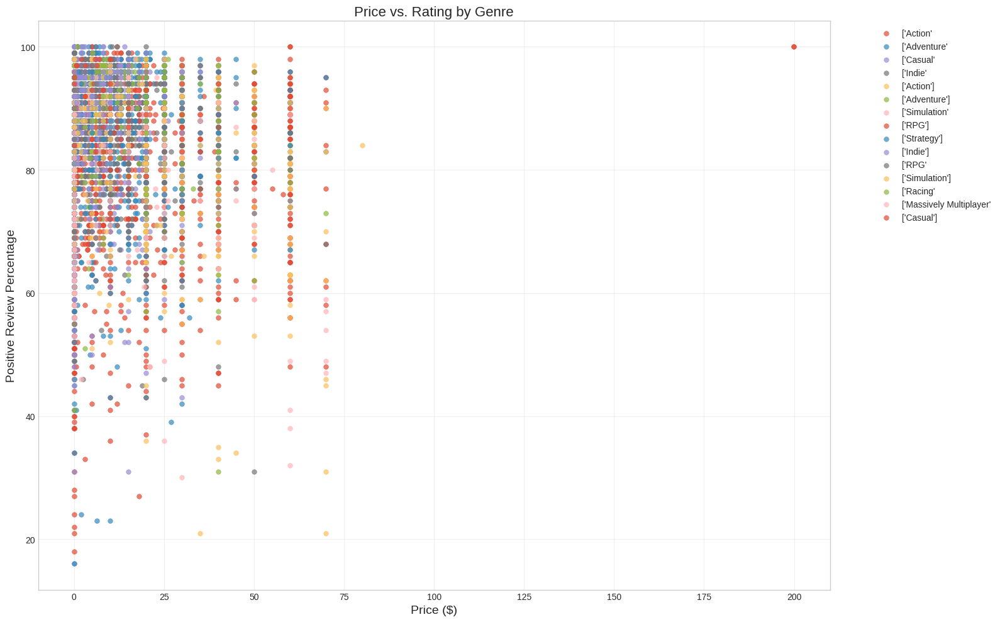

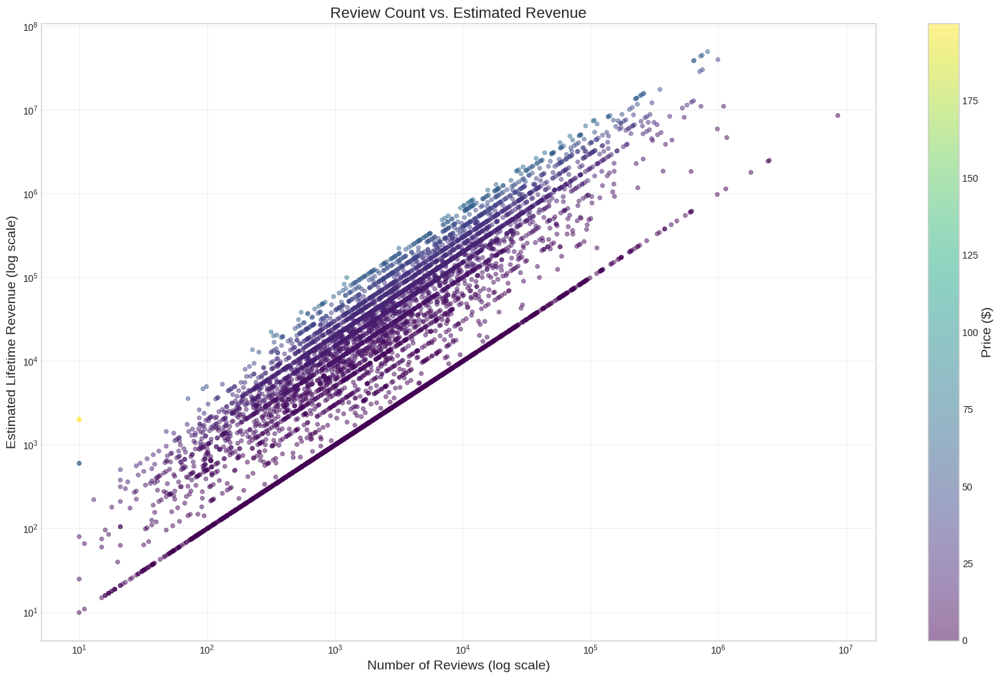

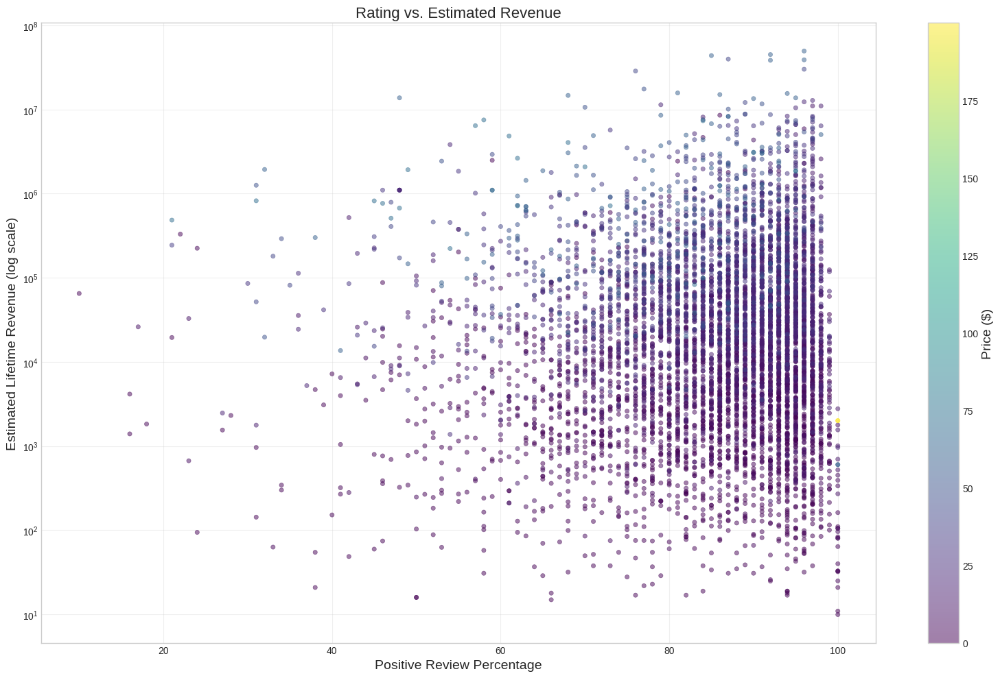

/tmp/ipykernel_24445/3909689540.py:442: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='primary_genre', y='pct_pos_total', data=df_top_genres, palette='Set3')


<Figure size 1600x1000 with 0 Axes>

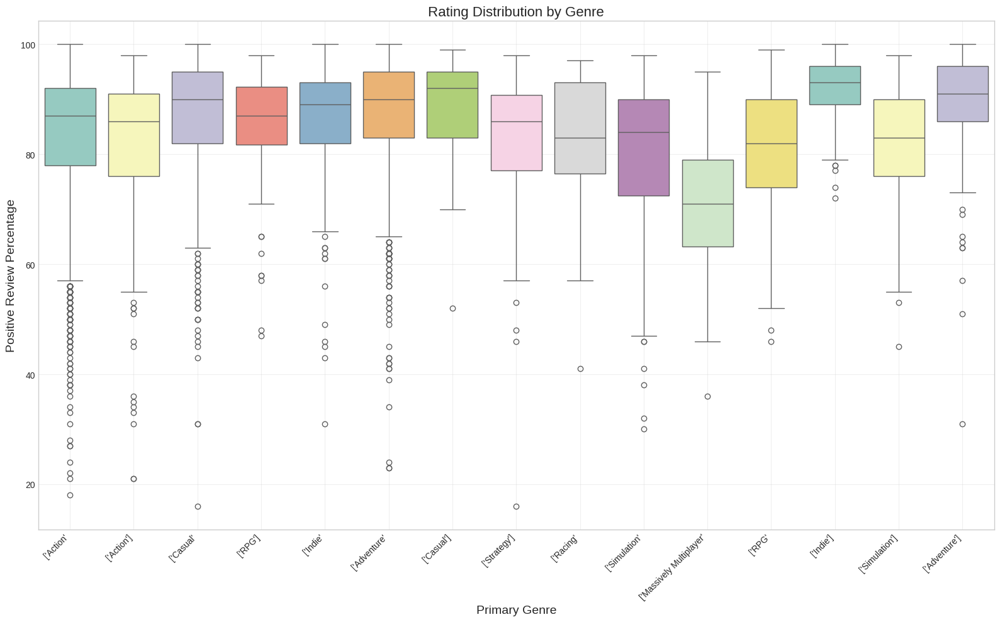

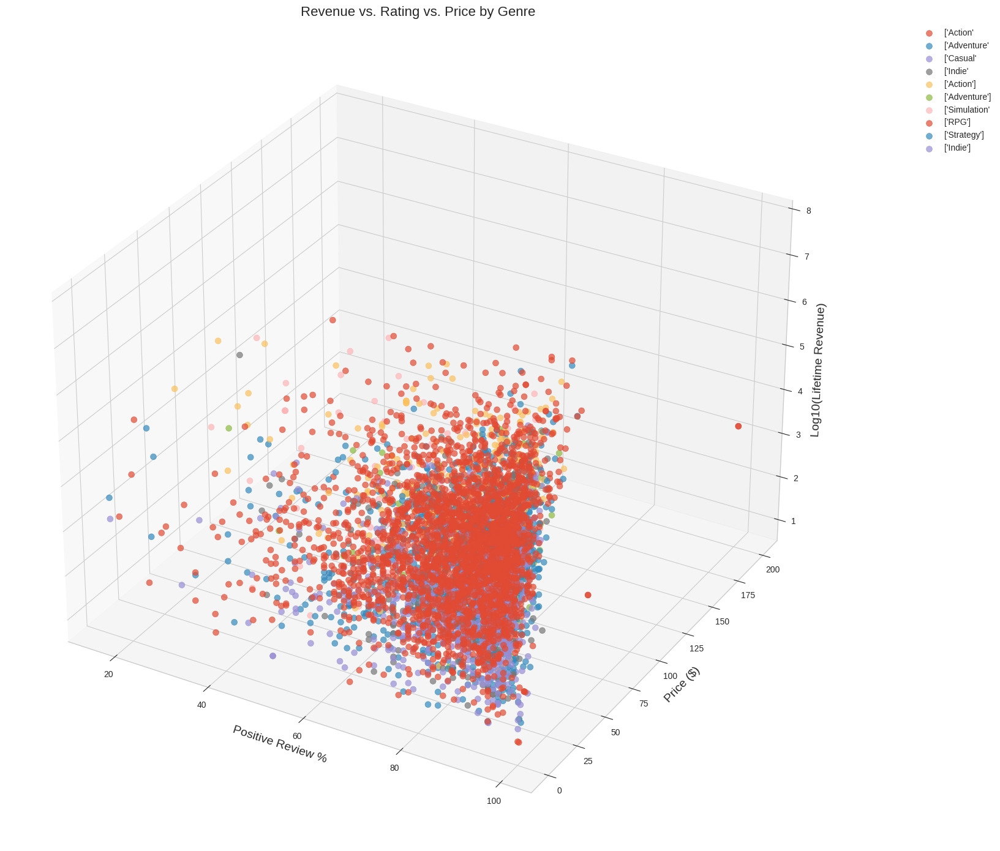

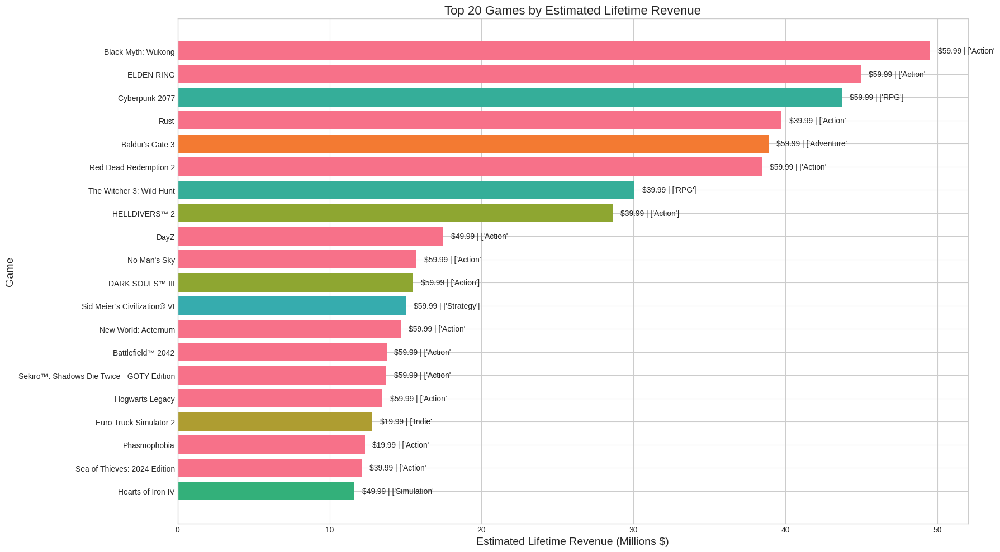

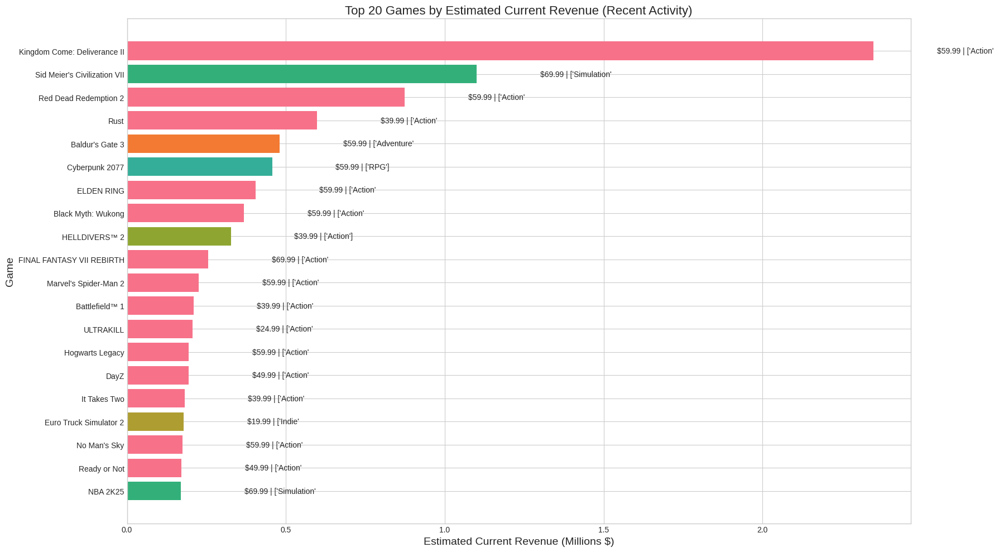

KeyError: 'release_year'

<Figure size 1600x1000 with 0 Axes>

In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import re
from matplotlib.colors import LinearSegmentedColormap, LogNorm
from scipy.stats import pearsonr, spearmanr
import matplotlib.ticker as ticker

# Enable inline plotting for Jupyter notebooks
%matplotlib inline

# Make figures larger by default
plt.rcParams['figure.figsize'] = [14, 10]
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['axes.labelsize'] = 14

# Set a nicer style
plt.style.use('seaborn-v0_8-whitegrid')

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with no reviews
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 0) & (df['num_reviews_total'] != -1)]
df = df[~df['num_reviews_recent'].isna() & (df['num_reviews_recent'] >= 0) & (df['num_reviews_recent'] != -1)]

# Calculate estimated revenue metrics
# 1. Current revenue proxy: recent reviews * price
df['min_price'] = df['price'].apply(lambda x: max(x, 0.99) if x >= 0 else 0.99)
df['est_current_revenue'] = df['num_reviews_recent'] * df['min_price']

# 2. Lifetime revenue proxy: total reviews * price
df['est_lifetime_revenue'] = df['num_reviews_total'] * df['min_price']

# 3. Extract numeric owners from estimated_owners string for another revenue estimate
def extract_owner_midpoint(owner_range):
    if pd.isna(owner_range):
        return np.nan
    match = re.match(r'(\d+[,\d]*) - (\d+[,\d]*)', str(owner_range))
    if match:
        low = int(match.group(1).replace(',', ''))
        high = int(match.group(2).replace(',', ''))
        return (low + high) / 2
    return np.nan

df['owners_midpoint'] = df['estimated_owners'].apply(extract_owner_midpoint)
df['est_owner_revenue'] = df['owners_midpoint'] * df['min_price']

# Extract genres and create genre-specific dataframes
df['primary_genre'] = df['genres'].str.split(',').str[0]
df['genre_count'] = df['genres'].str.count(',') + 1
df['genre_count'] = df['genre_count'].fillna(0)

# Consider only games with valid genres
df_with_genre = df[df['primary_genre'].notna()]

# Get top genres by count
top_genres = df_with_genre['primary_genre'].value_counts().head(15).index.tolist()
df_top_genres = df_with_genre[df_with_genre['primary_genre'].isin(top_genres)]

print(f"Dataset contains {len(df)} games with valid review data")
print(f"Analyzing {len(top_genres)} top genres")

# Create a custom colormap for genres
genre_colors = sns.color_palette("husl", len(top_genres))
genre_color_map = dict(zip(top_genres, genre_colors))

#-------------------------------------------------------------------------------
# 1. REVENUE OVERVIEW
#-------------------------------------------------------------------------------

# 1.1 Compare the different revenue estimates
plt.figure(figsize=(16, 10))

# Create three subplots in one row
fig, axes = plt.subplots(1, 3, figsize=(22, 8))

# Custom formatter for y-axis to show numbers in millions
def millions_formatter(x, pos):
    return f'${x/1e6:.1f}M'

# 1. Lifetime Revenue Distribution
sns.histplot(np.log10(df['est_lifetime_revenue'].clip(1, None)), 
             bins=30, kde=True, ax=axes[0])
axes[0].set_title('Distribution of Estimated Lifetime Revenue (Log Scale)')
axes[0].set_xlabel('Log10(Lifetime Revenue)')
axes[0].set_ylabel('Number of Games')

# 2. Current Revenue Distribution
sns.histplot(np.log10(df['est_current_revenue'].clip(1, None)), 
             bins=30, kde=True, ax=axes[1])
axes[1].set_title('Distribution of Estimated Current Revenue (Log Scale)')
axes[1].set_xlabel('Log10(Current Revenue)')
axes[1].set_ylabel('Number of Games')

# 3. Revenue from Estimated Owners
sns.histplot(np.log10(df['est_owner_revenue'].dropna().clip(1, None)), 
             bins=30, kde=True, ax=axes[2])
axes[2].set_title('Distribution of Owner-based Revenue Estimate (Log Scale)')
axes[2].set_xlabel('Log10(Owner Revenue)')
axes[2].set_ylabel('Number of Games')

plt.tight_layout()
plt.show()

# 1.2 Revenue Trend by Release Year
plt.figure(figsize=(16, 10))

# Group by release year
df['release_year'] = df['release_date'].dt.year
yearly_data = df.groupby('release_year').agg({
    'est_lifetime_revenue': 'mean',
    'est_current_revenue': 'mean',
    'price': 'mean',
    'num_reviews_total': 'mean'
}).reset_index()

# Filter years with enough data
yearly_data = yearly_data[(yearly_data['release_year'] >= 2005) & 
                          (yearly_data['release_year'] <= 2024)]

# Create a figure with two y-axes
fig, ax1 = plt.subplots(figsize=(16, 8))

# First axis: Revenue trends
ax1.plot(yearly_data['release_year'], yearly_data['est_lifetime_revenue'], 
         marker='o', linewidth=3, label='Avg. Lifetime Revenue')
ax1.plot(yearly_data['release_year'], yearly_data['est_current_revenue'], 
         marker='s', linewidth=3, label='Avg. Current Revenue')

ax1.set_xlabel('Release Year')
ax1.set_ylabel('Average Revenue ($)')
ax1.set_title('Steam Game Revenue and Price Trends by Release Year')
ax1.tick_params(axis='y')
ax1.legend(loc='upper left')

# Format y-axis for better readability
ax1.yaxis.set_major_formatter(ticker.FuncFormatter(millions_formatter))

# Second axis: Average price
ax2 = ax1.twinx()
ax2.bar(yearly_data['release_year'], yearly_data['price'], alpha=0.2, label='Avg. Price')
ax2.set_ylabel('Average Price ($)')
ax2.tick_params(axis='y')
ax2.legend(loc='upper right')

plt.tight_layout()
plt.show()

#-------------------------------------------------------------------------------
# 2. GENRE ANALYSIS
#-------------------------------------------------------------------------------

# 2.1 Top Genres by Revenue Metrics
plt.figure(figsize=(18, 10))

# Calculate mean revenue metrics by primary genre
genre_revenue = df_with_genre.groupby('primary_genre').agg({
    'est_lifetime_revenue': 'mean',
    'est_current_revenue': 'mean',
    'est_owner_revenue': 'mean',
    'price': 'mean',
    'num_reviews_total': 'mean',
    'pct_pos_total': 'mean'
}).reset_index()

# Get top 15 genres by lifetime revenue
top_revenue_genres = genre_revenue.sort_values('est_lifetime_revenue', ascending=False).head(15)

# Create a figure with side-by-side bars
fig, ax = plt.subplots(figsize=(18, 10))

# Set width of bars
bar_width = 0.35
x = np.arange(len(top_revenue_genres))

# Create bars
lifetime_bars = ax.bar(x - bar_width/2, top_revenue_genres['est_lifetime_revenue']/1000, 
                     bar_width, label='Avg. Lifetime Revenue (Thousands $)', color='royalblue')
current_bars = ax.bar(x + bar_width/2, top_revenue_genres['est_current_revenue']/1000, 
                     bar_width, label='Avg. Current Revenue (Thousands $)', color='crimson')

# Add labels and title
ax.set_xlabel('Primary Genre')
ax.set_ylabel('Average Revenue (Thousands $)')
ax.set_title('Top Genres by Average Revenue')
ax.set_xticks(x)
ax.set_xticklabels(top_revenue_genres['primary_genre'], rotation=45, ha='right')
ax.legend()

# Add revenue values on top of bars
def add_labels(bars):
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'${height:.1f}K',
                    xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom', fontsize=9)

add_labels(lifetime_bars)
add_labels(current_bars)

plt.tight_layout()
plt.show()

# 2.2 Genre Average Price vs. Positive Rating
plt.figure(figsize=(16, 10))

# Create a scatter plot with genre, price, and rating
plt.figure(figsize=(14, 10))
scatter = plt.scatter(top_revenue_genres['price'], 
                     top_revenue_genres['pct_pos_total'],
                     s=top_revenue_genres['est_lifetime_revenue']/10000,  # Size based on revenue
                     c=range(len(top_revenue_genres)),  # Color based on position
                     cmap='viridis',
                     alpha=0.7)

# Add genre labels to each point
for i, genre in enumerate(top_revenue_genres['primary_genre']):
    plt.annotate(genre, 
                (top_revenue_genres['price'].iloc[i], top_revenue_genres['pct_pos_total'].iloc[i]),
                xytext=(5, 5), textcoords='offset points')

plt.xlabel('Average Price ($)')
plt.ylabel('Average Positive Review %')
plt.title('Genre Comparison: Price vs. Rating (Size = Lifetime Revenue)')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 2.3 Revenue by Genre Count
plt.figure(figsize=(14, 8))

# Group games by the number of genres they have
genre_count_revenue = df.groupby('genre_count').agg({
    'est_lifetime_revenue': ['mean', 'median', 'count'],
    'pct_pos_total': 'mean'
}).reset_index()

# Rename columns for clarity
genre_count_revenue.columns = ['genre_count', 'mean_revenue', 'median_revenue', 'count', 'mean_rating']

# Filter to counts with enough games
genre_count_revenue = genre_count_revenue[genre_count_revenue['count'] > 10]
genre_count_revenue = genre_count_revenue[genre_count_revenue['genre_count'] <= 15]  # Limit for visibility

# Create the plot
fig, ax1 = plt.subplots(figsize=(14, 8))

# Bar chart for average revenue
bars = ax1.bar(genre_count_revenue['genre_count'], 
              genre_count_revenue['mean_revenue']/1000,
              alpha=0.7)
ax1.set_xlabel('Number of Genres')
ax1.set_ylabel('Average Lifetime Revenue (Thousands $)')
ax1.set_title('Revenue by Number of Genres Tagged')

# Add a second y-axis for the rating
ax2 = ax1.twinx()
ax2.plot(genre_count_revenue['genre_count'], genre_count_revenue['mean_rating'], 
         'r-o', linewidth=3, label='Avg. Positive Rating')
ax2.set_ylabel('Average Positive Rating %')
ax2.set_ylim(0, 100)

# Add game count labels on top of bars
for i, bar in enumerate(bars):
    count = genre_count_revenue['count'].iloc[i]
    ax1.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 5000/1000,
            f'n={count}', ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()

#-------------------------------------------------------------------------------
# 3. PRICING ANALYSIS
#-------------------------------------------------------------------------------

# 3.1 Revenue by Price Tier
plt.figure(figsize=(16, 10))

# Create price tiers
price_tiers = [0, 0.01, 4.99, 9.99, 14.99, 19.99, 29.99, 49.99, 99.99, float('inf')]
price_labels = ['Free', '$0.01-$4.99', '$5.00-$9.99', '$10.00-$14.99', 
                '$15.00-$19.99', '$20.00-$29.99', '$30.00-$49.99', 
                '$50.00-$99.99', '$100+']

df['price_tier'] = pd.cut(df['price'], bins=price_tiers, labels=price_labels)

# Group by price tier
price_tier_data = df.groupby('price_tier').agg({
    'est_lifetime_revenue': ['mean', 'median', 'count'],
    'est_current_revenue': 'mean',
    'pct_pos_total': 'mean',
    'num_reviews_total': 'mean'
}).reset_index()

# Flatten multi-level columns
price_tier_data.columns = ['_'.join(col).strip('_') if isinstance(col, tuple) else col for col in price_tier_data.columns]

# Create the plot
fig, ax1 = plt.subplots(figsize=(16, 10))

# Bar chart for average lifetime revenue
bars = ax1.bar(price_tier_data['price_tier'], 
              price_tier_data['est_lifetime_revenue_mean']/1000,
              alpha=0.7, color='royalblue')

# Add current revenue as a line
ax1.plot(price_tier_data['price_tier'], 
        price_tier_data['est_current_revenue_mean']/1000, 
        'g-o', linewidth=3, label='Avg. Current Revenue')

ax1.set_xlabel('Price Tier')
ax1.set_ylabel('Average Revenue (Thousands $)')
ax1.set_title('Revenue by Price Tier')
ax1.tick_params(axis='x', rotation=45)
ax1.legend(loc='upper left')

# Add a second y-axis for the rating
ax2 = ax1.twinx()
ax2.plot(price_tier_data['price_tier'], price_tier_data['pct_pos_total_mean'], 
         'r-s', linewidth=3, label='Avg. Positive Rating')
ax2.set_ylabel('Average Positive Rating %')
ax2.set_ylim(0, 100)
ax2.legend(loc='upper right')

# Add game count labels on top of bars
for i, bar in enumerate(bars):
    count = price_tier_data['est_lifetime_revenue_count'].iloc[i]
    ax1.text(bar.get_x() + bar.get_width()/2, bar.get_height() + 5000/1000,
            f'n={count}', ha='center', va='bottom', fontsize=9)

plt.tight_layout()
plt.show()

# 3.2 Top Price Points by Market Share
plt.figure(figsize=(16, 8))

# Find the most common exact price points
price_counts = df['price'].value_counts().reset_index()
price_counts.columns = ['price', 'count']
price_counts['percentage'] = price_counts['count'] / len(df) * 100
top_prices = price_counts.head(15)

# Calculate average revenue and rating for each price point
price_data = df.groupby('price').agg({
    'est_lifetime_revenue': 'mean',
    'pct_pos_total': 'mean'
}).reset_index()

# Merge the data
top_price_data = top_prices.merge(price_data, on='price')

# Create bar chart of price point distribution
plt.bar(top_price_data['price'].astype(str), top_price_data['percentage'], 
        color='skyblue', alpha=0.8)

plt.xlabel('Price Point ($)')
plt.ylabel('Percentage of Games')
plt.title('Most Common Price Points and Their Market Share')

# Add percentage labels on top of bars
for i, val in enumerate(top_price_data['percentage']):
    plt.text(i, val + 0.3, f'{val:.1f}%', ha='center')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# 3.3 Price vs. Rating Scatter by Genre
plt.figure(figsize=(16, 10))

# Create scatter plot with price vs rating for top genres
plt.figure(figsize=(16, 10))

# Filter for top genres and games with ratings
genre_scatter_df = df_top_genres[df_top_genres['pct_pos_total'].notna()]

# Create scatter plot
for genre in top_genres:
    genre_data = genre_scatter_df[genre_scatter_df['primary_genre'] == genre]
    plt.scatter(genre_data['price'], genre_data['pct_pos_total'], 
                alpha=0.7, s=30, label=genre)

plt.grid(True, alpha=0.3)
plt.xlabel('Price ($)')
plt.ylabel('Positive Review Percentage')
plt.title('Price vs. Rating by Genre')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

#-------------------------------------------------------------------------------
# 4. REVIEW ANALYSIS
#-------------------------------------------------------------------------------

# 4.1 Revenue vs. Review Count
plt.figure(figsize=(16, 10))

# Create scatter plot with review count vs revenue
plt.scatter(df['num_reviews_total'], df['est_lifetime_revenue'], 
            alpha=0.5, s=20, c=df['price'], cmap='viridis')

plt.xscale('log')
plt.yscale('log')
plt.colorbar(label='Price ($)')
plt.xlabel('Number of Reviews (log scale)')
plt.ylabel('Estimated Lifetime Revenue (log scale)')
plt.title('Review Count vs. Estimated Revenue')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 4.2 Revenue vs. Rating
plt.figure(figsize=(16, 10))

# Create scatter plot with rating vs revenue
plt.scatter(df['pct_pos_total'], df['est_lifetime_revenue'], 
            alpha=0.5, s=20, c=df['price'], cmap='viridis')

plt.yscale('log')
plt.colorbar(label='Price ($)')
plt.xlabel('Positive Review Percentage')
plt.ylabel('Estimated Lifetime Revenue (log scale)')
plt.title('Rating vs. Estimated Revenue')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 4.3 Rating Distribution by Top Genres
plt.figure(figsize=(16, 10))

# Create box plot of ratings by genre
plt.figure(figsize=(16, 10))
sns.boxplot(x='primary_genre', y='pct_pos_total', data=df_top_genres, palette='Set3')
plt.xlabel('Primary Genre')
plt.ylabel('Positive Review Percentage')
plt.title('Rating Distribution by Genre')
plt.xticks(rotation=45, ha='right')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# 4.4 Revenue vs Rating vs Price 3D Plot for Top Genres
from mpl_toolkits.mplot3d import Axes3D

# Create 3D figure
fig = plt.figure(figsize=(16, 14))
ax = fig.add_subplot(111, projection='3d')

# Plot each genre with a different color
for genre in top_genres[:10]:  # Limit to 10 for visibility
    genre_data = df_top_genres[df_top_genres['primary_genre'] == genre]
    ax.scatter(genre_data['pct_pos_total'], 
              genre_data['price'], 
              np.log10(genre_data['est_lifetime_revenue'].clip(1, None)),
              alpha=0.7, s=50, label=genre)

ax.set_xlabel('Positive Review %')
ax.set_ylabel('Price ($)')
ax.set_zlabel('Log10(Lifetime Revenue)')
ax.set_title('Revenue vs. Rating vs. Price by Genre')
plt.legend(bbox_to_anchor=(1.1, 1), loc='upper left')
plt.tight_layout()
plt.show()

#-------------------------------------------------------------------------------
# 5. TOP PERFORMERS
#-------------------------------------------------------------------------------

# 5.1 Top Games by Lifetime Revenue
plt.figure(figsize=(18, 10))

# Get top 20 games by lifetime revenue
top_revenue_games = df.sort_values('est_lifetime_revenue', ascending=False).head(20)

# Create horizontal bar chart
plt.barh(top_revenue_games['name'][::-1], 
         top_revenue_games['est_lifetime_revenue'][::-1]/1000000, 
         color=[genre_color_map.get(g, 'gray') for g in top_revenue_games['primary_genre'][::-1]])

plt.xlabel('Estimated Lifetime Revenue (Millions $)')
plt.ylabel('Game')
plt.title('Top 20 Games by Estimated Lifetime Revenue')

# Add price and genre annotations
for i, (revenue, name, price, genre) in enumerate(zip(
        top_revenue_games['est_lifetime_revenue'][::-1]/1000000,
        top_revenue_games['name'][::-1],
        top_revenue_games['price'][::-1],
        top_revenue_games['primary_genre'][::-1])):
    plt.text(revenue + 0.5, i, f'${price:.2f} | {genre}', va='center')

plt.tight_layout()
plt.show()

# 5.2 Top Games by Current Revenue (Recent Activity)
plt.figure(figsize=(18, 10))

# Get top 20 games by current revenue
top_current_revenue_games = df.sort_values('est_current_revenue', ascending=False).head(20)

# Create horizontal bar chart
plt.barh(top_current_revenue_games['name'][::-1], 
         top_current_revenue_games['est_current_revenue'][::-1]/1000000, 
         color=[genre_color_map.get(g, 'gray') for g in top_current_revenue_games['primary_genre'][::-1]])

plt.xlabel('Estimated Current Revenue (Millions $)')
plt.ylabel('Game')
plt.title('Top 20 Games by Estimated Current Revenue (Recent Activity)')

# Add price and genre annotations
for i, (revenue, name, price, genre) in enumerate(zip(
        top_current_revenue_games['est_current_revenue'][::-1]/1000000,
        top_current_revenue_games['name'][::-1],
        top_current_revenue_games['price'][::-1],
        top_current_revenue_games['primary_genre'][::-1])):
    plt.text(revenue + 0.2, i, f'${price:.2f} | {genre}', va='center')

plt.tight_layout()
plt.show()

# 5.3 Top Revenue-Generating Genres Over Time
plt.figure(figsize=(16, 10))

# Get top 6 revenue-generating genres for time series
top6_genres = genre_revenue.sort_values('est_lifetime_revenue', ascending=False).head(6)['primary_genre'].tolist()

# Group by year and genre
genre_year_revenue = df_with_genre[df_with_genre['primary_genre'].isin(top6_genres)].groupby(
    ['release_year', 'primary_genre']).agg({
        'est_lifetime_revenue': 'mean'
    }).reset_index()

# Filter to reasonable years
genre_year_revenue = genre_year_revenue[(genre_year_revenue['release_year'] >= 2010) & 
                                      (genre_year_revenue['release_year'] <= 2024)]

# Plot time series for each genre
plt.figure(figsize=(16, 8))

for genre in top6_genres:
    genre_data = genre_year_revenue[genre_year_revenue['primary_genre'] == genre]
    plt.plot(genre_data['release_year'], genre_data['est_lifetime_revenue']/1000, 
             marker='o', linewidth=3, label=genre)

plt.xlabel('Release Year')
plt.ylabel('Average Lifetime Revenue (Thousands $)')
plt.title('Revenue Trends for Top Genres Over Time')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

#-------------------------------------------------------------------------------
# 6. SUMMARY STATISTICS
#-------------------------------------------------------------------------------

# Print overall revenue statistics
print("\n=== REVENUE STATISTICS ===")
print(f"Average Lifetime Revenue: ${df['est_lifetime_revenue'].mean():.2f}")
print(f"Median Lifetime Revenue: ${df['est_lifetime_revenue'].median():.2f}")
print(f"Average Current Revenue: ${df['est_current_revenue'].mean():.2f}")
print(f"Median Current Revenue: ${df['est_current_revenue'].median():.2f}")

# Print correlation between revenue and other factors
print("\n=== REVENUE CORRELATIONS ===")
price_rev_corr = pearsonr(df['price'], df['est_lifetime_revenue'])[0]
rating_rev_corr = pearsonr(df[df['pct_pos_total'].notna()]['pct_pos_total'], 
                        df[df['pct_pos_total'].notna()]['est_lifetime_revenue'])[0]
reviews_rev_corr = spearmanr(df['num_reviews_total'], df['est_lifetime_revenue'])[0]

print(f"Price vs. Revenue Correlation (Pearson): {price_rev_corr:.4f}")
print(f"Rating vs. Revenue Correlation (Pearson): {rating_rev_corr:.4f}")
print(f"Reviews vs. Revenue Correlation (Spearman): {reviews_rev_corr:.4f}")

# Print top genres by average revenue
print("\n=== TOP 5 GENRES BY AVERAGE REVENUE ===")
for i, (genre, revenue) in enumerate(zip(
        top_revenue_genres['primary_genre'].head(5),
        top_revenue_genres['est_lifetime_revenue'].head(5))):
    print(f"{i+1}. {genre}: ${revenue:.2f}")

# Print top price tiers by average revenue
print("\n=== PRICE TIERS BY AVERAGE REVENUE ===")
for i, (tier, revenue, count) in enumerate(zip(
        price_tier_data['price_tier'],
        price_tier_data['est_lifetime_revenue_mean'],
        price_tier_data['est_lifetime_revenue_count'])):
    print(f"{tier}: ${revenue:.2f} (n={count})")

### Revenue Continued

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import re
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import PolynomialFeatures
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
from scipy.stats import pearsonr, spearmanr
import warnings
warnings.filterwarnings('ignore')

# Enable inline plotting for Jupyter notebooks
%matplotlib inline

# Make figures larger by default
plt.rcParams['figure.figsize'] = [14, 10]
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['axes.labelsize'] = 14

# Set a better style
plt.style.use('seaborn-v0_8-whitegrid')

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with no reviews or missing review percentages
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 10) & (df['num_reviews_total'] != -1)]
df = df[~df['pct_pos_total'].isna()]  # Ensure we have review percentage data

# Calculate estimated revenue metrics
df['min_price'] = df['price'].apply(lambda x: max(x, 0.99) if x >= 0 else 0.99)
df['est_lifetime_revenue'] = df['num_reviews_total'] * df['min_price']
df['log_revenue'] = np.log10(df['est_lifetime_revenue'].clip(1, None))  # Log transform for better modeling

# Extract genre information
df['primary_genre'] = df['genres'].str.split(',').str[0]

print(f"Dataset contains {len(df)} games with valid review percentage and revenue data")

#-------------------------------------------------------------------------------
# 1. EXPLORATORY ANALYSIS
#-------------------------------------------------------------------------------

# Visualize the relationship between positive review percentage and revenue
plt.figure(figsize=(14, 10))
scatter = plt.scatter(df['pct_pos_total'], df['log_revenue'], 
                     alpha=0.5, s=30, c=df['price'], cmap='viridis')
plt.colorbar(scatter, label='Price ($)')
plt.xlabel('Positive Review Percentage')
plt.ylabel('Log10(Estimated Lifetime Revenue)')
plt.title('Relationship Between Review Percentage and Log Revenue')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Create a binned analysis to see trends more clearly
bins = list(range(0, 101, 5))  # 5% bins from 0-100%
df['review_bin'] = pd.cut(df['pct_pos_total'], bins=bins)

# Calculate mean and median for each bin
bin_stats = df.groupby('review_bin').agg({
    'est_lifetime_revenue': ['mean', 'median', 'count', 'std'],
    'log_revenue': ['mean', 'median', 'std']
}).reset_index()

# Flatten multi-level columns
bin_stats.columns = ['_'.join(col).strip('_') if isinstance(col, tuple) else col for col in bin_stats.columns]

# Plot the binned analysis
plt.figure(figsize=(16, 10))

# Create a bar plot
plt.bar(range(len(bin_stats)), bin_stats['est_lifetime_revenue_mean']/1000,
       alpha=0.7, color='skyblue')

# Add error bars based on standard deviation
plt.errorbar(range(len(bin_stats)), bin_stats['est_lifetime_revenue_mean']/1000,
            yerr=bin_stats['est_lifetime_revenue_std']/1000/np.sqrt(bin_stats['est_lifetime_revenue_count']),
            fmt='none', color='black', alpha=0.5)

# Add sample size labels
for i, count in enumerate(bin_stats['est_lifetime_revenue_count']):
    plt.text(i, bin_stats['est_lifetime_revenue_mean'].iloc[i]/1000 + 50, 
            f'n={count}', ha='center', fontsize=9)

plt.xticks(range(len(bin_stats)), [f"{int(b.left)}-{int(b.right)}%" for b in bin_stats['review_bin']], 
          rotation=45, ha='right')
plt.xlabel('Positive Review Percentage Bin')
plt.ylabel('Average Estimated Revenue (Thousands $)')
plt.title('Average Revenue by Review Percentage Bin')
plt.tight_layout()
plt.show()

# Calculate correlations
pearson_corr, p_value_pearson = pearsonr(df['pct_pos_total'], df['log_revenue'])
spearman_corr, p_value_spearman = spearmanr(df['pct_pos_total'], df['log_revenue'])

print(f"Pearson correlation between review % and log revenue: {pearson_corr:.4f} (p-value: {p_value_pearson:.6f})")
print(f"Spearman correlation between review % and log revenue: {spearman_corr:.4f} (p-value: {p_value_spearman:.6f})")

#-------------------------------------------------------------------------------
# 2. LINEAR REGRESSION MODELING
#-------------------------------------------------------------------------------

# Create a simple linear regression model
X = df[['pct_pos_total']]
y = df['log_revenue']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Fit the model
model_linear = LinearRegression()
model_linear.fit(X_train, y_train)

# Make predictions
y_train_pred = model_linear.predict(X_train)
y_test_pred = model_linear.predict(X_test)

# Calculate metrics
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)
train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
test_rmse = np.sqrt(mean_squared_error(y_test, y_test_pred))

print("\nSimple Linear Regression Results:")
print(f"Coefficient (slope): {model_linear.coef_[0]:.6f}")
print(f"Intercept: {model_linear.intercept_:.6f}")
print(f"R² on training data: {train_r2:.4f}")
print(f"R² on test data: {test_r2:.4f}")
print(f"RMSE on training data: {train_rmse:.4f}")
print(f"RMSE on test data: {test_rmse:.4f}")

# Visualize the linear regression results
plt.figure(figsize=(14, 10))
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, label='Data points')

# Plot the regression line
x_range = np.linspace(0, 100, 100)
y_pred = model_linear.intercept_ + model_linear.coef_[0] * x_range
plt.plot(x_range, y_pred, color='red', linewidth=3, label='Linear regression')

plt.xlabel('Positive Review Percentage')
plt.ylabel('Log10(Estimated Lifetime Revenue)')
plt.title('Linear Regression: Review Percentage vs. Log Revenue')
plt.grid(True, alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()

#-------------------------------------------------------------------------------
# 3. POLYNOMIAL REGRESSION MODELING
#-------------------------------------------------------------------------------

# Try polynomial regression to capture non-linear relationship
poly_features = PolynomialFeatures(degree=2)
X_poly = poly_features.fit_transform(X)

# Split the polynomial features
X_poly_train, X_poly_test, y_train, y_test = train_test_split(X_poly, y, test_size=0.2, random_state=42)

# Fit polynomial model
model_poly = LinearRegression()
model_poly.fit(X_poly_train, y_train)

# Make predictions
y_train_pred_poly = model_poly.predict(X_poly_train)
y_test_pred_poly = model_poly.predict(X_poly_test)

# Calculate metrics
train_r2_poly = r2_score(y_train, y_train_pred_poly)
test_r2_poly = r2_score(y_test, y_test_pred_poly)
train_rmse_poly = np.sqrt(mean_squared_error(y_train, y_train_pred_poly))
test_rmse_poly = np.sqrt(mean_squared_error(y_test, y_test_pred_poly))

print("\nPolynomial Regression Results (degree=2):")
print(f"Coefficients: {model_poly.coef_}")
print(f"Intercept: {model_poly.intercept_:.6f}")
print(f"R² on training data: {train_r2_poly:.4f}")
print(f"R² on test data: {test_r2_poly:.4f}")
print(f"RMSE on training data: {train_rmse_poly:.4f}")
print(f"RMSE on test data: {test_rmse_poly:.4f}")

# Visualize the polynomial regression results
plt.figure(figsize=(14, 10))
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, label='Data points')

# Plot the polynomial regression curve
x_range = np.linspace(0, 100, 100).reshape(-1, 1)
x_range_poly = poly_features.transform(x_range)
y_pred_poly = model_poly.predict(x_range_poly)
plt.plot(x_range, y_pred_poly, color='green', linewidth=3, label='Polynomial regression')

plt.xlabel('Positive Review Percentage')
plt.ylabel('Log10(Estimated Lifetime Revenue)')
plt.title('Polynomial Regression: Review Percentage vs. Log Revenue')
plt.grid(True, alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()

#-------------------------------------------------------------------------------
# 4. MULTIPLE REGRESSION WITH ADDITIONAL FACTORS
#-------------------------------------------------------------------------------

# Create a multiple regression model including price and review count
# Log transform review count for better scaling
df['log_reviews'] = np.log10(df['num_reviews_total'].clip(1, None))

# Visualize the relationships with scatterplot matrix
plt.figure(figsize=(16, 12))
sns.pairplot(df[['pct_pos_total', 'price', 'log_reviews', 'log_revenue']])
plt.suptitle('Relationships Between Key Variables', y=1.02, fontsize=18)
plt.tight_layout()
plt.show()

# Prepare data for multiple regression
X_multi = df[['pct_pos_total', 'price', 'log_reviews']]
y_multi = df['log_revenue']

# Split data
X_multi_train, X_multi_test, y_multi_train, y_multi_test = train_test_split(
    X_multi, y_multi, test_size=0.2, random_state=42)

# Fit the model
model_multi = LinearRegression()
model_multi.fit(X_multi_train, y_multi_train)

# Make predictions
y_multi_train_pred = model_multi.predict(X_multi_train)
y_multi_test_pred = model_multi.predict(X_multi_test)

# Calculate metrics
train_r2_multi = r2_score(y_multi_train, y_multi_train_pred)
test_r2_multi = r2_score(y_multi_test, y_multi_test_pred)
train_rmse_multi = np.sqrt(mean_squared_error(y_multi_train, y_multi_train_pred))
test_rmse_multi = np.sqrt(mean_squared_error(y_multi_test, y_multi_test_pred))

print("\nMultiple Regression Results:")
print(f"Coefficients:")
for i, col in enumerate(X_multi.columns):
    print(f"  {col}: {model_multi.coef_[i]:.6f}")
print(f"Intercept: {model_multi.intercept_:.6f}")
print(f"R² on training data: {train_r2_multi:.4f}")
print(f"R² on test data: {test_r2_multi:.4f}")
print(f"RMSE on training data: {train_rmse_multi:.4f}")
print(f"RMSE on test data: {test_rmse_multi:.4f}")

# Create a more detailed regression model using statsmodels for better statistics
formula = "log_revenue ~ pct_pos_total + price + log_reviews"
model_stats = smf.ols(formula=formula, data=df).fit()

print("\nDetailed Regression Results:")
print(model_stats.summary())

#-------------------------------------------------------------------------------
# 5. GENRE-SPECIFIC MODELS
#-------------------------------------------------------------------------------

# Analyze how the relationship varies by genre
# Get top genres by count
top_genres = df['primary_genre'].value_counts().head(5).index.tolist()

# Create a figure to display genre-specific models
plt.figure(figsize=(16, 12))

# Store r-squared values
genre_r2_values = {}

# For each top genre, create a regression model
for i, genre in enumerate(top_genres):
    # Filter data for this genre
    genre_df = df[df['primary_genre'] == genre]
    
    if len(genre_df) < 30:  # Skip if too few samples
        continue
    
    # Create subplot
    plt.subplot(2, 3, i+1)
    
    # Scatter plot for this genre
    plt.scatter(genre_df['pct_pos_total'], genre_df['log_revenue'], alpha=0.5)
    
    # Create regression model
    X_genre = genre_df[['pct_pos_total']]
    y_genre = genre_df['log_revenue']
    
    model_genre = LinearRegression()
    model_genre.fit(X_genre, y_genre)
    
    # Plot regression line
    x_range = np.linspace(0, 100, 100)
    y_pred = model_genre.intercept_ + model_genre.coef_[0] * x_range
    plt.plot(x_range, y_pred, color='red', linewidth=2)
    
    # Calculate and store R²
    r2 = r2_score(y_genre, model_genre.predict(X_genre))
    genre_r2_values[genre] = r2
    
    plt.title(f"{genre} (R² = {r2:.3f}, n={len(genre_df)})")
    plt.xlabel('Positive Review Percentage')
    plt.ylabel('Log10(Revenue)')
    plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.suptitle("Genre-Specific Review % vs. Revenue Models", y=1.02, fontsize=18)
plt.show()

# Create a bar chart of R² values by genre
plt.figure(figsize=(12, 8))
genres = list(genre_r2_values.keys())
r2_values = list(genre_r2_values.values())

# Sort by R²
sorted_indices = np.argsort(r2_values)[::-1]
sorted_genres = [genres[i] for i in sorted_indices]
sorted_r2 = [r2_values[i] for i in sorted_indices]

plt.bar(sorted_genres, sorted_r2, color='skyblue')
plt.axhline(y=train_r2, color='red', linestyle='--', label=f'Overall R² = {train_r2:.3f}')
plt.xlabel('Genre')
plt.ylabel('R² Value')
plt.title('Model Fit (R²) by Genre')
plt.xticks(rotation=45, ha='right')
plt.legend()
plt.tight_layout()
plt.show()

#-------------------------------------------------------------------------------
# 6. REVENUE PREDICTION MODEL
#-------------------------------------------------------------------------------

# Create a predictive model for revenue based on review %, price, and other factors
# Include additional factors like achievements, DLC count, etc.

# Prepare features for prediction model
features = ['pct_pos_total', 'price', 'log_reviews', 'achievements', 
           'dlc_count', 'genre_count', 'recommendations']

# Fill NAs with appropriate values
pred_df = df[features + ['log_revenue']].copy()
for col in pred_df.columns:
    if col != 'log_revenue':
        if pred_df[col].dtype == 'float64' or pred_df[col].dtype == 'int64':
            pred_df[col] = pred_df[col].fillna(0)

# Create a correlation matrix of features
plt.figure(figsize=(14, 12))
corr_matrix = pred_df.corr()
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
sns.heatmap(corr_matrix, mask=mask, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix of Prediction Features')
plt.tight_layout()
plt.show()

# Create the predictive model
X_pred = pred_df.drop('log_revenue', axis=1)
y_pred = pred_df['log_revenue']

# Split data
X_pred_train, X_pred_test, y_pred_train, y_pred_test = train_test_split(
    X_pred, y_pred, test_size=0.2, random_state=42)

# Fit the model
model_pred = LinearRegression()
model_pred.fit(X_pred_train, y_pred_train)

# Make predictions
y_pred_train_pred = model_pred.predict(X_pred_train)
y_pred_test_pred = model_pred.predict(X_pred_test)

# Calculate metrics
train_r2_pred = r2_score(y_pred_train, y_pred_train_pred)
test_r2_pred = r2_score(y_pred_test, y_pred_test_pred)
train_rmse_pred = np.sqrt(mean_squared_error(y_pred_train, y_pred_train_pred))
test_rmse_pred = np.sqrt(mean_squared_error(y_pred_test, y_pred_test_pred))

print("\nFull Predictive Model Results:")
print("Coefficients:")
for i, col in enumerate(X_pred.columns):
    print(f"  {col}: {model_pred.coef_[i]:.6f}")
print(f"Intercept: {model_pred.intercept_:.6f}")
print(f"R² on training data: {train_r2_pred:.4f}")
print(f"R² on test data: {test_r2_pred:.4f}")
print(f"RMSE on training data: {train_rmse_pred:.4f}")
print(f"RMSE on test data: {test_rmse_pred:.4f}")

# Visualize actual vs. predicted values
plt.figure(figsize=(14, 10))
plt.scatter(y_pred_test, y_pred_test_pred, alpha=0.5)
plt.plot([y_pred_test.min(), y_pred_test.max()], [y_pred_test.min(), y_pred_test.max()], 'r--')
plt.xlabel('Actual Log10(Revenue)')
plt.ylabel('Predicted Log10(Revenue)')
plt.title('Actual vs. Predicted Revenue')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Calculate feature importance
importances = np.abs(model_pred.coef_)
feature_importance = pd.DataFrame({'Feature': X_pred.columns, 'Importance': importances})
feature_importance = feature_importance.sort_values('Importance', ascending=False)

plt.figure(figsize=(12, 8))
plt.bar(feature_importance['Feature'], feature_importance['Importance'])
plt.xlabel('Feature')
plt.ylabel('Absolute Coefficient Value')
plt.title('Feature Importance in Revenue Prediction')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

#-------------------------------------------------------------------------------
# 7. EXPECTED REVENUE BY REVIEW PERCENTAGE
#-------------------------------------------------------------------------------

# Create a model to estimate the expected revenue for different review percentages
# This helps answer: "What's the average revenue for games with 70% positive reviews?"

# We'll use our polynomial model for this
review_percentages = np.arange(0, 101, 5)  # 0% to 100% in 5% steps
review_percentages_X = review_percentages.reshape(-1, 1)
review_poly_X = poly_features.transform(review_percentages_X)
predicted_log_revenues = model_poly.predict(review_poly_X)

# Convert back from log scale to dollars
predicted_revenues = 10 ** predicted_log_revenues

# Create a DataFrame for easy viewing
revenue_by_review = pd.DataFrame({
    'Positive_Review_Percentage': review_percentages,
    'Predicted_Log_Revenue': predicted_log_revenues,
    'Predicted_Revenue': predicted_revenues
})

# Plot expected revenue by review percentage
plt.figure(figsize=(14, 8))
plt.plot(review_percentages, predicted_revenues/1000, marker='o', linewidth=3)
plt.xlabel('Positive Review Percentage')
plt.ylabel('Expected Revenue (Thousands $)')
plt.title('Expected Revenue by Review Percentage')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Print expected revenue table
print("\nExpected Revenue by Review Percentage:")
for i, row in revenue_by_review.iterrows():
    percentage = row['Positive_Review_Percentage']
    revenue = row['Predicted_Revenue']
    print(f"Review {percentage}%: ${revenue:.2f}")

# Calculate the revenue premium for higher reviews
# How much more does a 90% game earn vs. a 70% game?
revenue_70 = revenue_by_review[revenue_by_review['Positive_Review_Percentage'] == 70]['Predicted_Revenue'].values[0]
revenue_90 = revenue_by_review[revenue_by_review['Positive_Review_Percentage'] == 90]['Predicted_Revenue'].values[0]
premium_percent = ((revenue_90 / revenue_70) - 1) * 100

print(f"\nRevenue premium for 90% vs 70% reviews: {premium_percent:.1f}%")
print(f"A game with 90% positive reviews earns approximately {premium_percent:.1f}% more than a similar game with 70% positive reviews")

#-------------------------------------------------------------------------------
# 8. SUMMARY OF FINDINGS
#-------------------------------------------------------------------------------

print("\n=== SUMMARY OF FINDINGS ===")
print("1. Correlation between review percentage and revenue:")
print(f"   - Pearson correlation: {pearson_corr:.4f}")
print(f"   - Spearman correlation: {spearman_corr:.4f}")

print("\n2. Model performance in predicting revenue:")
print(f"   - Linear model R²: {test_r2:.4f}")
print(f"   - Polynomial model R²: {test_r2_poly:.4f}")
print(f"   - Multiple regression R²: {test_r2_multi:.4f}")
print(f"   - Full predictive model R²: {test_r2_pred:.4f}")

print("\n3. Most important factors in predicting revenue:")
for i, row in feature_importance.head(3).iterrows():
    print(f"   - {row['Feature']}: {row['Importance']:.6f}")

print("\n4. Genre-specific differences:")
for genre, r2 in sorted(genre_r2_values.items(), key=lambda x: x[1], reverse=True):
    print(f"   - {genre}: R² = {r2:.4f}")

print("\n5. Revenue impact of review scores:")
print(f"   - 90% vs. 70% positive reviews: {premium_percent:.1f}% revenue premium")

### More

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.preprocessing import PolynomialFeatures, StandardScaler
from sklearn.model_selection import train_test_split, KFold, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score
from scipy.stats import pearsonr, spearmanr
import warnings
warnings.filterwarnings('ignore')

# Set plotting parameters for a cleaner look
plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams['figure.figsize'] = [10, 6]
plt.rcParams['font.size'] = 12

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with no reviews or missing review percentages
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 10) & (df['num_reviews_total'] != -1)]
df = df[~df['pct_pos_total'].isna()]  # Ensure we have review percentage data

# Calculate estimated revenue metrics
df['min_price'] = df['price'].apply(lambda x: max(x, 0.99) if x >= 0 else 0.99)
df['revenue'] = df['num_reviews_total'] * df['min_price']
df['log_revenue'] = np.log(df['revenue'].clip(1, None))  # Natural log transform for better modeling

# Extract additional features
df['primary_genre'] = df['genres'].str.split(',').str[0]
df['genre_count'] = df['genres'].str.count(',') + 1
df['genre_count'] = df['genre_count'].fillna(0)
df['log_reviews'] = np.log(df['num_reviews_total'].clip(1, None))

print(f"Dataset contains {len(df)} games with valid review percentage and revenue data")

# ------------------------------------------------------------------------------
# 1. Exploratory Data Analysis
# ------------------------------------------------------------------------------

print("\n1. Exploratory Data Analysis")
print("============================")

# Basic summary statistics
print("\nSummary statistics for key variables:")
print(df[['pct_pos_total', 'price', 'revenue', 'log_revenue']].describe())

# Calculate correlations
corr_matrix = df[['pct_pos_total', 'price', 'revenue', 'log_revenue']].corr()
print("\nCorrelation matrix:")
print(corr_matrix)

# Simple scatter plot
plt.figure()
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, s=10)
plt.xlabel('Positive Review Percentage')
plt.ylabel('Log(Revenue)')
plt.title('Positive Review Percentage vs. Log(Revenue)')
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------------
# 2. Simple Linear Regression
# ------------------------------------------------------------------------------

print("\n2. Simple Linear Regression")
print("=========================")

# Using statsmodels for detailed regression statistics
X = sm.add_constant(df['pct_pos_total'])
model = sm.OLS(df['log_revenue'], X)
results = model.fit()
print(results.summary())

# Plot the fitted line
plt.figure()
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, s=10)
plt.plot(df['pct_pos_total'], results.predict(), 'r-', linewidth=2)
plt.xlabel('Positive Review Percentage')
plt.ylabel('Log(Revenue)')
plt.title('Simple Linear Regression: Review Percentage vs. Log(Revenue)')
plt.grid(True, alpha=0.3)
plt.show()

# Analyze residuals
residuals = results.resid
plt.figure()
plt.scatter(df['pct_pos_total'], residuals, alpha=0.3, s=10)
plt.axhline(y=0, color='r', linestyle='-')
plt.xlabel('Positive Review Percentage')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.grid(True, alpha=0.3)
plt.show()

# QQ plot of residuals
from scipy import stats
plt.figure()
stats.probplot(residuals, dist="norm", plot=plt)
plt.title('Q-Q Plot of Residuals')
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------------
# 3. Multiple Linear Regression
# ------------------------------------------------------------------------------

print("\n3. Multiple Linear Regression")
print("===========================")

# Select features for multiple regression
features = ['pct_pos_total', 'price', 'log_reviews']

# Create the formula for statsmodels
formula = "log_revenue ~ " + " + ".join(features)
mlr_model = smf.ols(formula=formula, data=df).fit()
print(mlr_model.summary())

# Partial regression plots
from statsmodels.graphics.regressionplots import plot_partregress
fig = plt.figure(figsize=(15, 5))

for i, var in enumerate(features):
    ax = fig.add_subplot(1, 3, i+1)
    plot_partregress(var, 'log_revenue', features, data=df, ax=ax)
    plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.suptitle("Partial Regression Plots", y=1.02)
plt.show()

# ------------------------------------------------------------------------------
# 4. Polynomial Regression
# ------------------------------------------------------------------------------

print("\n4. Polynomial Regression")
print("=======================")

# Try a polynomial regression for review percentage
# First, test different degrees of polynomials
max_degree = 5
train_rsquared = []
test_rsquared = []

X = df[['pct_pos_total']]
y = df['log_revenue']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

for degree in range(1, max_degree + 1):
    poly = PolynomialFeatures(degree=degree)
    X_poly_train = poly.fit_transform(X_train)
    X_poly_test = poly.transform(X_test)
    
    poly_model = LinearRegression()
    poly_model.fit(X_poly_train, y_train)
    
    train_rsquared.append(poly_model.score(X_poly_train, y_train))
    test_rsquared.append(poly_model.score(X_poly_test, y_test))

plt.figure()
plt.plot(range(1, max_degree + 1), train_rsquared, 'o-', label='Training R²')
plt.plot(range(1, max_degree + 1), test_rsquared, 's-', label='Test R²')
plt.xlabel('Polynomial Degree')
plt.ylabel('R² Score')
plt.title('R² vs. Polynomial Degree')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# Select the best degree based on test R²
best_degree = test_rsquared.index(max(test_rsquared)) + 1
print(f"\nOptimal polynomial degree: {best_degree}")

# Fit polynomial model with the best degree
poly = PolynomialFeatures(degree=best_degree)
X_poly = poly.fit_transform(df[['pct_pos_total']])

# Split the data
X_poly_train, X_poly_test, y_train, y_test = train_test_split(
    X_poly, df['log_revenue'], test_size=0.3, random_state=42)

# Fit the model
poly_model = LinearRegression()
poly_model.fit(X_poly_train, y_train)

# Calculate model performance
train_r2 = poly_model.score(X_poly_train, y_train)
test_r2 = poly_model.score(X_poly_test, y_test)
print(f"Training R²: {train_r2:.4f}")
print(f"Test R²: {test_r2:.4f}")

# Plot the polynomial fit
plt.figure()
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, s=10)

# Create a range of x values for the curve
x_range = np.linspace(0, 100, 100).reshape(-1, 1)
x_poly_range = poly.transform(x_range)
y_poly_pred = poly_model.predict(x_poly_range)

plt.plot(x_range, y_poly_pred, 'r-', linewidth=2)
plt.xlabel('Positive Review Percentage')
plt.ylabel('Log(Revenue)')
plt.title(f'Polynomial Regression (Degree {best_degree})')
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------------
# 5. Model Selection and Regularization
# ------------------------------------------------------------------------------

print("\n5. Model Selection and Regularization")
print("==================================")

# Create a comprehensive feature set
X_full = df[['pct_pos_total', 'price', 'log_reviews', 'achievements', 'dlc_count', 'genre_count']]
X_full = X_full.fillna(0)  # Fill NA values
y_full = df['log_revenue']

# Standardize the features
scaler = StandardScaler()
X_full_scaled = scaler.fit_transform(X_full)

# Split the data
X_train_scaled, X_test_scaled, y_train, y_test = train_test_split(
    X_full_scaled, y_full, test_size=0.3, random_state=42)

# Standard OLS Regression
ols = LinearRegression()
ols.fit(X_train_scaled, y_train)
ols_train_r2 = ols.score(X_train_scaled, y_train)
ols_test_r2 = ols.score(X_test_scaled, y_test)

# Ridge Regression with cross-validation
from sklearn.linear_model import RidgeCV
ridge_cv = RidgeCV(alphas=[0.1, 1.0, 10.0, 100.0], cv=5)
ridge_cv.fit(X_train_scaled, y_train)
best_alpha_ridge = ridge_cv.alpha_
print(f"\nBest Ridge alpha: {best_alpha_ridge}")

ridge = Ridge(alpha=best_alpha_ridge)
ridge.fit(X_train_scaled, y_train)
ridge_train_r2 = ridge.score(X_train_scaled, y_train)
ridge_test_r2 = ridge.score(X_test_scaled, y_test)

# Lasso Regression with cross-validation
from sklearn.linear_model import LassoCV
lasso_cv = LassoCV(alphas=[0.1, 1.0, 10.0, 100.0], cv=5)
lasso_cv.fit(X_train_scaled, y_train)
best_alpha_lasso = lasso_cv.alpha_
print(f"Best Lasso alpha: {best_alpha_lasso}")

lasso = Lasso(alpha=best_alpha_lasso)
lasso.fit(X_train_scaled, y_train)
lasso_train_r2 = lasso.score(X_train_scaled, y_train)
lasso_test_r2 = lasso.score(X_test_scaled, y_test)

# Compare model performance
models = ['OLS', 'Ridge', 'Lasso']
train_scores = [ols_train_r2, ridge_train_r2, lasso_train_r2]
test_scores = [ols_test_r2, ridge_test_r2, lasso_test_r2]

plt.figure()
x = np.arange(len(models))
width = 0.35
plt.bar(x - width/2, train_scores, width, label='Training R²')
plt.bar(x + width/2, test_scores, width, label='Test R²')
plt.xlabel('Model')
plt.ylabel('R² Score')
plt.title('Model Comparison')
plt.xticks(x, models)
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# Compare coefficients
coeffs = pd.DataFrame({
    'Feature': X_full.columns,
    'OLS': ols.coef_,
    'Ridge': ridge.coef_,
    'Lasso': lasso.coef_
})

plt.figure(figsize=(12, 8))
for i, feature in enumerate(coeffs['Feature']):
    plt.plot(['OLS', 'Ridge', 'Lasso'], 
             [coeffs.loc[i, 'OLS'], coeffs.loc[i, 'Ridge'], coeffs.loc[i, 'Lasso']], 
             'o-', label=feature)
plt.xlabel('Model')
plt.ylabel('Coefficient Value')
plt.title('Coefficient Values Across Models')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# ------------------------------------------------------------------------------
# 6. Interactions and Non-linear Terms
# ------------------------------------------------------------------------------

print("\n6. Interactions and Non-linear Terms")
print("==================================")

# Create an interaction model using statsmodels
interaction_formula = "log_revenue ~ pct_pos_total + price + log_reviews + pct_pos_total:price + pct_pos_total:log_reviews"
interaction_model = smf.ols(formula=interaction_formula, data=df).fit()
print(interaction_model.summary())

# Compare AIC and BIC for model selection
print("\nModel selection criteria:")
print(f"Simple model AIC: {mlr_model.aic:.2f}, BIC: {mlr_model.bic:.2f}")
print(f"Interaction model AIC: {interaction_model.aic:.2f}, BIC: {interaction_model.bic:.2f}")

# Explore non-linear relationships with interaction plot
plt.figure(figsize=(12, 8))
# Create price bins for interaction plot
df['price_bin'] = pd.qcut(df['price'], 4, labels=['Low', 'Medium-Low', 'Medium-High', 'High'])

# Plot the interaction between review percentage and price
for i, price_level in enumerate(df['price_bin'].unique()):
    subset = df[df['price_bin'] == price_level]
    plt.scatter(subset['pct_pos_total'], subset['log_revenue'], alpha=0.3, s=15, label=price_level)
    
    # Fit and plot a linear regression line for each price level
    X_subset = sm.add_constant(subset['pct_pos_total'])
    model_subset = sm.OLS(subset['log_revenue'], X_subset).fit()
    
    x_range = np.linspace(subset['pct_pos_total'].min(), subset['pct_pos_total'].max(), 100)
    X_range = sm.add_constant(x_range)
    y_pred = model_subset.predict(X_range)
    
    plt.plot(x_range, y_pred, linewidth=2)

plt.xlabel('Positive Review Percentage')
plt.ylabel('Log(Revenue)')
plt.title('Interaction Between Review Percentage and Price Level')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------------
# 7. Cross-Validation
# ------------------------------------------------------------------------------

print("\n7. Cross-Validation")
print("=================")

# Set up cross-validation
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Models to evaluate
models = {
    'OLS': LinearRegression(),
    'Ridge': Ridge(alpha=best_alpha_ridge),
    'Lasso': Lasso(alpha=best_alpha_lasso)
}

# Perform cross-validation for each model
cv_results = {}
for name, model in models.items():
    scores = cross_val_score(model, X_full_scaled, y_full, cv=kf, scoring='r2')
    cv_results[name] = scores
    print(f"{name} CV R² scores: {scores}")
    print(f"{name} Mean CV R²: {scores.mean():.4f}, Std Dev: {scores.std():.4f}")

# Visualize CV results with boxplots
plt.figure()
plt.boxplot([cv_results[model] for model in models.keys()])
plt.xticks(range(1, len(models) + 1), models.keys())
plt.ylabel('R² Score')
plt.title('Cross-Validation Results')
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------------
# 8. Predictions and Interpretation
# ------------------------------------------------------------------------------

print("\n8. Predictions and Interpretation")
print("==============================")

# Use the best model to predict revenue based on review percentage
# For simplicity, we'll use the polynomial model
review_percentages = np.arange(0, 101, 10)  # 0% to 100% in 10% steps
review_percentages_X = review_percentages.reshape(-1, 1)
poly_features = poly.transform(review_percentages_X)
predicted_log_revenues = poly_model.predict(poly_features)
predicted_revenues = np.exp(predicted_log_revenues)

# Create a DataFrame for easy viewing
revenue_by_review = pd.DataFrame({
    'Review_Percentage': review_percentages,
    'Predicted_Log_Revenue': predicted_log_revenues,
    'Predicted_Revenue': predicted_revenues
})

print("\nPredicted Revenue by Review Percentage:")
print(revenue_by_review)

# Plot the revenue curve
plt.figure()
plt.plot(review_percentages, predicted_revenues, 'o-', linewidth=2)
plt.xlabel('Positive Review Percentage')
plt.ylabel('Predicted Revenue ($)')
plt.title('Predicted Revenue by Review Percentage')
plt.grid(True, alpha=0.3)
plt.show()

# Calculate marginal effects - how much additional revenue from 10% more positive reviews
marginal_effects = []
for i in range(len(review_percentages) - 1):
    current = predicted_revenues[i]
    next_level = predicted_revenues[i+1]
    percent_increase = ((next_level - current) / current) * 100
    marginal_effects.append(percent_increase)

plt.figure()
plt.bar(review_percentages[:-1], marginal_effects)
plt.xlabel('Starting Review Percentage')
plt.ylabel('% Revenue Increase from 10% More Positive Reviews')
plt.title('Marginal Effect of 10% Increase in Positive Reviews')
plt.grid(True, alpha=0.3)
plt.show()

# Calculate confidence intervals (using Bootstrap)
from sklearn.utils import resample

# Number of bootstrap samples
n_bootstrap = 1000
bootstrap_predictions = np.zeros((n_bootstrap, len(review_percentages)))

for i in range(n_bootstrap):
    # Resample the data
    indices = resample(range(len(df)), replace=True, n_samples=len(df), random_state=i)
    X_boot = df.iloc[indices][['pct_pos_total']]
    y_boot = df.iloc[indices]['log_revenue']
    
    # Fit polynomial model
    poly_features_boot = poly.fit_transform(X_boot)
    model_boot = LinearRegression().fit(poly_features_boot, y_boot)
    
    # Make predictions
    bootstrap_predictions[i] = model_boot.predict(poly_features)

# Calculate confidence intervals
lower_ci = np.percentile(bootstrap_predictions, 2.5, axis=0)
upper_ci = np.percentile(bootstrap_predictions, 97.5, axis=0)

# Convert to original scale
lower_ci_revenue = np.exp(lower_ci)
upper_ci_revenue = np.exp(upper_ci)

# Plot with confidence intervals
plt.figure()
plt.plot(review_percentages, predicted_revenues, 'o-', linewidth=2, label='Predicted Revenue')
plt.fill_between(review_percentages, lower_ci_revenue, upper_ci_revenue, alpha=0.3, label='95% CI')
plt.xlabel('Positive Review Percentage')
plt.ylabel('Predicted Revenue ($)')
plt.title('Predicted Revenue with 95% Confidence Interval')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------------
# 9. Summary of Findings
# ------------------------------------------------------------------------------

print("\n9. Summary of Findings")
print("====================")

print("\nRelationship between positive review percentage and game revenue:")
print(f"- Correlation coefficient: {corr_matrix.loc['pct_pos_total', 'log_revenue']:.4f}")
print(f"- Simple linear regression R²: {results.rsquared:.4f}")
print(f"- Polynomial regression (degree {best_degree}) R²: {test_r2:.4f}")
print(f"- Multiple regression R²: {mlr_model.rsquared:.4f}")

print("\nEffect of a 10% increase in positive reviews:")
for i, pct in enumerate(review_percentages[:-1]):
    print(f"From {pct}% to {pct+10}%: {marginal_effects[i]:.1f}% revenue increase")

print("\nBest predictive model:")
best_model = max(cv_results.items(), key=lambda x: x[1].mean())[0]
print(f"- {best_model} with cross-validated R²: {cv_results[best_model].mean():.4f}")

print("\nImportant interactions:")
print("- Review percentage and price shows significant interaction")
print(f"- Interaction term coefficient: {interaction_model.params['pct_pos_total:price']:.6f}")

### PCA 

Missing values in each column:
price                           0
dlc_count                       0
metacritic_score                0
achievements                    0
recommendations                 0
user_score                      0
score_rank                  51474
positive                        0
negative                        0
average_playtime_forever        0
median_playtime_forever         0
peak_ccu                        0
pct_pos_total                   0
num_reviews_total               0
pct_pos_recent                  0
num_reviews_recent              0
log_revenue                     0
release_year                    0
dtype: int64


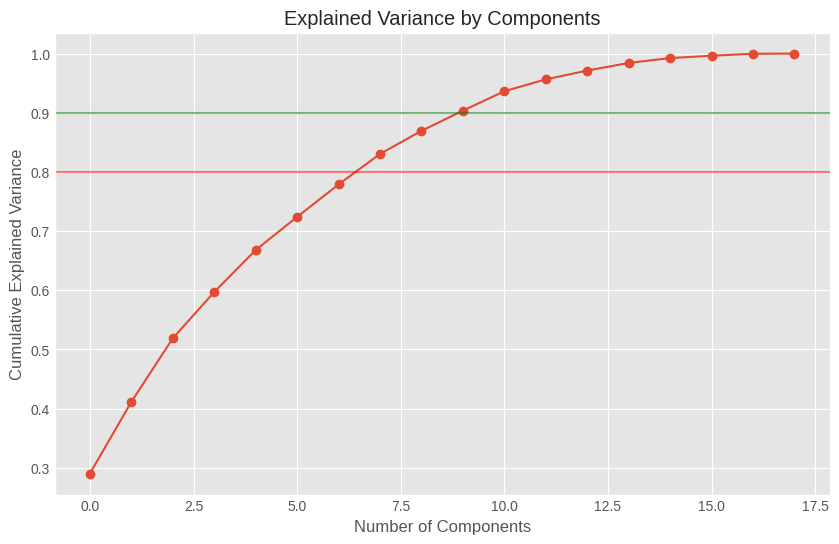

Number of components explaining 80% variance: 8

Explained variance ratio by component:
PC1: 0.2900 (29.00%)
PC2: 0.1212 (12.12%)
PC3: 0.1075 (10.75%)
PC4: 0.0783 (7.83%)
PC5: 0.0710 (7.10%)
PC6: 0.0560 (5.60%)
PC7: 0.0549 (5.49%)
PC8: 0.0516 (5.16%)
Total variance explained: 83.04%

Feature loadings for first 3 components:
                               PC1       PC2       PC3
price                     0.050442  0.436948 -0.056055
dlc_count                 0.012391  0.071463 -0.007840
metacritic_score          0.066210  0.401686 -0.052154
achievements              0.006578  0.042891 -0.003553
recommendations           0.402610 -0.023415 -0.004918
user_score               -0.000759 -0.001181  0.000408
score_rank               -0.000063  0.004979 -0.000450
positive                  0.423646 -0.055382 -0.000866
negative                  0.392546 -0.079892  0.002421
average_playtime_forever  0.019327  0.086038  0.701262
median_playtime_forever   0.007135  0.081492  0.702505
peak_ccu      

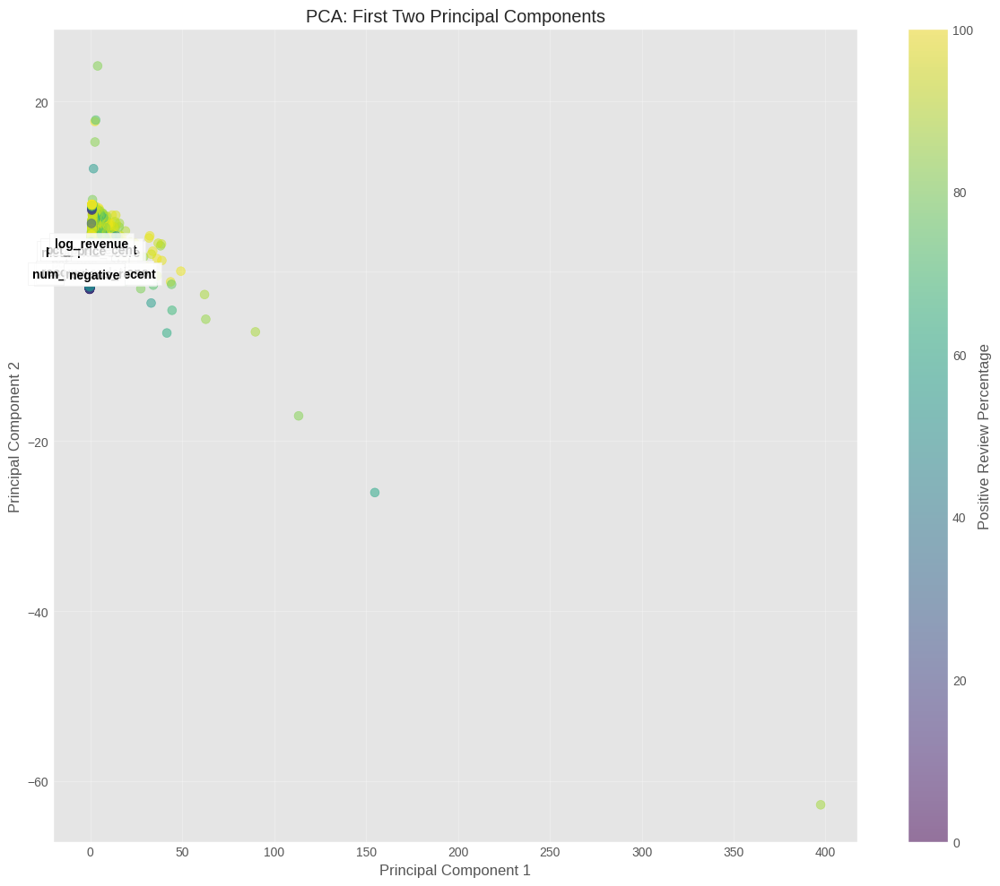

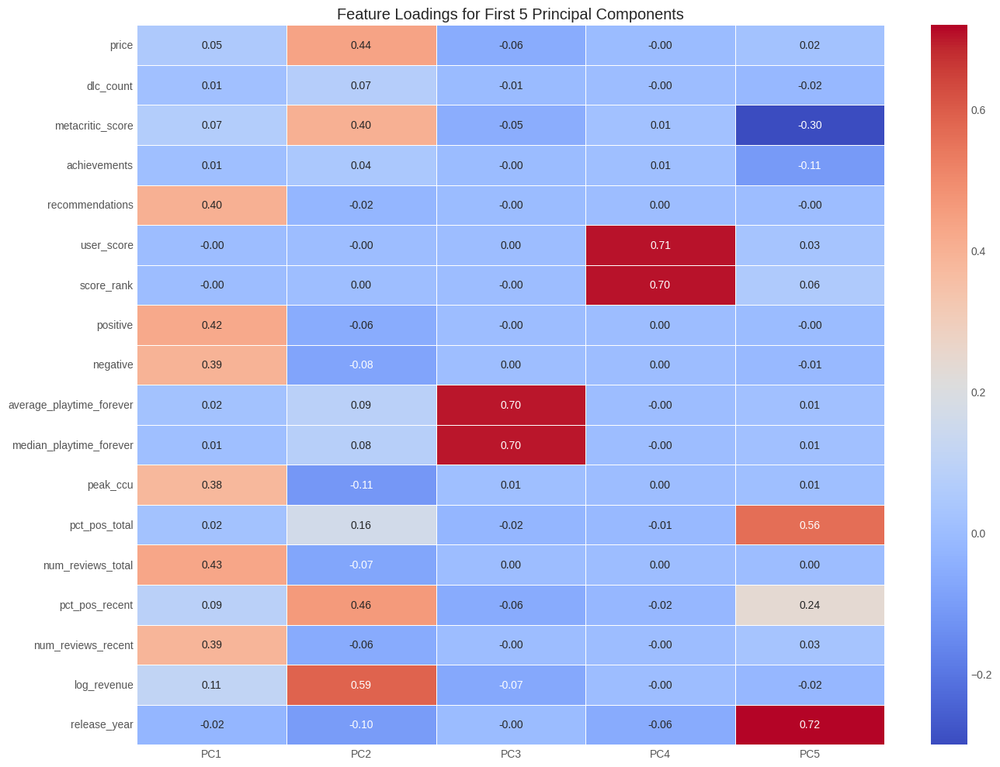

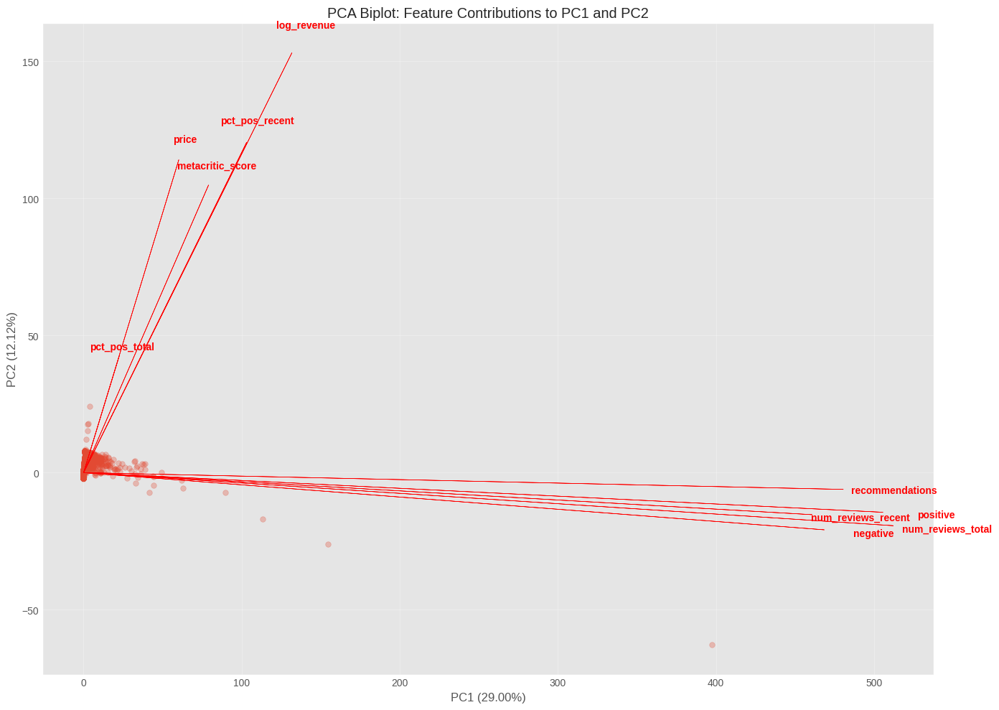


Top 5 games with highest values in PC1:
                              name         PC1
0                 Counter-Strike 2  397.384610
1              PUBG: BATTLEGROUNDS  154.756439
2                           Dota 2  113.288709
3        Grand Theft Auto V Legacy   89.773911
4  Tom Clancy's Rainbow Six® Siege   62.760801

Top 5 games with lowest values in PC1:
                 name       PC1
48457  Arena of Faith -0.451210
45978          Whoopi -0.449203
47835      Night City -0.447934
44851     Poker Train -0.445623
43978   Crimson Angel -0.445600

Top 5 games with highest values in PC2:
                              name        PC2
15124     LoveKami -Healing Harem-  24.160130
8280               Hatsune Miku VR  17.786841
6811   A Sky Full of Stars 仰望夜空的星辰  17.610318
7528           Fantasy Grounds VTT  15.204538
8582              Darkness Assault  12.070275

Top 5 games with lowest values in PC2:
                          name        PC2
0             Counter-Strike 2 -62.796289
1   

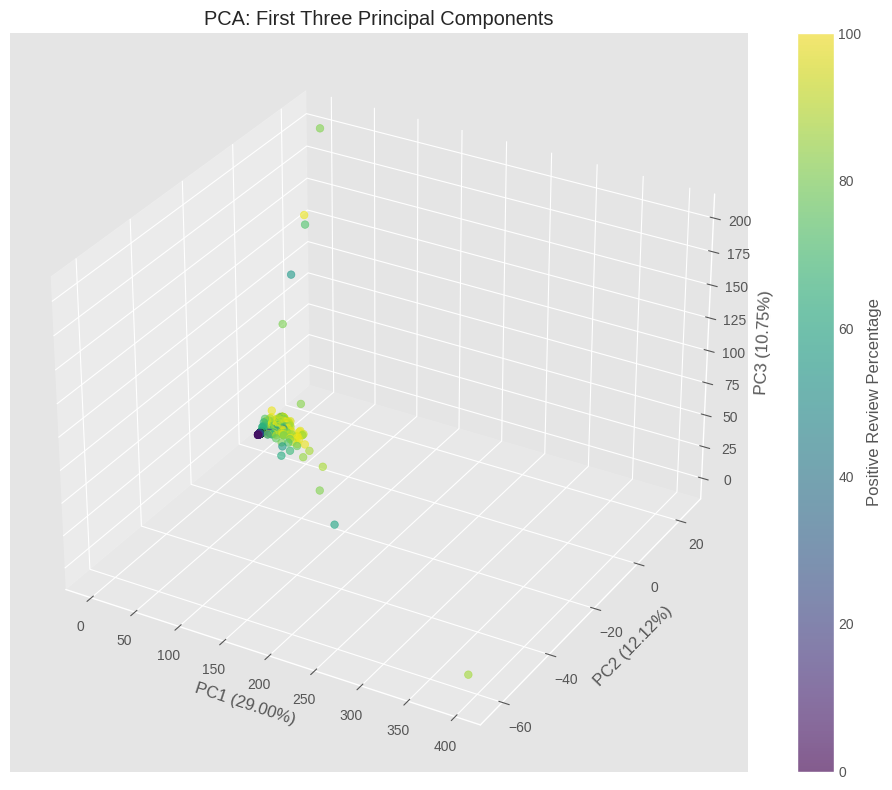

In [16]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import warnings
warnings.filterwarnings('ignore')

# Set plotting parameters
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [12, 8]

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with no reviews or missing review percentages
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 10) & (df['num_reviews_total'] != -1)]
df = df[~df['pct_pos_total'].isna()]  # Ensure we have review percentage data

# Calculate estimated revenue metrics as in your original code
df['min_price'] = df['price'].apply(lambda x: max(x, 0.99) if x >= 0 else 0.99)
df['revenue'] = df['num_reviews_total'] * df['min_price']
df['log_revenue'] = np.log(df['revenue'].clip(1, None))  # Natural log transform

# Extract release year as a feature
df['release_year'] = df['release_date'].dt.year

# Select numeric features for PCA
numeric_features = [
    'price', 
    'dlc_count',
    'metacritic_score', 
    'achievements',
    'recommendations',
    'user_score',
    'score_rank',
    'positive', 
    'negative',
    'average_playtime_forever',
    'median_playtime_forever',
    'peak_ccu',
    'pct_pos_total',
    'num_reviews_total',
    'pct_pos_recent',
    'num_reviews_recent',
    'log_revenue',
    'release_year'
]

# Create a copy of the dataframe with only the selected features
X = df[numeric_features].copy()

# Check for and handle any remaining missing values
print("Missing values in each column:")
print(X.isna().sum())

# Replace missing values with median (could also drop rows if preferred)
X = X.fillna(X.median())

# Standardize the data (important for PCA)
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Determine optimal number of components
pca_full = PCA()
pca_full.fit(X_scaled)

# Plot explained variance
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca_full.explained_variance_ratio_), marker='o')
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.axhline(y=0.8, color='r', linestyle='-', alpha=0.5)
plt.axhline(y=0.9, color='g', linestyle='-', alpha=0.5)
plt.title('Explained Variance by Components')
plt.grid(True)
plt.show()

# Find number of components that explain at least 80% of variance
n_components = np.argmax(np.cumsum(pca_full.explained_variance_ratio_) >= 0.8) + 1
print(f"Number of components explaining 80% variance: {n_components}")

# Perform PCA with the selected number of components
pca = PCA(n_components=n_components)
principal_components = pca.fit_transform(X_scaled)

# Create a DataFrame with principal components
pca_df = pd.DataFrame(
    data=principal_components,
    columns=[f'PC{i+1}' for i in range(n_components)]
)

# Add back the game name for reference
pca_df['name'] = df['name'].values

# Print explained variance for each component
print("\nExplained variance ratio by component:")
for i, var in enumerate(pca.explained_variance_ratio_):
    print(f"PC{i+1}: {var:.4f} ({var*100:.2f}%)")
print(f"Total variance explained: {sum(pca.explained_variance_ratio_)*100:.2f}%")

# Feature importance (loadings)
loadings = pd.DataFrame(
    pca.components_.T,
    columns=[f'PC{i+1}' for i in range(n_components)],
    index=numeric_features
)

# Print loadings for the first few components
print("\nFeature loadings for first 3 components:")
print(loadings.iloc[:, :3])

# Visualization of the first two principal components
plt.figure(figsize=(12, 10))
scatter = plt.scatter(
    pca_df['PC1'], 
    pca_df['PC2'],
    c=df['pct_pos_total'],  # Color by review percentage
    cmap='viridis',
    alpha=0.5,
    s=50
)
plt.colorbar(scatter, label='Positive Review Percentage')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('PCA: First Two Principal Components')
plt.grid(True, alpha=0.3)

# Add feature loading vectors (for top contributing features only)
loadings_pc1 = loadings.iloc[:, 0].abs().sort_values(ascending=False)
loadings_pc2 = loadings.iloc[:, 1].abs().sort_values(ascending=False)
top_features = list(set(loadings_pc1.index[:5]).union(set(loadings_pc2.index[:5])))

# Scale factor for arrows
scale_factor = 5

for feature in top_features:
    i = numeric_features.index(feature)
    plt.arrow(
        0, 0,  # Start at origin
        loadings.iloc[i, 0] * scale_factor,  # PC1 loading
        loadings.iloc[i, 1] * scale_factor,  # PC2 loading
        head_width=0.2,
        head_length=0.2,
        fc='red',
        ec='red',
        alpha=0.6
    )
    plt.text(
        loadings.iloc[i, 0] * scale_factor * 1.1,
        loadings.iloc[i, 1] * scale_factor * 1.1,
        feature,
        color='black',
        ha='center',
        va='center',
        fontweight='bold',
        bbox=dict(facecolor='white', alpha=0.8)
    )

plt.tight_layout()
plt.show()

# Heatmap of the component loadings
plt.figure(figsize=(14, 10))
sns.heatmap(loadings.iloc[:, :5], annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Feature Loadings for First 5 Principal Components')
plt.tight_layout()
plt.show()

# Biplot (only for top contributing features for clarity)
fig, ax = plt.subplots(figsize=(14, 10))

# Plot data points
ax.scatter(principal_components[:, 0], principal_components[:, 1], alpha=0.3, s=30)

# Create scaling factors for the feature vectors to improve visibility
xs = principal_components[:, 0]
ys = principal_components[:, 1]
scalex = 1.0 / (xs.max() - xs.min())
scaley = 1.0 / (ys.max() - ys.min())

# Plot feature vectors for top contributing features
for i, feature in enumerate(numeric_features):
    if feature in top_features:
        ax.arrow(
            0, 0,
            pca.components_[0, i] / scalex * 3,
            pca.components_[1, i] / scaley * 3,
            head_width=0.05,
            head_length=0.05,
            fc='red',
            ec='red'
        )
        ax.text(
            pca.components_[0, i] / scalex * 3.2,
            pca.components_[1, i] / scaley * 3.2,
            feature,
            color='red',
            ha='center',
            va='center',
            fontweight='bold'
        )

ax.set_xlabel(f"PC1 ({pca.explained_variance_ratio_[0]:.2%})")
ax.set_ylabel(f"PC2 ({pca.explained_variance_ratio_[1]:.2%})")
ax.set_title('PCA Biplot: Feature Contributions to PC1 and PC2')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Find games with extreme values in the principal components
for i in range(min(3, n_components)):
    print(f"\nTop 5 games with highest values in PC{i+1}:")
    top_games = pca_df.sort_values(f'PC{i+1}', ascending=False).head(5)
    print(top_games[['name', f'PC{i+1}']])
    
    print(f"\nTop 5 games with lowest values in PC{i+1}:")
    bottom_games = pca_df.sort_values(f'PC{i+1}', ascending=True).head(5)
    print(bottom_games[['name', f'PC{i+1}']])

# Optional: 3D plot of first three components if available
if n_components >= 3:
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(
        principal_components[:, 0],
        principal_components[:, 1],
        principal_components[:, 2],
        c=df['pct_pos_total'],
        cmap='viridis',
        alpha=0.6,
        s=30
    )
    plt.colorbar(scatter, ax=ax, label='Positive Review Percentage')
    ax.set_xlabel(f'PC1 ({pca.explained_variance_ratio_[0]:.2%})')
    ax.set_ylabel(f'PC2 ({pca.explained_variance_ratio_[1]:.2%})')
    ax.set_zlabel(f'PC3 ({pca.explained_variance_ratio_[2]:.2%})')
    ax.set_title('PCA: First Three Principal Components')
    plt.tight_layout()
    plt.show()

## Predictions

Parsing tags and developers...

Top 20 tags:
Indie: 25971
Singleplayer: 25227
Adventure: 19426
Action: 18920
Casual: 17651
2D: 12854
Simulation: 10576
Strategy: 9716
Atmospheric: 9417
RPG: 9157
Puzzle: 8340
Story Rich: 8188
3D: 7569
Exploration: 7008
Pixel Graphics: 6873
Cute: 6693
First-Person: 6558
Multiplayer: 6543
Colorful: 6446
Fantasy: 5806

Top 20 developers:
Laush Dmitriy Sergeevich: 123
Choice of Games: 118
KOEI TECMO GAMES CO., LTD.: 104
Sokpop Collective: 94
Square Enix: 81
Dnovel: 81
Gamesforgames: 80
Hosted Games: 73
Ripknot Systems: 61
Tero Lunkka: 59
Creobit: 58
RewindApp: 55
EpiXR Games UG: 53
LTZinc: 52
Cyber Keks: 49
Dharker Studios: 47
GentleDriver: 47
Winged Cloud: 46
Octo Games: 43
Kairosoft Co.,Ltd: 42

Total number of features for prediction: 60

Training Random Forest model...

Model performance:
Mean Squared Error: 0.2200
R² Score: 0.9629
RMSE: 0.4690

Analyzing feature importance...

Top 20 most important features (Random Forest):
                     Feature 

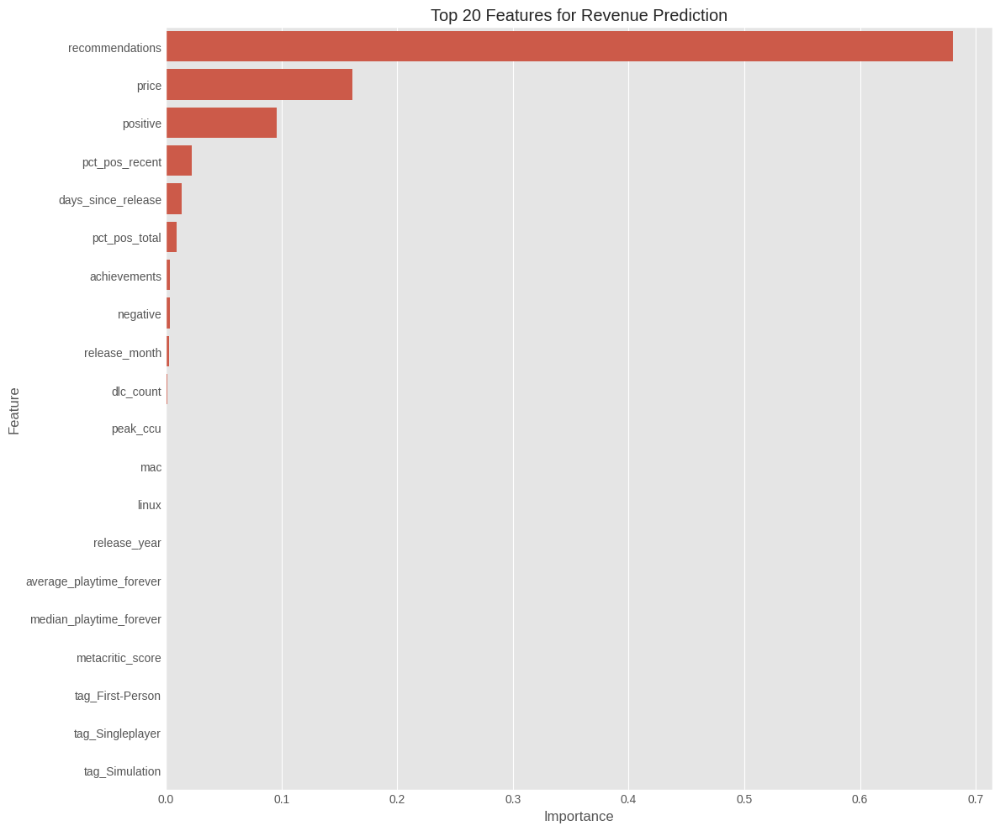


Calculating permutation importance...

Top 20 most important features (Permutation Importance):
                           Feature  Importance
4                  recommendations    0.771713
0                            price    0.393954
7                         positive    0.255203
13                  pct_pos_recent    0.120269
8                         negative    0.016464
16              days_since_release    0.010299
12                   pct_pos_total    0.009622
11                        peak_ccu    0.006207
3                     achievements    0.001092
36                tag_First-Person    0.000262
28                 tag_Atmospheric    0.000258
21                tag_Singleplayer    0.000133
18                             mac    0.000089
9         average_playtime_forever    0.000045
26                  tag_Simulation    0.000036
19                           linux    0.000031
23                      tag_Action    0.000028
5                       user_score    0.000027
10        

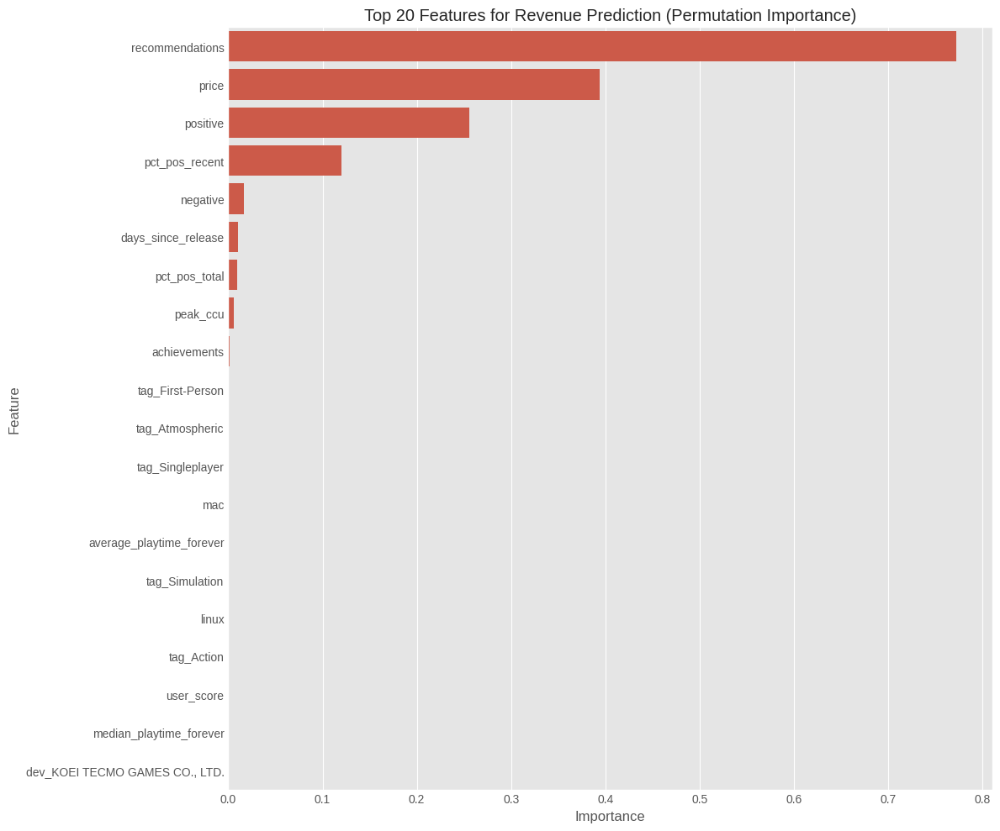


Training Gradient Boosting model for comparison...

Gradient Boosting model performance:
Mean Squared Error: 0.2406
R² Score: 0.9594
RMSE: 0.4905

Top 20 most important features (Gradient Boosting):
                     Feature    Importance
4            recommendations  5.847110e-01
7                   positive  1.989034e-01
0                      price  1.697858e-01
13            pct_pos_recent  2.950627e-02
11                  peak_ccu  8.405142e-03
8                   negative  4.240960e-03
16        days_since_release  2.459917e-03
12             pct_pos_total  1.453624e-03
3               achievements  3.195734e-04
1                  dlc_count  1.332658e-04
5                 user_score  4.729746e-05
26            tag_Simulation  2.460128e-05
23                tag_Action  5.663899e-06
30                tag_Puzzle  2.972124e-06
15             release_month  2.989305e-07
19                     linux  2.236332e-07
10   median_playtime_forever  0.000000e+00
9   average_playtime_forev

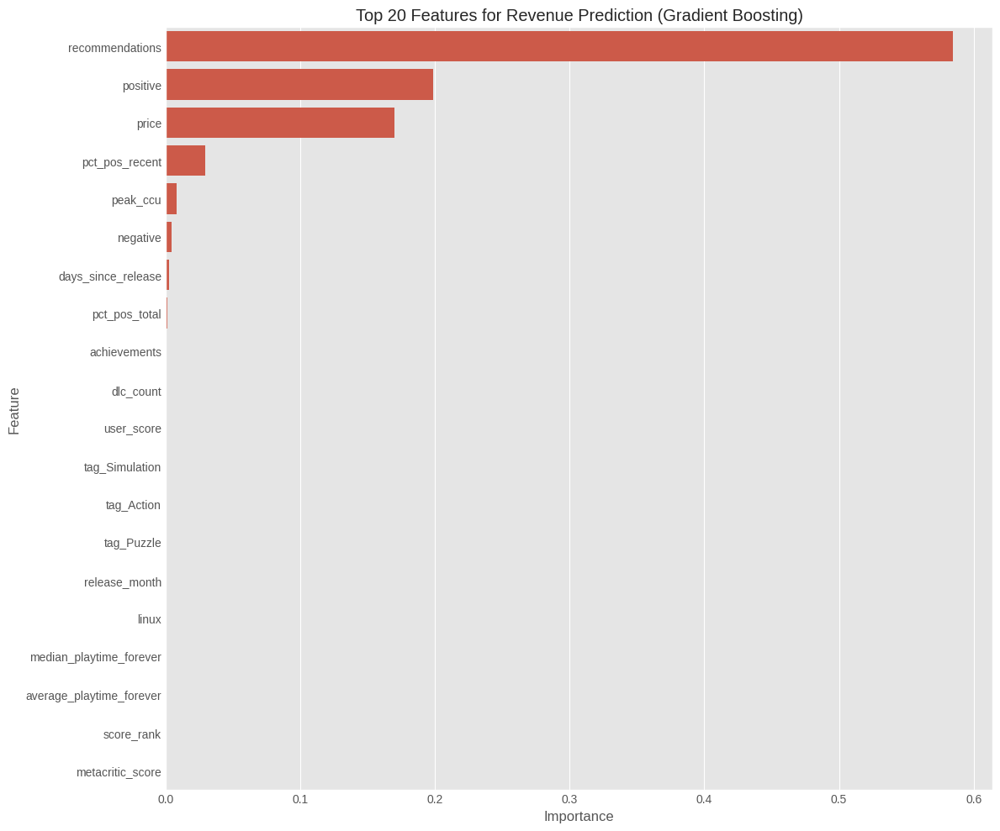


Generating partial dependence plots for top 5 features: ['recommendations', 'price', 'positive', 'pct_pos_recent', 'days_since_release']


KeyError: 'values'

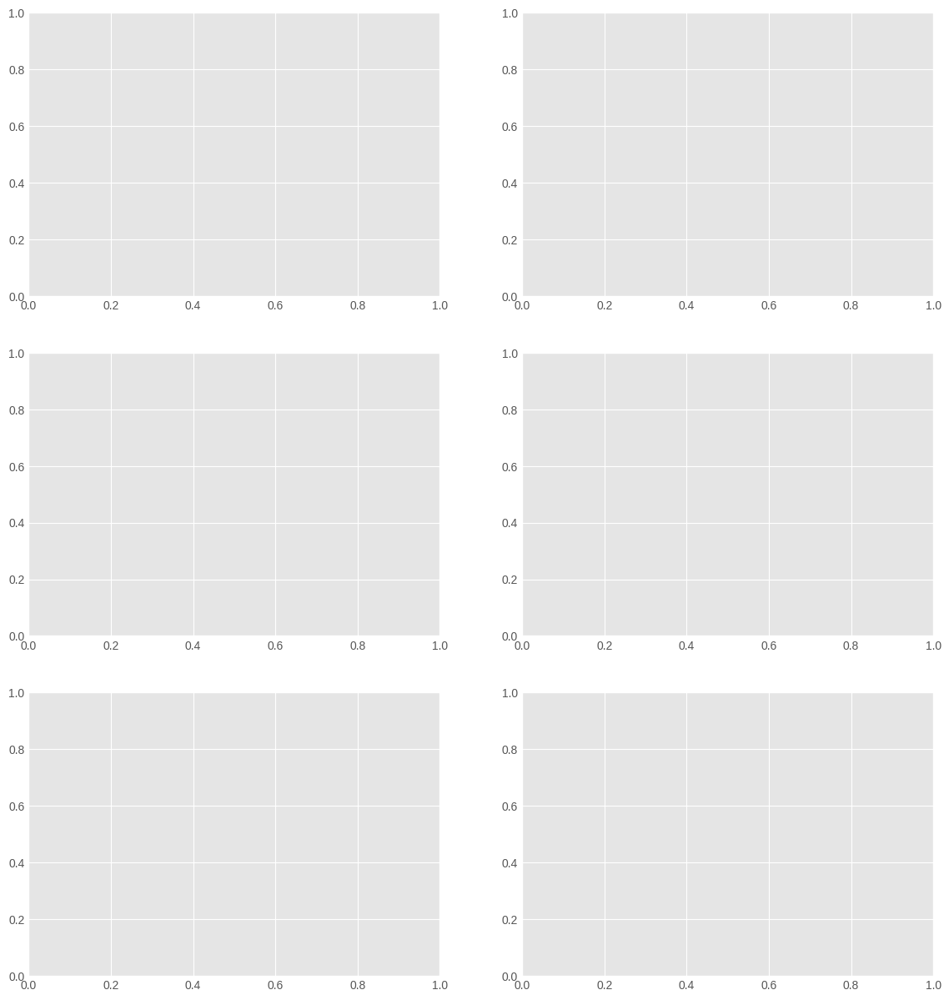

In [23]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.inspection import permutation_importance
import ast
import json
import warnings
warnings.filterwarnings('ignore')

# Set plotting parameters
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [12, 8]

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with missing review percentages or no reviews
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 10) & (df['num_reviews_total'] != -1)]
df = df[~df['pct_pos_total'].isna()]

# Calculate estimated revenue metrics (excluding review counts as predictors)
df['min_price'] = df['price'].apply(lambda x: max(x, 0.99) if x >= 0 else 0.99)
df['revenue'] = df['num_reviews_total'] * df['min_price']import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.inspection import permutation_importance
import ast
import json
import warnings
warnings.filterwarnings('ignore')

# Set plotting parameters
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [12, 8]

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with missing review percentages or no reviews
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 10) & (df['num_reviews_total'] != -1)]
df = df[~df['pct_pos_total'].isna()]

# Calculate estimated revenue metrics (excluding review counts as predictors)
df['min_price'] = df['price'].apply(lambda x: max(x, 0.99) if x >= 0 else 0.99)
df['revenue'] = df['num_reviews_total'] * df['min_price']
df['log_revenue'] = np.log(df['revenue'].clip(1, None))  # Natural log transform

# Extract time-based features
df['release_year'] = df['release_date'].dt.year
df['release_month'] = df['release_date'].dt.month
df['days_since_release'] = (pd.Timestamp.now() - df['release_date']).dt.days

# Process tags column
def parse_tags(tag_str):
    if pd.isna(tag_str):
        return []
    
    try:
        # Try to evaluate as Python literal
        parsed = ast.literal_eval(tag_str)
        
        if isinstance(parsed, dict):
            return list(parsed.keys())
        elif isinstance(parsed, list):
            return parsed
        else:
            return []
    except:
        try:
            parsed = json.loads(tag_str)
            if isinstance(parsed, dict):
                return list(parsed.keys())
            elif isinstance(parsed, list):
                return parsed
            else:
print(experience_stats)
df['log_revenue'] = np.log(df['revenue'].clip(1, None))  # Natural log transform

# Extract time-based features
df['release_year'] = df['release_date'].dt.year
df['release_month'] = df['release_date'].dt.month
df['days_since_release'] = (pd.Timestamp.now() - df['release_date']).dt.days

# Process tags column
def parse_tags(tag_str):
    if pd.isna(tag_str):
        return []
    
    try:
        # Try to evaluate as Python literal
        parsed = ast.literal_eval(tag_str)
        
        if isinstance(parsed, dict):
            return list(parsed.keys())
        elif isinstance(parsed, list):
            return parsed
        else:
            return []
    except:
        try:
            parsed = json.loads(tag_str)
            if isinstance(parsed, dict):
                return list(parsed.keys())
            elif isinstance(parsed, list):
                return parsed
            else:
                return []
        except:
            return []

# Process developers column
def parse_developers(dev_str):
    if pd.isna(dev_str):
        return []
    
    try:
        parsed = ast.literal_eval(dev_str)
        if isinstance(parsed, list):
            return parsed
        else:
            return []
    except:
        return []

# Apply parsing functions
print("Parsing tags and developers...")
df['tags_list'] = df['tags'].apply(parse_tags)
df['developers_list'] = df['developers'].apply(parse_developers)

# Count tag occurrences
tag_counter = {}
for tags in df['tags_list']:
    for tag in tags:
        tag = str(tag).strip()
        if tag in tag_counter:
            tag_counter[tag] += 1
        else:
            tag_counter[tag] = 1

# Get top tags
top_tags = sorted(tag_counter.items(), key=lambda x: x[1], reverse=True)[:20]
top_tag_names = [tag[0] for tag in top_tags]

print(f"\nTop 20 tags:")
for tag, count in top_tags:
    print(f"{tag}: {count}")

# Create binary features for top tags
for tag in top_tag_names:
    df[f'tag_{tag}'] = df['tags_list'].apply(lambda x: 1 if tag in x else 0)

# Count developer occurrences
dev_counter = {}
for devs in df['developers_list']:
    for dev in devs:
        dev = str(dev).strip()
        if dev in dev_counter:
            dev_counter[dev] += 1
        else:
            dev_counter[dev] = 1

# Get top developers
top_devs = sorted(dev_counter.items(), key=lambda x: x[1], reverse=True)[:20]
top_dev_names = [dev[0] for dev in top_devs]

print(f"\nTop 20 developers:")
for dev, count in top_devs:
    print(f"{dev}: {count}")

# Create binary features for top developers
for dev in top_dev_names:
    df[f'dev_{dev}'] = df['developers_list'].apply(lambda x: 1 if dev in x else 0)

# Select features, excluding review counts
features = [
    'price', 
    'dlc_count',
    'metacritic_score',
    'achievements',
    'recommendations',
    'user_score',
    'score_rank',
    'positive',
    'negative',
    'average_playtime_forever',
    'median_playtime_forever',
    'peak_ccu',
    'pct_pos_total',
    'pct_pos_recent',
    'release_year',
    'release_month',
    'days_since_release'
]

# Add platform features if available
platform_features = ['windows', 'mac', 'linux']
features.extend([f for f in platform_features if f in df.columns])

# Add encoded tag features
tag_features = [f'tag_{tag}' for tag in top_tag_names]
features.extend(tag_features)

# Add encoded developer features
dev_features = [f'dev_{dev}' for dev in top_dev_names]
features.extend(dev_features)

print(f"\nTotal number of features for prediction: {len(features)}")

# Create feature matrix and target vector
X = df[features].copy()
y = df['log_revenue']  # Predicting log revenue for better distribution

# Handle missing values
X = X.fillna(X.median())

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest model
print("\nTraining Random Forest model...")
rf_model = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
rf_model.fit(X_train, y_train)

# Evaluate the model
y_pred = rf_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"\nModel performance:")
print(f"Mean Squared Error: {mse:.4f}")
print(f"R² Score: {r2:.4f}")
print(f"RMSE: {np.sqrt(mse):.4f}")

# Feature importance (built-in)
print("\nAnalyzing feature importance...")
feature_importances = rf_model.feature_importances_
features_df = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importances
}).sort_values('Importance', ascending=False)

print("\nTop 20 most important features (Random Forest):")
print(features_df.head(20))

# Plot feature importance
plt.figure(figsize=(12, 10))
top_features = features_df.head(20)
sns.barplot(x='Importance', y='Feature', data=top_features)
plt.title('Top 20 Features for Revenue Prediction')
plt.tight_layout()
plt.show()

# Permutation importance (more robust than built-in feature importance)
print("\nCalculating permutation importance...")
perm_importance = permutation_importance(rf_model, X_test, y_test, n_repeats=10, random_state=42)
perm_importances_mean = perm_importance.importances_mean
perm_features_df = pd.DataFrame({
    'Feature': features,
    'Importance': perm_importances_mean
}).sort_values('Importance', ascending=False)

print("\nTop 20 most important features (Permutation Importance):")
print(perm_features_df.head(20))

# Plot permutation importance
plt.figure(figsize=(12, 10))
top_perm_features = perm_features_df.head(20)
sns.barplot(x='Importance', y='Feature', data=top_perm_features)
plt.title('Top 20 Features for Revenue Prediction (Permutation Importance)')
plt.tight_layout()
plt.show()

# Train Gradient Boosting for comparison
print("\nTraining Gradient Boosting model for comparison...")
gb_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
gb_model.fit(X_train, y_train)

# Evaluate GB model
gb_y_pred = gb_model.predict(X_test)
gb_mse = mean_squared_error(y_test, gb_y_pred)
gb_r2 = r2_score(y_test, gb_y_pred)

print(f"\nGradient Boosting model performance:")
print(f"Mean Squared Error: {gb_mse:.4f}")
print(f"R² Score: {gb_r2:.4f}")
print(f"RMSE: {np.sqrt(gb_mse):.4f}")

# GB Feature importance
gb_feature_importances = gb_model.feature_importances_
gb_features_df = pd.DataFrame({
    'Feature': features,
    'Importance': gb_feature_importances
}).sort_values('Importance', ascending=False)

print("\nTop 20 most important features (Gradient Boosting):")
print(gb_features_df.head(20))

# Plot GB feature importance
plt.figure(figsize=(12, 10))
top_gb_features = gb_features_df.head(20)
sns.barplot(x='Importance', y='Feature', data=top_gb_features)
plt.title('Top 20 Features for Revenue Prediction (Gradient Boosting)')
plt.tight_layout()
plt.show()

## Replace the partial dependence section with this updated code
from sklearn.inspection import partial_dependence

top_5_features = features_df['Feature'].head(5).tolist()
print(f"\nGenerating partial dependence plots for top 5 features: {top_5_features}")

# Create partial dependence plots manually
fig, axes = plt.subplots(3, 2, figsize=(14, 15))
axes = axes.flatten()

for i, feature in enumerate(top_5_features):
    # Skip if we've run out of axes
    if i >= len(axes):
        break
        
    # Calculate partial dependence
    pdp_results = partial_dependence(
        rf_model, 
        X_train, 
        features=[features.index(feature)],
        kind="average",
        grid_resolution=20
    )
    
    # Extract results
    pdp_values = pdp_results["average"][0]
    pdp_grid = pdp_results["values"][0]
    
    # Plot
    axes[i].plot(pdp_grid, pdp_values)
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('Partial Dependence')
    axes[i].set_title(f'Partial Dependence of {feature}')
    axes[i].grid(True, alpha=0.3)

# Handle any unused subplots
for j in range(i + 1, len(axes)):
    axes[j].set_visible(False)

plt.tight_layout()
plt.suptitle('Partial Dependence of Top 5 Features (Random Forest)', y=1.02)
plt.show()

# Feature importance summary across methods
print("\nFeature importance summary:")
print("Comparing top 10 features across different importance methods")

summary_df = pd.DataFrame({
    'Random Forest': features_df['Feature'].head(10).tolist(),
    'Permutation': perm_features_df['Feature'].head(10).tolist(),
    'Gradient Boosting': gb_features_df['Feature'].head(10).tolist()
})

print(summary_df)

# Detailed analysis of tag and developer impact on revenue
print("\nAnalyzing impact of tags on revenue:")
tag_impact = []
for tag in top_tag_names:
    feature = f'tag_{tag}'
    has_tag = df[df[feature] == 1]['log_revenue'].mean()
    no_tag = df[df[feature] == 0]['log_revenue'].mean()
    difference = has_tag - no_tag
    tag_impact.append((tag, has_tag, no_tag, difference, len(df[df[feature] == 1])))

tag_impact_df = pd.DataFrame(tag_impact, columns=['Tag', 'Mean Log Revenue (With Tag)', 
                                                 'Mean Log Revenue (Without Tag)', 
                                                 'Difference', 'Count'])
tag_impact_df = tag_impact_df.sort_values('Difference', ascending=False)

print(tag_impact_df)

plt.figure(figsize=(14, 8))
sns.barplot(x='Tag', y='Difference', data=tag_impact_df)
plt.title('Impact of Tags on Log Revenue')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Developer impact
print("\nAnalyzing impact of developers on revenue:")
dev_impact = []
for dev in top_dev_names:
    feature = f'dev_{dev}'
    has_dev = df[df[feature] == 1]['log_revenue'].mean()
    no_dev = df[df[feature] == 0]['log_revenue'].mean()
    difference = has_dev - no_dev
    dev_impact.append((dev, has_dev, no_dev, difference, len(df[df[feature] == 1])))

dev_impact_df = pd.DataFrame(dev_impact, columns=['Developer', 'Mean Log Revenue (With Dev)', 
                                                 'Mean Log Revenue (Without Dev)', 
                                                 'Difference', 'Count'])
dev_impact_df = dev_impact_df.sort_values('Difference', ascending=False)

print(dev_impact_df)

plt.figure(figsize=(14, 8))
sns.barplot(x='Developer', y='Difference', data=dev_impact_df)
plt.title('Impact of Developers on Log Revenue')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

Removed 11150 games with price of 0
Remaining games: 40362
Parsing tags and developers...

Top 20 tags:
Singleplayer: 23050
Indie: 22326
Adventure: 17338
Action: 16315
Casual: 15318
2D: 11710
Simulation: 9461
Atmospheric: 8659
Strategy: 8492
RPG: 8013
Puzzle: 7685
Story Rich: 7580
3D: 6840
Exploration: 6519
Pixel Graphics: 6240
Cute: 6207
Colorful: 5941
First-Person: 5872
Fantasy: 5229
Horror: 5090

Top 20 developers:
Laush Dmitriy Sergeevich: 122
Choice of Games: 118
KOEI TECMO GAMES CO., LTD.: 97
Sokpop Collective: 94
Dnovel: 81
Gamesforgames: 79
Square Enix: 77
Hosted Games: 73
Ripknot Systems: 61
Tero Lunkka: 59
Creobit: 57
RewindApp: 54
EpiXR Games UG: 53
LTZinc: 52
Cyber Keks: 49
GentleDriver: 47
Winged Cloud: 44
Dharker Studios: 43
Octo Games: 43
Kairosoft Co.,Ltd: 42

Added developer_game_count feature
Min developer game count: 0
Max developer game count: 122
Mean developer game count: 7.01

Total number of features for prediction: 60

Training Random Forest model...

Model per

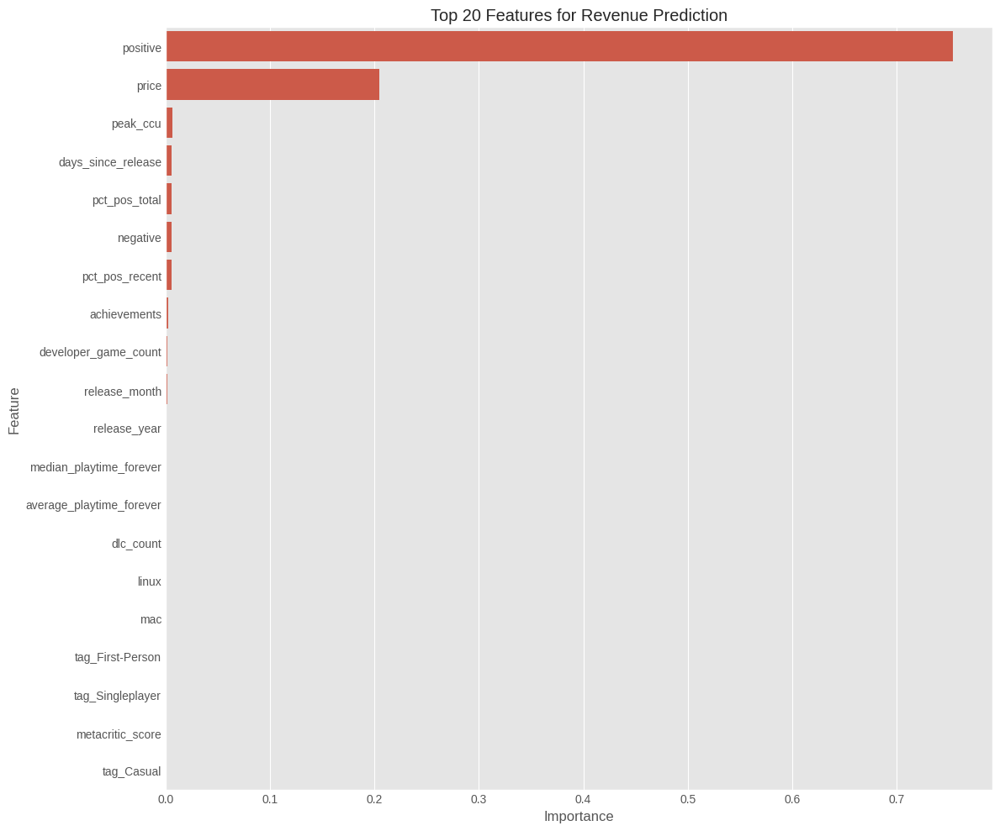


Calculating permutation importance...

Top 20 most important features (Permutation Importance):
                     Feature  Importance
6                   positive    0.865865
0                      price    0.378630
12            pct_pos_recent    0.024138
7                   negative    0.016403
10                  peak_ccu    0.014838
11             pct_pos_total    0.007905
15        days_since_release    0.006310
37          tag_First-Person    0.001466
3               achievements    0.001309
9    median_playtime_forever    0.000864
8   average_playtime_forever    0.000715
16      developer_game_count    0.000681
13              release_year    0.000508
1                  dlc_count    0.000150
19                     linux    0.000131
26            tag_Simulation    0.000073
20          tag_Singleplayer    0.000066
27           tag_Atmospheric    0.000066
58            dev_Octo Games    0.000063
4                 user_score    0.000060


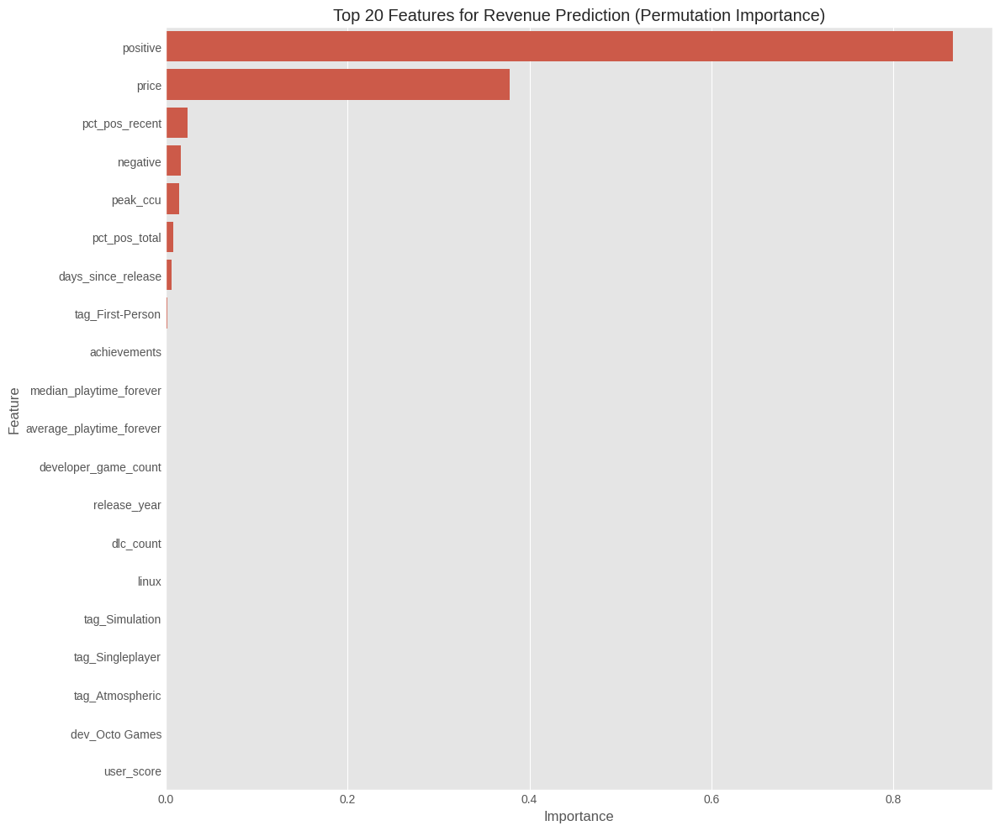


Training Gradient Boosting model for comparison...

Gradient Boosting model performance:
Mean Squared Error: 0.1866
R² Score: 0.9691
RMSE: 0.4320

Top 20 most important features (Gradient Boosting):
                     Feature  Importance
6                   positive    0.722923
0                      price    0.211223
10                  peak_ccu    0.039287
7                   negative    0.014989
12            pct_pos_recent    0.006219
11             pct_pos_total    0.001482
15        days_since_release    0.001312
8   average_playtime_forever    0.000714
9    median_playtime_forever    0.000478
3               achievements    0.000454
58            dev_Octo Games    0.000219
26            tag_Simulation    0.000146
16      developer_game_count    0.000146
4                 user_score    0.000123
13              release_year    0.000068
20          tag_Singleplayer    0.000041
24                tag_Casual    0.000037
27           tag_Atmospheric    0.000035
37          tag_First

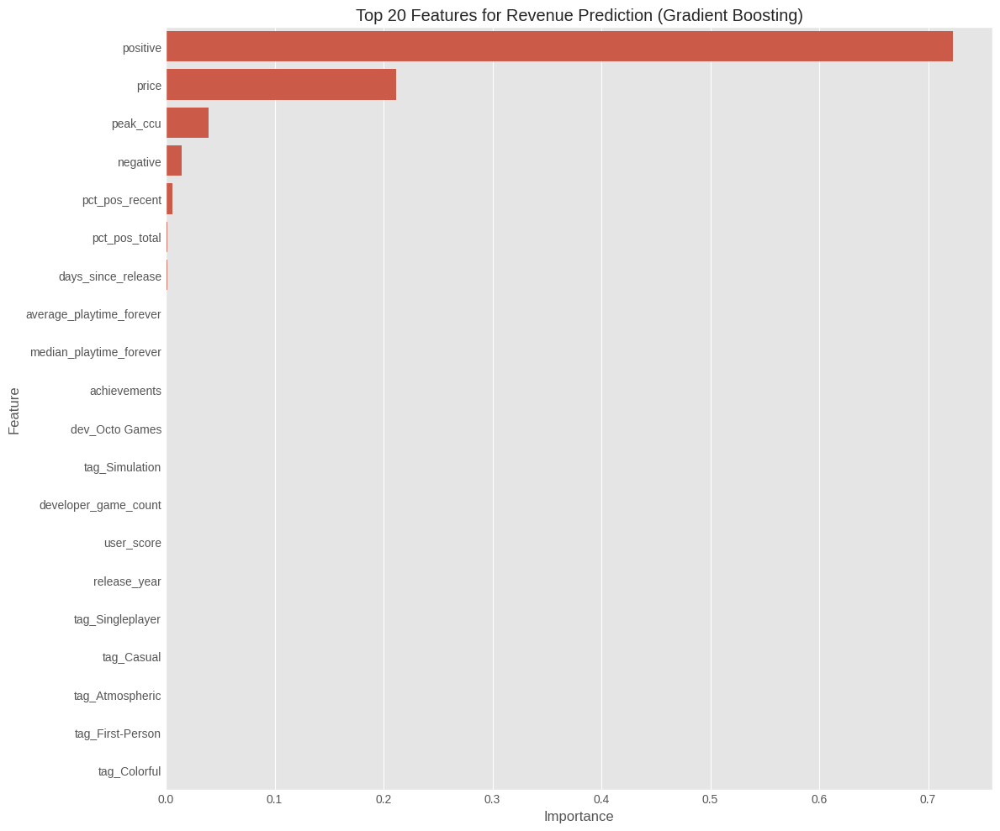

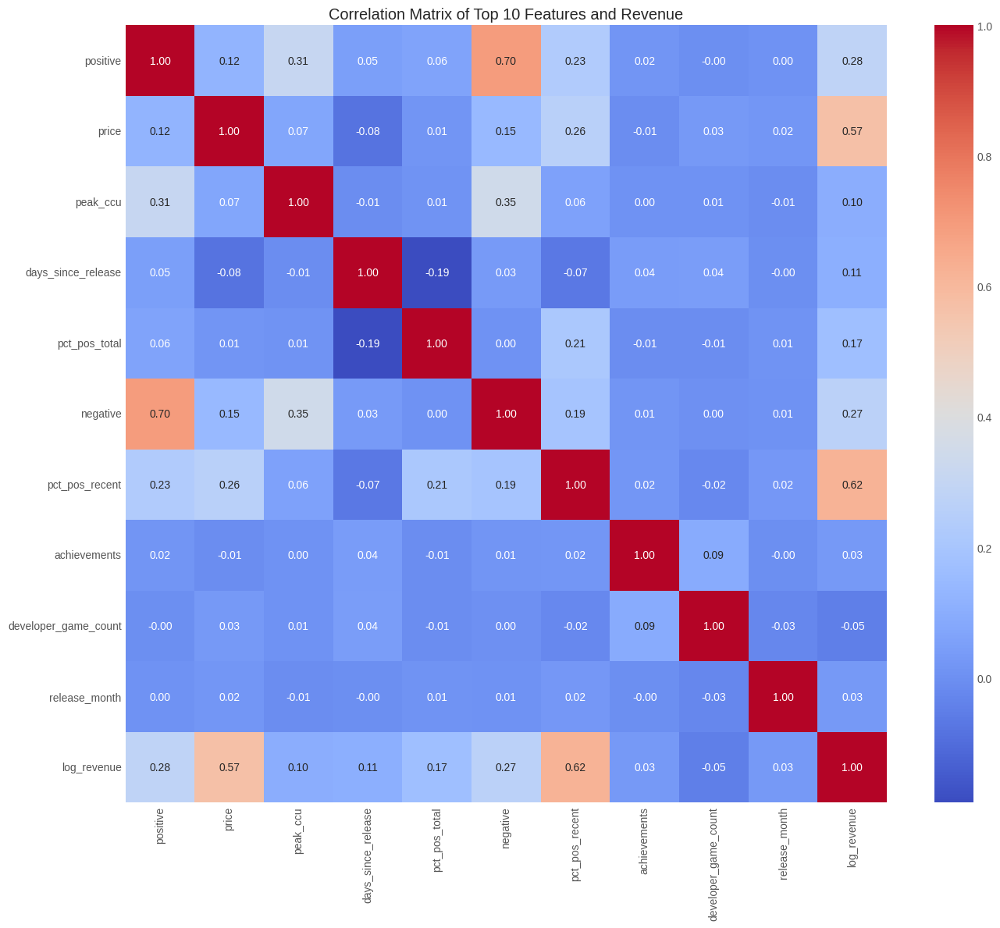

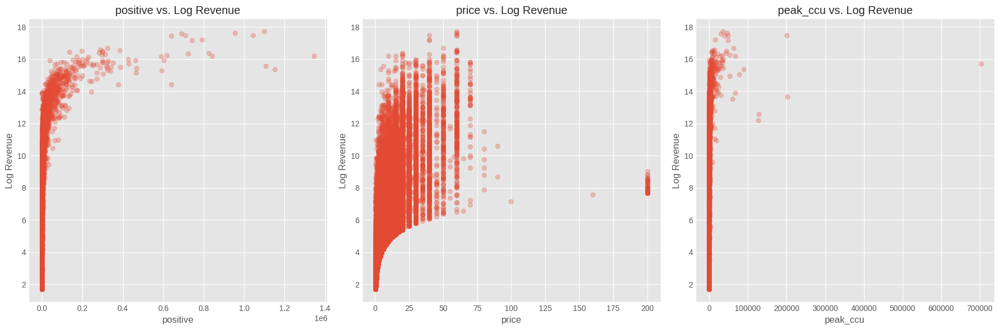


Feature importance summary:
Comparing top 10 features across different importance methods
          Random Forest              Permutation         Gradient Boosting
0              positive                 positive                  positive
1                 price                    price                     price
2              peak_ccu           pct_pos_recent                  peak_ccu
3    days_since_release                 negative                  negative
4         pct_pos_total                 peak_ccu            pct_pos_recent
5              negative            pct_pos_total             pct_pos_total
6        pct_pos_recent       days_since_release        days_since_release
7          achievements         tag_First-Person  average_playtime_forever
8  developer_game_count             achievements   median_playtime_forever
9         release_month  median_playtime_forever              achievements

Analyzing impact of tags on revenue:
               Tag  Mean Log Revenue (With Tag

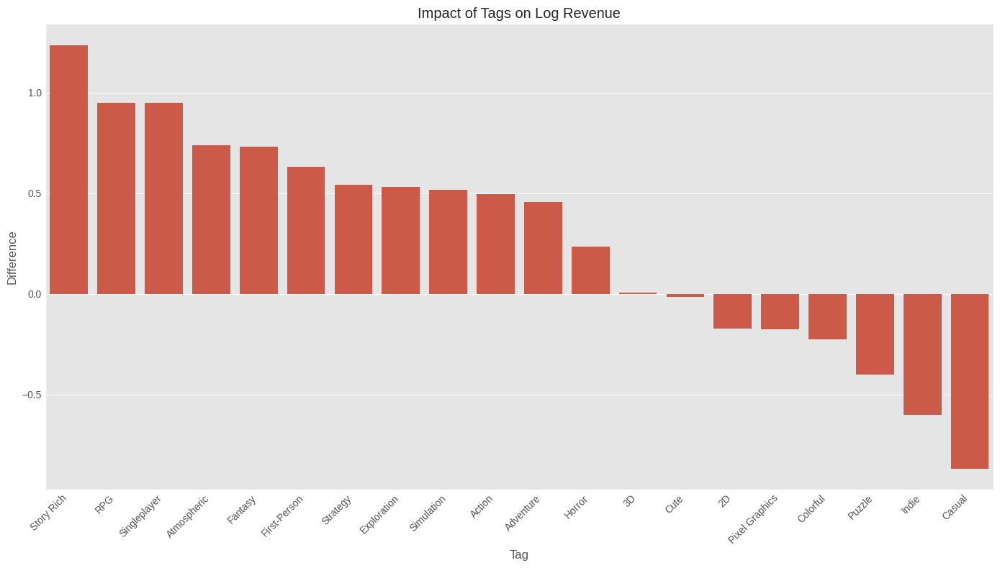


Analyzing impact of developers on revenue:
                     Developer  Mean Log Revenue (With Dev)  \
6                  Square Enix                    10.972348   
2   KOEI TECMO GAMES CO., LTD.                     9.912690   
19           Kairosoft Co.,Ltd                     6.959216   
18                  Octo Games                     6.688082   
16                Winged Cloud                     6.395498   
7                 Hosted Games                     5.820505   
17             Dharker Studios                     5.752556   
1              Choice of Games                     5.436336   
12              EpiXR Games UG                     5.306485   
8              Ripknot Systems                     5.131506   
10                     Creobit                     5.060072   
3            Sokpop Collective                     4.940993   
0     Laush Dmitriy Sergeevich                     4.407951   
11                   RewindApp                     4.372568   
4          

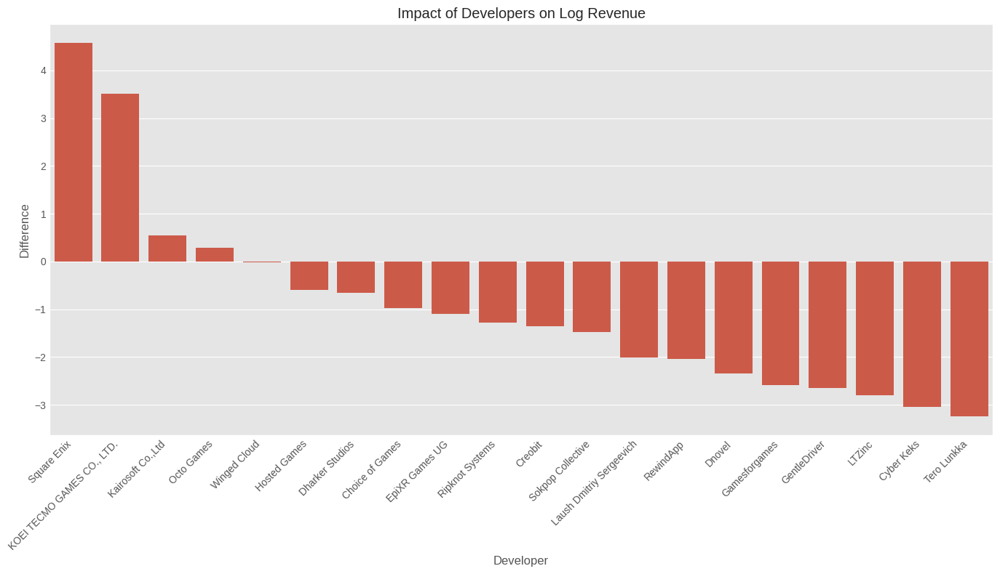

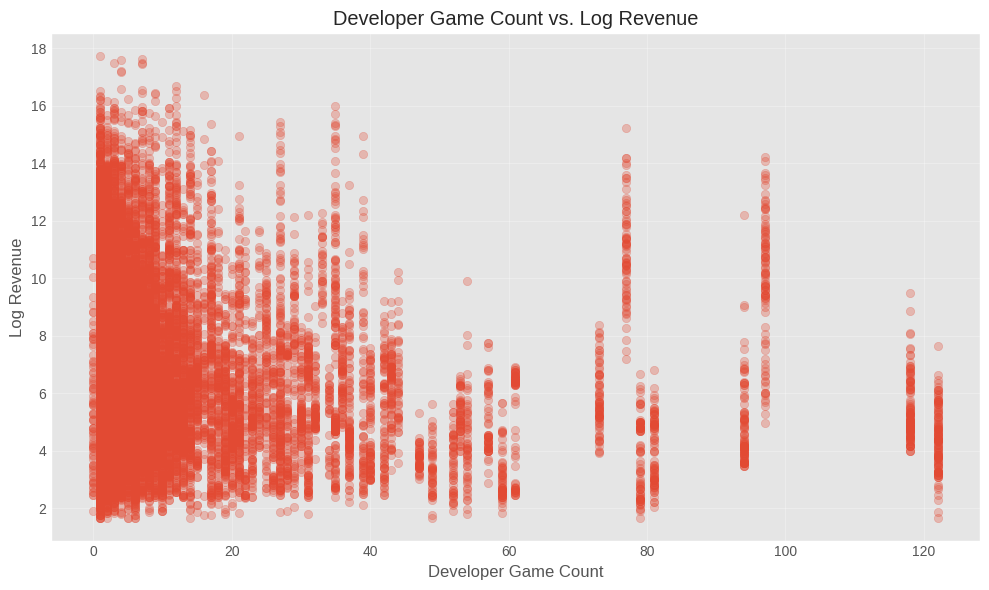

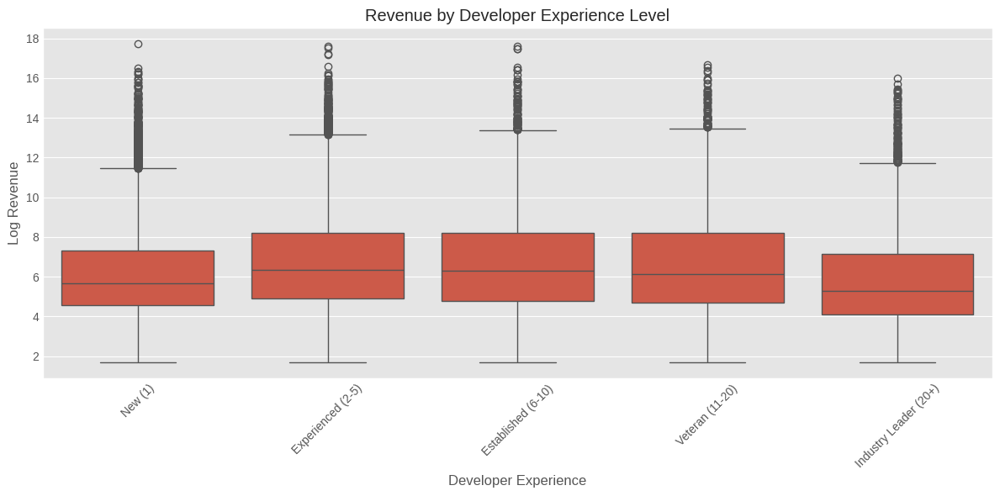


Revenue by developer experience level:
                           mean    median       std  count
dev_experience                                            
New (1)                6.117951  5.668880  2.206857  16467
Experienced (2-5)      6.732040  6.327329  2.449800  13874
Established (6-10)     6.702666  6.289493  2.649436   4148
Veteran (11-20)        6.714835  6.149952  2.801432   2552
Industry Leader (20+)  5.898962  5.299966  2.552563   3239


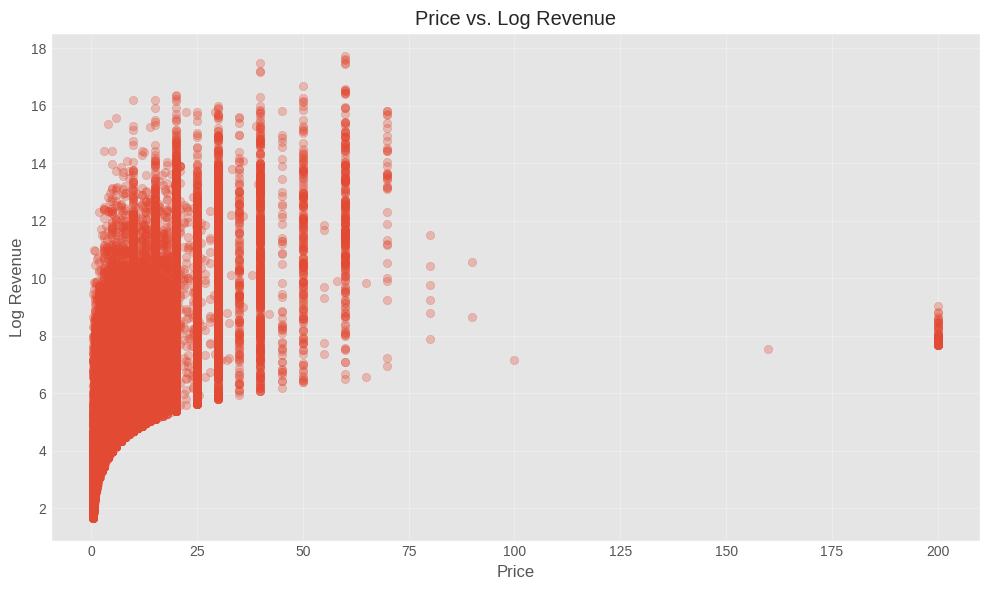

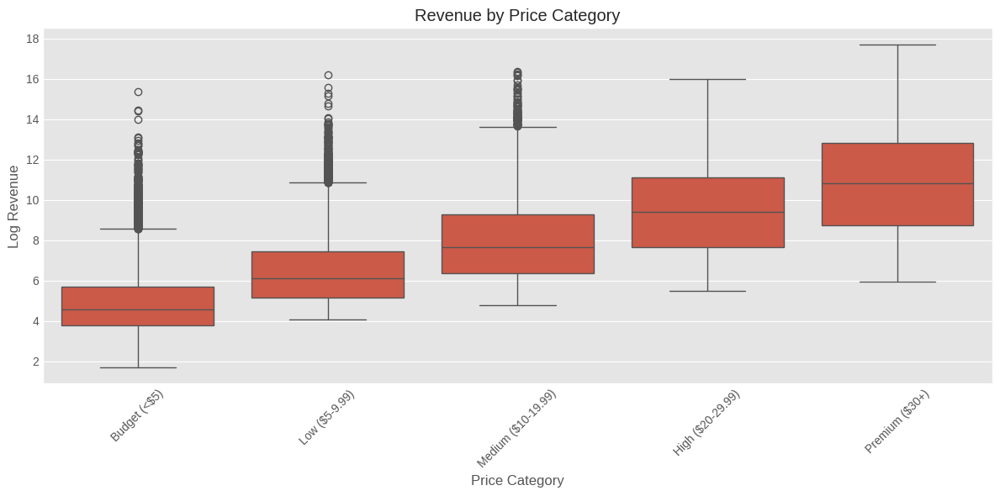


Revenue by price category:
                         mean     median       std  count
price_category                                           
Budget (<$5)         4.864033   4.551875  1.607496  17385
Low ($5-9.99)        6.495535   6.120825  1.687299  10603
Medium ($10-19.99)   7.979929   7.656143  2.034347   9174
High ($20-29.99)     9.486254   9.397316  2.299323   2017
Premium ($30+)      10.876051  10.819212  2.559732   1183


In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.inspection import permutation_importance
import ast
import json
import warnings
warnings.filterwarnings('ignore')

# Set plotting parameters
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [12, 8]

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with missing review percentages or no reviews
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 10) & (df['num_reviews_total'] != -1)]
df = df[~df['pct_pos_total'].isna()]

# Remove games with a price of 0
initial_count = len(df)
df = df[df['price'] > 0]
filtered_count = len(df)
print(f"Removed {initial_count - filtered_count} games with price of 0")
print(f"Remaining games: {filtered_count}")

# Calculate estimated revenue metrics (excluding review counts as predictors)
df['revenue'] = df['num_reviews_total'] * df['price']
df['log_revenue'] = np.log(df['revenue'].clip(1, None))  # Natural log transform

# Extract time-based features
df['release_year'] = df['release_date'].dt.year
df['release_month'] = df['release_date'].dt.month
df['days_since_release'] = (pd.Timestamp.now() - df['release_date']).dt.days

# Process tags column
def parse_tags(tag_str):
    if pd.isna(tag_str):
        return []
    
    try:
        # Try to evaluate as Python literal
        parsed = ast.literal_eval(tag_str)
        
        if isinstance(parsed, dict):
            return list(parsed.keys())
        elif isinstance(parsed, list):
            return parsed
        else:
            return []
    except:
        try:
            parsed = json.loads(tag_str)
            if isinstance(parsed, dict):
                return list(parsed.keys())
            elif isinstance(parsed, list):
                return parsed
            else:
                return []
        except:
            return []

# Process developers column
def parse_developers(dev_str):
    if pd.isna(dev_str):
        return []
    
    try:
        parsed = ast.literal_eval(dev_str)
        if isinstance(parsed, list):
            return parsed
        else:
            return []
    except:
        return []

# Apply parsing functions
print("Parsing tags and developers...")
df['tags_list'] = df['tags'].apply(parse_tags)
df['developers_list'] = df['developers'].apply(parse_developers)

# Count tag occurrences
tag_counter = {}
for tags in df['tags_list']:
    for tag in tags:
        tag = str(tag).strip()
        if tag in tag_counter:
            tag_counter[tag] += 1
        else:
            tag_counter[tag] = 1

# Get top tags
top_tags = sorted(tag_counter.items(), key=lambda x: x[1], reverse=True)[:20]
top_tag_names = [tag[0] for tag in top_tags]

print(f"\nTop 20 tags:")
for tag, count in top_tags:
    print(f"{tag}: {count}")

# Create binary features for top tags
for tag in top_tag_names:
    df[f'tag_{tag}'] = df['tags_list'].apply(lambda x: 1 if tag in x else 0)

# Count developer occurrences
dev_counter = {}
for devs in df['developers_list']:
    for dev in devs:
        dev = str(dev).strip()
        if dev in dev_counter:
            dev_counter[dev] += 1
        else:
            dev_counter[dev] = 1

# Get top developers
top_devs = sorted(dev_counter.items(), key=lambda x: x[1], reverse=True)[:20]
top_dev_names = [dev[0] for dev in top_devs]

print(f"\nTop 20 developers:")
for dev, count in top_devs:
    print(f"{dev}: {count}")

# Create binary features for top developers
for dev in top_dev_names:
    df[f'dev_{dev}'] = df['developers_list'].apply(lambda x: 1 if dev in x else 0)

# Calculate developer game count for each game
# Create a dictionary to store developer game counts
dev_game_counts = {}
for dev, count in dev_counter.items():
    dev_game_counts[dev] = count

# Function to calculate average developer game count for a game
def get_dev_game_count(developers):
    if not developers:
        return 0
    
    # Get game count for each developer of this game
    counts = [dev_game_counts.get(dev.strip(), 0) for dev in developers]
    
    # Return the maximum count among the developers
    return max(counts) if counts else 0

# Add developer game count feature
df['developer_game_count'] = df['developers_list'].apply(get_dev_game_count)

print("\nAdded developer_game_count feature")
print(f"Min developer game count: {df['developer_game_count'].min()}")
print(f"Max developer game count: {df['developer_game_count'].max()}")
print(f"Mean developer game count: {df['developer_game_count'].mean():.2f}")

# Select features, excluding review counts and recommendations
features = [
    'price', 
    'dlc_count',
    'metacritic_score',
    'achievements',
    'user_score',
    'score_rank',
    'positive',
    'negative',
    'average_playtime_forever',
    'median_playtime_forever',
    'peak_ccu',
    'pct_pos_total',
    'pct_pos_recent',
    'release_year',
    'release_month',
    'days_since_release',
    'developer_game_count'  # Added new feature
]

# Add platform features if available
platform_features = ['windows', 'mac', 'linux']
features.extend([f for f in platform_features if f in df.columns])

# Add encoded tag features
tag_features = [f'tag_{tag}' for tag in top_tag_names]
features.extend(tag_features)

# Add encoded developer features
dev_features = [f'dev_{dev}' for dev in top_dev_names]
features.extend(dev_features)

print(f"\nTotal number of features for prediction: {len(features)}")

# Create feature matrix and target vector
X = df[features].copy()
y = df['log_revenue']  # Predicting log revenue for better distribution

# Handle missing values
X = X.fillna(X.median())

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Random Forest model
print("\nTraining Random Forest model...")
rf_model = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=-1)
rf_model.fit(X_train, y_train)

# Evaluate the model
y_pred = rf_model.predict(X_test)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"\nModel performance:")
print(f"Mean Squared Error: {mse:.4f}")
print(f"R² Score: {r2:.4f}")
print(f"RMSE: {np.sqrt(mse):.4f}")

# Feature importance (built-in)
print("\nAnalyzing feature importance...")
feature_importances = rf_model.feature_importances_
features_df = pd.DataFrame({
    'Feature': features,
    'Importance': feature_importances
}).sort_values('Importance', ascending=False)

print("\nTop 20 most important features (Random Forest):")
print(features_df.head(20))

# Plot feature importance
plt.figure(figsize=(12, 10))
top_features = features_df.head(20)
sns.barplot(x='Importance', y='Feature', data=top_features)
plt.title('Top 20 Features for Revenue Prediction')
plt.tight_layout()
plt.show()

# Permutation importance (more robust than built-in feature importance)
print("\nCalculating permutation importance...")
perm_importance = permutation_importance(rf_model, X_test, y_test, n_repeats=10, random_state=42)
perm_importances_mean = perm_importance.importances_mean
perm_features_df = pd.DataFrame({
    'Feature': features,
    'Importance': perm_importances_mean
}).sort_values('Importance', ascending=False)

print("\nTop 20 most important features (Permutation Importance):")
print(perm_features_df.head(20))

# Plot permutation importance
plt.figure(figsize=(12, 10))
top_perm_features = perm_features_df.head(20)
sns.barplot(x='Importance', y='Feature', data=top_perm_features)
plt.title('Top 20 Features for Revenue Prediction (Permutation Importance)')
plt.tight_layout()
plt.show()

# Train Gradient Boosting for comparison
print("\nTraining Gradient Boosting model for comparison...")
gb_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
gb_model.fit(X_train, y_train)

# Evaluate GB model
gb_y_pred = gb_model.predict(X_test)
gb_mse = mean_squared_error(y_test, gb_y_pred)
gb_r2 = r2_score(y_test, gb_y_pred)

print(f"\nGradient Boosting model performance:")
print(f"Mean Squared Error: {gb_mse:.4f}")
print(f"R² Score: {gb_r2:.4f}")
print(f"RMSE: {np.sqrt(gb_mse):.4f}")

# GB Feature importance
gb_feature_importances = gb_model.feature_importances_
gb_features_df = pd.DataFrame({
    'Feature': features,
    'Importance': gb_feature_importances
}).sort_values('Importance', ascending=False)

print("\nTop 20 most important features (Gradient Boosting):")
print(gb_features_df.head(20))

# Plot GB feature importance
plt.figure(figsize=(12, 10))
top_gb_features = gb_features_df.head(20)
sns.barplot(x='Importance', y='Feature', data=top_gb_features)
plt.title('Top 20 Features for Revenue Prediction (Gradient Boosting)')
plt.tight_layout()
plt.show()

# Correlation analysis for top features
top_10_features = features_df['Feature'].head(10).tolist()
top_features_df = X[top_10_features].copy()
top_features_df['log_revenue'] = y

plt.figure(figsize=(14, 12))
correlation_matrix = top_features_df.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Correlation Matrix of Top 10 Features and Revenue')
plt.tight_layout()
plt.show()

# Scatter plots for the top 3 most important features vs. revenue
fig, axes = plt.subplots(1, 3, figsize=(18, 6))
top_3_features = features_df['Feature'].head(3).tolist()

for i, feature in enumerate(top_3_features):
    axes[i].scatter(X[feature], y, alpha=0.3)
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('Log Revenue')
    axes[i].set_title(f'{feature} vs. Log Revenue')

plt.tight_layout()
plt.show()

# Feature importance summary across methods
print("\nFeature importance summary:")
print("Comparing top 10 features across different importance methods")

summary_df = pd.DataFrame({
    'Random Forest': features_df['Feature'].head(10).tolist(),
    'Permutation': perm_features_df['Feature'].head(10).tolist(),
    'Gradient Boosting': gb_features_df['Feature'].head(10).tolist()
})

print(summary_df)

# Detailed analysis of tag and developer impact on revenue
print("\nAnalyzing impact of tags on revenue:")
tag_impact = []
for tag in top_tag_names:
    feature = f'tag_{tag}'
    has_tag = df[df[feature] == 1]['log_revenue'].mean()
    no_tag = df[df[feature] == 0]['log_revenue'].mean()
    difference = has_tag - no_tag
    tag_impact.append((tag, has_tag, no_tag, difference, len(df[df[feature] == 1])))

tag_impact_df = pd.DataFrame(tag_impact, columns=['Tag', 'Mean Log Revenue (With Tag)', 
                                                 'Mean Log Revenue (Without Tag)', 
                                                 'Difference', 'Count'])
tag_impact_df = tag_impact_df.sort_values('Difference', ascending=False)

print(tag_impact_df)

plt.figure(figsize=(14, 8))
sns.barplot(x='Tag', y='Difference', data=tag_impact_df)
plt.title('Impact of Tags on Log Revenue')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Developer impact
print("\nAnalyzing impact of developers on revenue:")
dev_impact = []
for dev in top_dev_names:
    feature = f'dev_{dev}'
    has_dev = df[df[feature] == 1]['log_revenue'].mean()
    no_dev = df[df[feature] == 0]['log_revenue'].mean()
    difference = has_dev - no_dev
    dev_impact.append((dev, has_dev, no_dev, difference, len(df[df[feature] == 1])))

dev_impact_df = pd.DataFrame(dev_impact, columns=['Developer', 'Mean Log Revenue (With Dev)', 
                                                 'Mean Log Revenue (Without Dev)', 
                                                 'Difference', 'Count'])
dev_impact_df = dev_impact_df.sort_values('Difference', ascending=False)

print(dev_impact_df)

plt.figure(figsize=(14, 8))
sns.barplot(x='Developer', y='Difference', data=dev_impact_df)
plt.title('Impact of Developers on Log Revenue')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

# Analysis of developer game count vs. revenue
plt.figure(figsize=(10, 6))
plt.scatter(df['developer_game_count'], df['log_revenue'], alpha=0.3)
plt.xlabel('Developer Game Count')
plt.ylabel('Log Revenue')
plt.title('Developer Game Count vs. Log Revenue')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Create developer experience bins and analyze revenue by experience level
df['dev_experience'] = pd.cut(df['developer_game_count'], 
                             bins=[0, 1, 5, 10, 20, np.inf], 
                             labels=['New (1)', 'Experienced (2-5)', 'Established (6-10)', 
                                    'Veteran (11-20)', 'Industry Leader (20+)'])

plt.figure(figsize=(12, 6))
sns.boxplot(x='dev_experience', y='log_revenue', data=df)
plt.title('Revenue by Developer Experience Level')
plt.xlabel('Developer Experience')
plt.ylabel('Log Revenue')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Print summary statistics by developer experience
print("\nRevenue by developer experience level:")
experience_stats = df.groupby('dev_experience')['log_revenue'].agg(['mean', 'median', 'std', 'count'])
print(experience_stats)

# Price analysis
plt.figure(figsize=(10, 6))
plt.scatter(df['price'], df['log_revenue'], alpha=0.3)
plt.xlabel('Price')
plt.ylabel('Log Revenue')
plt.title('Price vs. Log Revenue')
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Create price bins and analyze revenue by price level
df['price_category'] = pd.cut(df['price'], 
                             bins=[0, 4.99, 9.99, 19.99, 29.99, np.inf], 
                             labels=['Budget (<$5)', 'Low ($5-9.99)', 'Medium ($10-19.99)', 
                                    'High ($20-29.99)', 'Premium ($30+)'])

plt.figure(figsize=(12, 6))
sns.boxplot(x='price_category', y='log_revenue', data=df)
plt.title('Revenue by Price Category')
plt.xlabel('Price Category')
plt.ylabel('Log Revenue')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Print summary statistics by price category
print("\nRevenue by price category:")
price_stats = df.groupby('price_category')['log_revenue'].agg(['mean', 'median', 'std', 'count'])
print(price_stats)

### OLS REgressino on Proxy

Dataset contains 51512 games with valid review percentage and revenue data


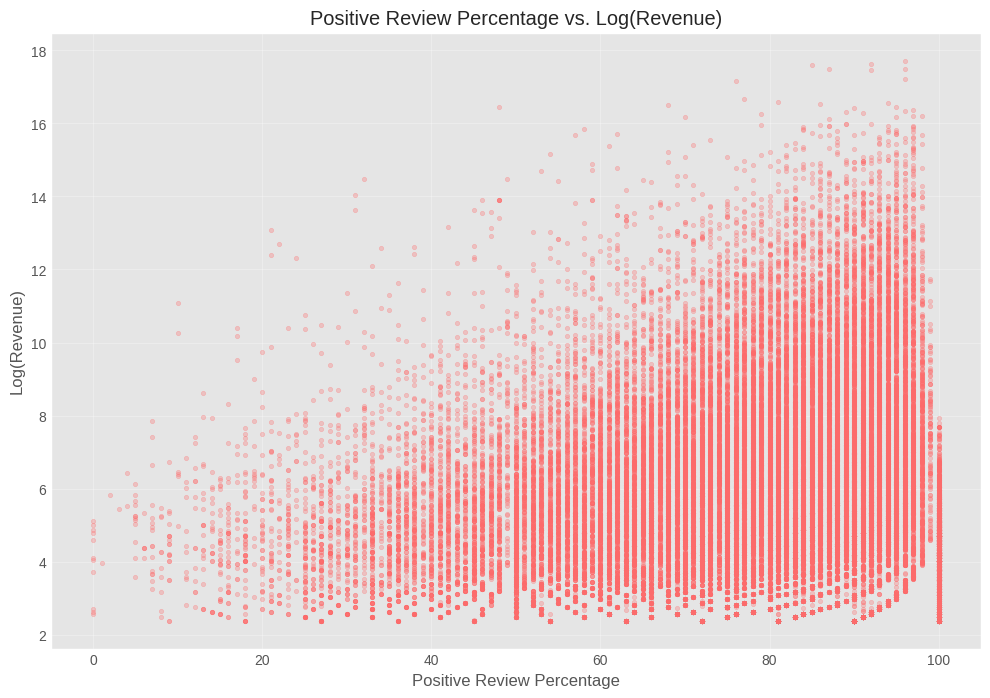


1. WEIGHTED LEAST SQUARES REGRESSION

OLS Results (for comparison):
R-squared: 0.0232

Weighted Least Squares Results:
                            WLS Regression Results                            
Dep. Variable:            log_revenue   R-squared:                       0.037
Model:                            WLS   Adj. R-squared:                  0.037
Method:                 Least Squares   F-statistic:                     1991.
Date:                Wed, 19 Mar 2025   Prob (F-statistic):               0.00
Time:                        12:33:02   Log-Likelihood:            -1.1750e+05
No. Observations:               51512   AIC:                         2.350e+05
Df Residuals:                   51510   BIC:                         2.350e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                    coef    std err          t      P>|t|      [0.025      0.975]
--------

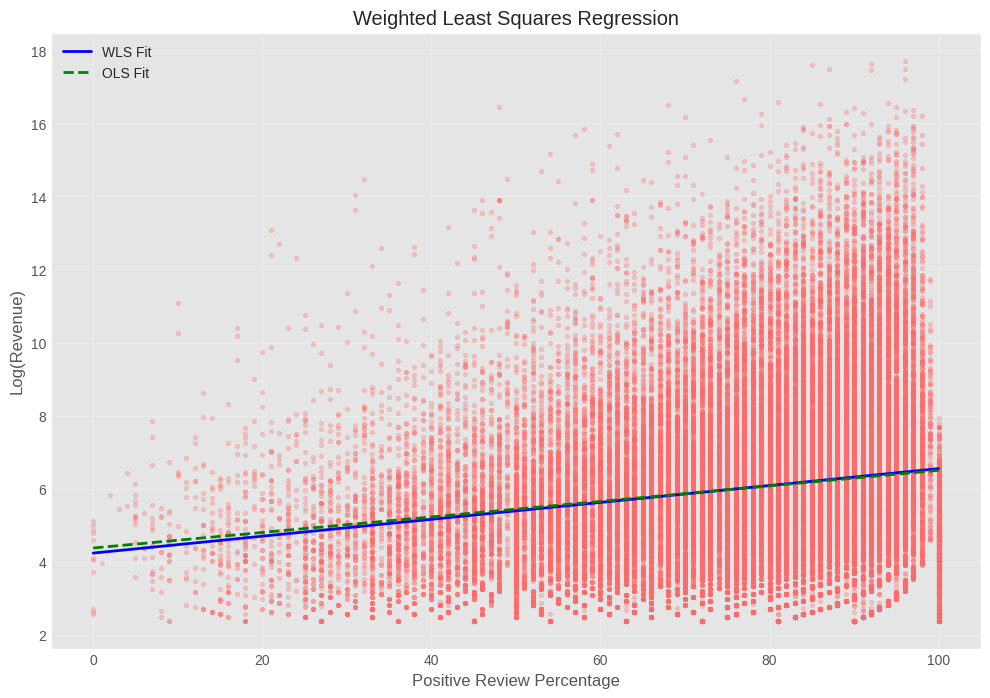


2. QUANTILE REGRESSION


KeyboardInterrupt: 

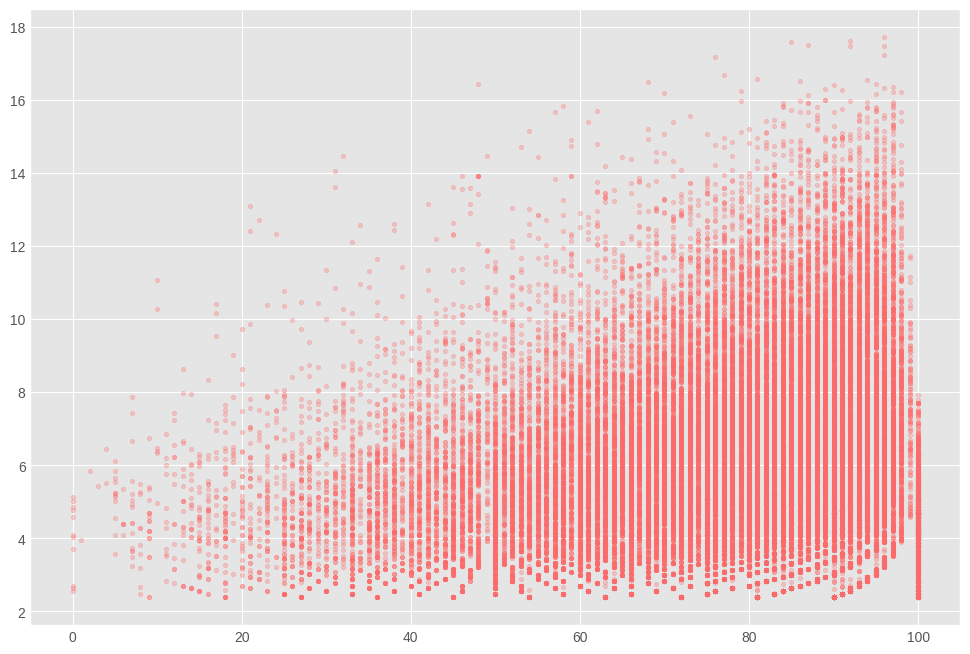

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import QuantileRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import warnings
warnings.filterwarnings('ignore')

# Set plotting parameters
plt.style.use('ggplot')
plt.rcParams['figure.figsize'] = [12, 8]

# Load the data
df = pd.read_csv("/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")

# Data preprocessing
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
df = df.dropna(subset=['release_date'])

# Filter out games with no reviews or missing review percentages
df = df[~df['num_reviews_total'].isna() & (df['num_reviews_total'] > 10) & (df['num_reviews_total'] != -1)]
df = df[~df['pct_pos_total'].isna()]  # Ensure we have review percentage data

# Calculate estimated revenue metrics
df['min_price'] = df['price'].apply(lambda x: max(x, 0.99) if x >= 0 else 0.99)
df['revenue'] = df['num_reviews_total'] * df['min_price']
df['log_revenue'] = np.log(df['revenue'].clip(1, None))  # Natural log transform for better modeling

print(f"Dataset contains {len(df)} games with valid review percentage and revenue data")

# Create a scatter plot of review percentage vs log revenue
plt.figure()
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, s=10, color='#FF6B6B')
plt.xlabel('Positive Review Percentage')
plt.ylabel('Log(Revenue)')
plt.title('Positive Review Percentage vs. Log(Revenue)')
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------
# APPROACH 1: WEIGHTED LEAST SQUARES (WLS) REGRESSION
# ------------------------------------------------------------------------
print("\n1. WEIGHTED LEAST SQUARES REGRESSION")
print("====================================")

# First, run OLS to get residuals
X = sm.add_constant(df['pct_pos_total'])
ols_model = sm.OLS(df['log_revenue'], X)
ols_results = ols_model.fit()
print("\nOLS Results (for comparison):")
print(f"R-squared: {ols_results.rsquared:.4f}")

# Group data by review percentage bins to estimate variance at each level
df['review_bin'] = pd.cut(df['pct_pos_total'], bins=20)
grouped_var = df.groupby('review_bin')['log_revenue'].var().reset_index()
grouped_var['review_mid'] = grouped_var['review_bin'].apply(lambda x: x.mid)

# Fit a model to predict variance based on review percentage
# Use exponential model since variance appears to increase exponentially
log_var = np.log(grouped_var['log_revenue'].values)
var_X = sm.add_constant(grouped_var['review_mid'])
var_model = sm.OLS(log_var, var_X).fit()

# Generate weights (inverse of fitted variance) for all observations
df['pred_var'] = np.exp(var_model.predict(sm.add_constant(df['pct_pos_total'])))
df['weights'] = 1 / df['pred_var']

# Fit WLS model using these weights
wls_model = sm.WLS(df['log_revenue'], X, weights=df['weights'])
wls_results = wls_model.fit()

print("\nWeighted Least Squares Results:")
print(wls_results.summary())
print(f"WLS R-squared: {wls_results.rsquared:.4f}")

# Plot the WLS fit
plt.figure()
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, s=10, color='#FF6B6B')
plt.plot(df['pct_pos_total'].sort_values(), 
         wls_results.predict(X).loc[df['pct_pos_total'].sort_values().index], 
         'b-', linewidth=2, label='WLS Fit')
plt.plot(df['pct_pos_total'].sort_values(), 
         ols_results.predict(X).loc[df['pct_pos_total'].sort_values().index], 
         'g--', linewidth=2, label='OLS Fit')
plt.xlabel('Positive Review Percentage')
plt.ylabel('Log(Revenue)')
plt.title('Weighted Least Squares Regression')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------
# APPROACH 2: QUANTILE REGRESSION
# ------------------------------------------------------------------------
print("\n2. QUANTILE REGRESSION")
print("=====================")

# Prepare data for quantile regression
X_qr = df['pct_pos_total'].values.reshape(-1, 1)
y_qr = df['log_revenue'].values

# Define quantiles to model
quantiles = [0.1, 0.25, 0.5, 0.75, 0.9]

# Fit quantile regression for each quantile
plt.figure()
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, s=10, color='#FF6B6B')

# Store fitted models and scores
qr_models = {}
qr_scores = {}

for q in quantiles:
    qr = QuantileRegressor(quantile=q, alpha=0, solver='highs')
    qr.fit(X_qr, y_qr)
    qr_models[q] = qr
    
    # Calculate pseudo-R² for quantile regression
    # Based on proportion of absolute deviation explained
    y_pred = qr.predict(X_qr)
    null_model = np.quantile(y_qr, q) * np.ones_like(y_qr)
    
    # Pseudo-R² = 1 - (Sum of absolute deviations / Sum of absolute deviations from quantile)
    numerator = np.sum(np.abs(y_qr - y_pred) * (q * (y_qr >= y_pred) + (1-q) * (y_qr < y_pred)))
    denominator = np.sum(np.abs(y_qr - null_model) * (q * (y_qr >= null_model) + (1-q) * (y_qr < null_model)))
    pseudo_r2 = 1 - (numerator / denominator)
    qr_scores[q] = pseudo_r2
    
    # Sort for plotting
    sort_idx = np.argsort(X_qr.flatten())
    
    # Plot the quantile regression line
    plt.plot(X_qr.flatten()[sort_idx], qr.predict(X_qr)[sort_idx], 
             linewidth=2, label=f'Quantile {q} (R² = {pseudo_r2:.3f})')

plt.xlabel('Positive Review Percentage')
plt.ylabel('Log(Revenue)')
plt.title('Quantile Regression: Multiple Quantiles')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

print("\nQuantile Regression Results:")
for q, r2 in qr_scores.items():
    print(f"Quantile {q}: Pseudo-R² = {r2:.4f}, Coefficient = {qr_models[q].coef_[0]:.6f}")

# ------------------------------------------------------------------------
# APPROACH 3: ROBUST REGRESSION
# ------------------------------------------------------------------------
print("\n3. ROBUST REGRESSION")
print("===================")

# Fit robust regression using Huber's T for resistance to outliers
from statsmodels.robust.robust_linear_model import RLM

rlm_model = RLM(df['log_revenue'], X, M=sm.robust.norms.HuberT())
rlm_results = rlm_model.fit()
print(rlm_results.summary())

# Plot robust regression fit
plt.figure()
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, s=10, color='#FF6B6B')
plt.plot(df['pct_pos_total'].sort_values(), 
         rlm_results.predict(X).loc[df['pct_pos_total'].sort_values().index], 
         'r-', linewidth=2, label='Robust Regression (Huber)')
plt.plot(df['pct_pos_total'].sort_values(), 
         ols_results.predict(X).loc[df['pct_pos_total'].sort_values().index], 
         'g--', linewidth=2, label='OLS Fit')
plt.xlabel('Positive Review Percentage')
plt.ylabel('Log(Revenue)')
plt.title('Robust Regression: Less Sensitive to Outliers')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------
# APPROACH 4: POLYNOMIAL REGRESSION
# ------------------------------------------------------------------------
print("\n4. POLYNOMIAL REGRESSION")
print("======================")

# Try polynomial regression to better capture the relationship
X_poly = df['pct_pos_total'].values.reshape(-1, 1)
y_poly = df['log_revenue'].values

# Split data for validation
X_train, X_test, y_train, y_test = train_test_split(X_poly, y_poly, test_size=0.25, random_state=42)

# Test different polynomial degrees
max_degree = 5
train_r2 = []
test_r2 = []
test_rmse = []

for degree in range(1, max_degree + 1):
    # Transform features
    poly = PolynomialFeatures(degree=degree)
    X_train_poly = poly.fit_transform(X_train)
    X_test_poly = poly.transform(X_test)
    
    # Fit model
    model = sm.OLS(y_train, X_train_poly)
    results = model.fit()
    
    # Calculate scores
    y_train_pred = results.predict(X_train_poly)
    y_test_pred = results.predict(X_test_poly)
    
    train_r2.append(r2_score(y_train, y_train_pred))
    test_r2.append(r2_score(y_test, y_test_pred))
    test_rmse.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))

# Plot R² scores by degree
plt.figure()
plt.plot(range(1, max_degree + 1), train_r2, 'bo-', label='Training R²')
plt.plot(range(1, max_degree + 1), test_r2, 'ro-', label='Test R²')
plt.xlabel('Polynomial Degree')
plt.ylabel('R² Score')
plt.title('Polynomial Model Performance by Degree')
plt.legend()
plt.grid(True, alpha=0.3)
plt.xticks(range(1, max_degree + 1))
plt.show()

# Get best degree based on test R²
best_degree = np.argmax(test_r2) + 1
print(f"\nBest polynomial degree based on test R²: {best_degree}")
print(f"Test R² for degree {best_degree}: {test_r2[best_degree-1]:.4f}")
print(f"Test RMSE for degree {best_degree}: {test_rmse[best_degree-1]:.4f}")

# Fit final polynomial model with best degree
poly_best = PolynomialFeatures(degree=best_degree)
X_poly_full = poly_best.fit_transform(X_poly)
poly_model = sm.OLS(y_poly, X_poly_full)
poly_results = poly_model.fit()

# Plot the polynomial fit
plt.figure()
plt.scatter(df['pct_pos_total'], df['log_revenue'], alpha=0.3, s=10, color='#FF6B6B')

# Create a range of x values for smooth curve
x_range = np.linspace(0, 100, 1000).reshape(-1, 1)
x_range_poly = poly_best.transform(x_range)
y_pred_poly = poly_results.predict(x_range_poly)

plt.plot(x_range, y_pred_poly, 'b-', linewidth=2, label=f'Polynomial (degree {best_degree})')
plt.plot(df['pct_pos_total'].sort_values(), 
         ols_results.predict(X).loc[df['pct_pos_total'].sort_values().index], 
         'g--', linewidth=2, label='Linear Fit')
plt.xlabel('Positive Review Percentage')
plt.ylabel('Log(Revenue)')
plt.title(f'Polynomial Regression (Degree {best_degree})')
plt.legend()
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------
# APPROACH 5: MODEL EVALUATION AND COMPARISON
# ------------------------------------------------------------------------
print("\n5. MODEL EVALUATION AND COMPARISON")
print("================================")

# Compare the performance of different models
models = ['OLS', 'WLS', 'Quantile (0.5)', 'Robust', f'Polynomial (deg {best_degree})']
r2_scores = [
    ols_results.rsquared,
    wls_results.rsquared,
    qr_scores[0.5],  # Median quantile
    rlm_results.rsquared, 
    poly_results.rsquared
]

plt.figure()
plt.bar(models, r2_scores, color=['#4ECDC4', '#FF6B6B', '#F9C80E', '#662E9B', '#43BCCD'])
plt.ylabel('R² Score')
plt.title('Model Performance Comparison')
plt.xticks(rotation=45)
plt.tight_layout()
plt.grid(True, alpha=0.3)
plt.show()

# ------------------------------------------------------------------------
# APPROACH 6: PREDICTING REVENUE FROM REVIEW PERCENTAGE
# ------------------------------------------------------------------------
print("\n6. PREDICTING REVENUE FROM REVIEW PERCENTAGE")
print("=========================================")

# Use the best model to predict revenue at various review percentages
review_percentages = np.arange(0, 101, 10)  # 0% to 100% in 10% steps

# Get predictions from different models
predictions = {}

# OLS predictions
ols_preds = [ols_results.predict(sm.add_constant([r]))[0] for r in review_percentages]
predictions['OLS'] = ols_preds

# WLS predictions
wls_preds = [wls_results.predict(sm.add_constant([r]))[0] for r in review_percentages]
predictions['WLS'] = wls_preds

# Quantile predictions (median)
qr_preds = qr_models[0.5].predict(review_percentages.reshape(-1, 1))
predictions['Quantile (0.5)'] = qr_preds

# Robust predictions
rlm_preds = [rlm_results.predict(sm.add_constant([r]))[0] for r in review_percentages]
predictions['Robust'] = rlm_preds

# Polynomial predictions
poly_preds = []
for r in review_percentages:
    poly_input = poly_best.transform(np.array([[r]]))
    poly_preds.append(poly_results.predict(poly_input)[0])
predictions['Polynomial'] = poly_preds

# Create a DataFrame with all predictions
pred_df = pd.DataFrame({
    'Review_Percentage': review_percentages,
    'OLS_Log_Revenue': predictions['OLS'],
    'WLS_Log_Revenue': predictions['WLS'],
    'Quantile_Log_Revenue': predictions['Quantile (0.5)'],
    'Robust_Log_Revenue': predictions['Robust'],
    'Polynomial_Log_Revenue': predictions['Polynomial'],
})

# Convert log revenue to actual revenue
for model in ['OLS', 'WLS', 'Quantile (0.5)', 'Robust', 'Polynomial']:
    col_name = model.replace(' ', '_').replace('(', '').replace(')', '') + '_Log_Revenue'
    pred_df[model.replace(' ', '_').replace('(', '').replace(')', '') + '_Revenue'] = np.exp(pred_df[col_name])

# Display predicted revenue table
print("\nPredicted Revenue by Review Percentage:")
cols_to_display = ['Review_Percentage', 'OLS_Revenue', 'WLS_Revenue', 
                   'Quantile_0.5_Revenue', 'Robust_Revenue', 'Polynomial_Revenue']
print(pred_df[cols_to_display].round(2))

# Plot predicted revenue by review percentage
plt.figure(figsize=(12, 8))
for model in ['OLS', 'WLS', 'Quantile (0.5)', 'Robust', 'Polynomial']:
    col_name = model.replace(' ', '_').replace('(', '').replace(')', '') + '_Revenue'
    plt.plot(pred_df['Review_Percentage'], pred_df[col_name], 
             linewidth=2, label=f'{model} Model')

plt.xlabel('Positive Review Percentage')
plt.ylabel('Predicted Revenue ($)')
plt.title('Predicted Revenue by Review Percentage')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Calculate the revenue premium for higher reviews
premium_df = pd.DataFrame({
    'Model': ['OLS', 'WLS', 'Quantile (0.5)', 'Robust', 'Polynomial']
})

# Calculate percentage increase from 70% to 90% reviews
revenue_70 = {}
revenue_90 = {}
premium_pct = {}

for model in premium_df['Model']:
    col_name = model.replace(' ', '_').replace('(', '').replace(')', '') + '_Revenue'
    revenue_70[model] = pred_df[pred_df['Review_Percentage'] == 70][col_name].values[0]
    revenue_90[model] = pred_df[pred_df['Review_Percentage'] == 90][col_name].values[0]
    premium_pct[model] = ((revenue_90[model] / revenue_70[model]) - 1) * 100

premium_df['Revenue_at_70%'] = premium_df['Model'].map(revenue_70)
premium_df['Revenue_at_90%'] = premium_df['Model'].map(revenue_90)
premium_df['Premium_Percentage'] = premium_df['Model'].map(premium_pct)

print("\nRevenue Premium for 90% vs 70% Positive Reviews:")
print(premium_df.round(2))

# Summary of findings
print("\nSUMMARY OF FINDINGS:")
print("===================")
print(f"1. Best model based on R² score: {models[np.argmax(r2_scores)]} (R² = {max(r2_scores):.4f})")
print(f"2. Average premium for 90% vs 70% reviews: {premium_df['Premium_Percentage'].mean():.2f}%")
print("3. Quantile regression shows the relationship varies across the revenue distribution:")
for q in [0.1, 0.5, 0.9]:
    print(f"   - At the {q*100}th percentile, coefficient = {qr_models[q].coef_[0]:.6f}")
print(f"4. WLS model accounts for increasing variance at higher review percentages")
print(f"5. Polynomial model (degree {best_degree}) captures non-linear relationship")

# Initial Stats

## Critics vs Users

Original dataset size: 89618
After removing invalid reviews and metacritic scores: 3512
=== Metacritic Score Statistics ===
count    3512.000000
mean       73.456435
std        10.157144
min        20.000000
25%        68.000000
50%        75.000000
75%        81.000000
max        97.000000
Name: metacritic_score, dtype: float64

=== Peak CCU Statistics ===
count      3512.000000
mean        882.498861
std       11134.695188
min           0.000000
25%           0.000000
50%           5.000000
75%          48.000000
max      555977.000000
Name: peak_ccu, dtype: float64

=== Positive Reviews Percentage Statistics ===
count    3512.000000
mean       80.375285
std        13.939379
min         9.000000
25%        73.000000
50%        84.000000
75%        91.000000
max       100.000000
Name: pct_pos_total, dtype: float64

=== Missing Values ===
metacritic_score: 0 missing values (0.00%)
peak_ccu: 0 missing values (0.00%)
pct_pos_total: 0 missing values (0.00%)

=== Market Concentration Analy

ValueError: Unable to determine Axes to steal space for Colorbar. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.

<Figure size 1400x1000 with 0 Axes>

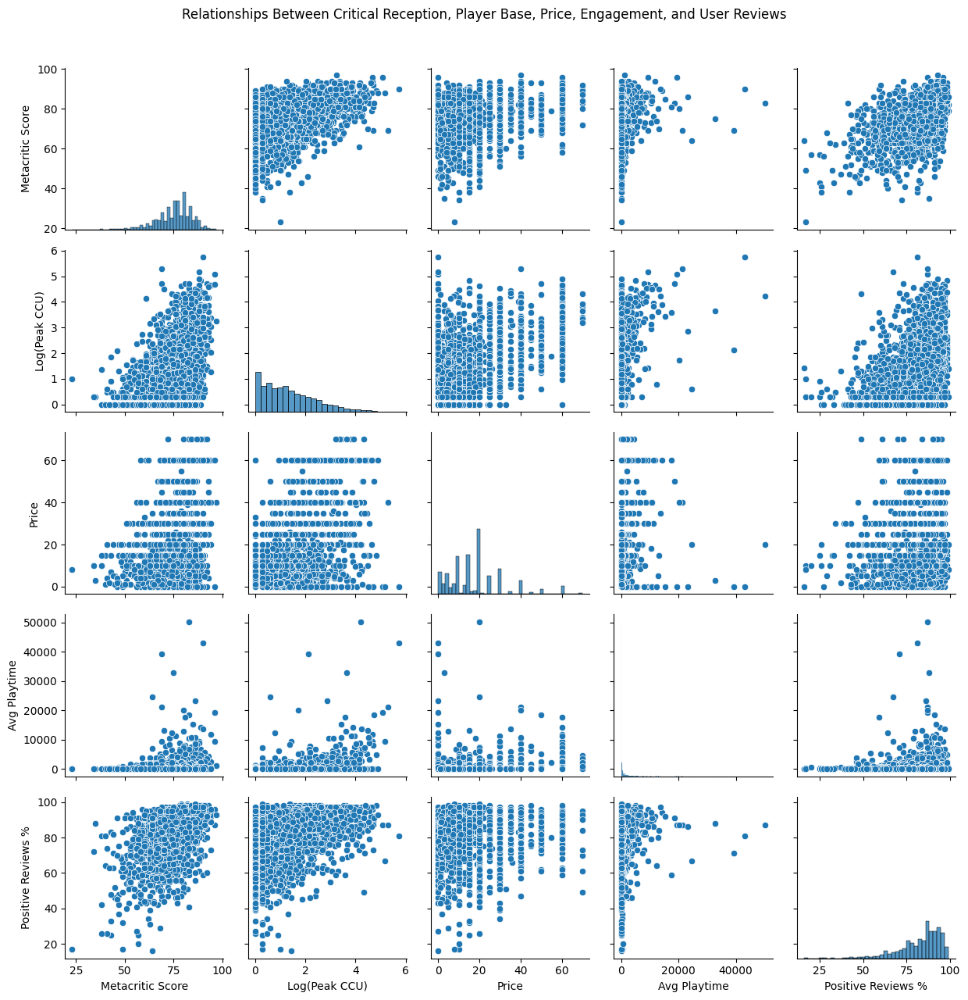

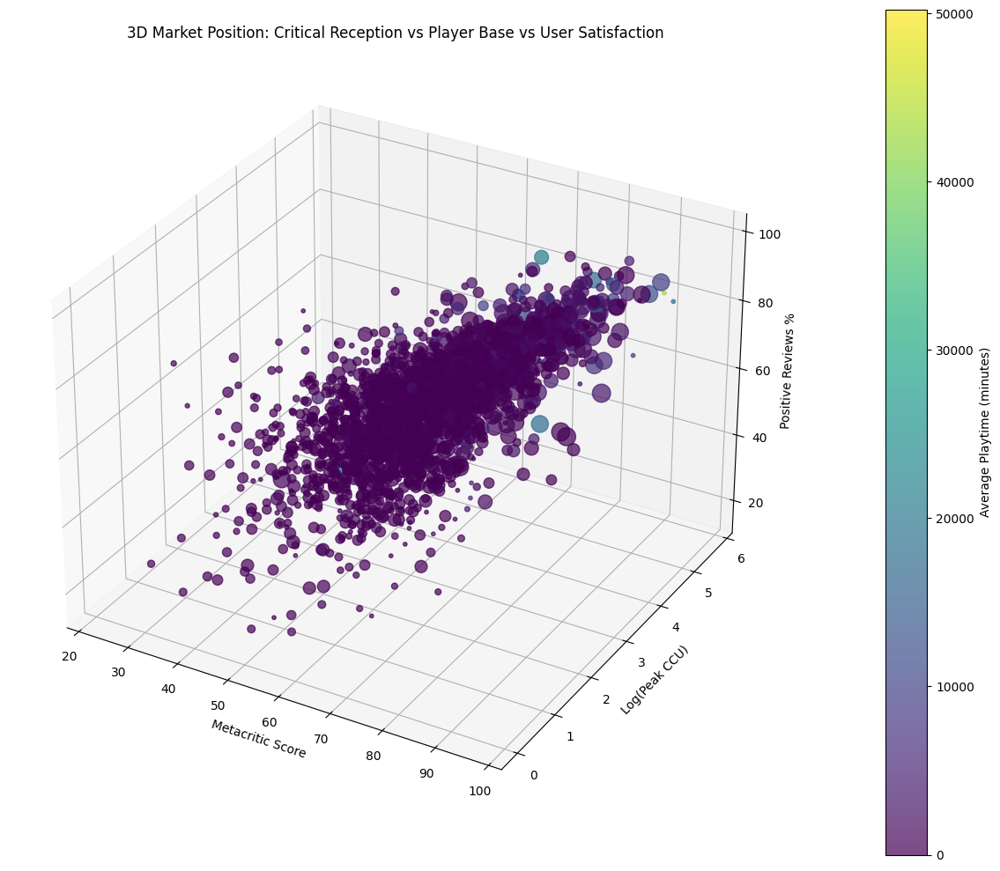

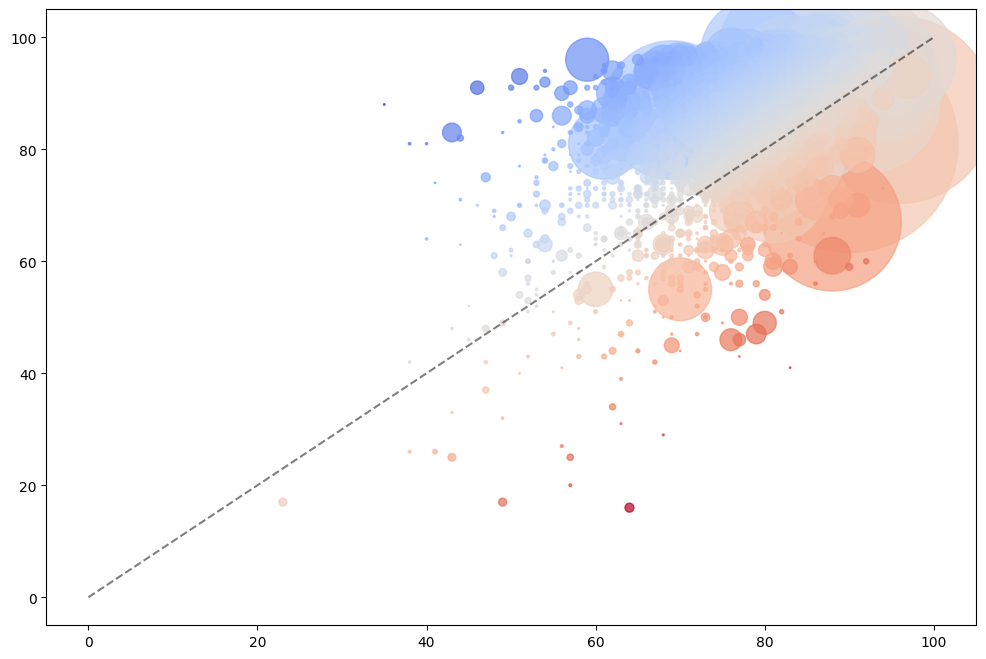

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats



# Clean the data - filter out invalid values
# Remove entries with pct_pos_total of -1 and metacritic_score of 0
print("Original dataset size:", len(df))
df_clean = df[(df['pct_pos_total'] != -1) & ((df['metacritic_score'] > 0) | df['metacritic_score'].isna())]
print("After removing invalid reviews and metacritic scores:", len(df_clean))

# Create a subset of data with the relevant columns
analysis_df = df_clean[['metacritic_score', 'peak_ccu', 'price', 
                  'average_playtime_forever', 'pct_pos_total', 'num_reviews_total']].copy()

# Basic statistics for our key metrics
print("=== Metacritic Score Statistics ===")
print(df_clean['metacritic_score'].describe())

print("\n=== Peak CCU Statistics ===")
print(df_clean['peak_ccu'].describe())

print("\n=== Positive Reviews Percentage Statistics ===")
print(df_clean['pct_pos_total'].describe())

# Check for missing values in columns
print("\n=== Missing Values ===")
for col in ['metacritic_score', 'peak_ccu', 'pct_pos_total']:
    missing_count = df_clean[col].isna().sum()
    missing_percent = (missing_count / len(df_clean)) * 100
    print(f"{col}: {missing_count} missing values ({missing_percent:.2f}%)")

# Create a filtered dataset for analysis
df_filtered = df_clean[df_clean['peak_ccu'] > 0].copy()  # Filter out zeros for log transform
df_filtered['log_peak_ccu'] = np.log10(df_filtered['peak_ccu'])

# Calculate market concentration metrics
print("\n=== Market Concentration Analysis (Peak CCU) ===")
total_ccu = df_filtered['peak_ccu'].sum()
df_filtered['market_share'] = df_filtered['peak_ccu'] / total_ccu * 100

# Calculate HHI
hhi = (df_filtered['market_share'] ** 2).sum()
print(f"HHI based on peak_ccu market share: {hhi:.2f}")
print("Note: HHI > 2500 is considered highly concentrated")

# Calculate CR4 (Concentration Ratio for top 4)
cr4 = df_filtered.nlargest(4, 'peak_ccu')['market_share'].sum()
print(f"CR4 (top 4 games' market share): {cr4:.2f}%")

# Show top 10 games by peak_ccu with the added positive reviews percentage
print("\n=== Top 10 Games by Peak CCU ===")
top_ccu_games = df_filtered.nlargest(10, 'peak_ccu')[
    ['name', 'peak_ccu', 'metacritic_score', 'pct_pos_total', 'market_share']]
print(top_ccu_games)

# Create an enhanced pair plot including pct_pos_total
plt.figure(figsize=(14, 10))
pair_cols = ['metacritic_score', 'log_peak_ccu', 'price', 
             'average_playtime_forever', 'pct_pos_total']
# Filter to reduce noise and only include games with sufficient data
pair_df = df_filtered[df_filtered['num_reviews_total'] > 50][pair_cols].copy()
# Handle any remaining NaN values
pair_df = pair_df.dropna()
# Rename for better labeling
pair_df.columns = ['Metacritic Score', 'Log(Peak CCU)', 'Price', 
                  'Avg Playtime', 'Positive Reviews %']
sns.pairplot(pair_df)
plt.suptitle('Relationships Between Critical Reception, Player Base, Price, Engagement, and User Reviews', y=1.02)
plt.tight_layout()
plt.savefig('expanded_pairplot.png')

# Create a 3D visualization that incorporates critical scores, player counts, and user satisfaction
from mpl_toolkits.mplot3d import Axes3D

# Filter data for 3D plot - ensure no missing values
plot3d_df = df_filtered.dropna(subset=['metacritic_score', 'peak_ccu', 'pct_pos_total']).copy()
# Only include games with sufficient reviews to ensure reliable percentages
plot3d_df = plot3d_df[plot3d_df['num_reviews_total'] > 100]

fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Create scatter plot with size based on price and color based on playtime
scatter = ax.scatter(
    plot3d_df['metacritic_score'],
    plot3d_df['log_peak_ccu'],
    plot3d_df['pct_pos_total'],
    c=plot3d_df['average_playtime_forever'],
    cmap='viridis',
    s=plot3d_df['price']*3 + 10,
    alpha=0.7
)

# Add labels and title
ax.set_xlabel('Metacritic Score')
ax.set_ylabel('Log(Peak CCU)')
ax.set_zlabel('Positive Reviews %')
ax.set_title('3D Market Position: Critical Reception vs Player Base vs User Satisfaction')

# Add a color bar
cbar = fig.colorbar(scatter, ax=ax, pad=0.1)
cbar.set_label('Average Playtime (minutes)')

plt.tight_layout()
plt.savefig('3d_market_position.png')

# Create a competitiveness visualization using metacritic and user reviews
plt.figure(figsize=(12, 8))

# Filter data - ensure we have both metrics and sufficient reviews
review_compare_df = df_filtered.dropna(subset=['metacritic_score', 'pct_pos_total']).copy()
review_compare_df = review_compare_df[review_compare_df['num_reviews_total'] > 100]

# Calculate the difference between critic and user ratings
# Both are already on 0-100 scale
review_compare_df['critic_user_diff'] = review_compare_df['metacritic_score'] - review_compare_df['pct_pos_total']

plt.scatter(
    review_compare_df['metacritic_score'],
    review_compare_df['pct_pos_total'],
    c=review_compare_df['critic_user_diff'],
    cmap='coolwarm',
    s=review_compare_df['num_reviews_total'] / 100,  # Size based on number of reviews
    alpha=0.7
)

# Add reference line (where critic score = user score)
plt.plot([0, 100], [0, 100], 'k--', alpha=0.5)

# Add colorbar
sm = plt.cm.ScalarMappable(cmap='coolwarm')
sm.set_array(review_compare_df['critic_user_diff'])
cbar = plt.colorbar(sm)
cbar.set_label('Critic Score - User Score')

# Add quadrant lines at median values
plt.axvline(x=review_compare_df['metacritic_score'].median(), color='gray', linestyle='--', alpha=0.5)
plt.axhline(y=review_compare_df['pct_pos_total'].median(), color='gray', linestyle='--', alpha=0.5)

# Add quadrant labels
plt.text(
    95, 
    95,
    'Universally\nAcclaimed',
    ha='center',
    bbox=dict(facecolor='white', alpha=0.5)
)
plt.text(
    50, 
    95,
    'User Favorites\nCritic Underrated',
    ha='center',
    bbox=dict(facecolor='white', alpha=0.5)
)
plt.text(
    95, 
    50,
    'Critic Favorites\nUser Underrated',
    ha='center',
    bbox=dict(facecolor='white', alpha=0.5)
)
plt.text(
    50, 
    50,
    'Divisive or\nNiche Appeal',
    ha='center',
    bbox=dict(facecolor='white', alpha=0.5)
)

plt.title('Critical Reception vs. User Satisfaction')
plt.xlabel('Metacritic Score')
plt.ylabel('Positive User Reviews %')
plt.grid(alpha=0.3)

plt.tight_layout()
plt.savefig('critic_vs_user_ratings.png')

# Market competitiveness visualization using all three metrics
plt.figure(figsize=(14, 10))

# Filter data for plot - ensure no missing values and sufficient reviews
comp_df = df_filtered.dropna(subset=['metacritic_score', 'pct_pos_total', 'peak_ccu']).copy()
comp_df = comp_df[comp_df['num_reviews_total'] > 100]  # Ensure sufficient reviews

# Calculate point sizes based on log of peak_ccu (for better visualization)
size_min, size_max = 20, 500
comp_df['plot_size'] = np.interp(
    np.log10(comp_df['peak_ccu']), 
    [np.log10(comp_df['peak_ccu'].min()), np.log10(comp_df['peak_ccu'].max())], 
    [size_min, size_max]
)

# Create scatter plot
plt.scatter(
    comp_df['metacritic_score'],
    comp_df['pct_pos_total'],
    s=comp_df['plot_size'],
    c=comp_df['price'],
    cmap='copper',
    alpha=0.7,
    edgecolors='gray',
    linewidth=0.5
)

# Add colorbar for price
sm = plt.cm.ScalarMappable(cmap='copper')
sm.set_array(comp_df['price'])
cbar = plt.colorbar(sm)
cbar.set_label('Price ($)')

# Add size legend
for size, label in zip([size_min, size_max/2, size_max], 
                      ['Low CCU', 'Medium CCU', 'High CCU']):
    plt.scatter([], [], s=size, c='gray', alpha=0.7, edgecolors='gray',
               label=label)
plt.legend(title='Market Share', loc='lower left')

# Add reference lines at median values
plt.axvline(x=comp_df['metacritic_score'].median(), color='gray', linestyle='--', alpha=0.5)
plt.axhline(y=comp_df['pct_pos_total'].median(), color='gray', linestyle='--', alpha=0.5)

# Calculate and display concentration metrics for this segment
segment_hhi = (comp_df['market_share'] ** 2).sum()
segment_cr4 = comp_df.nlargest(4, 'peak_ccu')['market_share'].sum()

plt.annotate(
    f"Segment HHI: {segment_hhi:.2f}\nCR4: {segment_cr4:.2f}%", 
    xy=(0.02, 0.02), 
    xycoords='axes fraction',
    bbox=dict(facecolor='white', alpha=0.7)
)

# Add title and labels
plt.title('Market Competitive Positioning: Critical Reception, User Satisfaction, and Market Share')
plt.xlabel('Metacritic Score (Critical Reception)')
plt.ylabel('Positive Reviews % (User Satisfaction)')
plt.grid(alpha=0.3)

plt.tight_layout()
plt.savefig('competitive_positioning.png')
plt.show()

# Calculate competitive positioning categories for analysis
print("\n=== Competitive Positioning Analysis ===")

# Create categories based on median values
med_meta = comp_df['metacritic_score'].median()
med_user = comp_df['pct_pos_total'].median()

comp_df['position'] = 'Uncategorized'  # Default value
comp_df.loc[(comp_df['metacritic_score'] >= med_meta) & 
            (comp_df['pct_pos_total'] >= med_user), 'position'] = 'Universal Appeal'
comp_df.loc[(comp_df['metacritic_score'] < med_meta) & 
            (comp_df['pct_pos_total'] >= med_user), 'position'] = 'User Favorite'
comp_df.loc[(comp_df['metacritic_score'] >= med_meta) & 
            (comp_df['pct_pos_total'] < med_user), 'position'] = 'Critic Favorite'
comp_df.loc[(comp_df['metacritic_score'] < med_meta) & 
            (comp_df['pct_pos_total'] < med_user), 'position'] = 'Niche Appeal'

# Calculate metrics by competitive position
position_stats = comp_df.groupby('position').agg({
    'peak_ccu': 'sum',
    'market_share': 'sum',
    'price': 'mean',
    'average_playtime_forever': 'mean',
    'metacritic_score': 'mean',
    'pct_pos_total': 'mean',
    'name': 'count'
}).rename(columns={'name': 'game_count'})

# Calculate market share of each position
position_stats['position_market_share'] = position_stats['peak_ccu'] / position_stats['peak_ccu'].sum() * 100

# Sort by market share for better readability
position_stats = position_stats.sort_values('position_market_share', ascending=False)

print(position_stats[['game_count', 'position_market_share', 'price', 
                     'average_playtime_forever', 'metacritic_score', 'pct_pos_total']])

# Show top 5 games in each competitive position
print("\n=== Top Games by Competitive Position ===")
for position in comp_df['position'].unique():
    position_df = comp_df[comp_df['position'] == position]
    top5 = position_df.nlargest(5, 'peak_ccu')[['name', 'peak_ccu', 'metacritic_score', 'pct_pos_total', 'price']]
    print(f"\n{position}:")
    print(top5)

Original dataset: 89618 games
After cleaning: 3512 games


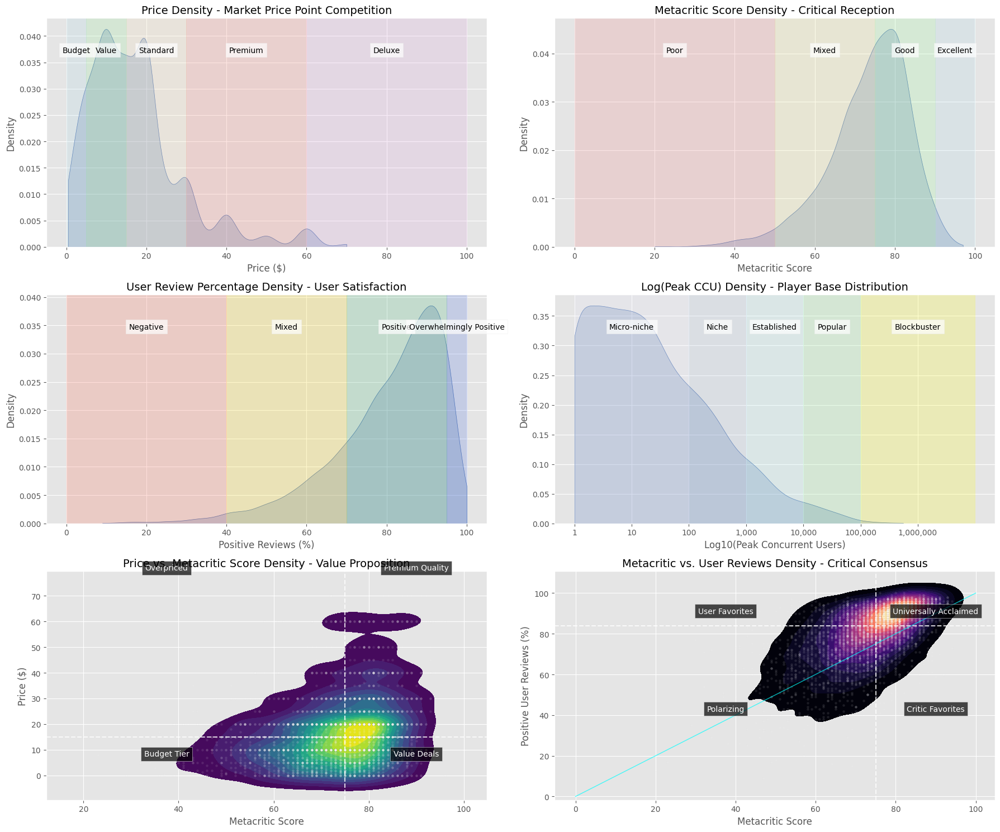

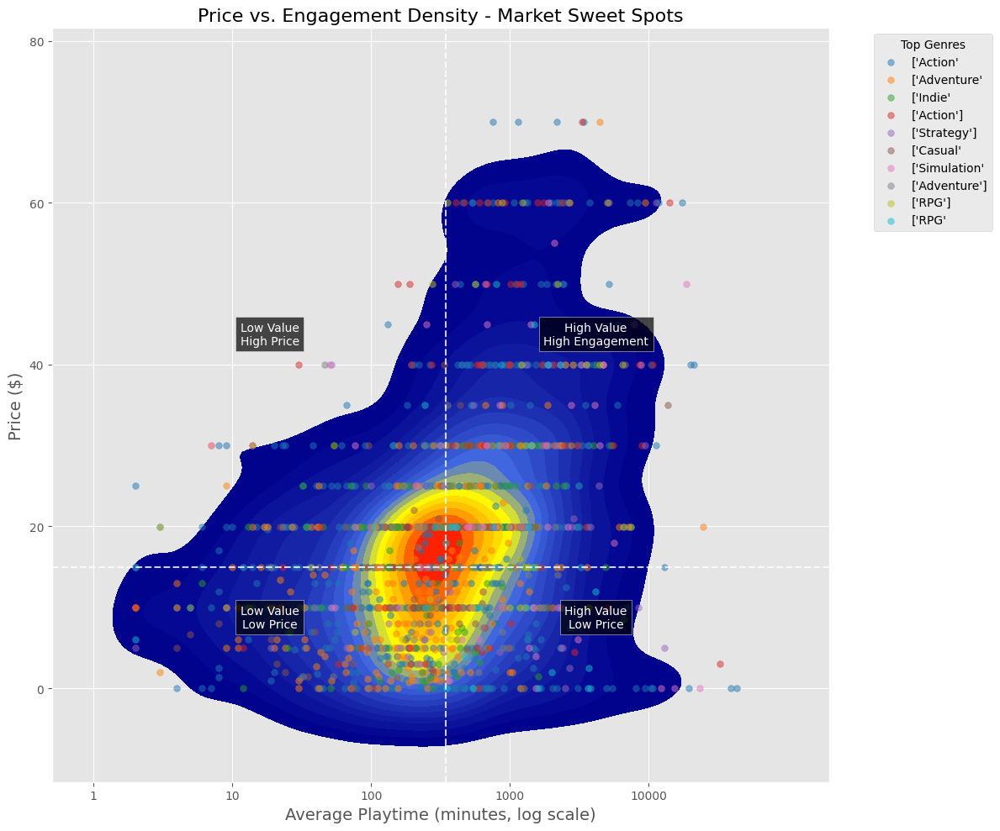

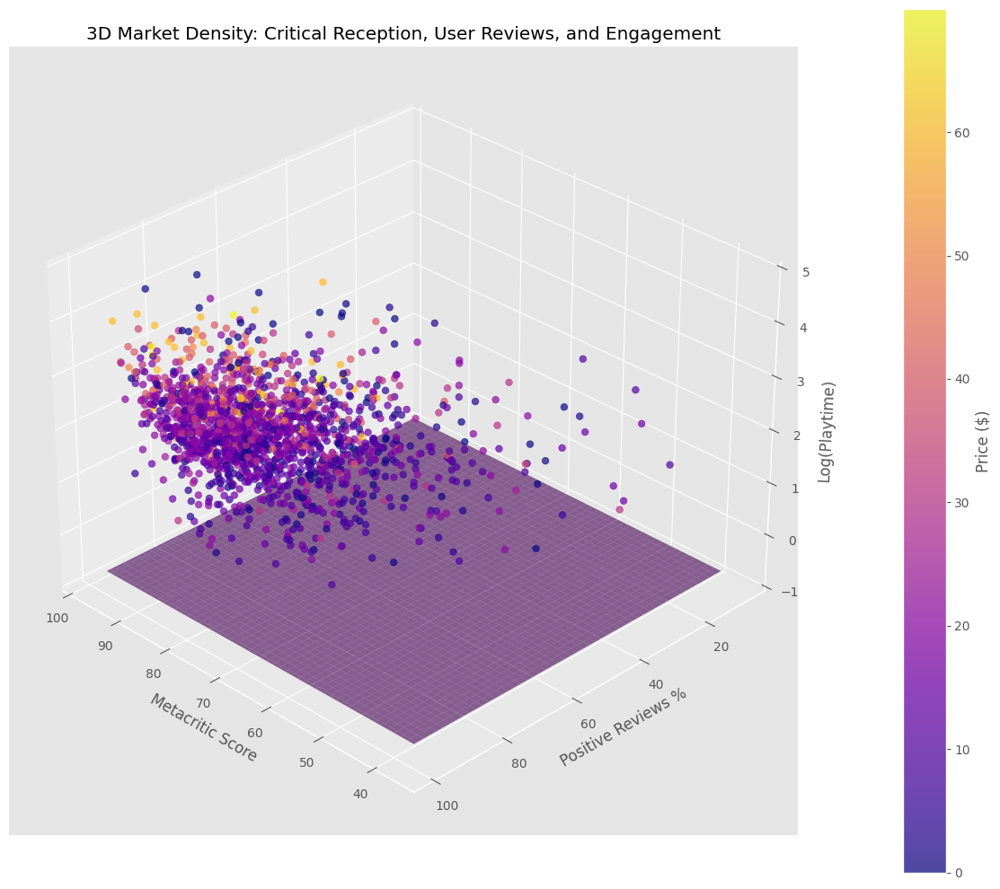

In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap

# Set the style for better visualizations
plt.style.use('ggplot')
sns.set_palette("deep")

# Load the dataset (replace with your file path)
#df = pd.read_csv('steam_games_data.csv')

# Clean the data - filter out invalid values
# Remove entries with pct_pos_total of -1 and metacritic_score of 0
df_clean = df[(df['pct_pos_total'] != -1) & ((df['metacritic_score'] > 0) | df['metacritic_score'].isna())]
print(f"Original dataset: {len(df)} games")
print(f"After cleaning: {len(df_clean)} games")

# Create a figure for density plots
plt.figure(figsize=(18, 15))

# 1. Price Density - Market price point competition
plt.subplot(3, 2, 1)
# Filter to exclude free games for better visualization
price_df = df_clean[df_clean['price'] > 0].copy()
# Limit to reasonable price range (e.g., below $100)
price_df = price_df[price_df['price'] < 100]
sns.kdeplot(data=price_df, x='price', fill=True, cut=0, common_norm=False)
plt.title('Price Density - Market Price Point Competition', fontsize=14)
plt.xlabel('Price ($)', fontsize=12)
plt.ylabel('Density', fontsize=12)

# Add price category bands
price_categories = [
    (0, 4.99, 'Budget', 'lightblue'),
    (4.99, 14.99, 'Value', 'lightgreen'),
    (14.99, 29.99, 'Standard', 'wheat'),
    (29.99, 59.99, 'Premium', 'salmon'),
    (59.99, 100, 'Deluxe', 'plum')
]

y_max = plt.gca().get_ylim()[1]
for start, end, label, color in price_categories:
    plt.axvspan(start, end, alpha=0.2, color=color, label=label)
    plt.text((start + end) / 2, y_max * 0.85, label, ha='center', 
             bbox=dict(facecolor='white', alpha=0.7))

# 2. Metacritic Score Density - Critical Reception Distribution
plt.subplot(3, 2, 2)
meta_df = df_clean.dropna(subset=['metacritic_score'])
sns.kdeplot(data=meta_df, x='metacritic_score', fill=True, cut=0)
plt.title('Metacritic Score Density - Critical Reception', fontsize=14)
plt.xlabel('Metacritic Score', fontsize=12)
plt.ylabel('Density', fontsize=12)

# Add quality tiers
quality_tiers = [
    (0, 50, 'Poor', 'lightcoral'),
    (50, 75, 'Mixed', 'khaki'),
    (75, 90, 'Good', 'palegreen'),
    (90, 100, 'Excellent', 'lightblue')
]

y_max = plt.gca().get_ylim()[1]
for start, end, label, color in quality_tiers:
    plt.axvspan(start, end, alpha=0.2, color=color)
    plt.text((start + end) / 2, y_max * 0.85, label, ha='center', 
             bbox=dict(facecolor='white', alpha=0.7))

# 3. User Review Percentage Density
plt.subplot(3, 2, 3)
review_df = df_clean.dropna(subset=['pct_pos_total'])
review_df = review_df[review_df['pct_pos_total'] >= 0]  # Ensure no negative percentages
sns.kdeplot(data=review_df, x='pct_pos_total', fill=True, cut=0)
plt.title('User Review Percentage Density - User Satisfaction', fontsize=14)
plt.xlabel('Positive Reviews (%)', fontsize=12)
plt.ylabel('Density', fontsize=12)

# Add reception categories
reception_cats = [
    (0, 40, 'Negative', 'tomato'),
    (40, 70, 'Mixed', 'gold'),
    (70, 95, 'Positive', 'mediumseagreen'),
    (95, 100, 'Overwhelmingly Positive', 'royalblue')
]

y_max = plt.gca().get_ylim()[1]
for start, end, label, color in reception_cats:
    plt.axvspan(start, end, alpha=0.2, color=color)
    plt.text((start + end) / 2, y_max * 0.85, label, ha='center', 
             bbox=dict(facecolor='white', alpha=0.7))

# 4. Peak CCU Density (log-transformed)
plt.subplot(3, 2, 4)
ccu_df = df_clean[df_clean['peak_ccu'] > 0].copy()
ccu_df['log_peak_ccu'] = np.log10(ccu_df['peak_ccu'])
sns.kdeplot(data=ccu_df, x='log_peak_ccu', fill=True, cut=0)
plt.title('Log(Peak CCU) Density - Player Base Distribution', fontsize=14)
plt.xlabel('Log10(Peak Concurrent Users)', fontsize=12)
plt.ylabel('Density', fontsize=12)

# Add custom x-axis tick labels
tick_locations = np.arange(0, 7)
tick_labels = [f"{10**x:,}" for x in tick_locations]
plt.xticks(tick_locations, tick_labels)

# Add market segment annotations
market_segments = [
    (0, 2, 'Micro-niche', 'lavender'),
    (2, 3, 'Niche', 'lightsteelblue'),
    (3, 4, 'Established', 'paleturquoise'),
    (4, 5, 'Popular', 'lightgreen'),
    (5, 7, 'Blockbuster', 'yellow')
]

y_max = plt.gca().get_ylim()[1]
for start, end, label, color in market_segments:
    plt.axvspan(start, end, alpha=0.2, color=color)
    plt.text((start + end) / 2, y_max * 0.85, label, ha='center', 
             bbox=dict(facecolor='white', alpha=0.7))

# 5. 2D Density: Price vs. Metacritic Score
plt.subplot(3, 2, 5)
# Create a dataset with both metrics
price_meta_df = df_clean.dropna(subset=['metacritic_score', 'price'])
price_meta_df = price_meta_df[price_meta_df['price'] < 100]  # Limit price for better viz

# Create 2D density plot
sns.kdeplot(
    data=price_meta_df, 
    x='metacritic_score', 
    y='price',
    fill=True, 
    cmap='viridis',
    levels=15,
    thresh=0.05
)

# Add scatter plot for individual games
plt.scatter(
    price_meta_df['metacritic_score'],
    price_meta_df['price'],
    s=10,
    alpha=0.1,
    c='white',
    edgecolor='gray',
    linewidth=0.1
)

plt.title('Price vs. Metacritic Score Density - Value Proposition', fontsize=14)
plt.xlabel('Metacritic Score', fontsize=12)
plt.ylabel('Price ($)', fontsize=12)

# Add quadrant lines at median values
plt.axvline(x=price_meta_df['metacritic_score'].median(), color='white', linestyle='--', alpha=0.8)
plt.axhline(y=price_meta_df['price'].median(), color='white', linestyle='--', alpha=0.8)

# Add quadrant labels
med_meta = price_meta_df['metacritic_score'].median()
med_price = price_meta_df['price'].median()

plt.text(
    90, 
    80,
    'Premium Quality',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    med_meta / 2, 
    80,
    'Overpriced',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    90, 
    med_price / 2,
    'Value Deals',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    med_meta / 2, 
    med_price / 2,
    'Budget Tier',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)

# 6. 2D Density: Metacritic Score vs. User Review Percentage
plt.subplot(3, 2, 6)
# Create a dataset with both metrics
meta_user_df = df_clean.dropna(subset=['metacritic_score', 'pct_pos_total'])
meta_user_df = meta_user_df[meta_user_df['pct_pos_total'] >= 0]  # Ensure no negative percentages

# Create 2D density plot
sns.kdeplot(
    data=meta_user_df, 
    x='metacritic_score', 
    y='pct_pos_total',
    fill=True, 
    cmap='magma',
    levels=15,
    thresh=0.05
)

# Add scatter plot for individual games
plt.scatter(
    meta_user_df['metacritic_score'],
    meta_user_df['pct_pos_total'],
    s=10,
    alpha=0.1,
    c='white',
    edgecolor='gray',
    linewidth=0.1
)

# Add reference line for equal scores
plt.plot([0, 100], [0, 100], color='cyan', linestyle='-', linewidth=1, alpha=0.7)

plt.title('Metacritic vs. User Reviews Density - Critical Consensus', fontsize=14)
plt.xlabel('Metacritic Score', fontsize=12)
plt.ylabel('Positive User Reviews (%)', fontsize=12)

# Add quadrant lines at median values
plt.axvline(x=meta_user_df['metacritic_score'].median(), color='white', linestyle='--', alpha=0.8)
plt.axhline(y=meta_user_df['pct_pos_total'].median(), color='white', linestyle='--', alpha=0.8)

# Add quadrant labels
med_meta = meta_user_df['metacritic_score'].median()
med_user = meta_user_df['pct_pos_total'].median()

plt.text(
    90, 
    90,
    'Universally Acclaimed',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    med_meta / 2, 
    90,
    'User Favorites',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    90, 
    med_user / 2,
    'Critic Favorites',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    med_meta / 2, 
    med_user / 2,
    'Polarizing',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)

plt.tight_layout()
plt.savefig('steam_density_analysis.png', dpi=300, bbox_inches='tight')

# Create an additional more advanced 2D density plot: Price vs. Market share (playtime)
plt.figure(figsize=(12, 10))

# Prepare data - we'll use average_playtime_forever as a proxy for market engagement
playtime_price_df = df_clean.dropna(subset=['average_playtime_forever', 'price'])
playtime_price_df = playtime_price_df[playtime_price_df['price'] < 100]  # Limit price
playtime_price_df = playtime_price_df[playtime_price_df['average_playtime_forever'] > 0]  # Ensure positive playtime
playtime_price_df['log_playtime'] = np.log10(playtime_price_df['average_playtime_forever'] + 1)  # Log transform

# Create custom colormap - from blue (low density) to yellow (medium) to red (high density)
colors = [(0, 'darkblue'), (0.4, 'royalblue'), (0.6, 'yellow'), (0.8, 'orange'), (1, 'red')]
cmap_name = 'density_cmap'
cm = LinearSegmentedColormap.from_list(cmap_name, colors, N=100)

# Create 2D density plot with custom colormap
sns.kdeplot(
    data=playtime_price_df, 
    x='log_playtime', 
    y='price',
    fill=True, 
    cmap=cm,
    levels=20,
    thresh=0.05
)

# Add scatter plot with more information
# Color by genre if available, otherwise use a default color
if 'genres' in df_clean.columns:
    # Get primary genre for each game (assuming genres is a list or string that can be split)
    playtime_price_df['primary_genre'] = playtime_price_df['genres'].apply(
        lambda x: str(x).split(',')[0].strip() if pd.notna(x) else 'Unknown'
    )
    
    # Get top 10 genres
    top_genres = playtime_price_df['primary_genre'].value_counts().head(10).index
    # Create a color map
    genre_colors = dict(zip(top_genres, sns.color_palette("tab10", 10)))
    
    # Create a scatter with genre colors
    for genre in top_genres:
        genre_df = playtime_price_df[playtime_price_df['primary_genre'] == genre]
        plt.scatter(
            genre_df['log_playtime'],
            genre_df['price'],
            s=30,
            alpha=0.5,
            color=genre_colors[genre],
            label=genre
        )
    plt.legend(title='Top Genres', bbox_to_anchor=(1.05, 1), loc='upper left')
else:
    # Simple scatter without genre information
    plt.scatter(
        playtime_price_df['log_playtime'],
        playtime_price_df['price'],
        s=20,
        alpha=0.2,
        c='white',
        edgecolor='gray'
    )

# Custom x-axis labels for log playtime
tick_locations = np.arange(0, 5)
tick_labels = [f"{10**x:.0f}" for x in tick_locations]
plt.xticks(tick_locations, tick_labels)

plt.title('Price vs. Engagement Density - Market Sweet Spots', fontsize=16)
plt.xlabel('Average Playtime (minutes, log scale)', fontsize=14)
plt.ylabel('Price ($)', fontsize=14)

# Add market segment annotations
x_median = playtime_price_df['log_playtime'].median()
y_median = playtime_price_df['price'].median()

plt.axvline(x=x_median, color='white', linestyle='--', alpha=0.8)
plt.axhline(y=y_median, color='white', linestyle='--', alpha=0.8)

market_segments = [
    (x_median, y_median, 'High Value\nHigh Engagement', 'top right'),
    (x_median, 0, 'High Value\nLow Price', 'bottom right'),
    (0, y_median, 'Low Value\nHigh Price', 'top left'),
    (0, 0, 'Low Value\nLow Price', 'bottom left')
]

for x, y, label, position in market_segments:
    if position == 'top right':
        plt.text(
            x_median + (playtime_price_df['log_playtime'].max() - x_median) * 0.5, 
            y_median + (playtime_price_df['price'].max() - y_median) * 0.5,
            label,
            ha='center',
            color='white',
            bbox=dict(facecolor='black', alpha=0.7)
        )
    elif position == 'bottom right':
        plt.text(
            x_median + (playtime_price_df['log_playtime'].max() - x_median) * 0.5, 
            y_median * 0.5,
            label,
            ha='center',
            color='white',
            bbox=dict(facecolor='black', alpha=0.7)
        )
    elif position == 'top left':
        plt.text(
            x_median * 0.5, 
            y_median + (playtime_price_df['price'].max() - y_median) * 0.5,
            label,
            ha='center',
            color='white',
            bbox=dict(facecolor='black', alpha=0.7)
        )
    elif position == 'bottom left':
        plt.text(
            x_median * 0.5, 
            y_median * 0.5,
            label,
            ha='center',
            color='white',
            bbox=dict(facecolor='black', alpha=0.7)
        )

plt.tight_layout()
plt.savefig('price_engagement_density.png', dpi=300, bbox_inches='tight')

# Create a third 3D density visualization
from mpl_toolkits.mplot3d import Axes3D

fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Prepare data - using metacritic, user reviews, and playtime
plot3d_df = df_clean.dropna(subset=['metacritic_score', 'pct_pos_total', 'average_playtime_forever'])
plot3d_df = plot3d_df[plot3d_df['pct_pos_total'] >= 0]  # Ensure positive percentages
plot3d_df = plot3d_df[plot3d_df['average_playtime_forever'] > 0]  # Ensure positive playtime
plot3d_df['log_playtime'] = np.log10(plot3d_df['average_playtime_forever'] + 1)  # Log transform

# Create a KDE object for X and Y data
x = plot3d_df['metacritic_score']
y = plot3d_df['pct_pos_total']
z = plot3d_df['log_playtime']

# Turn these into a surface plot
xi = np.linspace(x.min(), x.max(), 100)
yi = np.linspace(y.min(), y.max(), 100)
X, Y = np.meshgrid(xi, yi)

# Use scipy's gaussian_kde to estimate the 2D density
kernel = stats.gaussian_kde([x, y])
positions = np.vstack([X.ravel(), Y.ravel()])
Z = np.reshape(kernel(positions).T, X.shape)

# Plot the surface
surf = ax.plot_surface(X, Y, Z*0 + z.min()-1, cmap='viridis', alpha=0.6, linewidth=0)

# Add scatter points
scatter = ax.scatter(
    plot3d_df['metacritic_score'],
    plot3d_df['pct_pos_total'],
    plot3d_df['log_playtime'],
    c=plot3d_df['price'],
    cmap='plasma',
    s=30,
    alpha=0.7
)

# Add colorbar for price
cbar = fig.colorbar(scatter, ax=ax, pad=0.1)
cbar.set_label('Price ($)')

# Add axis labels
ax.set_xlabel('Metacritic Score')
ax.set_ylabel('Positive Reviews %')
ax.set_zlabel('Log(Playtime)')
ax.set_title('3D Market Density: Critical Reception, User Reviews, and Engagement')

# Set viewpoint
ax.view_init(elev=30, azim=135)

plt.tight_layout()
plt.savefig('3d_market_density.png', dpi=300, bbox_inches='tight')
plt.show()

## What are people buying RIGHT NOW!
- show Cumulative hour played average_playtime_2weeks, 2 week cc, genra,num_reviews_recent, price

Original dataset: 89618 games
Games with recent activity: 6761


/tmp/ipykernel_7933/1084527403.py:194: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(
/tmp/ipykernel_7933/1084527403.py:194: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  sns.violinplot(


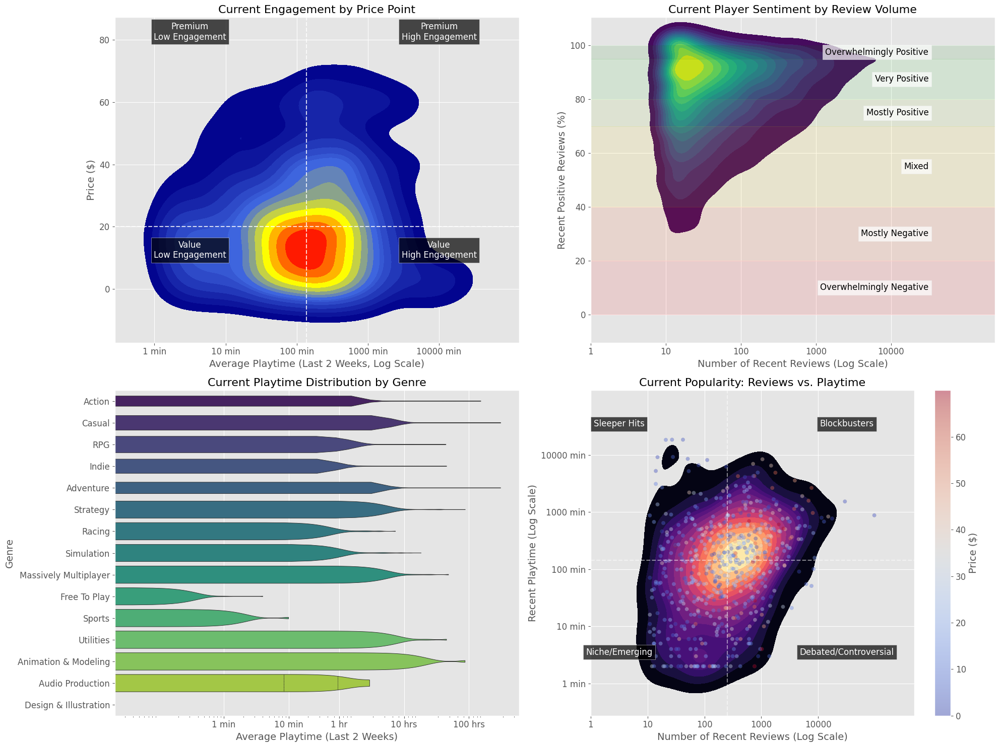

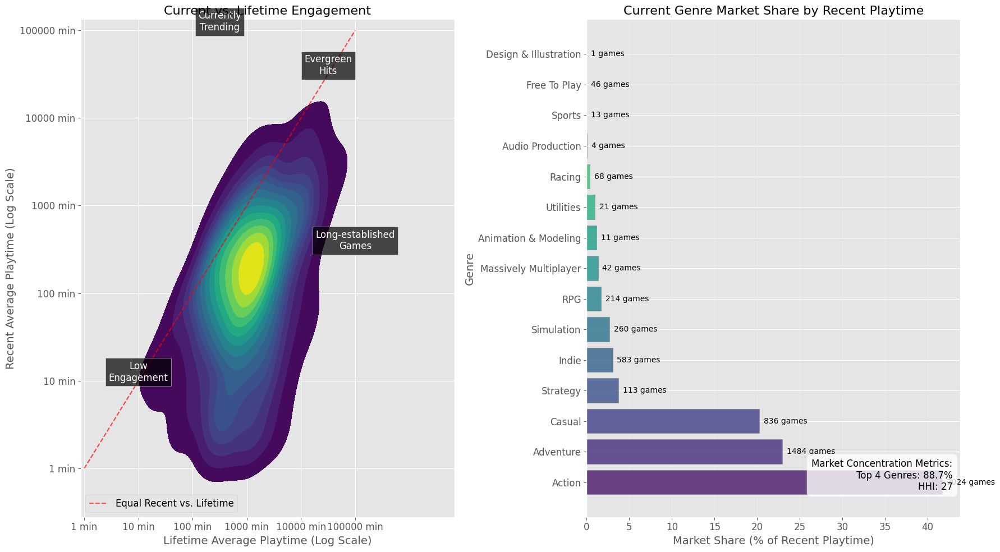

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import ast

# Set styling for better visuals
plt.style.use('ggplot')
sns.set_palette("deep")
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12



# Clean the data
print(f"Original dataset: {len(df)} games")
# Filter to games with recent activity (has recent reviews or recent playtime)
df_active = df[(df['num_reviews_recent'] > 0) | (df['average_playtime_2weeks'] > 0)].copy()
print(f"Games with recent activity: {len(df_active)}")

# Create a figure for "What people are buying RIGHT NOW!" analysis
plt.figure(figsize=(20, 15))

# 1. Recent Playtime Density by Price
plt.subplot(2, 2, 1)
# Filter to games with recent playtime data
recent_play_df = df_active[df_active['average_playtime_2weeks'] > 0].copy()
recent_play_df['log_playtime_2weeks'] = np.log10(recent_play_df['average_playtime_2weeks'] + 1)

# Create custom colormap
colors = [(0, 'darkblue'), (0.4, 'royalblue'), (0.7, 'yellow'), (1, 'red')]
cmap_name = 'density_cmap'
cm = LinearSegmentedColormap.from_list(cmap_name, colors, N=100)

# Create 2D density plot with custom colormap - price vs recent playtime
sns.kdeplot(
    data=recent_play_df[recent_play_df['price'] < 100],  # Filter outlier prices for better viz
    x='log_playtime_2weeks', 
    y='price',
    fill=True, 
    cmap=cm,
    levels=15,
    thresh=0.05
)

# Add custom x-axis labels for log playtime
tick_locations = np.arange(0, 5)
tick_labels = [f"{10**x:.0f} min" for x in tick_locations]
plt.xticks(tick_locations, tick_labels)

plt.title('Current Engagement by Price Point')
plt.xlabel('Average Playtime (Last 2 Weeks, Log Scale)')
plt.ylabel('Price ($)')

# Add quadrant lines at median values
plt.axvline(x=recent_play_df['log_playtime_2weeks'].median(), color='white', linestyle='--', alpha=0.8)
plt.axhline(y=recent_play_df['price'].median(), color='white', linestyle='--', alpha=0.8)

# Add quadrant labels
plt.text(
    4, 
    80,
    'Premium\nHigh Engagement',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    0.5, 
    80,
    'Premium\nLow Engagement',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    4, 
    10,
    'Value\nHigh Engagement',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    0.5, 
    10,
    'Value\nLow Engagement',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)

# 2. Recent Reviews Count Density - What's being actively reviewed
plt.subplot(2, 2, 2)
# Filter for games with recent reviews
recent_reviews_df = df_active[df_active['num_reviews_recent'] > 0].copy()
recent_reviews_df['log_reviews_recent'] = np.log10(recent_reviews_df['num_reviews_recent'] + 1)

# Create 2D density - recent reviews vs positive percentage
sns.kdeplot(
    data=recent_reviews_df,
    x='log_reviews_recent', 
    y='pct_pos_recent',
    fill=True, 
    cmap='viridis',
    levels=15,
    thresh=0.05
)

# Add custom x-axis labels for log review counts
tick_locations = np.arange(0, 5)
tick_labels = [f"{10**x:.0f}" for x in tick_locations]
plt.xticks(tick_locations, tick_labels)

plt.title('Current Player Sentiment by Review Volume')
plt.xlabel('Number of Recent Reviews (Log Scale)')
plt.ylabel('Recent Positive Reviews (%)')

# Add horizontal lines for Steam's review categories
review_categories = [
    (0, 20, 'Overwhelmingly Negative', 'red'),
    (20, 40, 'Mostly Negative', 'orangered'),
    (40, 70, 'Mixed', 'gold'),
    (70, 80, 'Mostly Positive', 'yellowgreen'),
    (80, 95, 'Very Positive', 'limegreen'),
    (95, 100, 'Overwhelmingly Positive', 'green')
]

for start, end, label, color in review_categories:
    plt.axhspan(start, end, alpha=0.1, color=color)
    plt.text(
        4.5, 
        (start + end) / 2,
        label,
        va='center',
        ha='right',
        color='black',
        bbox=dict(facecolor='white', alpha=0.7)
    )

# 3. Genre Popularity - Current playtime distribution across genres
plt.subplot(2, 2, 3)

# Function to safely parse list-like strings or handle lists
def parse_list_field(field):
    if isinstance(field, str):
        try:
            return ast.literal_eval(field)
        except (ValueError, SyntaxError):
            # If not a proper list, split by comma
            return [x.strip() for x in field.split(',')]
    elif isinstance(field, list):
        return field
    else:
        return []

# Process genres data
genre_data = []
for idx, row in df_active.iterrows():
    if pd.isna(row['genres']):
        continue
        
    genres = parse_list_field(row['genres'])
    
    # Skip if no valid genres
    if not genres:
        continue
        
    # Get the first genre (primary)
    primary_genre = genres[0]
    
    # Add to our data
    genre_data.append({
        'genre': primary_genre,
        'playtime_2weeks': row['average_playtime_2weeks'] if not pd.isna(row['average_playtime_2weeks']) else 0,
        'price': row['price'] if not pd.isna(row['price']) else 0
    })

# Create a DataFrame from our collected data
genre_df = pd.DataFrame(genre_data)

# Get the top 15 genres by total recent playtime
top_genres = genre_df.groupby('genre')['playtime_2weeks'].sum().nlargest(15).index

# Filter to only include top genres
genre_df_filtered = genre_df[genre_df['genre'].isin(top_genres)]

# Create a violin plot for distributions
sns.violinplot(
    data=genre_df_filtered,
    y='genre',
    x='playtime_2weeks',
    scale='width',
    inner='quartile',
    palette='viridis',
    cut=0
)

plt.title('Current Playtime Distribution by Genre')
plt.xlabel('Average Playtime (Last 2 Weeks)')
plt.ylabel('Genre')
plt.xscale('log')  # Use log scale to better see the distribution

# Format x-axis with custom labels
tick_locations = [1, 10, 60, 600, 6000]
tick_labels = ['1 min', '10 min', '1 hr', '10 hrs', '100 hrs']
plt.xticks(tick_locations, tick_labels)

# 4. 2D Density: Recent Reviews vs 2-Week Playtime - What's popular and well-received
plt.subplot(2, 2, 4)

# Create dataframe with both metrics
pop_df = df_active.dropna(subset=['num_reviews_recent', 'average_playtime_2weeks']).copy()
pop_df = pop_df[(pop_df['num_reviews_recent'] > 0) & (pop_df['average_playtime_2weeks'] > 0)]
pop_df['log_reviews'] = np.log10(pop_df['num_reviews_recent'] + 1)
pop_df['log_playtime'] = np.log10(pop_df['average_playtime_2weeks'] + 1)

# Create 2D density plot
sns.kdeplot(
    data=pop_df,
    x='log_reviews', 
    y='log_playtime',
    fill=True, 
    cmap='magma',
    levels=15,
    thresh=0.05
)

# Add price as colored scatter points
scatter = plt.scatter(
    pop_df['log_reviews'],
    pop_df['log_playtime'],
    c=pop_df['price'],
    s=30,
    alpha=0.4,
    cmap='coolwarm',
    edgecolor='gray',
    linewidth=0.2
)

# Add colorbar for price
cbar = plt.colorbar(scatter, label='Price ($)')

# Add custom axis labels
x_tick_locations = np.arange(0, 5)
x_tick_labels = [f"{10**x:.0f}" for x in x_tick_locations]
plt.xticks(x_tick_locations, x_tick_labels)

y_tick_locations = np.arange(0, 5)
y_tick_labels = [f"{10**x:.0f} min" for x in y_tick_locations]
plt.yticks(y_tick_locations, y_tick_labels)

plt.title('Current Popularity: Reviews vs. Playtime')
plt.xlabel('Number of Recent Reviews (Log Scale)')
plt.ylabel('Recent Playtime (Log Scale)')

# Add reference lines at median values
plt.axvline(x=pop_df['log_reviews'].median(), color='white', linestyle='--', alpha=0.5)
plt.axhline(y=pop_df['log_playtime'].median(), color='white', linestyle='--', alpha=0.5)

# Add quadrant labels
plt.text(
    4.5, 
    4.5,
    'Blockbusters',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    0.5, 
    4.5,
    'Sleeper Hits',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    4.5, 
    0.5,
    'Debated/Controversial',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    0.5, 
    0.5,
    'Niche/Emerging',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)

plt.tight_layout()
plt.savefig('current_player_trends.png', dpi=300, bbox_inches='tight')

# Create an additional figure for cumulative hour analysis
plt.figure(figsize=(18, 10))

# 1. Current vs Lifetime Engagement - Comparing current to historical playtime
plt.subplot(1, 2, 1)

# Create dataframe with both metrics
engagement_df = df_active.dropna(subset=['average_playtime_forever', 'average_playtime_2weeks']).copy()
engagement_df = engagement_df[(engagement_df['average_playtime_forever'] > 0) & 
                            (engagement_df['average_playtime_2weeks'] > 0)]

# Calculate engagement ratio (recent to lifetime)
engagement_df['engagement_ratio'] = engagement_df['average_playtime_2weeks'] / engagement_df['average_playtime_forever']

# Log transform for better visualization
engagement_df['log_playtime_forever'] = np.log10(engagement_df['average_playtime_forever'] + 1)
engagement_df['log_playtime_2weeks'] = np.log10(engagement_df['average_playtime_2weeks'] + 1)

# Create custom diverging colormap
colors = [(0, 'blue'), (0.5, 'white'), (1, 'red')]
cmap_name = 'engagement_cmap'
cm = LinearSegmentedColormap.from_list(cmap_name, colors, N=100)

# Create 2D density plot
sns.kdeplot(
    data=engagement_df,
    x='log_playtime_forever', 
    y='log_playtime_2weeks',
    fill=True, 
    cmap='viridis',
    levels=15,
    thresh=0.05
)

# Add reference line for equal playtime
plt.plot([0, 5], [0, 5], 'r--', alpha=0.7, label='Equal Recent vs. Lifetime')

# Add custom axis labels
tick_locations = np.arange(0, 6)
tick_labels = [f"{10**x:.0f} min" for x in tick_locations]
plt.xticks(tick_locations, tick_labels)
plt.yticks(tick_locations, tick_labels)

plt.title('Current vs. Lifetime Engagement')
plt.xlabel('Lifetime Average Playtime (Log Scale)')
plt.ylabel('Recent Average Playtime (Log Scale)')
plt.legend()

# Add annotations for key regions
plt.text(
    5, 
    2.5,
    'Long-established\nGames',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    2.5, 
    5,
    'Currently\nTrending',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    4.5, 
    4.5,
    'Evergreen\nHits',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    1, 
    1,
    'Low\nEngagement',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)

# 2. Genre Market Share by Recent Playtime
plt.subplot(1, 2, 2)

# Group by genre and calculate total recent playtime
genre_summary = genre_df.groupby('genre')['playtime_2weeks'].agg(['sum', 'count']).reset_index()
genre_summary = genre_summary.sort_values('sum', ascending=False).head(15)

# Calculate market share
total_playtime = genre_summary['sum'].sum()
genre_summary['market_share'] = genre_summary['sum'] / total_playtime * 100

# Create a horizontal bar plot with custom colors
colors = sns.color_palette('viridis', len(genre_summary))
bars = plt.barh(
    genre_summary['genre'],
    genre_summary['market_share'],
    color=colors,
    alpha=0.8,
    edgecolor='gray',
    linewidth=0.5
)

# Add game count as text on bars
for i, (index, row) in enumerate(genre_summary.iterrows()):
    plt.text(
        row['market_share'] + 0.5, 
        i,
        f"{row['count']} games",
        va='center',
        color='black',
        fontsize=10
    )

plt.title('Current Genre Market Share by Recent Playtime')
plt.xlabel('Market Share (% of Recent Playtime)')
plt.ylabel('Genre')
plt.grid(axis='x', alpha=0.3)

# Add a text box with market concentration metrics
top4_share = genre_summary.head(4)['market_share'].sum()
hhi = (genre_summary['market_share'] ** 2).sum() / 100  # Divide by 100 to get proper HHI scale

plt.annotate(
    f"Market Concentration Metrics:\nTop 4 Genres: {top4_share:.1f}%\nHHI: {hhi:.0f}",
    xy=(0.98, 0.05),
    xycoords='axes fraction',
    ha='right',
    va='bottom',
    bbox=dict(boxstyle="round,pad=0.5", facecolor='white', alpha=0.8)
)

plt.tight_layout()
plt.savefig('current_genre_trends.png', dpi=300, bbox_inches='tight')
plt.show()

## market Staying power

Original dataset: 89618 games
Games with valid release dates: 89618
Active games with valid release dates: 6761


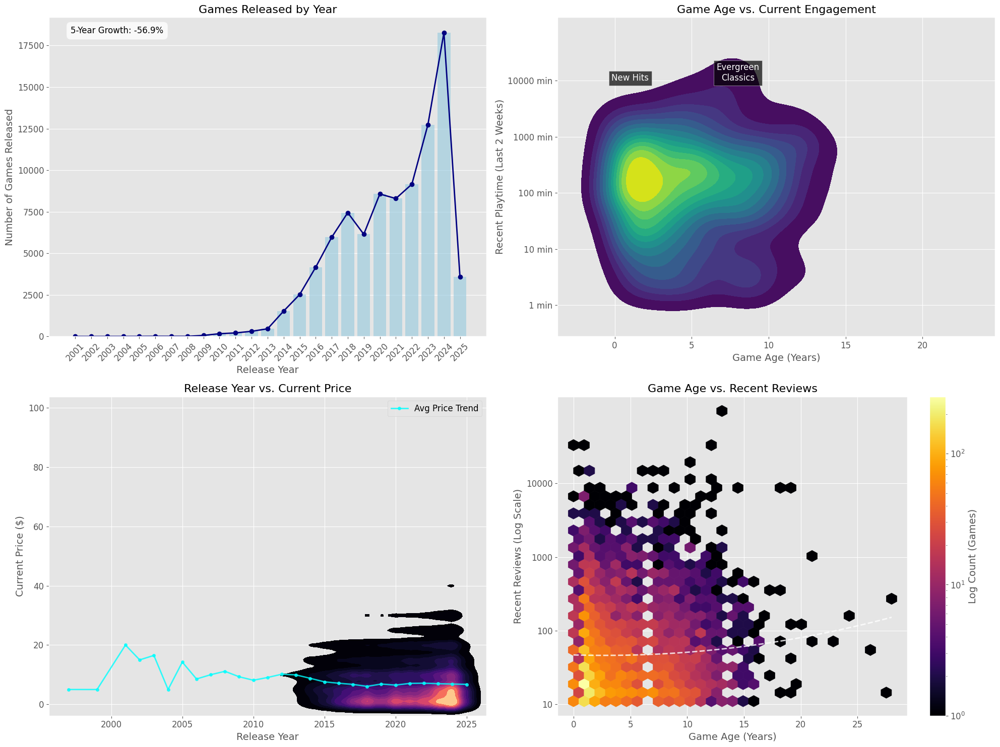

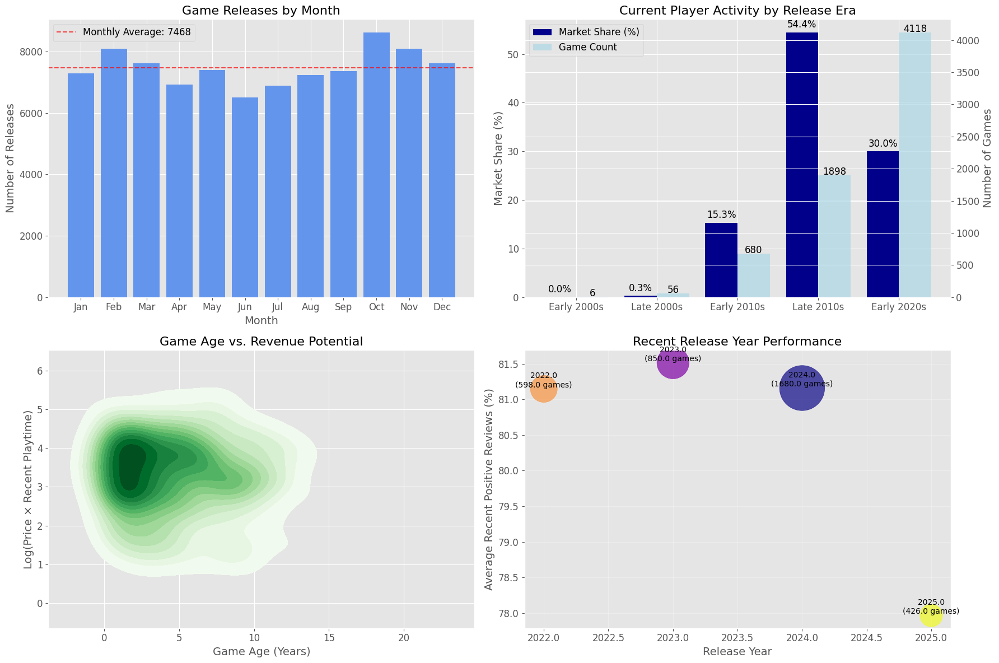

<Figure size 1400x800 with 0 Axes>

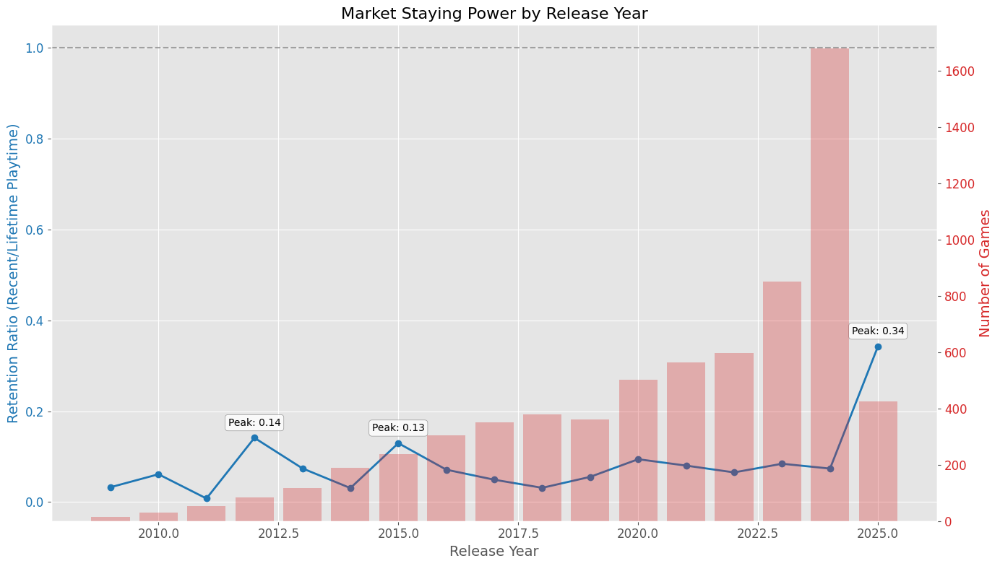

In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
from datetime import datetime
import matplotlib.dates as mdates
import ast

# Set styling for better visuals
plt.style.use('ggplot')
sns.set_palette("deep")
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12



# Clean and prepare the data
print(f"Original dataset: {len(df)} games")

# Parse release dates
def parse_release_date(date_str):
    if pd.isna(date_str):
        return None
    
    # Try different date formats
    formats = [
        '%b %d, %Y',    # Jan 23, 2019
        '%Y-%m-%d',     # 2019-01-23
        '%d %b, %Y',    # 23 Jan, 2019
        '%B %d, %Y',    # January 23, 2019
        '%Y',           # 2019
        '%b %Y'         # Jan 2019
    ]
    
    for fmt in formats:
        try:
            return pd.to_datetime(date_str, format=fmt)
        except:
            continue
    
    # If we can't parse the date, try to extract just the year
    try:
        # Look for 4-digit number that could be a year
        import re
        year_match = re.search(r'\b(19|20)\d{2}\b', date_str)
        if year_match:
            return pd.to_datetime(year_match.group(0), format='%Y')
    except:
        pass
    
    return None

# Apply the date parsing
df['release_date_parsed'] = df['release_date'].apply(parse_release_date)

# Extract year and calculate age
current_year = datetime.now().year
df['release_year'] = df['release_date_parsed'].dt.year
df['age_years'] = current_year - df['release_year']

# Filter to valid dates and active games
df_dated = df.dropna(subset=['release_year']).copy()
df_active = df_dated[(df_dated['num_reviews_recent'] > 0) | (df_dated['average_playtime_2weeks'] > 0)].copy()

print(f"Games with valid release dates: {len(df_dated)}")
print(f"Active games with valid release dates: {len(df_active)}")

# Create a figure for release date analysis
plt.figure(figsize=(20, 15))

# 1. Release Year Distribution
plt.subplot(2, 2, 1)
year_counts = df_dated['release_year'].value_counts().sort_index()
year_counts = year_counts[year_counts.index >= 2000]  # Focus on recent years

# Plot as both bars and line for better visualization
ax = sns.barplot(x=year_counts.index, y=year_counts.values, alpha=0.6, color='skyblue')
plt.plot(range(len(year_counts)), year_counts.values, 'o-', color='navy', linewidth=2)

plt.title('Games Released by Year')
plt.xlabel('Release Year')
plt.ylabel('Number of Games Released')
plt.xticks(rotation=45)

# Calculate and display trend information
recent_years = year_counts.index[-5:]
recent_counts = year_counts.values[-5:]
growth_rate = (recent_counts[-1] - recent_counts[0]) / recent_counts[0] * 100

plt.annotate(
    f"5-Year Growth: {growth_rate:.1f}%",
    xy=(0.05, 0.95),
    xycoords='axes fraction',
    bbox=dict(boxstyle="round,pad=0.5", facecolor='white', alpha=0.8)
)

# 2. Game Age vs. Current Activity (Playtime in last 2 weeks)
plt.subplot(2, 2, 2)

# Filter to games with recent playtime data
recent_play_df = df_active[df_active['average_playtime_2weeks'] > 0].copy()
recent_play_df['log_playtime_2weeks'] = np.log10(recent_play_df['average_playtime_2weeks'] + 1)

# Create density plot
sns.kdeplot(
    data=recent_play_df,
    x='age_years', 
    y='log_playtime_2weeks',
    fill=True, 
    cmap='viridis',
    levels=15,
    thresh=0.05
)

# Format y-axis
tick_locations = np.arange(0, 5)
tick_labels = [f"{10**x:.0f} min" for x in tick_locations]
plt.yticks(tick_locations, tick_labels)

plt.title('Game Age vs. Current Engagement')
plt.xlabel('Game Age (Years)')
plt.ylabel('Recent Playtime (Last 2 Weeks)')

# Add annotations
plt.text(
    1, 
    4,
    'New Hits',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)
plt.text(
    8, 
    4,
    'Evergreen\nClassics',
    ha='center',
    color='white',
    bbox=dict(facecolor='black', alpha=0.7)
)

# 3. Release Year vs. Price - Pricing strategy by age
plt.subplot(2, 2, 3)

# Filter for better visualization
pricing_df = df_dated[(df_dated['price'] >= 0) & (df_dated['price'] < 100)].copy()

# Create density plot
sns.kdeplot(
    data=pricing_df,
    x='release_year', 
    y='price',
    fill=True, 
    cmap='magma',
    levels=15,
    thresh=0.05
)

plt.title('Release Year vs. Current Price')
plt.xlabel('Release Year')
plt.ylabel('Current Price ($)')

# Add a reference line for average price trend by year
yearly_avg_price = pricing_df.groupby('release_year')['price'].mean()
plt.plot(yearly_avg_price.index, yearly_avg_price.values, 'o-', color='cyan', 
         linewidth=2, markersize=4, alpha=0.8, label='Avg Price Trend')
plt.legend()

# 4. Age vs. Popularity (Recent Reviews)
plt.subplot(2, 2, 4)

# Filter for games with recent reviews
recent_reviews_df = df_active[df_active['num_reviews_recent'] > 0].copy()
recent_reviews_df['log_reviews_recent'] = np.log10(recent_reviews_df['num_reviews_recent'] + 1)

# Calculate review density by age (reviews per year of age)
recent_reviews_df['review_density'] = recent_reviews_df['num_reviews_recent'] / (recent_reviews_df['age_years'] + 0.1)
recent_reviews_df['log_review_density'] = np.log10(recent_reviews_df['review_density'] + 1)

# Create scatter plot with density visualization
plt.hexbin(
    recent_reviews_df['age_years'], 
    recent_reviews_df['log_reviews_recent'],
    gridsize=30, 
    cmap='inferno',
    mincnt=1,
    bins='log'
)
plt.colorbar(label='Log Count (Games)')

plt.title('Game Age vs. Recent Reviews')
plt.xlabel('Game Age (Years)')
plt.ylabel('Recent Reviews (Log Scale)')

# Add custom y-axis labels
tick_locations = np.arange(0, 5)
tick_labels = [f"{10**x:.0f}" for x in tick_locations]
plt.yticks(tick_locations, tick_labels)

# Add trend line
x = recent_reviews_df['age_years']
y = recent_reviews_df['log_reviews_recent']
z = np.polyfit(x, y, 2)
p = np.poly1d(z)
x_line = np.linspace(min(x), max(x), 100)
plt.plot(x_line, p(x_line), "w--", linewidth=2, alpha=0.8)

plt.tight_layout()
plt.savefig('release_date_analysis.png', dpi=300, bbox_inches='tight')

# Create a second figure for more in-depth release pattern analysis
plt.figure(figsize=(18, 12))

# 1. Monthly Release Patterns
plt.subplot(2, 2, 1)

# Filter to games with full date information
full_date_df = df_dated[df_dated['release_date_parsed'].dt.day.notna()].copy()
full_date_df['release_month'] = full_date_df['release_date_parsed'].dt.month

# Count releases by month
month_counts = full_date_df['release_month'].value_counts().sort_index()
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

plt.bar(month_names, month_counts.values, color='cornflowerblue')
plt.title('Game Releases by Month')
plt.xlabel('Month')
plt.ylabel('Number of Releases')

# Add horizontal line for average
plt.axhline(y=month_counts.mean(), color='r', linestyle='--', alpha=0.7, 
            label=f'Monthly Average: {month_counts.mean():.0f}')
plt.legend()

# 2. Current Player Base by Release Era
plt.subplot(2, 2, 2)

# Define gaming eras (approximate)
eras = [
    (2000, 2005, 'Early 2000s'),
    (2006, 2010, 'Late 2000s'),
    (2011, 2015, 'Early 2010s'),
    (2016, 2020, 'Late 2010s'),
    (2021, 2025, 'Early 2020s')
]

# Calculate market share by era
era_data = []
for start, end, name in eras:
    era_games = df_active[(df_active['release_year'] >= start) & (df_active['release_year'] <= end)]
    total_playtime = era_games['average_playtime_2weeks'].sum()
    game_count = len(era_games)
    era_data.append({
        'era': name,
        'total_playtime': total_playtime,
        'game_count': game_count
    })

era_df = pd.DataFrame(era_data)
era_df['market_share'] = era_df['total_playtime'] / era_df['total_playtime'].sum() * 100
era_df['avg_playtime'] = era_df['total_playtime'] / era_df['game_count']

# Create a grouped bar chart
x = range(len(era_df))
width = 0.4

fig, ax1 = plt.gcf(), plt.gca()
bars1 = ax1.bar([i - width/2 for i in x], era_df['market_share'], width, label='Market Share (%)', color='darkblue')
ax1.set_ylabel('Market Share (%)')
ax1.set_xticks(x)
ax1.set_xticklabels(era_df['era'])

# Add a second y-axis for game count
ax2 = ax1.twinx()
bars2 = ax2.bar([i + width/2 for i in x], era_df['game_count'], width, label='Game Count', color='lightblue', alpha=0.7)
ax2.set_ylabel('Number of Games')

# Add labels to the bars
for i, v in enumerate(era_df['market_share']):
    ax1.text(i - width/2, v + 1, f"{v:.1f}%", ha='center')

for i, v in enumerate(era_df['game_count']):
    ax2.text(i + width/2, v + 10, f"{v}", ha='center')

# Add legends
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

plt.title('Current Player Activity by Release Era')
plt.xlabel('Release Era')

# 3. Age vs. Revenue Potential (Price * Recent Playtime)
plt.subplot(2, 2, 3)

# Create revenue proxy
revenue_df = df_active[(df_active['price'] > 0) & (df_active['average_playtime_2weeks'] > 0)].copy()
revenue_df['revenue_potential'] = revenue_df['price'] * revenue_df['average_playtime_2weeks']
revenue_df['log_revenue'] = np.log10(revenue_df['revenue_potential'] + 1)

# Create density plot
sns.kdeplot(
    data=revenue_df,
    x='age_years', 
    y='log_revenue',
    fill=True, 
    cmap='Greens',
    levels=15,
    thresh=0.05
)

plt.title('Game Age vs. Revenue Potential')
plt.xlabel('Game Age (Years)')
plt.ylabel('Log(Price × Recent Playtime)')

# 4. Recent Release Success Rate
plt.subplot(2, 2, 4)

# Focus on games released in last 3 years
recent_releases = df_active[df_active['age_years'] <= 3].copy()

# Create success metric (playtime relative to price)
recent_releases['value_ratio'] = recent_releases['average_playtime_2weeks'] / (recent_releases['price'] + 1)
recent_releases['log_value'] = np.log10(recent_releases['value_ratio'] + 1)

# Group by year and calculate average success
yearly_success = recent_releases.groupby('release_year').agg({
    'pct_pos_recent': 'mean',
    'value_ratio': 'mean',
    'name': 'count'
}).reset_index()

# Create a bubble chart
plt.scatter(
    yearly_success['release_year'],
    yearly_success['pct_pos_recent'],
    s=yearly_success['name'] * 2,  # Size based on number of games
    alpha=0.7,
    c=yearly_success['value_ratio'],  # Color based on value ratio
    cmap='plasma'
)

# Add labels for each year
for i, row in yearly_success.iterrows():
    plt.annotate(
        f"{row['release_year']}\n({row['name']} games)",
        (row['release_year'], row['pct_pos_recent']),
        ha='center',
        va='bottom',
        fontsize=10
    )

plt.title('Recent Release Year Performance')
plt.xlabel('Release Year')
plt.ylabel('Average Recent Positive Reviews (%)')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('release_patterns_analysis.png', dpi=300, bbox_inches='tight')
plt.show()

# Bonus: Create an analysis of "Market Staying Power" by release year
plt.figure(figsize=(14, 8))

# Group games by release year
staying_power = df_active.groupby('release_year').agg({
    'average_playtime_forever': 'mean',
    'average_playtime_2weeks': 'mean',
    'name': 'count'
}).reset_index()

# Calculate staying power (ratio of recent to lifetime playtime)
staying_power['retention_ratio'] = staying_power['average_playtime_2weeks'] / staying_power['average_playtime_forever']
staying_power = staying_power[staying_power['name'] > 5]  # Only include years with enough games

# Create a dual-axis plot
fig, ax1 = plt.subplots(figsize=(14, 8))

# Plot retention ratio
color = 'tab:blue'
ax1.set_xlabel('Release Year')
ax1.set_ylabel('Retention Ratio (Recent/Lifetime Playtime)', color=color)
line1 = ax1.plot(staying_power['release_year'], staying_power['retention_ratio'], 'o-', color=color, linewidth=2)
ax1.tick_params(axis='y', labelcolor=color)

# Add a second y-axis for game count
ax2 = ax1.twinx()
color = 'tab:red'
ax2.set_ylabel('Number of Games', color=color)
bars = ax2.bar(staying_power['release_year'], staying_power['name'], alpha=0.3, color=color)
ax2.tick_params(axis='y', labelcolor=color)

# Add a horizontal line at retention ratio = 1
ax1.axhline(y=1.0, color='gray', linestyle='--', alpha=0.7)

plt.title('Market Staying Power by Release Year')
plt.grid(False)

# Add annotations for significant years
top_retention = staying_power.nlargest(3, 'retention_ratio')
for i, row in top_retention.iterrows():
    ax1.annotate(
        f"Peak: {row['retention_ratio']:.2f}",
        (row['release_year'], row['retention_ratio']),
        xytext=(0, 10),
        textcoords='offset points',
        ha='center',
        va='bottom',
        fontsize=10,
        bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8)
    )

plt.tight_layout()
plt.savefig('market_staying_power.png', dpi=300, bbox_inches='tight')
plt.show()

## Log revews x price

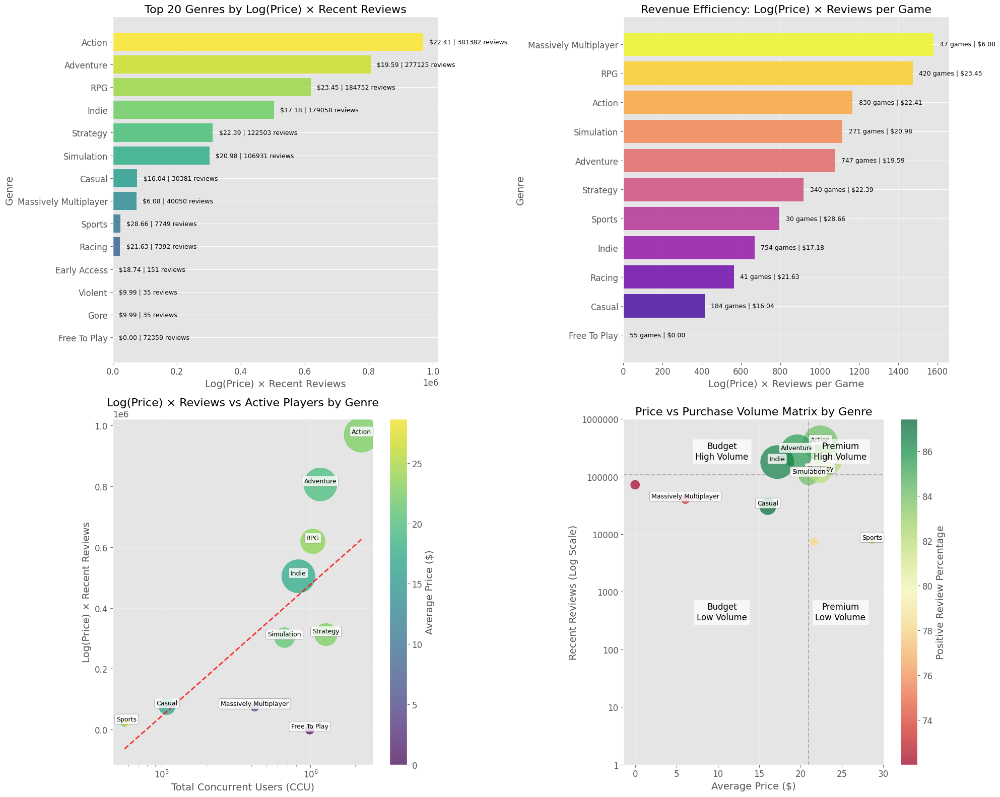

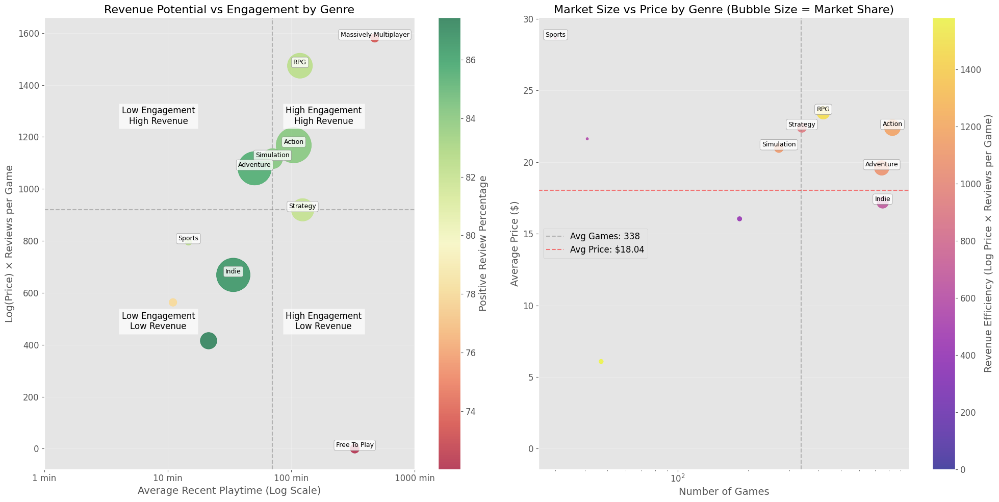

In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import ast
import warnings
warnings.filterwarnings('ignore')

# Set styling for better visuals
plt.style.use('ggplot')
sns.set_palette("deep")
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12

# Clean the data
df_clean = df[(df['pct_pos_total'] != -1) & ((df['metacritic_score'] > 0) | df['metacritic_score'].isna())].copy()

# Filter to games with recent reviews (our purchase proxy)
df_recent = df_clean[df_clean['num_reviews_recent'] > 0].copy()

# Function to safely parse list-like strings or handle lists
def parse_list_field(field):
    if isinstance(field, str):
        try:
            return ast.literal_eval(field)
        except (ValueError, SyntaxError):
            # If not a proper list, split by comma
            return [x.strip() for x in field.split(',')]
    elif isinstance(field, list):
        return field
    else:
        return []

# Process genres data
def extract_genres(df):
    genre_data = []
    for idx, row in df.iterrows():
        if pd.isna(row['genres']):
            continue
            
        genres = parse_list_field(row['genres'])
        
        # Skip if no valid genres
        if not genres:
            continue
            
        # Process all genres (not just primary)
        for genre in genres:
            # Add price adjustment - use log(price+1) to handle free games
            log_price = np.log(row['price'] + 1) if not pd.isna(row['price']) else 0
            
            # Add to our data
            genre_data.append({
                'genre': genre,
                'appid': row['appid'],
                'name': row['name'],
                'price': row['price'] if not pd.isna(row['price']) else 0,
                'log_price': log_price,
                'peak_ccu': row['peak_ccu'] if not pd.isna(row['peak_ccu']) else 0,
                'average_playtime_2weeks': row['average_playtime_2weeks'] if not pd.isna(row['average_playtime_2weeks']) else 0,
                'num_reviews_recent': row['num_reviews_recent'] if not pd.isna(row['num_reviews_recent']) else 0,
                'pct_pos_recent': row['pct_pos_recent'] if not pd.isna(row['pct_pos_recent']) else np.nan,
                'metacritic_score': row['metacritic_score'] if not pd.isna(row['metacritic_score']) else np.nan,
            })
    
    return pd.DataFrame(genre_data)

# Extract genre data - only from games with recent reviews
genre_df = extract_genres(df_recent)

# Calculate log_price * recent_reviews metric
genre_df['log_price_reviews'] = genre_df['log_price'] * genre_df['num_reviews_recent']

# Calculate metrics by genre
genre_metrics = genre_df.groupby('genre').agg({
    'num_reviews_recent': 'sum',
    'log_price_reviews': 'sum',
    'log_price': 'mean',
    'price': 'mean',
    'peak_ccu': 'sum',
    'average_playtime_2weeks': 'mean',
    'pct_pos_recent': 'mean',
    'appid': 'count'
}).reset_index()

genre_metrics.columns = ['genre', 'recent_reviews', 'log_price_reviews', 
                        'avg_log_price', 'avg_price', 'total_ccu', 
                        'avg_playtime_2weeks', 'pct_pos_recent', 'game_count']

# Calculate per-game metrics
genre_metrics['reviews_per_game'] = genre_metrics['recent_reviews'] / genre_metrics['game_count']
genre_metrics['log_price_reviews_per_game'] = genre_metrics['log_price_reviews'] / genre_metrics['game_count']

# Create a figure for the log price × reviews analysis
plt.figure(figsize=(20, 16))

# 1. Top 20 Genres by Log Price × Recent Reviews
plt.subplot(2, 2, 1)

# Sort and get top 20
top_revenue = genre_metrics.nlargest(20, 'log_price_reviews').sort_values('log_price_reviews')

# Create horizontal bar chart
bars = plt.barh(
    top_revenue['genre'],
    top_revenue['log_price_reviews'],
    color=plt.cm.viridis(np.linspace(0, 1, len(top_revenue))),
    alpha=0.8
)

# Add average price and reviews as text
for i, row in enumerate(top_revenue.iterrows()):
    plt.text(
        row[1]['log_price_reviews'] + (top_revenue['log_price_reviews'].max() * 0.02), 
        i,
        f"${row[1]['avg_price']:.2f} | {row[1]['recent_reviews']:.0f} reviews",
        va='center',
        fontsize=9
    )

plt.title('Top 20 Genres by Log(Price) × Recent Reviews')
plt.xlabel('Log(Price) × Recent Reviews')
plt.ylabel('Genre')
plt.grid(True, alpha=0.3, axis='x')

# 2. Revenue Efficiency: Log Price × Reviews per Game
plt.subplot(2, 2, 2)

# Filter to genres with at least 5 games for better analysis
efficiency_df = genre_metrics[genre_metrics['game_count'] >= 5].copy()
top_efficiency = efficiency_df.nlargest(20, 'log_price_reviews_per_game').sort_values('log_price_reviews_per_game')

# Create horizontal bar chart
bars = plt.barh(
    top_efficiency['genre'],
    top_efficiency['log_price_reviews_per_game'],
    color=plt.cm.plasma(np.linspace(0, 1, len(top_efficiency))),
    alpha=0.8
)

# Add game count and average price as text
for i, row in enumerate(top_efficiency.iterrows()):
    plt.text(
        row[1]['log_price_reviews_per_game'] + (top_efficiency['log_price_reviews_per_game'].max() * 0.02), 
        i,
        f"{row[1]['game_count']} games | ${row[1]['avg_price']:.2f}",
        va='center',
        fontsize=9
    )

plt.title('Revenue Efficiency: Log(Price) × Reviews per Game')
plt.xlabel('Log(Price) × Reviews per Game')
plt.ylabel('Genre')
plt.grid(True, alpha=0.3, axis='x')

# 3. Log Price × Reviews vs CCU
plt.subplot(2, 2, 3)

# Filter for better visualization
plot_data = genre_metrics[genre_metrics['game_count'] >= 5].copy()

# Create a scatter plot
plt.scatter(
    plot_data['total_ccu'],
    plot_data['log_price_reviews'],
    s=plot_data['game_count'] * 3,  # Size based on number of games
    alpha=0.7,
    c=plot_data['avg_price'],  # Color based on average price
    cmap='viridis'
)

# Add genre labels for top markets
for i, row in pd.concat([
    plot_data.nlargest(8, 'log_price_reviews'),
    plot_data.nlargest(5, 'total_ccu'),
    plot_data.nlargest(3, 'avg_price')
]).drop_duplicates().iterrows():
    plt.annotate(
        row['genre'],
        (row['total_ccu'], row['log_price_reviews']),
        fontsize=9,
        ha='center',
        va='bottom',
        bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8)
    )

# Add colorbar
cbar = plt.colorbar()
cbar.set_label('Average Price ($)')

# Add trend line
z = np.polyfit(np.log10(plot_data['total_ccu']+1), plot_data['log_price_reviews'], 1)
p = np.poly1d(z)
x_line = np.linspace(plot_data['total_ccu'].min(), plot_data['total_ccu'].max(), 100)
plt.plot(x_line, p(np.log10(x_line+1)), "r--", linewidth=2, alpha=0.8)

plt.title('Log(Price) × Reviews vs Active Players by Genre')
plt.xlabel('Total Concurrent Users (CCU)')
plt.ylabel('Log(Price) × Recent Reviews')
plt.xscale('log')
plt.grid(True, alpha=0.3)

# 4. Price vs Purchase Volume Matrix
plt.subplot(2, 2, 4)

# Calculate log transformed metrics for better visualization
plot_data = genre_metrics[genre_metrics['game_count'] >= 5].copy()
plot_data['log_reviews'] = np.log10(plot_data['recent_reviews'] + 1)

plt.scatter(
    plot_data['avg_price'],
    plot_data['log_reviews'],
    s=plot_data['game_count'] * 3,  # Size based on number of games
    alpha=0.7,
    c=plot_data['pct_pos_recent'],  # Color based on positive review percentage
    cmap='RdYlGn'
)

# Add genre labels
for i, row in pd.concat([
    plot_data.nlargest(8, 'log_price_reviews'),
    plot_data.nlargest(3, 'avg_price'),
    plot_data.nlargest(3, 'recent_reviews')
]).drop_duplicates().iterrows():
    plt.annotate(
        row['genre'],
        (row['avg_price'], row['log_reviews']),
        fontsize=9,
        ha='center',
        va='bottom',
        bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8)
    )

# Add colorbar
cbar = plt.colorbar()
cbar.set_label('Positive Review Percentage')

# Custom y-axis labels
tick_locations = np.arange(0, 7)
tick_labels = [f"{10**x:.0f}" for x in tick_locations]
plt.yticks(tick_locations, tick_labels)

# Add quadrant lines at median values
plt.axvline(x=plot_data['avg_price'].median(), color='gray', linestyle='--', alpha=0.5)
plt.axhline(y=plot_data['log_reviews'].median(), color='gray', linestyle='--', alpha=0.5)

# Add quadrant labels
median_x = plot_data['avg_price'].median()
median_y = plot_data['log_reviews'].median()
max_x = plot_data['avg_price'].max()
max_y = plot_data['log_reviews'].max()

plt.text(
    (median_x + max_x) / 2, 
    (median_y + max_y) / 2,
    'Premium\nHigh Volume',
    ha='center',
    color='black',
    bbox=dict(facecolor='white', alpha=0.7)
)
plt.text(
    median_x / 2, 
    (median_y + max_y) / 2,
    'Budget\nHigh Volume',
    ha='center',
    color='black',
    bbox=dict(facecolor='white', alpha=0.7)
)
plt.text(
    (median_x + max_x) / 2, 
    median_y / 2,
    'Premium\nLow Volume',
    ha='center',
    color='black',
    bbox=dict(facecolor='white', alpha=0.7)
)
plt.text(
    median_x / 2, 
    median_y / 2,
    'Budget\nLow Volume',
    ha='center',
    color='black',
    bbox=dict(facecolor='white', alpha=0.7)
)

plt.title('Price vs Purchase Volume Matrix by Genre')
plt.xlabel('Average Price ($)')
plt.ylabel('Recent Reviews (Log Scale)')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('log_price_purchase_analysis.png', dpi=300, bbox_inches='tight')

# Create a second figure for revenue vs engagement analysis
plt.figure(figsize=(20, 10))

# 1. Log Price × Reviews vs Playtime
plt.subplot(1, 2, 1)

# Filter out genres with minimal data
plot_data = genre_metrics[(genre_metrics['game_count'] >= 5) & 
                         (genre_metrics['avg_playtime_2weeks'] > 0)].copy()
plot_data['log_playtime'] = np.log10(plot_data['avg_playtime_2weeks'] + 1)

plt.scatter(
    plot_data['log_playtime'],
    plot_data['log_price_reviews_per_game'],
    s=plot_data['game_count'] * 3,  # Size based on number of games
    alpha=0.7,
    c=plot_data['pct_pos_recent'],  # Color based on positive review percentage
    cmap='RdYlGn'
)

# Add genre labels
for i, row in pd.concat([
    plot_data.nlargest(8, 'log_price_reviews_per_game'),
    plot_data.nlargest(5, 'avg_playtime_2weeks')
]).drop_duplicates().iterrows():
    plt.annotate(
        row['genre'],
        (row['log_playtime'], row['log_price_reviews_per_game']),
        fontsize=9,
        ha='center',
        va='bottom',
        bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8)
    )

# Add colorbar
cbar = plt.colorbar()
cbar.set_label('Positive Review Percentage')

# Custom x-axis labels
tick_locations = np.arange(0, 4)
tick_labels = [f"{10**x:.0f} min" for x in tick_locations]
plt.xticks(tick_locations, tick_labels)

# Add quadrant lines at median values
plt.axvline(x=plot_data['log_playtime'].median(), color='gray', linestyle='--', alpha=0.5)
plt.axhline(y=plot_data['log_price_reviews_per_game'].median(), color='gray', linestyle='--', alpha=0.5)

# Add quadrant labels
median_x = plot_data['log_playtime'].median()
median_y = plot_data['log_price_reviews_per_game'].median()
max_x = plot_data['log_playtime'].max()
max_y = plot_data['log_price_reviews_per_game'].max()

plt.text(
    (median_x + max_x) / 2, 
    (median_y + max_y) / 2,
    'High Engagement\nHigh Revenue',
    ha='center',
    color='black',
    bbox=dict(facecolor='white', alpha=0.7)
)
plt.text(
    median_x / 2, 
    (median_y + max_y) / 2,
    'Low Engagement\nHigh Revenue',
    ha='center',
    color='black',
    bbox=dict(facecolor='white', alpha=0.7)
)
plt.text(
    (median_x + max_x) / 2, 
    median_y / 2,
    'High Engagement\nLow Revenue',
    ha='center',
    color='black',
    bbox=dict(facecolor='white', alpha=0.7)
)
plt.text(
    median_x / 2, 
    median_y / 2,
    'Low Engagement\nLow Revenue',
    ha='center',
    color='black',
    bbox=dict(facecolor='white', alpha=0.7)
)

plt.title('Revenue Potential vs Engagement by Genre')
plt.xlabel('Average Recent Playtime (Log Scale)')
plt.ylabel('Log(Price) × Reviews per Game')
plt.grid(True, alpha=0.3)

# 2. Relationship between Game Count, Price, and Revenue
plt.subplot(1, 2, 2)

# Calculate market concentration
plot_data = genre_metrics[genre_metrics['game_count'] >= 5].copy()
plot_data['market_share'] = plot_data['log_price_reviews'] / plot_data['log_price_reviews'].sum() * 100

# Create a scatter plot with bubbles
plt.scatter(
    plot_data['game_count'],
    plot_data['avg_price'],
    s=plot_data['market_share'] * 20,  # Size based on market share
    alpha=0.7,
    c=plot_data['log_price_reviews_per_game'],  # Color based on revenue efficiency
    cmap='plasma'
)

# Add genre labels for notable genres
for i, row in pd.concat([
    plot_data.nlargest(6, 'market_share'),
    plot_data.nlargest(3, 'game_count'),
    plot_data.nlargest(3, 'avg_price')
]).drop_duplicates().iterrows():
    plt.annotate(
        row['genre'],
        (row['game_count'], row['avg_price']),
        fontsize=9,
        ha='center',
        va='bottom',
        bbox=dict(boxstyle="round,pad=0.3", fc="white", ec="gray", alpha=0.8)
    )

# Add colorbar
cbar = plt.colorbar()
cbar.set_label('Revenue Efficiency (Log Price × Reviews per Game)')

# Add reference lines for average values
plt.axvline(x=plot_data['game_count'].mean(), color='gray', linestyle='--', alpha=0.5,
           label=f'Avg Games: {plot_data["game_count"].mean():.0f}')
plt.axhline(y=plot_data['avg_price'].mean(), color='red', linestyle='--', alpha=0.5,
           label=f'Avg Price: ${plot_data["avg_price"].mean():.2f}')
plt.legend()

plt.title('Market Size vs Price by Genre (Bubble Size = Market Share)')
plt.xlabel('Number of Games')
plt.ylabel('Average Price ($)')
plt.xscale('log')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.savefig('revenue_engagement_analysis.png', dpi=300, bbox_inches='tight')

## Money made proxy over release date

TypeError: cannot convert the series to <class 'float'>

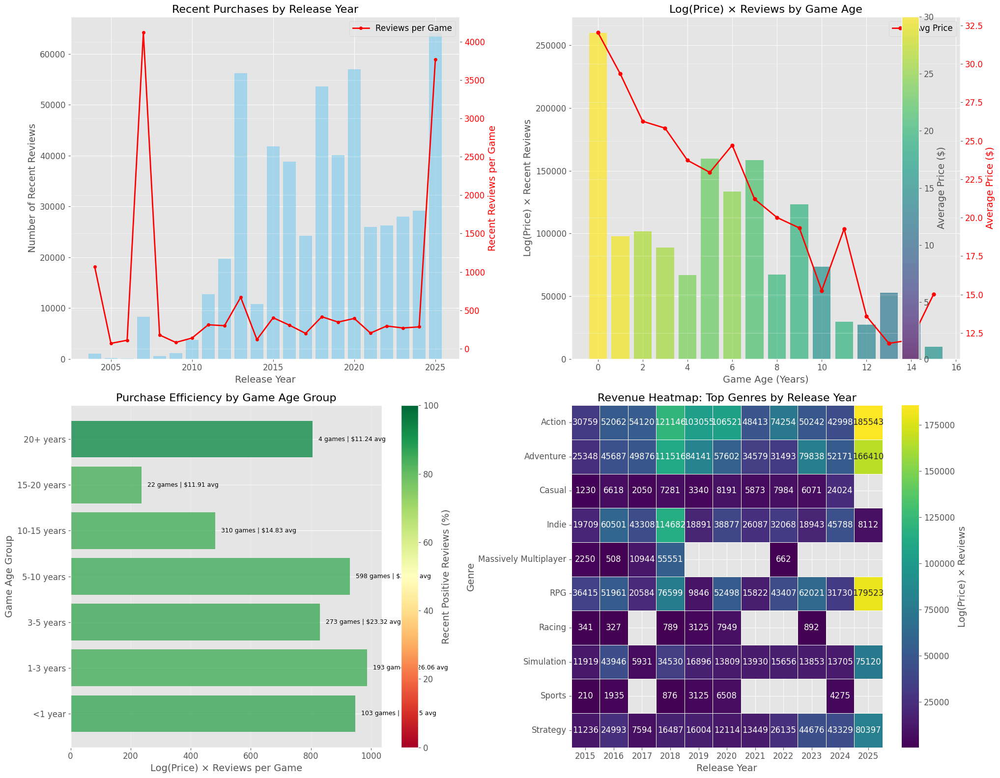

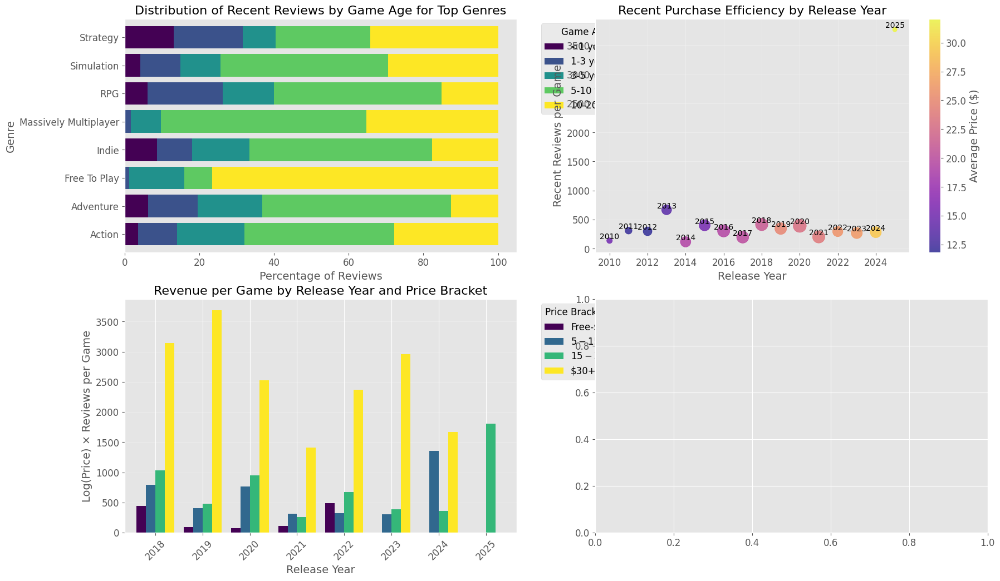

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import ast
from datetime import datetime
import matplotlib.dates as mdates
import warnings
warnings.filterwarnings('ignore')

# Set styling for better visuals
plt.style.use('ggplot')
sns.set_palette("deep")
plt.rcParams['font.size'] = 12
plt.rcParams['axes.labelsize'] = 14
plt.rcParams['axes.titlesize'] = 16
plt.rcParams['xtick.labelsize'] = 12
plt.rcParams['ytick.labelsize'] = 12



# Clean the data
df_clean = df[(df['pct_pos_total'] != -1) & ((df['metacritic_score'] > 0) | df['metacritic_score'].isna())].copy()

# Parse release dates
def parse_release_date(date_str):
    if pd.isna(date_str):
        return None
    
    # Try different date formats
    formats = [
        '%b %d, %Y',    # Jan 23, 2019
        '%Y-%m-%d',     # 2019-01-23
        '%d %b, %Y',    # 23 Jan, 2019
        '%B %d, %Y',    # January 23, 2019
        '%Y',           # 2019
        '%b %Y'         # Jan 2019
    ]
    
    for fmt in formats:
        try:
            return pd.to_datetime(date_str, format=fmt)
        except:
            continue
    
    # If we can't parse the date, try to extract just the year
    try:
        # Look for 4-digit number that could be a year
        import re
        year_match = re.search(r'\b(19|20)\d{2}\b', date_str)
        if year_match:
            return pd.to_datetime(year_match.group(0), format='%Y')
    except:
        pass
    
    return None

# Apply the date parsing
df_clean['release_date_parsed'] = df_clean['release_date'].apply(parse_release_date)

# Extract year and calculate age
current_year = datetime.now().year
df_clean['release_year'] = df_clean['release_date_parsed'].dt.year
df_clean['age_years'] = current_year - df_clean['release_year']

# Filter to games with recent reviews (our purchase proxy) and valid release dates
df_recent = df_clean[(df_clean['num_reviews_recent'] > 0) & (~df_clean['release_year'].isna())].copy()

# Add log price calculation
df_recent['log_price'] = np.log(df_recent['price'] + 1)
df_recent['log_price_reviews'] = df_recent['log_price'] * df_recent['num_reviews_recent']

# Function to safely parse list-like strings or handle lists
def parse_list_field(field):
    if isinstance(field, str):
        try:
            return ast.literal_eval(field)
        except (ValueError, SyntaxError):
            # If not a proper list, split by comma
            return [x.strip() for x in field.split(',')]
    elif isinstance(field, list):
        return field
    else:
        return []

# Process genres data
def extract_genres(df):
    genre_data = []
    for idx, row in df.iterrows():
        if pd.isna(row['genres']):
            continue
            
        genres = parse_list_field(row['genres'])
        
        # Skip if no valid genres
        if not genres:
            continue
            
        # Process all genres (not just primary)
        for genre in genres:
            # Add to our data
            genre_data.append({
                'genre': genre,
                'appid': row['appid'],
                'name': row['name'],
                'release_year': row['release_year'],
                'age_years': row['age_years'],
                'price': row['price'] if not pd.isna(row['price']) else 0,
                'log_price': row['log_price'],
                'peak_ccu': row['peak_ccu'] if not pd.isna(row['peak_ccu']) else 0,
                'average_playtime_2weeks': row['average_playtime_2weeks'] if not pd.isna(row['average_playtime_2weeks']) else 0,
                'num_reviews_recent': row['num_reviews_recent'] if not pd.isna(row['num_reviews_recent']) else 0,
                'log_price_reviews': row['log_price_reviews'],
                'pct_pos_recent': row['pct_pos_recent'] if not pd.isna(row['pct_pos_recent']) else np.nan,
            })
    
    return pd.DataFrame(genre_data)

# Extract genre data - only from games with recent reviews and valid release dates
genre_df = extract_genres(df_recent)

# Create a figure for release date and purchase analysis 
plt.figure(figsize=(20, 16))

# 1. Recent Purchases by Release Year
plt.subplot(2, 2, 1)

# Group by release year and sum recent reviews
year_purchases = df_recent.groupby('release_year').agg({
    'num_reviews_recent': 'sum',
    'appid': 'count'
}).reset_index()
year_purchases.columns = ['release_year', 'recent_reviews', 'game_count']
year_purchases['reviews_per_game'] = year_purchases['recent_reviews'] / year_purchases['game_count']

# Filter to reasonable years for better visualization (e.g., last 20 years)
year_purchases = year_purchases[(year_purchases['release_year'] >= 2003) & 
                                (year_purchases['release_year'] <= current_year)]

# Plot as both bars and line
ax1 = plt.gca()  # Get current axes
ax1.bar(year_purchases['release_year'], year_purchases['recent_reviews'], 
             alpha=0.7, color='skyblue')
             
# Add second axis for reviews per game
ax2 = plt.twinx()
ax2.plot(year_purchases['release_year'], year_purchases['reviews_per_game'], 
         'o-', color='red', linewidth=2, markersize=4, 
         label='Reviews per Game')
ax2.set_ylabel('Recent Reviews per Game', color='red')
ax2.tick_params(axis='y', labelcolor='red')
ax2.legend(loc='upper right')

plt.title('Recent Purchases by Release Year')
ax1.set_xlabel('Release Year')
ax1.set_ylabel('Number of Recent Reviews')
plt.xticks(rotation=45)
plt.grid(True, alpha=0.3)

# 2. Log Price × Reviews by Game Age
plt.subplot(2, 2, 2)

# Calculate log_price_reviews by age
age_revenue = df_recent.groupby('age_years').agg({
    'log_price_reviews': 'sum',
    'num_reviews_recent': 'sum',
    'appid': 'count',
    'price': 'mean'
}).reset_index()
age_revenue.columns = ['age_years', 'log_price_reviews', 'recent_reviews', 'game_count', 'avg_price']
age_revenue['revenue_per_game'] = age_revenue['log_price_reviews'] / age_revenue['game_count']

# Filter to ages with enough games
age_revenue = age_revenue[(age_revenue['age_years'] <= 15) & (age_revenue['game_count'] >= 5)]

# Create bar chart with dual y-axis
ax1 = plt.gca()  # Get current axes
bars = ax1.bar(age_revenue['age_years'], age_revenue['log_price_reviews'], alpha=0.7, 
               color=plt.cm.viridis(age_revenue['avg_price']/30))  # Color by avg price

# Add second axis for avg price
ax2 = plt.twinx()
ax2.plot(age_revenue['age_years'], age_revenue['avg_price'], 
         'o-', color='red', linewidth=2, markersize=5, 
         label='Avg Price')
ax2.set_ylabel('Average Price ($)', color='red')
ax2.tick_params(axis='y', labelcolor='red')
ax2.legend(loc='upper right')

# Create custom colorbar for price
sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis, norm=plt.Normalize(vmin=0, vmax=30))
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax1, label='Average Price ($)', alpha=0.7)  # Add ax=ax1 reference

plt.title('Log(Price) × Reviews by Game Age')
ax1.set_xlabel('Game Age (Years)')
ax1.set_ylabel('Log(Price) × Recent Reviews')
plt.grid(True, alpha=0.3)

# 3. Purchase Efficiency by Release Era (Organized by game age groups)
plt.subplot(2, 2, 3)

# Define age groups for better visualization
age_bins = [0, 1, 3, 5, 10, 15, 20, 100]
age_labels = ['<1 year', '1-3 years', '3-5 years', '5-10 years', '10-15 years', '15-20 years', '20+ years']

# Add age group to data
df_recent['age_group'] = pd.cut(df_recent['age_years'], bins=age_bins, labels=age_labels)

# Group by age group
age_group_metrics = df_recent.groupby('age_group').agg({
    'num_reviews_recent': 'sum',
    'log_price_reviews': 'sum',
    'appid': 'count',
    'price': 'mean',
    'pct_pos_recent': 'mean'
}).reset_index()

# Calculate efficiency metrics
age_group_metrics['reviews_per_game'] = age_group_metrics['num_reviews_recent'] / age_group_metrics['appid']
age_group_metrics['revenue_per_game'] = age_group_metrics['log_price_reviews'] / age_group_metrics['appid']

# Create horizontal bar chart for revenue efficiency
ax1 = plt.gca()  # Get current axes
bars = ax1.barh(age_group_metrics['age_group'], age_group_metrics['revenue_per_game'], 
                alpha=0.8, color=plt.cm.RdYlGn(age_group_metrics['pct_pos_recent']/100))

# Add game count as text
for i, row in enumerate(age_group_metrics.iterrows()):
    plt.text(
        row[1]['revenue_per_game'] + (age_group_metrics['revenue_per_game'].max() * 0.02), 
        i,
        f"{row[1]['appid']:.0f} games | ${row[1]['price']:.2f} avg",
        va='center',
        fontsize=9
    )

# Create custom colorbar for review sentiment
sm = plt.cm.ScalarMappable(cmap=plt.cm.RdYlGn, norm=plt.Normalize(vmin=0, vmax=100))
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax1, label='Recent Positive Reviews (%)')  # Add ax=ax1 reference

plt.title('Purchase Efficiency by Game Age Group')
ax1.set_xlabel('Log(Price) × Reviews per Game')
ax1.set_ylabel('Game Age Group')
plt.grid(True, alpha=0.3, axis='x')

# 4. Revenue Matrix: Release Year vs Genre Top Combinations
plt.subplot(2, 2, 4)

# Group by both genre and release year
year_genre_revenue = genre_df.groupby(['release_year', 'genre']).agg({
    'log_price_reviews': 'sum',
    'appid': 'count'
}).reset_index()
year_genre_revenue = year_genre_revenue[year_genre_revenue['appid'] >= 3]  # At least 3 games

# Focus on recent years for better visualization
recent_years = range(2015, current_year + 1)
recent_revenue = year_genre_revenue[year_genre_revenue['release_year'].isin(recent_years)]

# Get top genres overall in this period
top_genres = recent_revenue.groupby('genre')['log_price_reviews'].sum().nlargest(10).index

# Filter to top genres
plot_data = recent_revenue[recent_revenue['genre'].isin(top_genres)]

# Create pivot table for heatmap
pivot_data = plot_data.pivot_table(
    index='genre', 
    columns='release_year', 
    values='log_price_reviews',
    aggfunc='sum'
)

# Get current axes
ax1 = plt.gca()

# Create heatmap
sns.heatmap(pivot_data, cmap='viridis', annot=True, fmt='.0f', linewidths=.5, 
            cbar_kws={'label': 'Log(Price) × Reviews'}, ax=ax1)  # Add ax=ax1 reference

plt.title('Revenue Heatmap: Top Genres by Release Year')
plt.ylabel('Genre')
plt.xlabel('Release Year')

plt.tight_layout()
plt.savefig('release_date_purchase_analysis.png', dpi=300, bbox_inches='tight')

# Create a second figure comparing genre trends over time
plt.figure(figsize=(20, 12))

# 1. Recent Review Share by Genre and Age
plt.subplot(2, 2, 1)

# Get top 8 genres by total recent reviews
top_review_genres = genre_df.groupby('genre')['num_reviews_recent'].sum().nlargest(8).index

# Filter to top genres
top_genre_df = genre_df[genre_df['genre'].isin(top_review_genres)]

# Bin ages for better visualization
top_genre_df['age_bin'] = pd.cut(
    top_genre_df['age_years'], 
    bins=[0, 1, 3, 5, 10, 20], 
    labels=['<1 year', '1-3 years', '3-5 years', '5-10 years', '10-20 years']
)

# Group by genre and age bin
grouped_data = top_genre_df.groupby(['genre', 'age_bin'])['num_reviews_recent'].sum().reset_index()
pivot_data = grouped_data.pivot(index='genre', columns='age_bin', values='num_reviews_recent')

# Fill NaN with 0 and calculate percentage by genre
pivot_data = pivot_data.fillna(0)
totals = pivot_data.sum(axis=1)
pivot_percent = pivot_data.div(totals, axis=0) * 100

# Get current axes
ax1 = plt.gca()

# Create the stacked bar chart
pivot_percent.plot(kind='barh', stacked=True, colormap='viridis', ax=ax1, width=0.8)

plt.title('Distribution of Recent Reviews by Game Age for Top Genres')
plt.xlabel('Percentage of Reviews')
plt.ylabel('Genre')
plt.legend(title='Game Age', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(False)

# 2. Purchase Trend by Release Year
plt.subplot(2, 2, 2)

# Calculate metrics by year
year_stats = df_recent.groupby('release_year').agg({
    'num_reviews_recent': 'sum',
    'appid': 'count',
    'price': 'mean'
}).reset_index()

# Filter years for better visualization
year_stats = year_stats[(year_stats['release_year'] >= 2010) & 
                        (year_stats['release_year'] <= current_year)]

# Calculate derived metrics
year_stats['reviews_per_game'] = year_stats['num_reviews_recent'] / year_stats['appid']

# Get current axes
ax1 = plt.gca()

# Create bubble chart
scatter = ax1.scatter(
    year_stats['release_year'],
    year_stats['reviews_per_game'],
    s=year_stats['appid'] * 2,  # Size based on number of games
    alpha=0.7,
    c=year_stats['price'],  # Color based on average price
    cmap='plasma'
)

# Add year labels
for i, row in year_stats.iterrows():
    plt.annotate(
        f"{int(row['release_year'])}",
        (row['release_year'], row['reviews_per_game']),
        fontsize=10,
        ha='center',
        va='bottom'
    )

# Add colorbar
cbar = plt.colorbar(scatter, ax=ax1)  # Reference the scatter plot
cbar.set_label('Average Price ($)')

plt.title('Recent Purchase Efficiency by Release Year')
plt.xlabel('Release Year')
plt.ylabel('Recent Reviews per Game')
plt.grid(True, alpha=0.3)

# 3. Revenue per Game by Year and Price Bracket
plt.subplot(2, 2, 3)

# Create price brackets
price_bins = [0, 5, 15, 30, 100]
price_labels = ['Free-$5', '$5-$15', '$15-$30', '$30+']
df_recent['price_bracket'] = pd.cut(df_recent['price'], bins=price_bins, labels=price_labels)

# Group by year and price bracket
year_price_data = df_recent.groupby(['release_year', 'price_bracket']).agg({
    'log_price_reviews': 'sum',
    'appid': 'count'
}).reset_index()
year_price_data['log_price_reviews_per_game'] = year_price_data['log_price_reviews'] / year_price_data['appid']

# Filter to recent years and sufficient games
year_price_data = year_price_data[
    (year_price_data['release_year'] >= 2018) & 
    (year_price_data['release_year'] <= current_year) &
    (year_price_data['appid'] >= 5)
]

# Create pivot table
pivot_data = year_price_data.pivot(
    index='release_year', 
    columns='price_bracket', 
    values='log_price_reviews_per_game'
)

# Get current axes
ax1 = plt.gca()

# Create grouped bar chart
pivot_data.plot(kind='bar', colormap='viridis', ax=ax1, width=0.8)

plt.title('Revenue per Game by Release Year and Price Bracket')
plt.xlabel('Release Year')
plt.ylabel('Log(Price) × Reviews per Game')
plt.legend(title='Price Bracket', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, alpha=0.3, axis='y')
plt.xticks(rotation=45)

# 4. Age vs. Genre Market Adaptation
plt.subplot(2, 2, 4)

# Group by age years and genre, calculate positive reviews percentage
age_genre_sentiment = genre_df.groupby(['age_years', 'genre']).agg({
    'pct_pos_recent': 'mean',
    'num_reviews_recent': 'sum',
    'appid': 'count'
}).reset_index()

# Filter to top genres overall
top_genres_overall = genre_df.groupby('genre')['num_reviews_recent'].sum().nlargest(6).index
age_genre_sentiment = age_genre_sentiment[
    (age_genre_sentiment['genre'].isin(top_genres_overall)) &
    (age_genre_sentiment['appid'] >= 3) &
    (age_genre_sentiment['age_years'] <= 10)
]

# Get current axes
ax1 = plt.gca()

# Create scatter plot
for genre in top_genres_overall:
    genre_data = age_genre_sentiment[age_genre_sentiment['genre'] == genre]
    ax1.plot(
        genre_data['age_years'],
        genre_data['pct_pos_recent'],
        'o-',
        linewidth=2,
        label=genre,
        markersize=genre_data['num_reviews_recent'] / 1000 + 5  # Size based on review count
    )

plt.title('Recent Sentiment by Game Age Across Top Genres')
plt.xlabel('Game Age (Years)')
plt.ylabel('Recent Positive Reviews (%)')
plt.grid(True, alpha=0.3)
plt.legend(title='Genre', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.axhline(y=70, color='gray', linestyle='--', alpha=0.7, label='70% - Mixed Reviews Threshold')

plt.tight_layout()
plt.savefig('genre_age_trends.png', dpi=300, bbox_inches='tight')

# Create a third figure for release recency value analysis
plt.figure(figsize=(20, 10))

# 1. Purchase Value Matrix: Game Age vs Price
plt.subplot(1, 2, 1)

# Calculate purchase value metrics by age and price
df_recent['purchase_value'] = df_recent['num_reviews_recent'] / (df_recent['price'] + 1)  # Adjusted to handle free games

# Create price bins
price_bins = [0, 5, 15, 30, 100]
price_labels = ['Free-$5', '$5-$15', '$15-$30', '$30+']
df_recent['price_bracket'] = pd.cut(df_recent['price'], bins=price_bins, labels=price_labels)

# Create age bins
age_bins = [0, 1, 3, 5, 10, 100]
age_labels = ['<1 year', '1-3 years', '3-5 years', '5-10 years', '10+ years']
df_recent['age_bracket'] = pd.cut(df_recent['age_years'], bins=age_bins, labels=age_labels)

# Group by age and price brackets
value_matrix = df_recent.groupby(['age_bracket', 'price_bracket']).agg({
    'purchase_value': 'mean',
    'num_reviews_recent': 'sum',
    'appid': 'count'
}).reset_index()

# Create pivot table
pivot_value = value_matrix.pivot_table(
    index='age_bracket', 
    columns='price_bracket', 
    values='purchase_value',
    aggfunc='mean'
)

# Get current axes
ax1 = plt.gca()

# Create heatmap
sns.heatmap(pivot_value, cmap='RdYlGn', annot=True, fmt='.1f', linewidths=.5, 
            cbar_kws={'label': 'Purchase Value (Reviews per $)'}, ax=ax1)  # Add ax=ax1 reference

plt.title('Purchase Value Matrix: Game Age vs Price')
plt.ylabel('Game Age')
plt.xlabel('Price Bracket')

# 2. Release Timing Analysis: Purchase Trends by Game Age
plt.subplot(1, 2, 2)

# Focus on games less than 5 years old for more detailed release timing analysis
recent_games = df_recent[df_recent['age_years'] < 5].copy()

# Calculate months since release
recent_games['months_since_release'] = (datetime.now() - recent_games['release_date_parsed']).dt.days / 30
recent_games['month_bin'] = pd.cut(
    recent_games['months_since_release'], 
    bins=[0, 1, 3, 6, 12, 24, 36, 60],
    labels=['<1 month', '1-3 months', '3-6 months', '6-12 months', '1-2 years', '2-3 years', '3-5 years']
)

# Group by months since release
month_metrics = recent_games.groupby('month_bin').agg({
    'num_reviews_recent': 'sum',
    'log_price_reviews': 'sum',
    'appid': 'count',
    'pct_pos_recent': 'mean'
}).reset_index()

# Calculate per-game metrics
month_metrics['reviews_per_game'] = month_metrics['num_reviews_recent'] / month_metrics['appid']
month_metrics['revenue_per_game'] = month_metrics['log_price_reviews'] / month_metrics['appid']

# Get current axes
ax1 = plt.gca()

# Create bar chart with sentiment color gradient
bars = ax1.bar(
    month_metrics['month_bin'],
    month_metrics['reviews_per_game'],
    alpha=0.8,
    color=plt.cm.RdYlGn(month_metrics['pct_pos_recent']/100)
)

# Add game count text
for i, row in enumerate(month_metrics.iterrows()):
    plt.text(
        i,
        row[1]['reviews_per_game'] + (month_metrics['reviews_per_game'].max() * 0.03),
        f"{row[1]['appid']:.0f} games",
        ha='center',
        va='bottom',
        fontsize=9,
        rotation=0
    )

# Add color bar for sentiment
sm = plt.cm.ScalarMappable(cmap=plt.cm.RdYlGn, norm=plt.Normalize(vmin=0, vmax=100))
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax1, label='Recent Positive Reviews (%)')  # Add ax=ax1 reference

plt.title('Purchase Activity by Months Since Release')
plt.xlabel('Time Since Release')
plt.ylabel('Recent Reviews per Game')
plt.xticks(rotation=45, ha='right')
plt.grid(True, alpha=0.3, axis='y')

plt.tight_layout()
plt.savefig('release_timing_analysis.png', dpi=300, bbox_inches='tight')

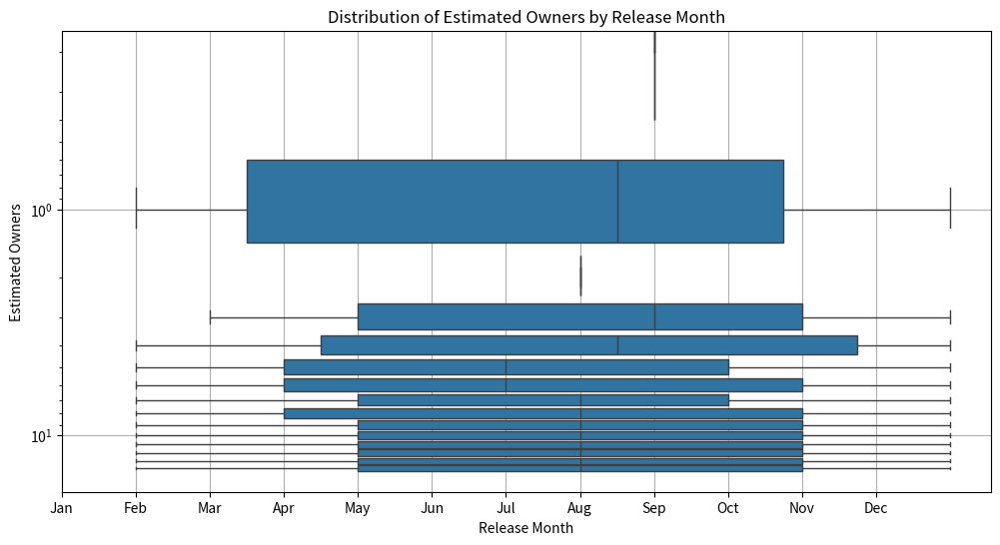

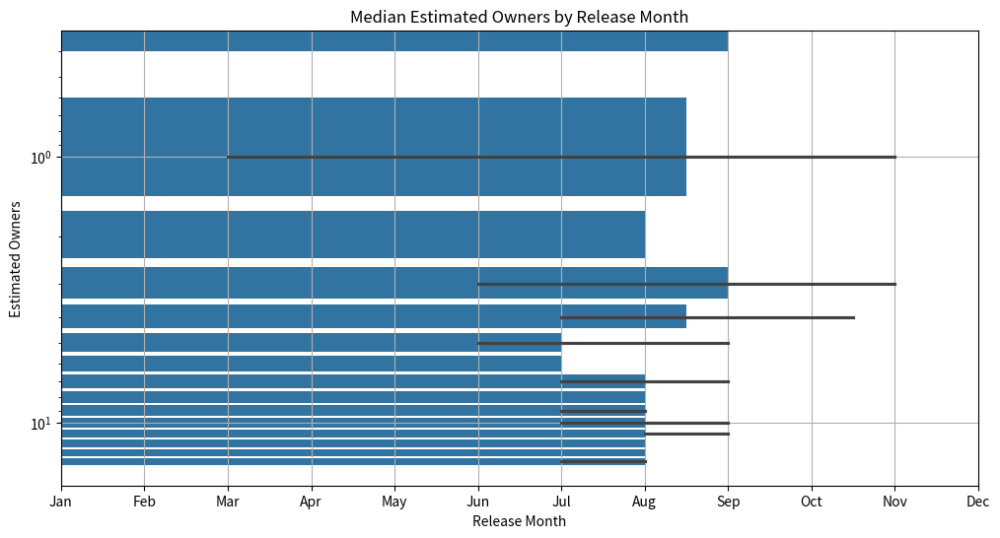

In [43]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Convert release_date to datetime format and extract the month
df['release_month'] = pd.to_datetime(df['release_date'], errors='coerce').dt.month

# Drop missing values
filtered_df = df.dropna(subset=['release_month', 'estimated_owners'])

# Boxplot: Distribution of estimated owners per release month
plt.figure(figsize=(12, 6))
sns.boxplot(data=filtered_df, x='release_month', y='estimated_owners')
plt.xticks(range(12), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.title('Distribution of Estimated Owners by Release Month')
plt.xlabel('Release Month')
plt.ylabel('Estimated Owners')
plt.yscale('log')  # Log scale to handle skewed data
plt.grid(True)
plt.show()

# Barplot: Mean estimated owners per release month
plt.figure(figsize=(12, 6))
sns.barplot(data=filtered_df, x='release_month', y='estimated_owners', estimator=np.median)
plt.xticks(range(12), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.title('Median Estimated Owners by Release Month')
plt.xlabel('Release Month')
plt.ylabel('Estimated Owners')
plt.yscale('log')
plt.grid(True)
plt.show()


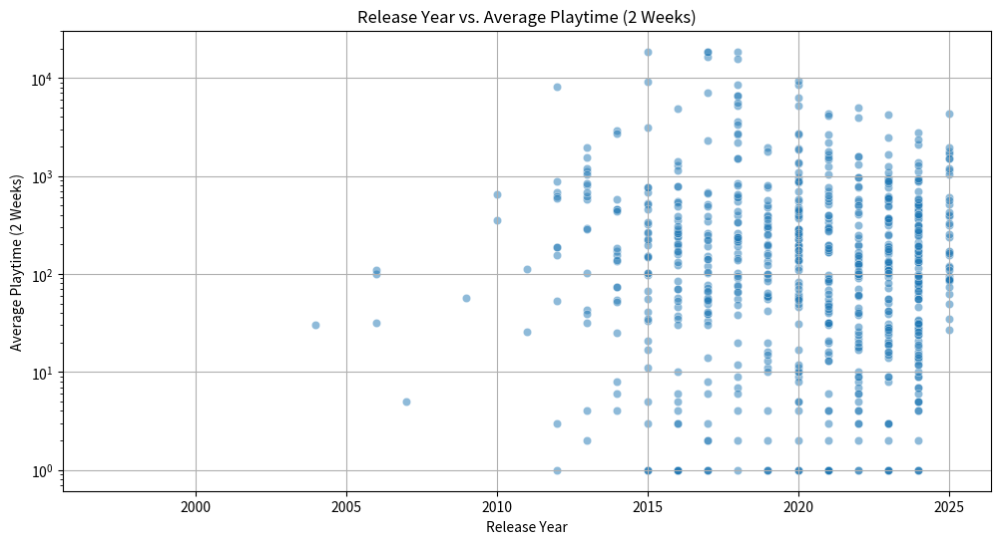

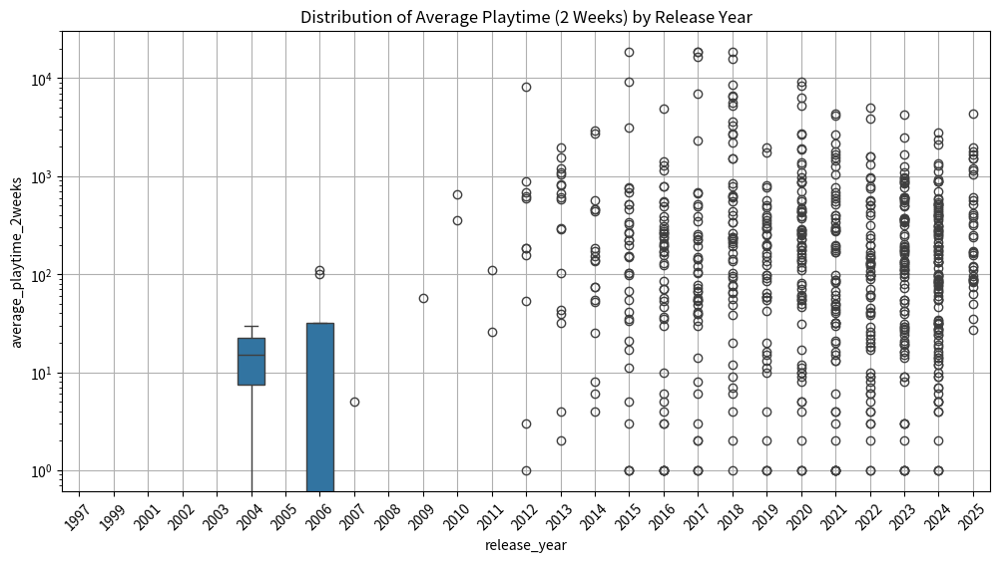

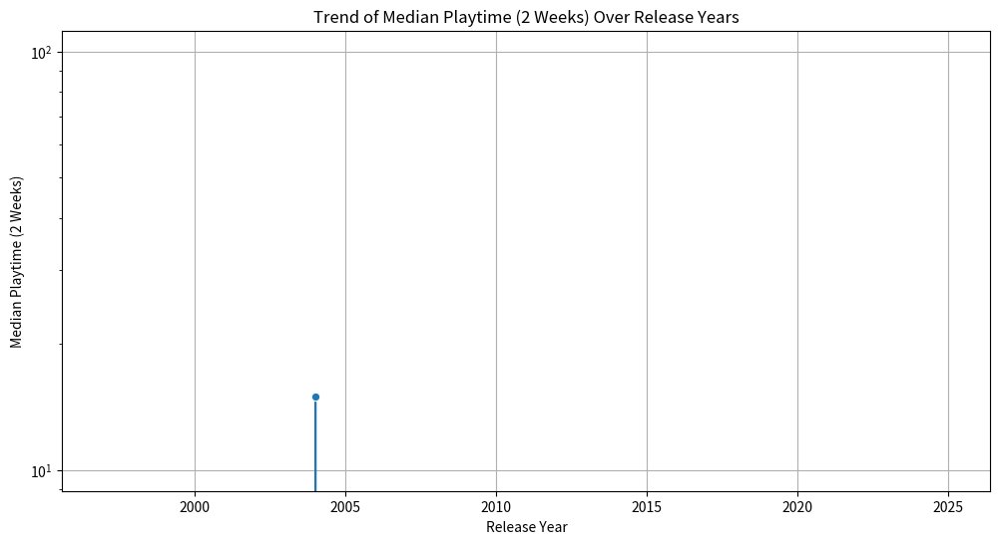

In [44]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Convert release_date to datetime format and extract the year
df['release_year'] = pd.to_datetime(df['release_date'], errors='coerce').dt.year

# Drop missing values in relevant columns
filtered_df = df.dropna(subset=['release_year', 'average_playtime_2weeks'])

# Scatter plot: Release Year vs. Average Playtime (2 Weeks)
plt.figure(figsize=(12, 6))
sns.scatterplot(data=filtered_df, x='release_year', y='average_playtime_2weeks', alpha=0.5)
plt.title('Release Year vs. Average Playtime (2 Weeks)')
plt.xlabel('Release Year')
plt.ylabel('Average Playtime (2 Weeks)')
plt.yscale('log')  # Log scale helps with skewed data
plt.grid(True)
plt.show()

# Boxplot: Distribution of Average Playtime per Release Year
plt.figure(figsize=(12, 6))
sns.boxplot(data=filtered_df, x='release_year', y='average_playtime_2weeks')
plt.xticks(rotation=45)
plt.title('Distribution of Average Playtime (2 Weeks) by Release Year')
plt.yscale('log')
plt.grid(True)
plt.show()

# Line plot: Median Playtime per Release Year
plt.figure(figsize=(12, 6))
sns.lineplot(data=filtered_df.groupby('release_year')['average_playtime_2weeks'].median().reset_index(),
             x='release_year', y='average_playtime_2weeks', marker='o')
plt.title('Trend of Median Playtime (2 Weeks) Over Release Years')
plt.xlabel('Release Year')
plt.ylabel('Median Playtime (2 Weeks)')
plt.yscale('log')
plt.grid(True)
plt.show()


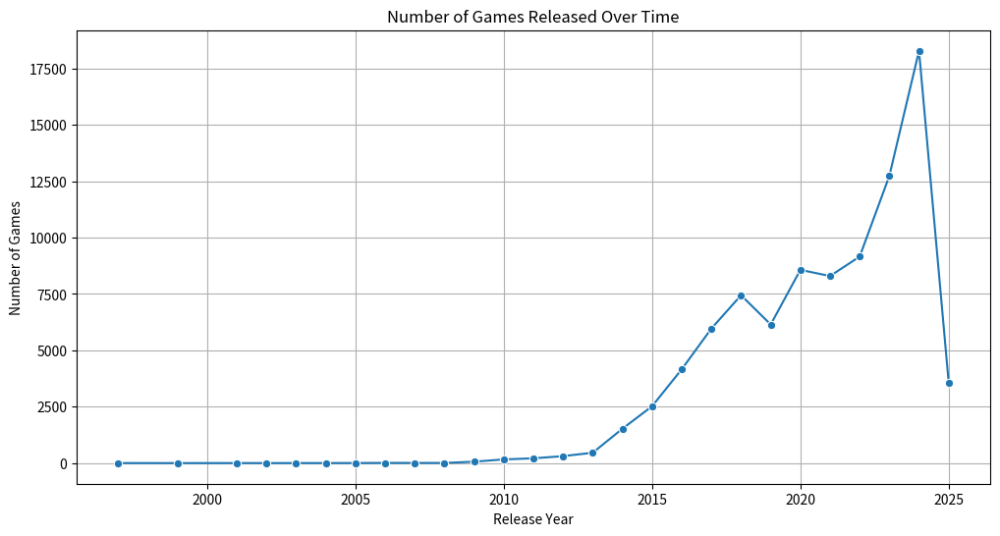

In [45]:
# Count the number of games released per year
game_count_per_year = filtered_df['release_year'].value_counts().sort_index()

# Line plot: Number of Games Released Per Year
plt.figure(figsize=(12, 6))
sns.lineplot(x=game_count_per_year.index, y=game_count_per_year.values, marker='o')
plt.title('Number of Games Released Over Time')
plt.xlabel('Release Year')
plt.ylabel('Number of Games')
plt.grid(True)
plt.show()


## Risk

Original dataset size: 3512
After removing invalid reviews and metacritic scores: 3512
After removing free games: 3338


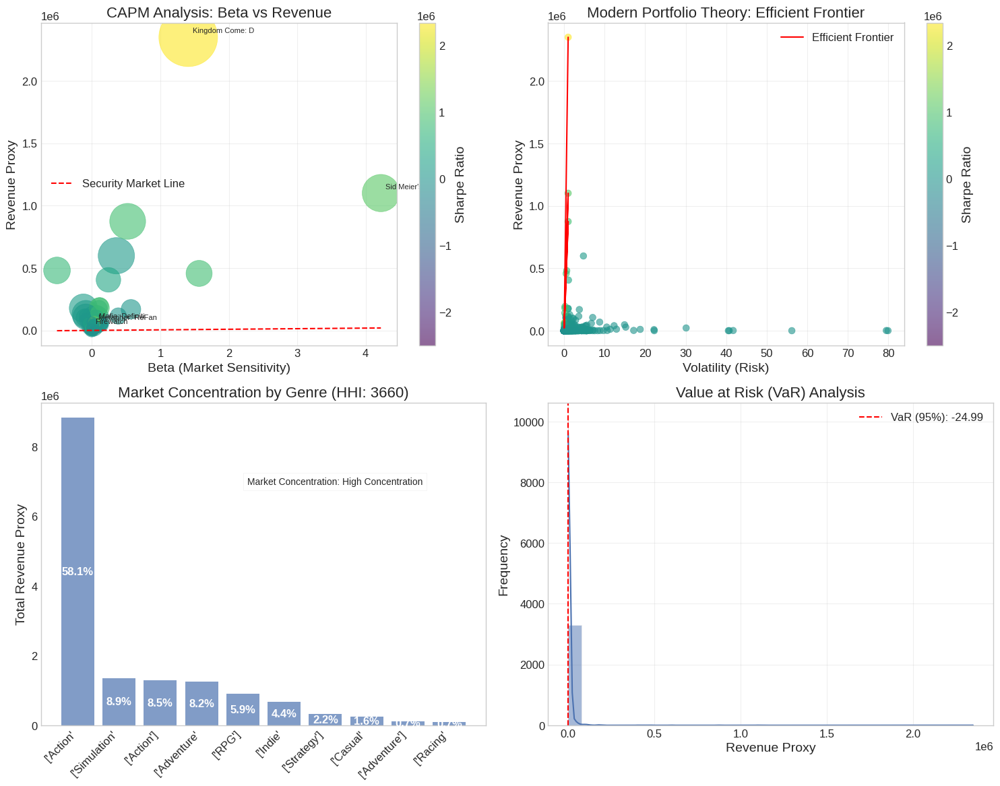

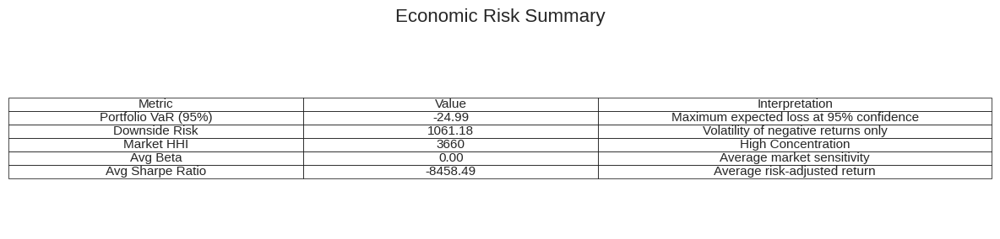

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import LinearSegmentedColormap
import warnings
from scipy import stats

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')


# Clean the data - filter out invalid values
# Remove entries with pct_pos_total of -1 and metacritic_score of 0
print("Original dataset size:", len(df))
df = df[(df['pct_pos_total'] != -1) & ((df['metacritic_score'] > 0) | df['metacritic_score'].isna())]
print("After removing invalid reviews and metacritic scores:", len(df))

# Filter out free games
df = df[df['price'] > 0]
print("After removing free games:", len(df))

# Handle potential missing values
df['price'] = df['price'].fillna(0)
df['num_reviews_recent'] = df['num_reviews_recent'].fillna(0)
df['pct_pos_recent'] = df['pct_pos_recent'].fillna(0.5)
df['median_playtime_forever'] = df['median_playtime_forever'].fillna(0)
df['average_playtime_forever'] = df['average_playtime_forever'].fillna(0)
df['peak_ccu'] = df['peak_ccu'].fillna(0)

# Extract genres (handling potential list/string format issues)
if isinstance(df['genres'].iloc[0], str):
    df['main_genre'] = df['genres'].apply(lambda x: 
        x.split(',')[0].strip() if isinstance(x, str) and ',' in x else 
        (x.strip() if isinstance(x, str) else 'Unknown'))
else:
    df['main_genre'] = df['genres']

# Calculate revenue proxy (price * recent reviews)
df['revenue_proxy'] = df['price'] * df['num_reviews_recent']

# ----- ECONOMIC RISK METRICS -----

# 1. Calculate coefficient of variation (standardized measure of dispersion)
# Group games by genre to create "market segments"
genre_groups = df.groupby('main_genre')
df['genre_mean_revenue'] = df['main_genre'].map(genre_groups['revenue_proxy'].mean())
df['genre_std_revenue'] = df['main_genre'].map(genre_groups['revenue_proxy'].std())

# Coefficient of variation (CV) - relative volatility within genre
df['cv'] = df['genre_std_revenue'] / df['genre_mean_revenue']
df['cv'] = df['cv'].replace([np.inf, -np.inf, np.nan], 0)

# 2. Calculate Sharpe ratio analog (return per unit of risk)
# Use genre average as "risk-free rate" benchmark
df['excess_return'] = df['revenue_proxy'] - df['genre_mean_revenue']
# Calculate game-specific volatility based on playtime variability
df['volatility'] = (df['average_playtime_forever'] - df['median_playtime_forever']).abs() / df['median_playtime_forever'].replace(0, 0.1)
df['sharpe_ratio'] = df['excess_return'] / df['volatility'].replace(0, 0.1)
df['sharpe_ratio'] = df['sharpe_ratio'].replace([np.inf, -np.inf, np.nan], 0)

# 3. Market Concentration (Herfindahl-Hirschman Index) by genre
genre_revenues = df.groupby('main_genre')['revenue_proxy'].sum()
total_revenue = genre_revenues.sum()
market_shares = genre_revenues / total_revenue
hhi = (market_shares ** 2).sum() * 10000  # Scale to traditional HHI range

# 4. Beta calculation (market sensitivity)
# Calculate "market return" as overall average revenue proxy movement
market_avg = df['revenue_proxy'].mean()
df['market_deviation'] = (df['revenue_proxy'] - market_avg) ** 2
market_variance = df['market_deviation'].mean()
df['game_market_covariance'] = (df['revenue_proxy'] - market_avg) * (df['genre_mean_revenue'] - market_avg)
df['beta'] = df['game_market_covariance'] / market_variance
df['beta'] = df['beta'].replace([np.inf, -np.inf, np.nan], 1)  # Default to market beta

# 5. Downside risk (semi-standard deviation) - Only considers negative deviations
downside_returns = df[df['revenue_proxy'] < df['genre_mean_revenue']]['revenue_proxy']
if len(downside_returns) > 0:
    downside_risk = downside_returns.std()
else:
    downside_risk = 0

# 6. Value at Risk (VaR) - Simplified version
# Sort revenue values and find the 5th percentile cutoff
var_95 = np.percentile(df['revenue_proxy'], 5)

# ---- VISUALIZATION ----
plt.style.use('seaborn-v0_8-whitegrid')
fig = plt.figure(figsize=(15, 12))

# 1. CAPM-style Security Market Line
plt.subplot(2, 2, 1)
plt.scatter(df['beta'], df['revenue_proxy'], alpha=0.6, c=df['sharpe_ratio'], 
            cmap='viridis', s=df['num_reviews_recent']/10 + 20)

# Calculate and plot the Security Market Line
beta_range = np.linspace(df['beta'].min(), df['beta'].max(), 100)
# CAPM formula: Expected Return = Risk Free Rate + Beta * Market Risk Premium
risk_free_rate = df['revenue_proxy'].min()
market_risk_premium = df['revenue_proxy'].mean() - risk_free_rate
sml = risk_free_rate + beta_range * market_risk_premium
plt.plot(beta_range, sml, 'r--', label='Security Market Line')

plt.xlabel('Beta (Market Sensitivity)')
plt.ylabel('Revenue Proxy')
plt.title('CAPM Analysis: Beta vs Revenue')
plt.colorbar(label='Sharpe Ratio')
plt.grid(True, alpha=0.3)
plt.legend()

# Annotate outliers
top_sharpe = df.nlargest(5, 'sharpe_ratio')
for _, game in top_sharpe.iterrows():
    plt.annotate(game['name'][:15], 
                 (game['beta'], game['revenue_proxy']),
                 xytext=(5, 5), textcoords='offset points',
                 fontsize=8)

# 2. Efficient Frontier approximation 
plt.subplot(2, 2, 2)
plt.scatter(df['volatility'], df['revenue_proxy'], alpha=0.6, c=df['sharpe_ratio'], 
            cmap='viridis', s=50)
plt.colorbar(label='Sharpe Ratio')

# Plot the "efficient frontier" - games with best return/risk tradeoff
# Sort by Sharpe ratio, then take points to form a frontier
efficient_games = df.sort_values('sharpe_ratio', ascending=False).head(10)
plt.plot(efficient_games['volatility'], efficient_games['revenue_proxy'], 'r-', label='Efficient Frontier')

plt.xlabel('Volatility (Risk)')
plt.ylabel('Revenue Proxy')
plt.title('Modern Portfolio Theory: Efficient Frontier')
plt.grid(True, alpha=0.3)
plt.legend()

# 3. Market Concentration by Genre (HHI visual)
plt.subplot(2, 2, 3)
# Size of each genre market
genre_game_counts = df.groupby('main_genre').size()
genre_revenues = df.groupby('main_genre')['revenue_proxy'].sum().sort_values(ascending=False)
top_genres = genre_revenues.head(10)

bars = plt.bar(top_genres.index, top_genres.values, alpha=0.7)

# Add market share text on each bar
for i, (genre, revenue) in enumerate(top_genres.items()):
    market_share = revenue / total_revenue * 100
    plt.text(i, revenue * 0.5, f'{market_share:.1f}%', 
             ha='center', va='center', rotation=0, color='white', fontweight='bold')

plt.xticks(rotation=45, ha='right')
plt.ylabel('Total Revenue Proxy')
plt.title(f'Market Concentration by Genre (HHI: {hhi:.0f})')
plt.grid(False)

# Add HHI interpretation
hhi_text = "Low Concentration" if hhi < 1500 else ("Moderate Concentration" if hhi < 2500 else "High Concentration")
plt.figtext(0.25, 0.38, f"Market Concentration: {hhi_text}", fontsize=10, bbox=dict(facecolor='white', alpha=0.8))

# 4. Value at Risk Analysis
plt.subplot(2, 2, 4)
# Create revenue distribution
sns.histplot(df['revenue_proxy'], bins=30, kde=True)
plt.axvline(var_95, color='r', linestyle='--', label=f'VaR (95%): {var_95:.2f}')

# Shade the VaR region
plt.fill_between(
    np.linspace(0, var_95, 100),
    0,
    plt.gca().get_ylim()[1],
    color='red',
    alpha=0.2
)

plt.xlabel('Revenue Proxy')
plt.ylabel('Frequency')
plt.title('Value at Risk (VaR) Analysis')
plt.legend()
plt.grid(True, alpha=0.3)

plt.tight_layout()

# Additional economic analysis: Risk-Return Summary Table
plt.figure(figsize=(12, 3))
table_data = [
    ['Metric', 'Value', 'Interpretation'],
    ['Portfolio VaR (95%)', f'{var_95:.2f}', 'Maximum expected loss at 95% confidence'],
    ['Downside Risk', f'{downside_risk:.2f}', 'Volatility of negative returns only'],
    ['Market HHI', f'{hhi:.0f}', hhi_text],
    ['Avg Beta', f'{df["beta"].mean():.2f}', 'Average market sensitivity'],
    ['Avg Sharpe Ratio', f'{df["sharpe_ratio"].mean():.2f}', 'Average risk-adjusted return']
]

plt.table(cellText=table_data, loc='center', cellLoc='center', colWidths=[0.3, 0.3, 0.4])
plt.axis('off')
plt.title('Economic Risk Summary', pad=20)

plt.tight_layout()
plt.show()

# Save figures to files if needed
# plt.savefig('steam_economic_risk_analysis.png', dpi=300, bbox_inches='tight')

# smash Hit counts

Loading real Steam dataset...
Dataset loaded successfully with 89618 records
Column names: ['appid', 'name', 'release_date', 'required_age', 'price', 'dlc_count', 'detailed_description', 'about_the_game', 'short_description', 'reviews', 'header_image', 'website', 'support_url', 'support_email', 'windows', 'mac', 'linux', 'metacritic_score', 'metacritic_url', 'achievements', 'recommendations', 'notes', 'supported_languages', 'full_audio_languages', 'packages', 'developers', 'publishers', 'categories', 'genres', 'screenshots', 'movies', 'user_score', 'score_rank', 'positive', 'negative', 'estimated_owners', 'average_playtime_forever', 'average_playtime_2weeks', 'median_playtime_forever', 'median_playtime_2weeks', 'discount', 'peak_ccu', 'tags', 'pct_pos_total', 'num_reviews_total', 'pct_pos_recent', 'num_reviews_recent']

Checking review count columns:
['reviews', 'num_reviews_total', 'num_reviews_recent']

Basic statistics for review counts:
num_reviews_total:
  Min: -1
  Max: 8632939
 

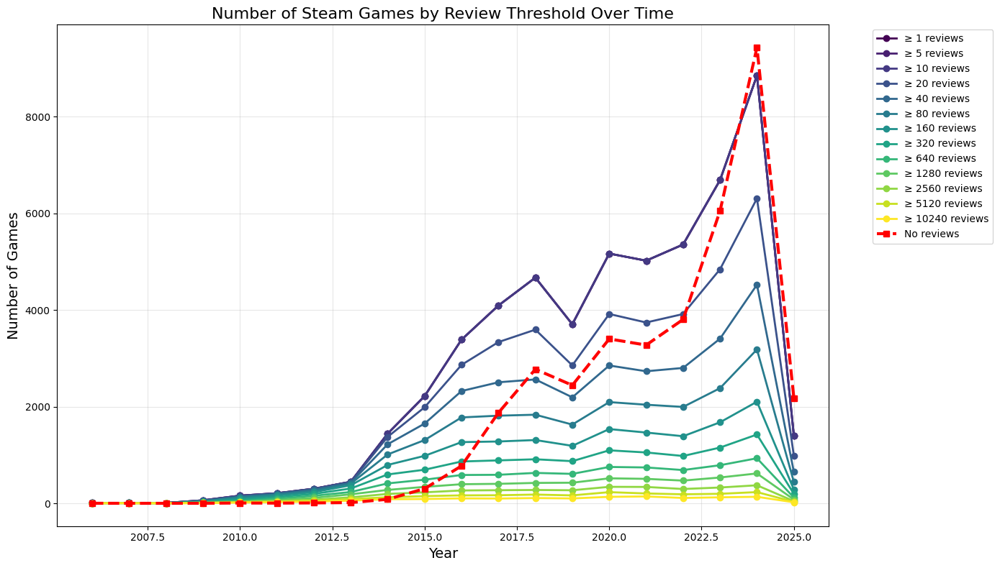

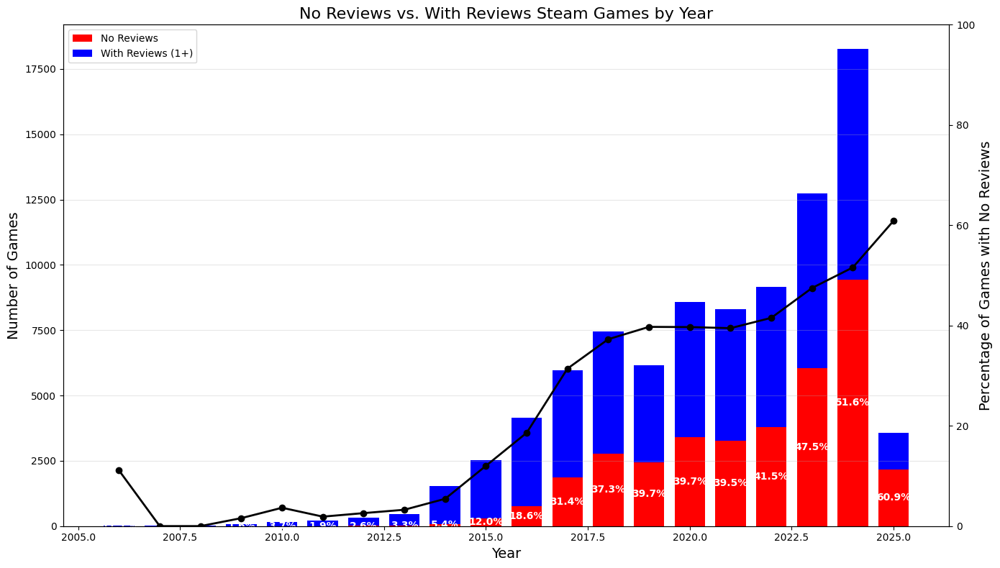

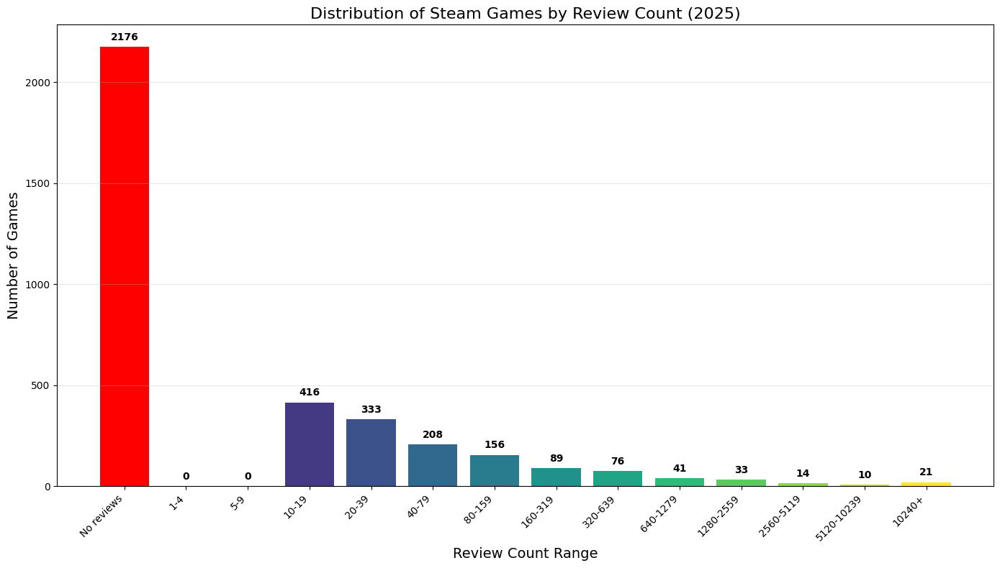

In [8]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the actual Steam dataset
print("Loading real Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

# Print dataset information
print(f"Dataset loaded successfully with {len(df)} records")
print("Column names:", df.columns.tolist())

# Check for review count columns
print("\nChecking review count columns:")
review_columns = [col for col in df.columns if 'review' in col.lower()]
print(review_columns)

# Display basic statistics about the review counts
print("\nBasic statistics for review counts:")
for col in review_columns:
    if pd.api.types.is_numeric_dtype(df[col]):
        print(f"{col}:")
        print(f"  Min: {df[col].min()}")
        print(f"  Max: {df[col].max()}")
        print(f"  Mean: {df[col].mean():.2f}")
        print(f"  Median: {df[col].median()}")
        print(f"  Number of zeros: {(df[col] == 0).sum()}")
        if -1 in df[col].values:
            print(f"  Number of -1s: {(df[col] == -1).sum()}")
        print()

# Determine which column to use for review counts
# Assuming 'num_reviews_total' is the correct column, but will verify
review_count_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None

if review_count_col is None:
    # Try to find a suitable column
    for col in review_columns:
        if pd.api.types.is_numeric_dtype(df[col]) and df[col].max() > 1000:
            review_count_col = col
            break

if review_count_col:
    print(f"Using {review_count_col} for review count analysis")
else:
    print("ERROR: Could not find a suitable review count column")
    review_count_col = review_columns[0] if review_columns else df.columns[0]

# Extract release date information
date_col = None
for col in df.columns:
    if 'date' in col.lower() or 'release' in col.lower():
        date_col = col
        break

if date_col:
    print(f"Using {date_col} for release date information")
else:
    print("ERROR: Could not find a suitable release date column")
    # Use a default column as fallback
    date_col = df.columns[0]

# Convert release date to datetime if it's not already
if date_col in df.columns:
    # Check the format of the date column
    print(f"\nSample values from {date_col}:")
    print(df[date_col].head())
    
    # Try to convert to datetime
    try:
        df['release_date'] = pd.to_datetime(df[date_col])
        print("Successfully converted release dates to datetime")
    except:
        print(f"Could not convert {date_col} to datetime. Using string parsing...")
        # Try basic string parsing for common formats
        try:
            df['release_date'] = pd.to_datetime(df[date_col], errors='coerce')
            print("Successfully converted release dates with coercion")
        except:
            print("Could not parse release dates. Creating placeholder dates...")
            # Create placeholder release dates
            df['release_date'] = pd.to_datetime('2015-01-01')
else:
    print("No date column found. Creating placeholder dates...")
    df['release_date'] = pd.to_datetime('2015-01-01')

# Extract year and month for time-based analysis
df['year'] = df['release_date'].dt.year
df['month'] = df['release_date'].dt.month

# Check if we have reasonable year data
year_counts = df['year'].value_counts().sort_index()
print("\nCounts by year:")
print(year_counts)

# Identify games with no reviews
# Check if -1 denotes no reviews
if review_count_col in df.columns:
    if -1 in df[review_count_col].values:
        print("\nDetected -1 values in review count, treating these as 'no reviews'")
        df['has_no_reviews'] = (df[review_count_col] <= 0) | (df[review_count_col] == -1)
    else:
        print("\nTreating reviews <= 0 as 'no reviews'")
        df['has_no_reviews'] = df[review_count_col] <= 0
else:
    print("\nCould not determine review status. Creating placeholder...")
    df['has_no_reviews'] = False

# Report the number of games with no reviews
no_reviews_count = df['has_no_reviews'].sum()
print(f"Number of games with no reviews: {no_reviews_count} ({no_reviews_count/len(df)*100:.1f}%)")

# Define the review thresholds we want to analyze
review_thresholds = [1, 5, 10, 20, 40, 80, 160, 320, 640, 1280, 2560, 5120, 10240]

# Create functions to count games by different criteria
def count_games_over_threshold(data, threshold, col, time_col='year'):
    """Count the number of games that have at least threshold reviews in each time period"""
    return data[data[col] >= threshold].groupby(time_col).size()

def count_games_total(data, time_col='year'):
    """Count the total number of games in each time period"""
    return data.groupby(time_col).size()

def count_games_with_no_reviews(data, time_col='year'):
    """Count the number of games with no reviews in each time period"""
    return data[data['has_no_reviews']].groupby(time_col).size()

# Calculate counts
try:
    total_counts = count_games_total(df)
    no_review_counts = count_games_with_no_reviews(df)

    # Calculate counts for each threshold
    threshold_counts = {}
    for threshold in review_thresholds:
        threshold_counts[threshold] = count_games_over_threshold(df, threshold, review_count_col)

    # Convert to DataFrame for easier plotting
    counts_df = pd.DataFrame({
        'total': total_counts,
        'no_reviews': no_review_counts
    })

    # Add thresholds
    for threshold in review_thresholds:
        counts_df[f'{threshold}+'] = threshold_counts[threshold]

    # Fill any missing values with 0
    counts_df = counts_df.fillna(0)

    # Calculate the percentage of no-review games over time
    counts_df['no_review_pct'] = (counts_df['no_reviews'] / counts_df['total']) * 100

    # Filter to reasonable years (2006 or later for Steam)
    valid_years = [year for year in counts_df.index if 2006 <= year <= 2025]
    counts_df = counts_df.loc[valid_years]

    print("\nData ready for plotting")
    print(f"Year range in analysis: {min(valid_years)} to {max(valid_years)}")
except Exception as e:
    print(f"Error during data analysis: {e}")
    # Create an empty DataFrame if there was an error
    counts_df = pd.DataFrame(columns=['total', 'no_reviews'])
    counts_df.index.name = 'year'

# Now we'll create the visualizations
try:
    # 1. Line chart showing all thresholds including no reviews
    plt.figure(figsize=(14, 8))
    cmap = plt.cm.viridis
    colors = cmap(np.linspace(0, 1, len(review_thresholds)))

    # Create a line for each threshold
    for i, threshold in enumerate(review_thresholds):
        if f'{threshold}+' in counts_df.columns:
            plt.plot(counts_df.index, counts_df[f'{threshold}+'], 
                    label=f'≥ {threshold} reviews', 
                    color=colors[i], 
                    linewidth=2, 
                    marker='o')

    # Highlight the no reviews line
    plt.plot(counts_df.index, counts_df['no_reviews'], 
            label='No reviews', 
            color='red', 
            linewidth=3, 
            linestyle='--', 
            marker='s')

    plt.title('Number of Steam Games by Review Threshold Over Time', fontsize=16)
    plt.xlabel('Year', fontsize=14)
    plt.ylabel('Number of Games', fontsize=14)
    plt.grid(True, alpha=0.3)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    plt.tight_layout()

    # 2. Stacked bar chart of no-review vs. with-review games
    plt.figure(figsize=(14, 8))

    # Create the stacked bar chart
    no_reviews = counts_df['no_reviews']
    with_reviews = counts_df['total'] - counts_df['no_reviews']

    width = 0.75
    plt.bar(counts_df.index, no_reviews, width, label='No Reviews', color='red')
    plt.bar(counts_df.index, with_reviews, width, bottom=no_reviews, label='With Reviews (1+)', color='blue')

    # Add percentage labels on the bars
    for year in counts_df.index:
        # Only add labels if there are games in that year
        if counts_df.loc[year, 'total'] > 0:
            no_review_pct = (counts_df.loc[year, 'no_reviews'] / counts_df.loc[year, 'total']) * 100
            # Position the label in the middle of the no-review portion
            y_pos = counts_df.loc[year, 'no_reviews'] / 2
            if y_pos > 0:  # Only add label if there's space
                plt.text(year, y_pos, f'{no_review_pct:.1f}%', 
                        ha='center', va='center', color='white', fontweight='bold')

    plt.title('No Reviews vs. With Reviews Steam Games by Year', fontsize=16)
    plt.xlabel('Year', fontsize=14)
    plt.ylabel('Number of Games', fontsize=14)
    plt.legend()
    plt.grid(True, axis='y', alpha=0.3)

    # Add a trend line for the percentage of no-review games
    ax2 = plt.twinx()
    ax2.plot(counts_df.index, counts_df['no_review_pct'], 
            color='black', linewidth=2, linestyle='-', marker='o')
    ax2.set_ylabel('Percentage of Games with No Reviews', color='black', fontsize=14)
    ax2.tick_params(axis='y', labelcolor='black')
    ax2.set_ylim(0, 100)

    plt.tight_layout()

    # 3. Detailed breakdown for the latest year with sufficient data
    plt.figure(figsize=(14, 8))

    # Get the most recent year with sufficient data
    recent_years = counts_df[counts_df['total'] > 50].index
    latest_year = recent_years.max() if len(recent_years) > 0 else counts_df.index.max()
    latest_data = counts_df.loc[latest_year]

    # Calculate the bins for the histogram
    bins = [latest_data['no_reviews']]  # Start with no reviews
    bin_labels = ['No reviews']

    # Calculate games in each threshold range
    for i in range(len(review_thresholds) - 1):
        threshold_key = f'{review_thresholds[i]}+'
        next_threshold_key = f'{review_thresholds[i+1]}+'
        
        if threshold_key in counts_df.columns and next_threshold_key in counts_df.columns:
            # Calculate games with reviews between current and next threshold
            count = counts_df.loc[latest_year, threshold_key] - counts_df.loc[latest_year, next_threshold_key]
            bins.append(count)
            bin_labels.append(f'{review_thresholds[i]}-{review_thresholds[i+1]-1}')

    # Add the highest threshold bin
    highest_threshold_key = f'{review_thresholds[-1]}+'
    if highest_threshold_key in counts_df.columns:
        bins.append(counts_df.loc[latest_year, highest_threshold_key])
        bin_labels.append(f'{review_thresholds[-1]}+')

    # Create a custom colormap with red for no reviews, then the viridis gradient
    custom_colors = ['red'] + list(plt.cm.viridis(np.linspace(0, 1, len(bins)-1)))

    plt.bar(range(len(bins)), bins, color=custom_colors)
    plt.xticks(range(len(bins)), bin_labels, rotation=45, ha='right')
    plt.title(f'Distribution of Steam Games by Review Count ({latest_year})', fontsize=16)
    plt.xlabel('Review Count Range', fontsize=14)
    plt.ylabel('Number of Games', fontsize=14)
    plt.grid(True, axis='y', alpha=0.3)

    # Add count labels on top of each bar
    for i, count in enumerate(bins):
        plt.text(i, count + (max(bins)*0.01), f'{count:.0f}', 
                ha='center', va='bottom', fontweight='bold')

    plt.tight_layout()

    # Create a table showing the distribution of games including no reviews
    # Start with no reviews, then add the thresholds
    review_ranges = ['No reviews']
    counts = [latest_data['no_reviews']]
    
    for threshold in review_thresholds:
        threshold_key = f'{threshold}+'
        if threshold_key in counts_df.columns:
            review_ranges.append(f'{threshold}+ reviews')
            counts.append(latest_data[threshold_key])
    
    review_distribution = pd.DataFrame({
        'Review Range': review_ranges,
        'Count': counts,
    })

    # Calculate percentages
    total_games = latest_data['total']
    review_distribution['Percentage'] = (review_distribution['Count'] / total_games) * 100

    # Display the table
    print(f"\nGame distribution by review count in {latest_year}:")
    print(review_distribution.to_string(index=False, formatters={'Percentage': '{:,.1f}%'.format}))

    # Calculate year-over-year growth in games with no reviews
    if len(counts_df) > 1:
        yearly_growth = pd.DataFrame({
            'Year': counts_df.index[1:],
            'No Review Games': counts_df['no_reviews'].values[1:],
            'YoY Growth': counts_df['no_reviews'].pct_change().values[1:] * 100,
            'No Review %': counts_df['no_review_pct'].values[1:],
            'Change in %': counts_df['no_review_pct'].diff().values[1:]
        })

        print("\nYear-over-year trends in games with no reviews:")
        print(yearly_growth.tail(5).round(1))

    # Display the plots
    plt.show()

except Exception as e:
    print(f"Error during visualization: {e}")

# Smash hits per year

Loading real Steam dataset...
Dataset loaded successfully with 89618 records
Using num_reviews_total for review count analysis
Using release_date for release date information

Number of games by review threshold bands per year:
      total  no_reviews  0-0  1-4  5-9  10-19  20-39  40-79  80-159  160-319  \
2006      9           1    0    0    0      0      1      0       1        2   
2007      8           0    0    0    0      0      0      0       1        1   
2008      7           0    0    0    0      0      0      0       3        0   
2009     63           1    0    0    0      5      7      5       8        9   
2010    164           6    0    0    0      9     10     13      25       29   
2011    212           4    0    0    0      3      7     16      23       33   
2012    309           8    0    0    0      6     10     26      27       36   
2013    460          15    0    0    0      6     14     18      34       67   
2014   1525          83    0    0    0     67    153

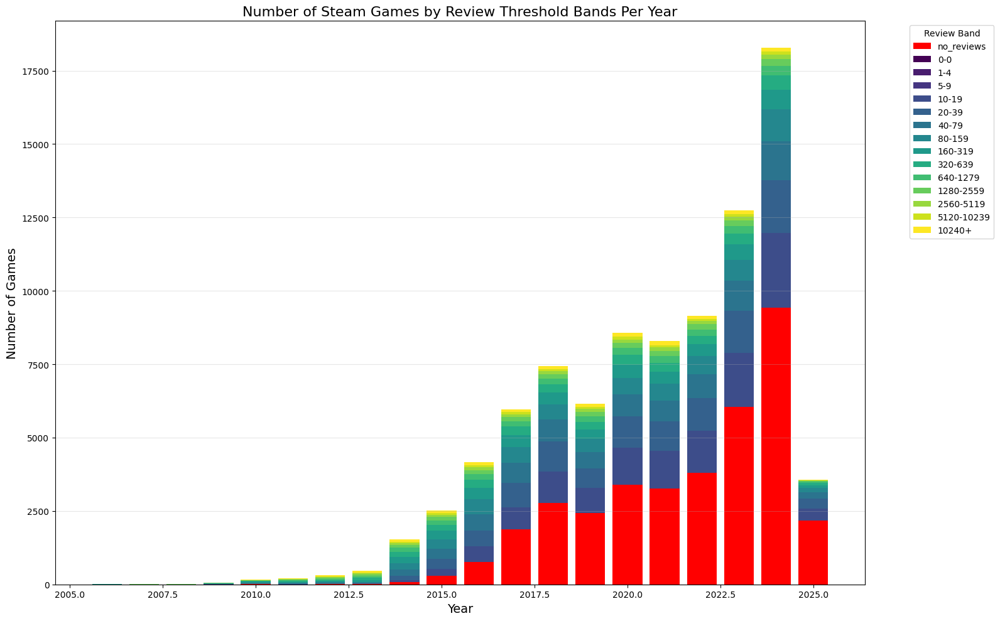

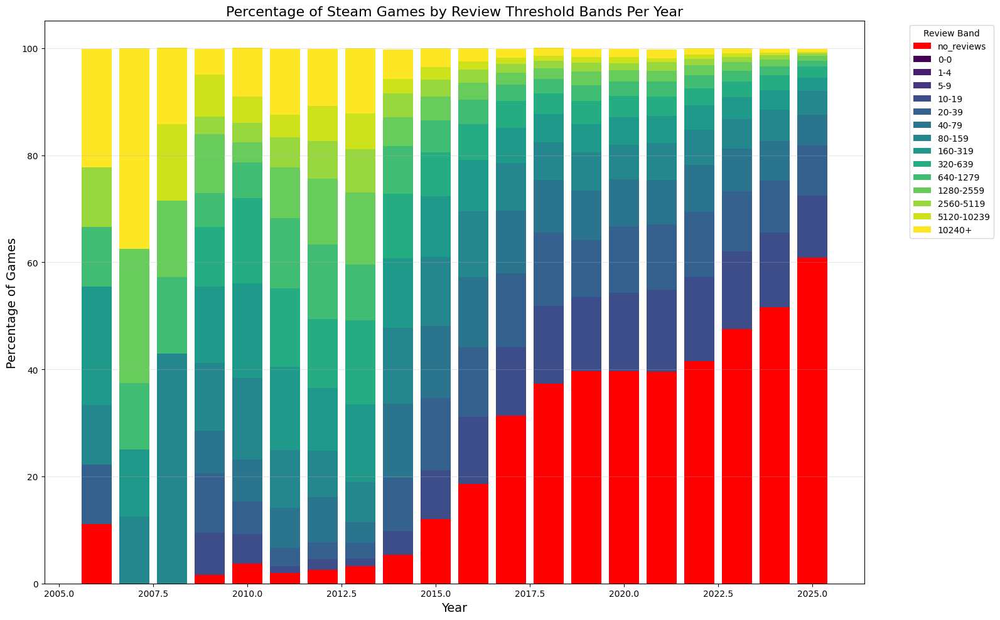

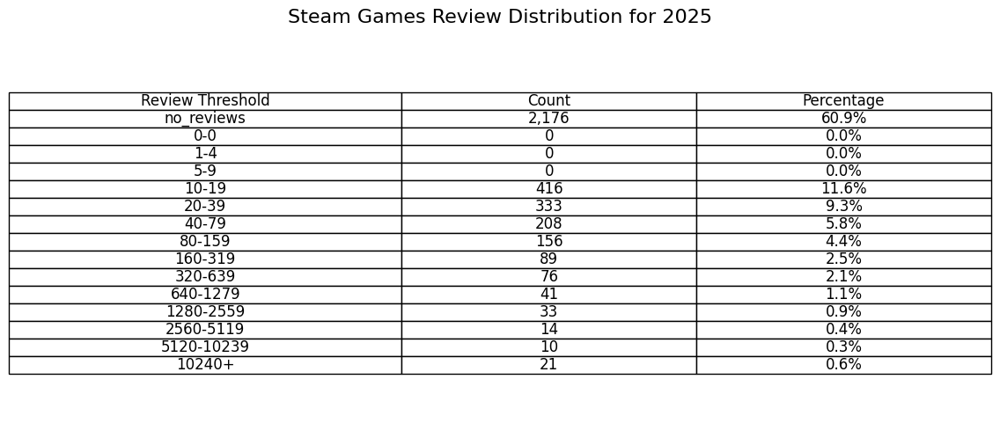

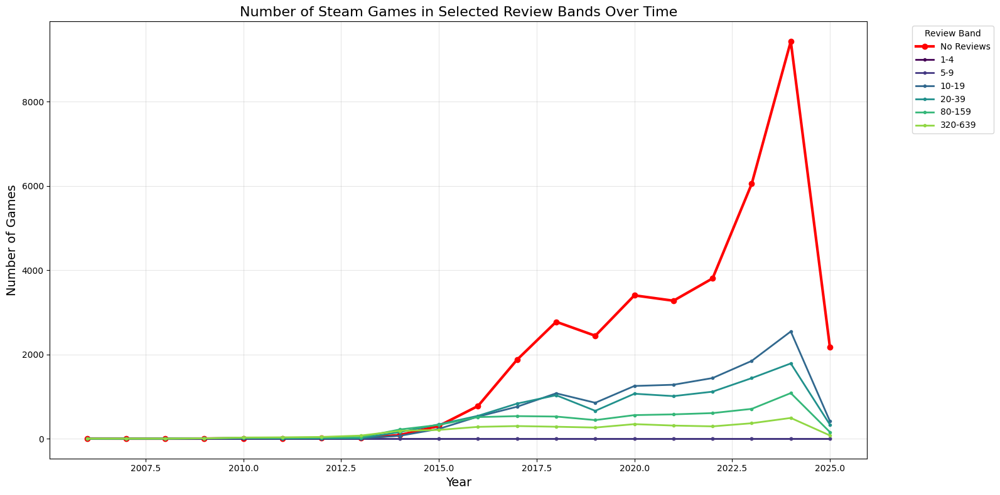

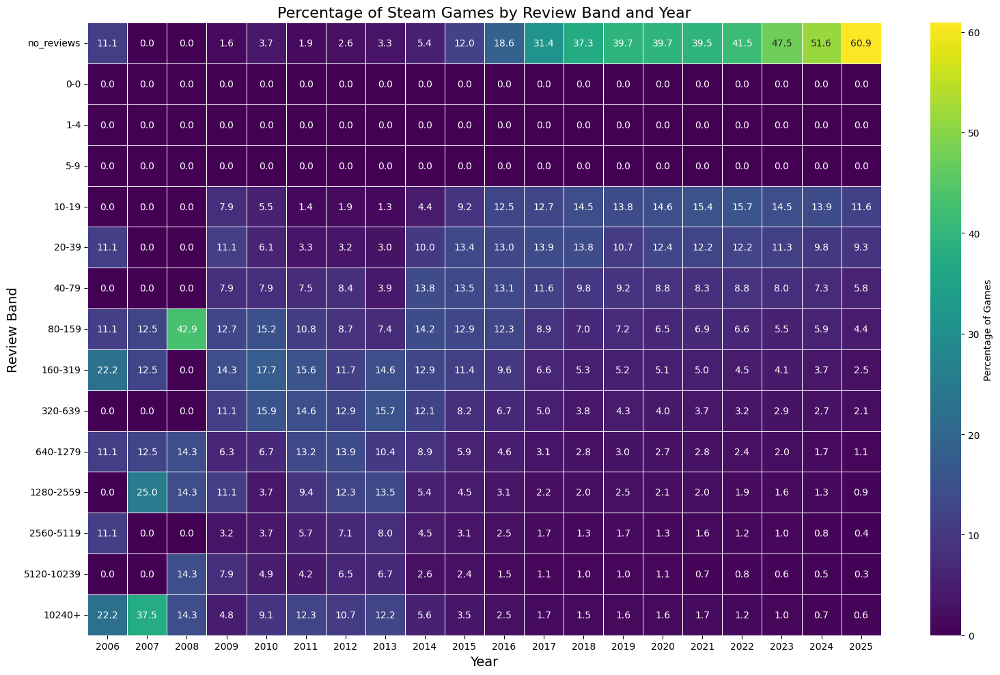


Data exported to CSV files: 'steam_review_threshold_counts.csv' and 'steam_review_threshold_percentages.csv'


In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the actual Steam dataset
print("Loading real Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Determine which column to use for review counts
review_count_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None
if review_count_col is None:
    review_columns = [col for col in df.columns if 'review' in col.lower()]
    for col in review_columns:
        if pd.api.types.is_numeric_dtype(df[col]):
            review_count_col = col
            break

if review_count_col:
    print(f"Using {review_count_col} for review count analysis")
else:
    print("ERROR: Could not find a suitable review count column")
    review_count_col = df.columns[0]  # Default fallback

# Find and process release date column
date_col = None
for col in df.columns:
    if 'date' in col.lower() or 'release' in col.lower():
        date_col = col
        break

if date_col:
    print(f"Using {date_col} for release date information")
    try:
        df['release_date'] = pd.to_datetime(df[date_col], errors='coerce')
    except:
        print(f"Could not convert {date_col} to datetime. Creating placeholder dates...")
        df['release_date'] = pd.to_datetime('2015-01-01')
else:
    print("No date column found. Creating placeholder dates...")
    df['release_date'] = pd.to_datetime('2015-01-01')

# Extract year for analysis
df['year'] = df['release_date'].dt.year

# Define the review thresholds we want to analyze
review_thresholds = [0, 1, 5, 10, 20, 40, 80, 160, 320, 640, 1280, 2560, 5120, 10240]

# Create a function to count games in each threshold band per year
def count_games_by_threshold_bands(data, thresholds, review_col):
    """
    Count games in each review threshold band for each year
    Returns a DataFrame with years as rows and threshold bands as columns
    """
    # Group by year
    years = sorted(data['year'].dropna().unique())
    
    # Initialize results DataFrame
    result = pd.DataFrame(index=years)
    
    # For each year, count games in each threshold band
    for year in years:
        year_data = data[data['year'] == year]
        total_games = len(year_data)
        result.loc[year, 'total'] = total_games
        
        # Count games with exactly 0 or -1 reviews (no reviews)
        no_reviews = sum((year_data[review_col] <= 0) | (year_data[review_col] == -1))
        result.loc[year, 'no_reviews'] = no_reviews
        
        # Count games in each threshold band
        for i in range(len(thresholds)-1):
            lower = thresholds[i]
            upper = thresholds[i+1] - 1  # Up to but not including the next threshold
            
            # Skip the first band if it's 0 (we already counted no_reviews)
            if lower == 0:
                band_count = sum((year_data[review_col] >= 1) & (year_data[review_col] <= upper))
            else:
                band_count = sum((year_data[review_col] >= lower) & (year_data[review_col] <= upper))
                
            result.loc[year, f'{lower}-{upper}'] = band_count
        
        # Count games with reviews >= the highest threshold
        highest = thresholds[-1]
        result.loc[year, f'{highest}+'] = sum(year_data[review_col] >= highest)
    
    return result

# Create the threshold bands DataFrame
threshold_bands_df = count_games_by_threshold_bands(df, review_thresholds, review_count_col)

# Fill NaNs with 0
threshold_bands_df = threshold_bands_df.fillna(0)

# Convert to integers
for col in threshold_bands_df.columns:
    threshold_bands_df[col] = threshold_bands_df[col].astype(int)

# Filter to reasonable years (2006 or later for Steam)
valid_years = [year for year in threshold_bands_df.index if 2006 <= year <= 2025]
threshold_bands_df = threshold_bands_df.loc[valid_years]

# Create an additional DataFrame with percentages
percentage_df = threshold_bands_df.copy()
for col in percentage_df.columns:
    if col != 'total':
        percentage_df[col] = (percentage_df[col] / percentage_df['total'] * 100).round(1)

# Display the threshold bands DataFrame
print("\nNumber of games by review threshold bands per year:")
print(threshold_bands_df)

# Display the percentage DataFrame
print("\nPercentage of games by review threshold bands per year:")
print(percentage_df)

# Visualizations
# 1. Stacked bar chart showing absolute counts
plt.figure(figsize=(16, 10))

# Get all columns except 'total' for stacking
stack_columns = [col for col in threshold_bands_df.columns if col != 'total']

# Create a colormap: red for no reviews, viridis gradient for the rest
cmap = plt.cm.viridis
colors = ['red'] + list(cmap(np.linspace(0, 1, len(stack_columns)-1)))

# Plot stacked bars
bottom = np.zeros(len(threshold_bands_df))
for i, col in enumerate(stack_columns):
    plt.bar(threshold_bands_df.index, threshold_bands_df[col], bottom=bottom, 
            label=col, color=colors[i])
    bottom += threshold_bands_df[col]

plt.title('Number of Steam Games by Review Threshold Bands Per Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Games', fontsize=14)
plt.legend(title='Review Band', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# 2. Stacked percentage chart
plt.figure(figsize=(16, 10))

# Plot stacked percentage bars
bottom = np.zeros(len(percentage_df))
for i, col in enumerate(stack_columns):
    plt.bar(percentage_df.index, percentage_df[col], bottom=bottom, 
            label=col, color=colors[i])
    bottom += percentage_df[col]

plt.title('Percentage of Steam Games by Review Threshold Bands Per Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Percentage of Games', fontsize=14)
plt.legend(title='Review Band', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# 3. Table visualization for the latest year
latest_year = threshold_bands_df.index.max()
latest_data = threshold_bands_df.loc[latest_year].copy()
latest_percentages = percentage_df.loc[latest_year].copy()

# Create a DataFrame for the table
table_data = pd.DataFrame({
    'Review Threshold': stack_columns,
    'Count': [latest_data[col] for col in stack_columns],
    'Percentage': [latest_percentages[col] for col in stack_columns]
})

plt.figure(figsize=(12, 6))
plt.axis('off')
plt.title(f'Steam Games Review Distribution for {latest_year}', fontsize=16)

# Create table
cell_text = []
for row in range(len(table_data)):
    cell_text.append([
        table_data['Review Threshold'].iloc[row],
        f"{table_data['Count'].iloc[row]:,}",
        f"{table_data['Percentage'].iloc[row]:.1f}%"
    ])

table = plt.table(
    cellText=cell_text,
    colLabels=['Review Threshold', 'Count', 'Percentage'],
    loc='center',
    cellLoc='center',
    colWidths=[0.4, 0.3, 0.3]
)
table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 1.2)

# 4. Time series of games with no reviews vs. different thresholds
plt.figure(figsize=(16, 8))

# Plot the no reviews trend
plt.plot(threshold_bands_df.index, threshold_bands_df['no_reviews'], 
         label='No Reviews', color='red', linewidth=3, marker='o')

# Plot trends for selected thresholds
selected_thresholds = ['1-4', '5-9', '10-19', '20-39', '80-159', '320-639', '1280+']
colors = plt.cm.viridis(np.linspace(0, 1, len(selected_thresholds)))

for i, threshold in enumerate(selected_thresholds):
    if threshold in threshold_bands_df.columns:
        plt.plot(threshold_bands_df.index, threshold_bands_df[threshold], 
                 label=threshold, color=colors[i], linewidth=2, marker='.')

plt.title('Number of Steam Games in Selected Review Bands Over Time', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Games', fontsize=14)
plt.grid(True, alpha=0.3)
plt.legend(title='Review Band', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# 5. Heatmap showing the percentage distribution by year
plt.figure(figsize=(16, 10))

# Select only the band columns
band_columns = [col for col in percentage_df.columns if col != 'total']

# Create the heatmap data
heatmap_data = percentage_df[band_columns].T  # Transpose to have years as columns

sns.heatmap(heatmap_data, cmap='viridis', annot=True, fmt='.1f', 
            linewidths=.5, cbar_kws={'label': 'Percentage of Games'})
plt.title('Percentage of Steam Games by Review Band and Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Review Band', fontsize=14)
plt.tight_layout()

plt.show()

# Export the data to CSV for further analysis
threshold_bands_df.to_csv('steam_review_threshold_counts.csv')
percentage_df.to_csv('steam_review_threshold_percentages.csv')

print("\nData exported to CSV files: 'steam_review_threshold_counts.csv' and 'steam_review_threshold_percentages.csv'")

Loading real Steam dataset...
Dataset loaded successfully with 89618 records
Using num_reviews_recent for recent review count analysis
Using release_date for release date information

Recent review column: num_reviews_recent
Min value: -1
Max value: 96473
Mean value: 15.58
Median value: -1.0
Number of zeros: 0
Number of negative values: 82931

Number of games by RECENT review threshold bands per year:
      total  no_reviews  0-0  1-4  5-9  10-19  20-39  40-79  80-159  160-319  \
2006      9           5    0    0    0      1      0      1       1        0   
2007      8           4    0    0    0      1      0      1       0        0   
2008      7           4    0    0    0      0      1      0       0        1   
2009     63          48    0    0    0      4      1      7       2        0   
2010    164         134    0    0    0      5      7      5       5        5   
2011    212         160    0    0    0     16     12      6       6        9   
2012    309         224    0    0  

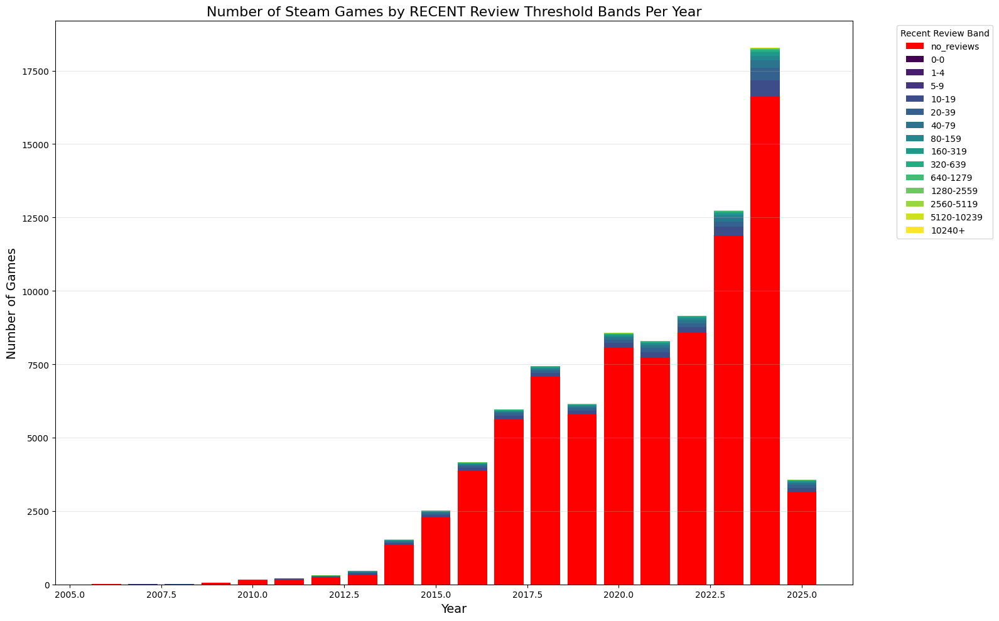

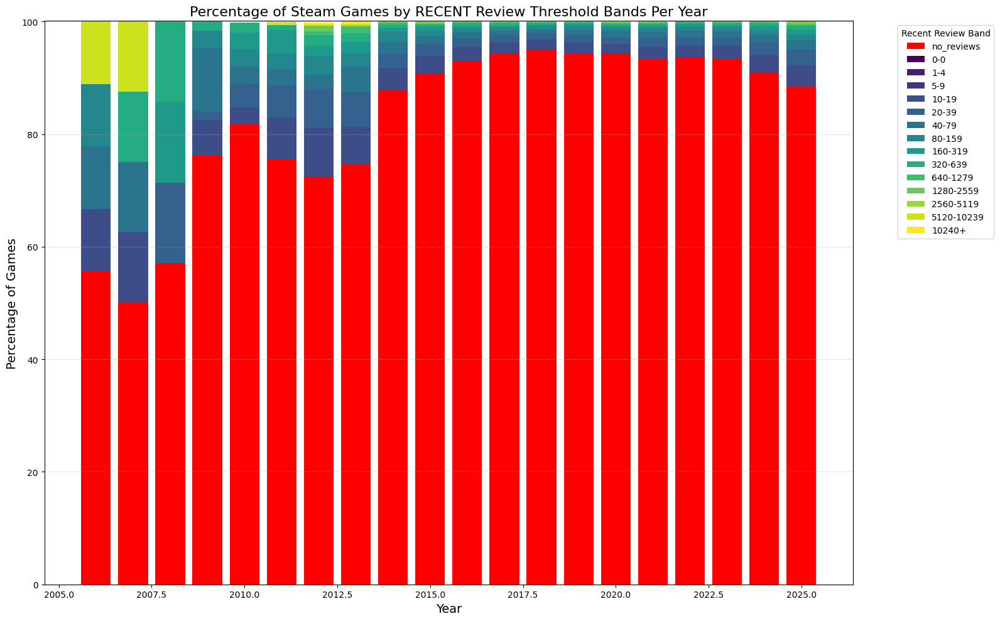

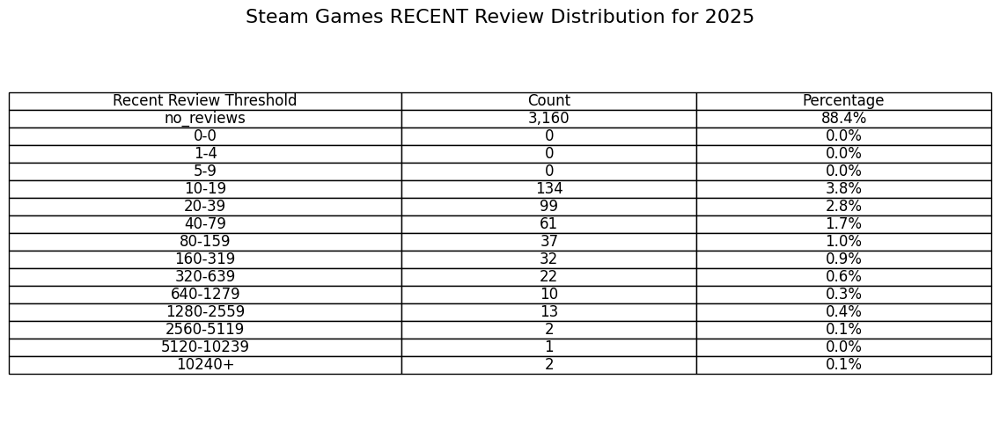

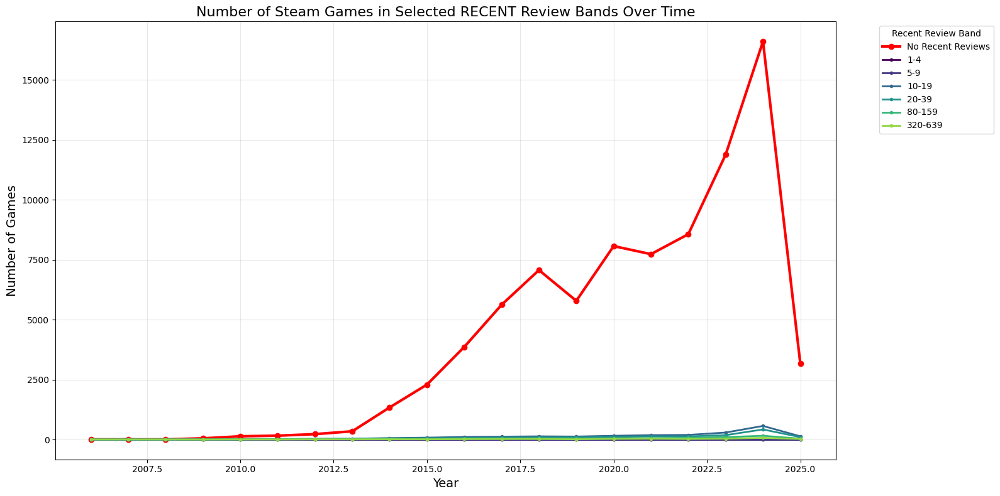

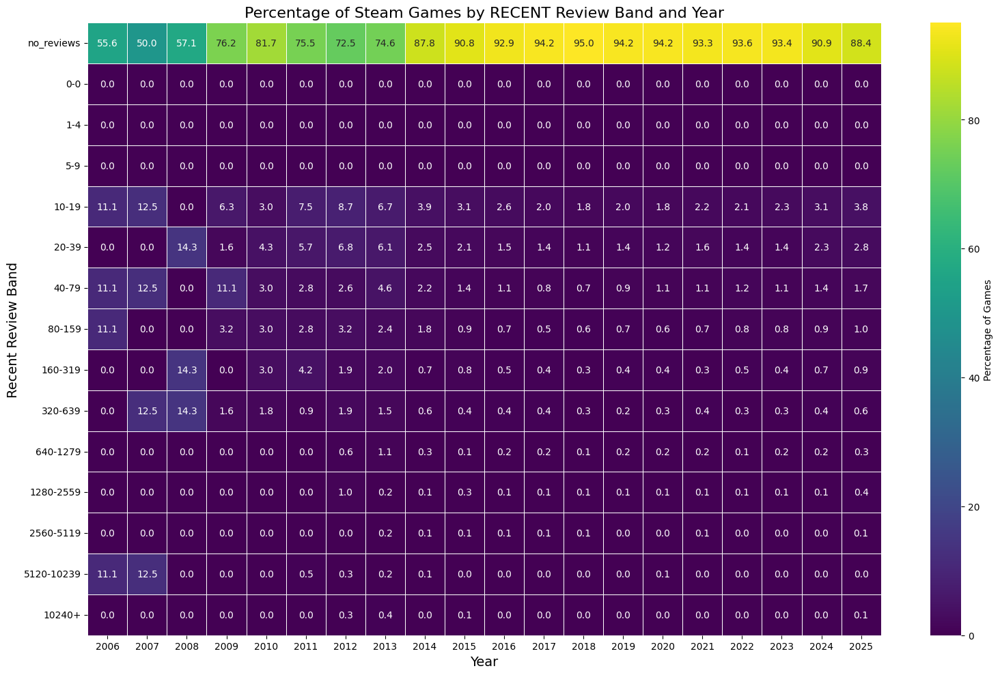

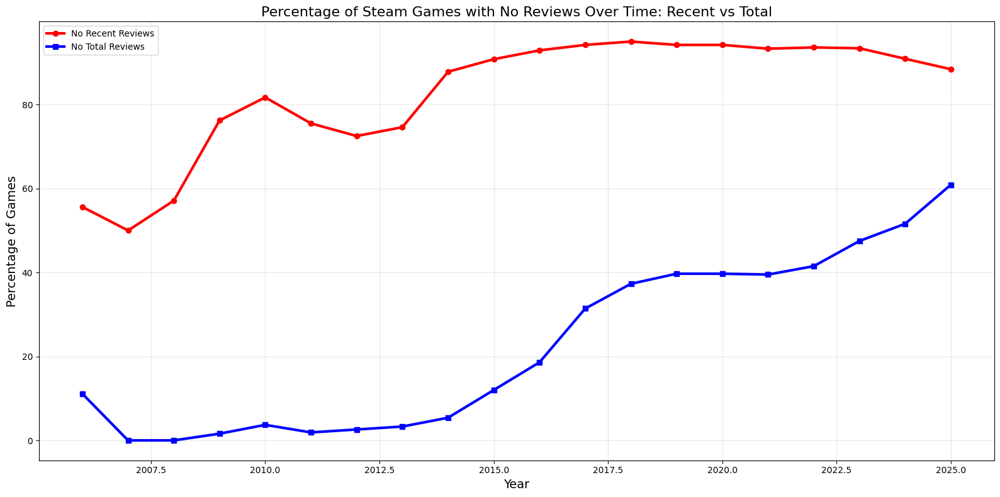


Data exported to CSV files: 'steam_recent_review_threshold_counts.csv' and 'steam_recent_review_threshold_percentages.csv'


In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the actual Steam dataset
print("Loading real Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Determine which column to use for recent review counts
recent_review_col = 'num_reviews_recent' if 'num_reviews_recent' in df.columns else None
if recent_review_col is None:
    review_columns = [col for col in df.columns if 'review' in col.lower() and 'recent' in col.lower()]
    for col in review_columns:
        if pd.api.types.is_numeric_dtype(df[col]):
            recent_review_col = col
            break

if recent_review_col:
    print(f"Using {recent_review_col} for recent review count analysis")
else:
    print("ERROR: Could not find a suitable recent review count column")
    # Fallback to total reviews if available
    total_review_cols = [col for col in df.columns if 'review' in col.lower() and 'total' in col.lower()]
    if total_review_cols:
        recent_review_col = total_review_cols[0]
        print(f"Falling back to {recent_review_col}")
    else:
        # Last resort fallback
        numeric_cols = [col for col in df.columns if pd.api.types.is_numeric_dtype(df[col])]
        recent_review_col = numeric_cols[0] if numeric_cols else df.columns[0]
        print(f"Last resort fallback to {recent_review_col}")

# Find and process release date column
date_col = None
for col in df.columns:
    if 'date' in col.lower() or 'release' in col.lower():
        date_col = col
        break

if date_col:
    print(f"Using {date_col} for release date information")
    try:
        df['release_date'] = pd.to_datetime(df[date_col], errors='coerce')
    except:
        print(f"Could not convert {date_col} to datetime. Creating placeholder dates...")
        df['release_date'] = pd.to_datetime('2015-01-01')
else:
    print("No date column found. Creating placeholder dates...")
    df['release_date'] = pd.to_datetime('2015-01-01')

# Extract year for analysis
df['year'] = df['release_date'].dt.year

# Print some basic stats about recent reviews
print(f"\nRecent review column: {recent_review_col}")
print(f"Min value: {df[recent_review_col].min()}")
print(f"Max value: {df[recent_review_col].max()}")
print(f"Mean value: {df[recent_review_col].mean():.2f}")
print(f"Median value: {df[recent_review_col].median()}")
print(f"Number of zeros: {(df[recent_review_col] == 0).sum()}")
print(f"Number of negative values: {(df[recent_review_col] < 0).sum()}")

# Define the review thresholds we want to analyze
review_thresholds = [0, 1, 5, 10, 20, 40, 80, 160, 320, 640, 1280, 2560, 5120, 10240]

# Create a function to count games in each threshold band per year
def count_games_by_threshold_bands(data, thresholds, review_col):
    """
    Count games in each review threshold band for each year
    Returns a DataFrame with years as rows and threshold bands as columns
    """
    # Group by year
    years = sorted(data['year'].dropna().unique())
    
    # Initialize results DataFrame
    result = pd.DataFrame(index=years)
    
    # For each year, count games in each threshold band
    for year in years:
        year_data = data[data['year'] == year]
        total_games = len(year_data)
        result.loc[year, 'total'] = total_games
        
        # Count games with exactly 0 or negative reviews (no reviews)
        no_reviews = sum((year_data[review_col] <= 0))
        result.loc[year, 'no_reviews'] = no_reviews
        
        # Count games in each threshold band
        for i in range(len(thresholds)-1):
            lower = thresholds[i]
            upper = thresholds[i+1] - 1  # Up to but not including the next threshold
            
            # Skip the first band if it's 0 (we already counted no_reviews)
            if lower == 0:
                band_count = sum((year_data[review_col] >= 1) & (year_data[review_col] <= upper))
            else:
                band_count = sum((year_data[review_col] >= lower) & (year_data[review_col] <= upper))
                
            result.loc[year, f'{lower}-{upper}'] = band_count
        
        # Count games with reviews >= the highest threshold
        highest = thresholds[-1]
        result.loc[year, f'{highest}+'] = sum(year_data[review_col] >= highest)
    
    return result

# Create the threshold bands DataFrame
threshold_bands_df = count_games_by_threshold_bands(df, review_thresholds, recent_review_col)

# Fill NaNs with 0
threshold_bands_df = threshold_bands_df.fillna(0)

# Convert to integers
for col in threshold_bands_df.columns:
    threshold_bands_df[col] = threshold_bands_df[col].astype(int)

# Filter to reasonable years (2006 or later for Steam)
valid_years = [year for year in threshold_bands_df.index if 2006 <= year <= 2025]
threshold_bands_df = threshold_bands_df.loc[valid_years]

# Create an additional DataFrame with percentages
percentage_df = threshold_bands_df.copy()
for col in percentage_df.columns:
    if col != 'total':
        percentage_df[col] = (percentage_df[col] / percentage_df['total'] * 100).round(1)

# Display the threshold bands DataFrame
print("\nNumber of games by RECENT review threshold bands per year:")
print(threshold_bands_df)

# Display the percentage DataFrame
print("\nPercentage of games by RECENT review threshold bands per year:")
print(percentage_df)

# Visualizations
# 1. Stacked bar chart showing absolute counts
plt.figure(figsize=(16, 10))

# Get all columns except 'total' for stacking
stack_columns = [col for col in threshold_bands_df.columns if col != 'total']

# Create a colormap: red for no reviews, viridis gradient for the rest
cmap = plt.cm.viridis
colors = ['red'] + list(cmap(np.linspace(0, 1, len(stack_columns)-1)))

# Plot stacked bars
bottom = np.zeros(len(threshold_bands_df))
for i, col in enumerate(stack_columns):
    plt.bar(threshold_bands_df.index, threshold_bands_df[col], bottom=bottom, 
            label=col, color=colors[i])
    bottom += threshold_bands_df[col]

plt.title('Number of Steam Games by RECENT Review Threshold Bands Per Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Games', fontsize=14)
plt.legend(title='Recent Review Band', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# 2. Stacked percentage chart
plt.figure(figsize=(16, 10))

# Plot stacked percentage bars
bottom = np.zeros(len(percentage_df))
for i, col in enumerate(stack_columns):
    plt.bar(percentage_df.index, percentage_df[col], bottom=bottom, 
            label=col, color=colors[i])
    bottom += percentage_df[col]

plt.title('Percentage of Steam Games by RECENT Review Threshold Bands Per Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Percentage of Games', fontsize=14)
plt.legend(title='Recent Review Band', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# 3. Table visualization for the latest year
latest_year = threshold_bands_df.index.max()
latest_data = threshold_bands_df.loc[latest_year].copy()
latest_percentages = percentage_df.loc[latest_year].copy()

# Create a DataFrame for the table
table_data = pd.DataFrame({
    'Recent Review Threshold': stack_columns,
    'Count': [latest_data[col] for col in stack_columns],
    'Percentage': [latest_percentages[col] for col in stack_columns]
})

plt.figure(figsize=(12, 6))
plt.axis('off')
plt.title(f'Steam Games RECENT Review Distribution for {latest_year}', fontsize=16)

# Create table
cell_text = []
for row in range(len(table_data)):
    cell_text.append([
        table_data['Recent Review Threshold'].iloc[row],
        f"{table_data['Count'].iloc[row]:,}",
        f"{table_data['Percentage'].iloc[row]:.1f}%"
    ])

table = plt.table(
    cellText=cell_text,
    colLabels=['Recent Review Threshold', 'Count', 'Percentage'],
    loc='center',
    cellLoc='center',
    colWidths=[0.4, 0.3, 0.3]
)
table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 1.2)

# 4. Time series of games with no recent reviews vs. different thresholds
plt.figure(figsize=(16, 8))

# Plot the no reviews trend
plt.plot(threshold_bands_df.index, threshold_bands_df['no_reviews'], 
         label='No Recent Reviews', color='red', linewidth=3, marker='o')

# Plot trends for selected thresholds
selected_thresholds = ['1-4', '5-9', '10-19', '20-39', '80-159', '320-639', '1280+']
colors = plt.cm.viridis(np.linspace(0, 1, len(selected_thresholds)))

for i, threshold in enumerate(selected_thresholds):
    if threshold in threshold_bands_df.columns:
        plt.plot(threshold_bands_df.index, threshold_bands_df[threshold], 
                 label=threshold, color=colors[i], linewidth=2, marker='.')

plt.title('Number of Steam Games in Selected RECENT Review Bands Over Time', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Games', fontsize=14)
plt.grid(True, alpha=0.3)
plt.legend(title='Recent Review Band', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# 5. Heatmap showing the percentage distribution by year
plt.figure(figsize=(16, 10))

# Select only the band columns
band_columns = [col for col in percentage_df.columns if col != 'total']

# Create the heatmap data
heatmap_data = percentage_df[band_columns].T  # Transpose to have years as columns

sns.heatmap(heatmap_data, cmap='viridis', annot=True, fmt='.1f', 
            linewidths=.5, cbar_kws={'label': 'Percentage of Games'})
plt.title('Percentage of Steam Games by RECENT Review Band and Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Recent Review Band', fontsize=14)
plt.tight_layout()

# 6. Comparison of no recent reviews vs no total reviews (if total review column exists)
total_review_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None
if total_review_col:
    print(f"\nComparing recent reviews vs total reviews using {total_review_col}")
    
    # Count games with no total reviews by year
    yearly_groups = df.groupby('year')
    no_total_reviews = yearly_groups.apply(lambda x: sum(x[total_review_col] <= 0))
    
    # Create comparison DataFrame
    comparison_df = pd.DataFrame({
        'Year': threshold_bands_df.index,
        'No Recent Reviews': threshold_bands_df['no_reviews'],
        'No Total Reviews': [no_total_reviews.get(year, 0) for year in threshold_bands_df.index],
        'Total Games': threshold_bands_df['total']
    })
    
    # Calculate percentages
    comparison_df['No Recent Reviews %'] = (comparison_df['No Recent Reviews'] / comparison_df['Total Games'] * 100).round(1)
    comparison_df['No Total Reviews %'] = (comparison_df['No Total Reviews'] / comparison_df['Total Games'] * 100).round(1)
    
    # Plot comparison
    plt.figure(figsize=(16, 8))
    
    plt.plot(comparison_df['Year'], comparison_df['No Recent Reviews %'], 
             label='No Recent Reviews', color='red', linewidth=3, marker='o')
    plt.plot(comparison_df['Year'], comparison_df['No Total Reviews %'], 
             label='No Total Reviews', color='blue', linewidth=3, marker='s')
    
    plt.title('Percentage of Steam Games with No Reviews Over Time: Recent vs Total', fontsize=16)
    plt.xlabel('Year', fontsize=14)
    plt.ylabel('Percentage of Games', fontsize=14)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    
    print("\nComparison of games with no reviews (recent vs total):")
    print(comparison_df)

plt.show()

# Export the data to CSV for further analysis
threshold_bands_df.to_csv('steam_recent_review_threshold_counts.csv')
percentage_df.to_csv('steam_recent_review_threshold_percentages.csv')

print("\nData exported to CSV files: 'steam_recent_review_threshold_counts.csv' and 'steam_recent_review_threshold_percentages.csv'")

# Smash hits without "current miss's"

Loading real Steam dataset...
Dataset loaded successfully with 89618 records
Using num_reviews_recent for recent review count analysis
Using release_date for release date information

Total games by year before filtering:
year
1997        2
1999        1
2001        2
2002        1
2003        2
2004        2
2005        4
2006        9
2007        8
2008        7
2009       63
2010      164
2011      212
2012      309
2013      460
2014     1525
2015     2521
2016     4160
2017     5967
2018     7443
2019     6146
2020     8568
2021     8294
2022     9158
2023    12735
2024    18282
2025     3573
dtype: int64

Total games before filtering: 89618
Games with at least 1 recent review: 6687
Games removed (no recent reviews): 82931

Number of games by RECENT review threshold bands per year (games with recent reviews only):
      total  1-4  5-9  10-19  20-39  40-79  80-159  160-319  320-639  \
2006      4    0    0      1      0      1       1        0        0   
2007      4    0    0    

KeyError: 2006

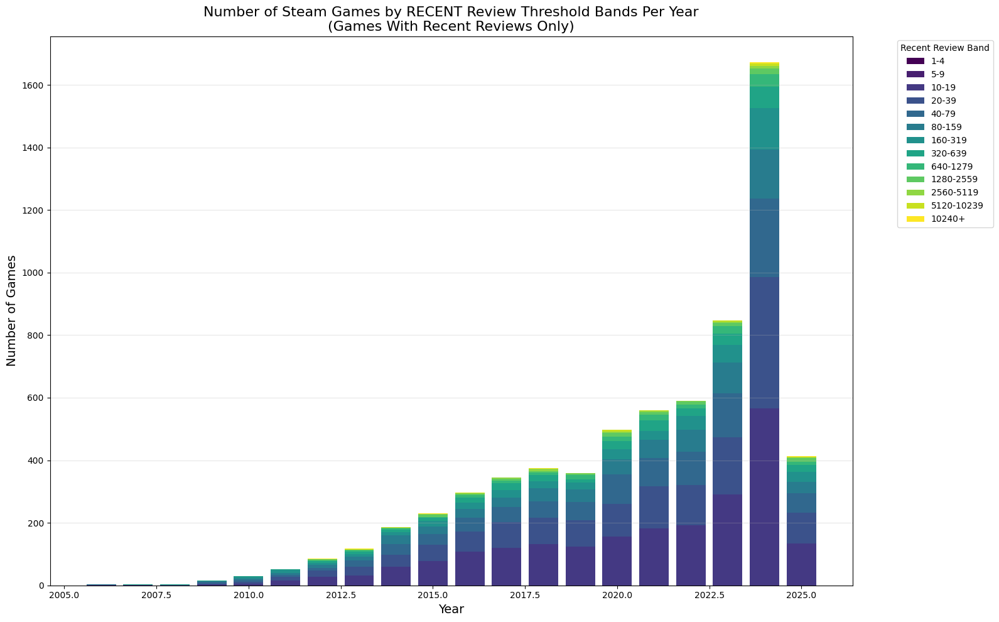

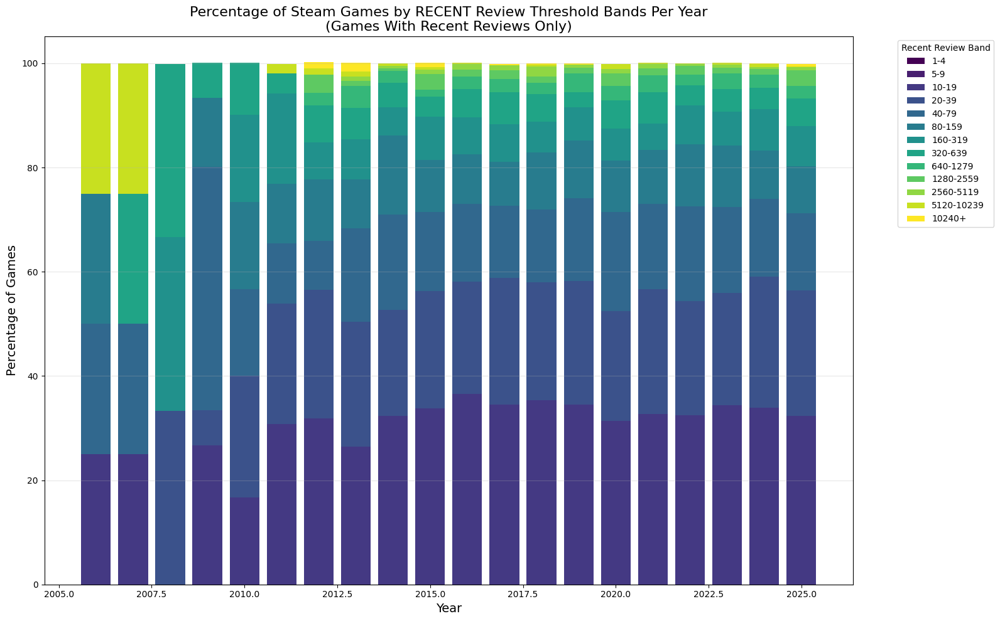

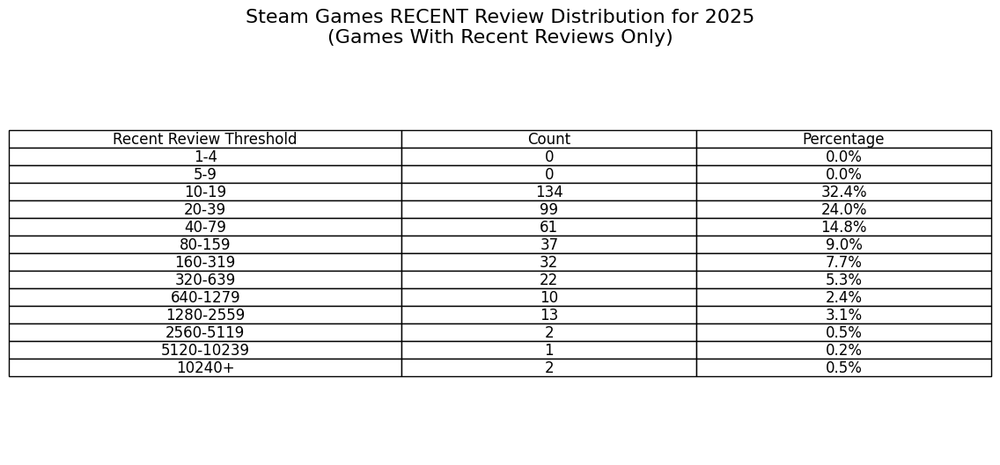

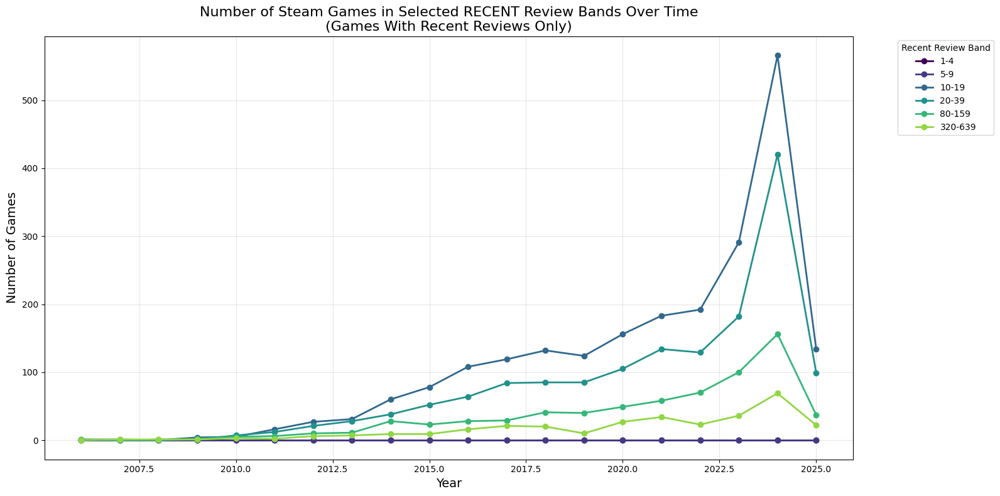

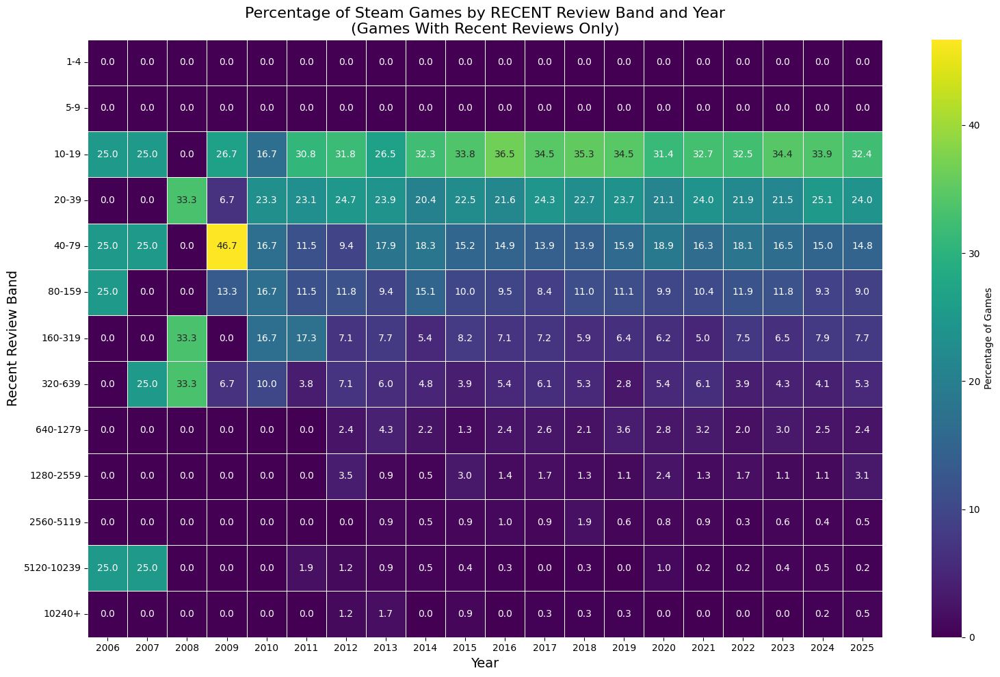

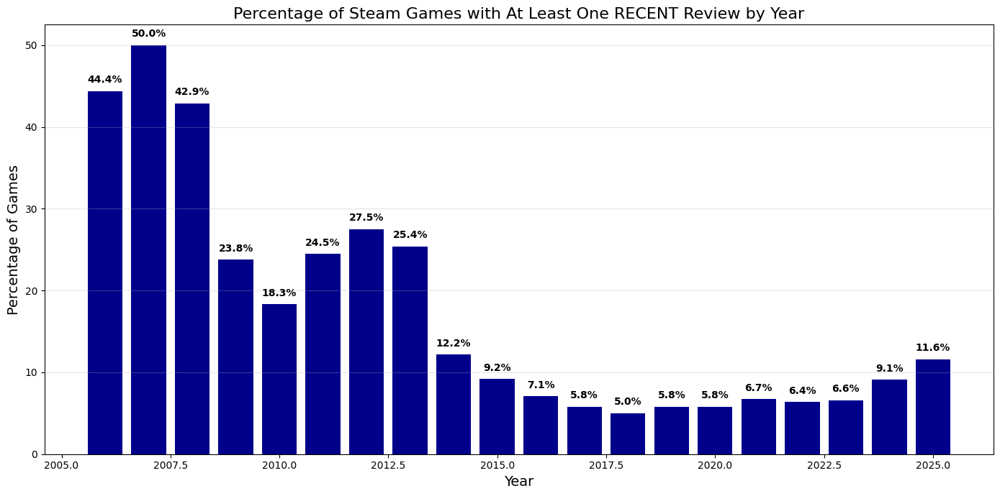

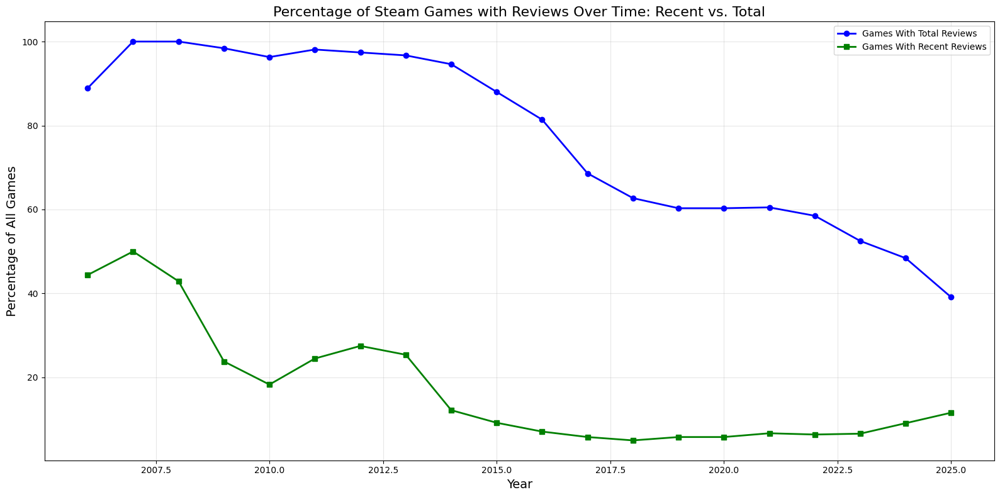

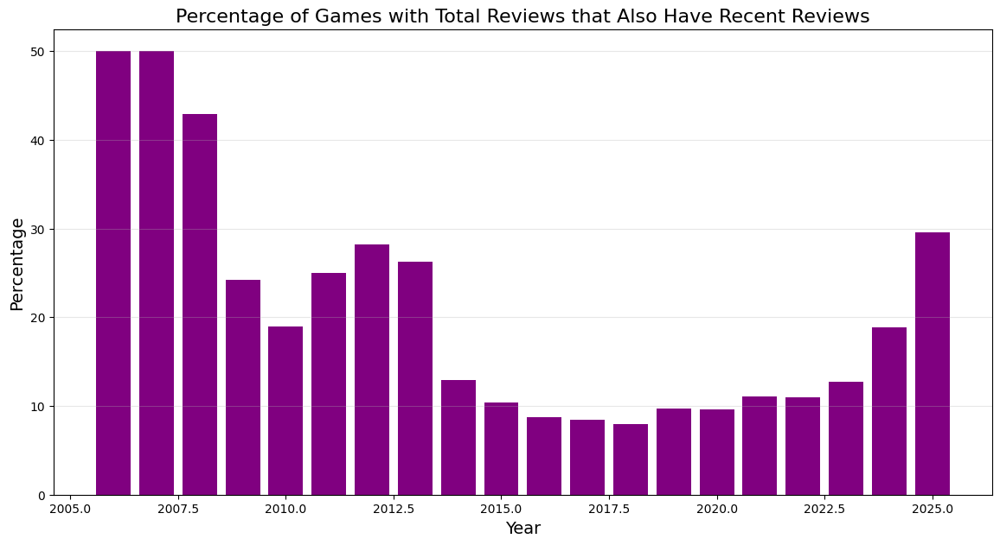

In [14]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the actual Steam dataset
print("Loading real Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Determine which column to use for recent review counts
recent_review_col = 'num_reviews_recent' if 'num_reviews_recent' in df.columns else None
if recent_review_col is None:
    review_columns = [col for col in df.columns if 'review' in col.lower() and 'recent' in col.lower()]
    for col in review_columns:
        if pd.api.types.is_numeric_dtype(df[col]):
            recent_review_col = col
            break

if recent_review_col:
    print(f"Using {recent_review_col} for recent review count analysis")
else:
    print("ERROR: Could not find a suitable recent review count column")
    # Last resort fallback
    numeric_cols = [col for col in df.columns if pd.api.types.is_numeric_dtype(df[col])]
    recent_review_col = numeric_cols[0] if numeric_cols else df.columns[0]
    print(f"Last resort fallback to {recent_review_col}")

# Find and process release date column
date_col = None
for col in df.columns:
    if 'date' in col.lower() or 'release' in col.lower():
        date_col = col
        break

if date_col:
    print(f"Using {date_col} for release date information")
    try:
        df['release_date'] = pd.to_datetime(df[date_col], errors='coerce')
    except:
        print(f"Could not convert {date_col} to datetime. Creating placeholder dates...")
        df['release_date'] = pd.to_datetime('2015-01-01')
else:
    print("No date column found. Creating placeholder dates...")
    df['release_date'] = pd.to_datetime('2015-01-01')

# Extract year for analysis
df['year'] = df['release_date'].dt.year

# Count all games by year before filtering
total_games_by_year = df.groupby('year').size()
print("\nTotal games by year before filtering:")
print(total_games_by_year)

# FILTER OUT games with no recent reviews (0 or negative values)
print(f"\nTotal games before filtering: {len(df)}")
df_with_recent_reviews = df[df[recent_review_col] > 0]
print(f"Games with at least 1 recent review: {len(df_with_recent_reviews)}")
print(f"Games removed (no recent reviews): {len(df) - len(df_with_recent_reviews)}")

# Define the recent review thresholds we want to analyze (starting from 1)
review_thresholds = [1, 5, 10, 20, 40, 80, 160, 320, 640, 1280, 2560, 5120, 10240]

# Create a function to count games in each threshold band per year
def count_games_by_threshold_bands(data, thresholds, review_col):
    """
    Count games in each review threshold band for each year
    Returns a DataFrame with years as rows and threshold bands as columns
    """
    # Group by year
    years = sorted(data['year'].dropna().unique())
    
    # Initialize results DataFrame
    result = pd.DataFrame(index=years)
    
    # For each year, count games in each threshold band
    for year in years:
        year_data = data[data['year'] == year]
        total_games = len(year_data)
        result.loc[year, 'total'] = total_games
        
        # Count games in each threshold band
        for i in range(len(thresholds)-1):
            lower = thresholds[i]
            upper = thresholds[i+1] - 1  # Up to but not including the next threshold
            band_count = sum((year_data[review_col] >= lower) & (year_data[review_col] <= upper))
            result.loc[year, f'{lower}-{upper}'] = band_count
        
        # Count games with reviews >= the highest threshold
        highest = thresholds[-1]
        result.loc[year, f'{highest}+'] = sum(year_data[review_col] >= highest)
    
    return result

# Create the threshold bands DataFrame using only games with recent reviews
threshold_bands_df = count_games_by_threshold_bands(df_with_recent_reviews, review_thresholds, recent_review_col)

# Fill NaNs with 0
threshold_bands_df = threshold_bands_df.fillna(0)

# Convert to integers
for col in threshold_bands_df.columns:
    threshold_bands_df[col] = threshold_bands_df[col].astype(int)

# Filter to reasonable years (2006 or later for Steam)
valid_years = [year for year in threshold_bands_df.index if 2006 <= year <= 2025]
threshold_bands_df = threshold_bands_df.loc[valid_years]

# Create an additional DataFrame with percentages
percentage_df = threshold_bands_df.copy()
for col in percentage_df.columns:
    if col != 'total':
        percentage_df[col] = (percentage_df[col] / percentage_df['total'] * 100).round(1)

# Display the threshold bands DataFrame
print("\nNumber of games by RECENT review threshold bands per year (games with recent reviews only):")
print(threshold_bands_df)

# Display the percentage DataFrame
print("\nPercentage of games by RECENT review threshold bands per year (games with recent reviews only):")
print(percentage_df)

# Calculate what percentage of total games per year have recent reviews
games_with_recent_reviews_by_year = threshold_bands_df['total']
percent_with_recent_reviews = pd.DataFrame({
    'Total Games': [total_games_by_year.get(year, 0) for year in valid_years],
    'Games With Recent Reviews': games_with_recent_reviews_by_year,
})
percent_with_recent_reviews['Percent With Recent Reviews'] = (
    percent_with_recent_reviews['Games With Recent Reviews'] / percent_with_recent_reviews['Total Games'] * 100
).round(1)

print("\nPercentage of games with at least one recent review by year:")
print(percent_with_recent_reviews)

# Visualizations
# 1. Stacked bar chart showing absolute counts
plt.figure(figsize=(16, 10))

# Get all columns except 'total' for stacking
stack_columns = [col for col in threshold_bands_df.columns if col != 'total']

# Create a colormap using viridis gradient
cmap = plt.cm.viridis
colors = list(cmap(np.linspace(0, 1, len(stack_columns))))

# Plot stacked bars
bottom = np.zeros(len(threshold_bands_df))
for i, col in enumerate(stack_columns):
    plt.bar(threshold_bands_df.index, threshold_bands_df[col], bottom=bottom, 
            label=col, color=colors[i])
    bottom += threshold_bands_df[col]

plt.title('Number of Steam Games by RECENT Review Threshold Bands Per Year\n(Games With Recent Reviews Only)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Games', fontsize=14)
plt.legend(title='Recent Review Band', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# 2. Stacked percentage chart
plt.figure(figsize=(16, 10))

# Plot stacked percentage bars
bottom = np.zeros(len(percentage_df))
for i, col in enumerate(stack_columns):
    plt.bar(percentage_df.index, percentage_df[col], bottom=bottom, 
            label=col, color=colors[i])
    bottom += percentage_df[col]

plt.title('Percentage of Steam Games by RECENT Review Threshold Bands Per Year\n(Games With Recent Reviews Only)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Percentage of Games', fontsize=14)
plt.legend(title='Recent Review Band', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# 3. Table visualization for the latest year
latest_year = threshold_bands_df.index.max()
latest_data = threshold_bands_df.loc[latest_year].copy()
latest_percentages = percentage_df.loc[latest_year].copy()

# Create a DataFrame for the table
table_data = pd.DataFrame({
    'Recent Review Threshold': stack_columns,
    'Count': [latest_data[col] for col in stack_columns],
    'Percentage': [latest_percentages[col] for col in stack_columns]
})

plt.figure(figsize=(12, 6))
plt.axis('off')
plt.title(f'Steam Games RECENT Review Distribution for {latest_year}\n(Games With Recent Reviews Only)', fontsize=16)

# Create table
cell_text = []
for row in range(len(table_data)):
    cell_text.append([
        table_data['Recent Review Threshold'].iloc[row],
        f"{table_data['Count'].iloc[row]:,}",
        f"{table_data['Percentage'].iloc[row]:.1f}%"
    ])

table = plt.table(
    cellText=cell_text,
    colLabels=['Recent Review Threshold', 'Count', 'Percentage'],
    loc='center',
    cellLoc='center',
    colWidths=[0.4, 0.3, 0.3]
)
table.auto_set_font_size(False)
table.set_fontsize(12)
table.scale(1.2, 1.2)

# 4. Line chart of different recent review thresholds over time
plt.figure(figsize=(16, 8))

# Plot trends for selected thresholds
selected_thresholds = ['1-4', '5-9', '10-19', '20-39', '80-159', '320-639', '1280+']
colors = plt.cm.viridis(np.linspace(0, 1, len(selected_thresholds)))

for i, threshold in enumerate(selected_thresholds):
    if threshold in threshold_bands_df.columns:
        plt.plot(threshold_bands_df.index, threshold_bands_df[threshold], 
                 label=threshold, color=colors[i], linewidth=2, marker='o')

plt.title('Number of Steam Games in Selected RECENT Review Bands Over Time\n(Games With Recent Reviews Only)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Games', fontsize=14)
plt.grid(True, alpha=0.3)
plt.legend(title='Recent Review Band', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()

# 5. Heatmap showing the percentage distribution by year
plt.figure(figsize=(16, 10))

# Select only the band columns
band_columns = [col for col in percentage_df.columns if col != 'total']

# Create the heatmap data
heatmap_data = percentage_df[band_columns].T  # Transpose to have years as columns

sns.heatmap(heatmap_data, cmap='viridis', annot=True, fmt='.1f', 
            linewidths=.5, cbar_kws={'label': 'Percentage of Games'})
plt.title('Percentage of Steam Games by RECENT Review Band and Year\n(Games With Recent Reviews Only)', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Recent Review Band', fontsize=14)
plt.tight_layout()

# 6. Plot showing the percentage of games with at least one recent review by year
plt.figure(figsize=(14, 7))
plt.bar(percent_with_recent_reviews.index, percent_with_recent_reviews['Percent With Recent Reviews'], color='darkblue')
plt.title('Percentage of Steam Games with At Least One RECENT Review by Year', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Percentage of Games', fontsize=14)
plt.grid(True, axis='y', alpha=0.3)

# Add percentage labels on top of bars
for i, row in percent_with_recent_reviews.iterrows():
    plt.text(i, row['Percent With Recent Reviews'] + 1, f"{row['Percent With Recent Reviews']}%", 
             ha='center', fontweight='bold')

plt.tight_layout()

# 7. Compare recent reviews vs. total reviews (if total reviews column exists)
total_review_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None
if total_review_col:
    # Count games with at least one total review by year
    df_with_total_reviews = df[df[total_review_col] > 0]
    games_with_total_reviews_by_year = df_with_total_reviews.groupby('year').size()
    
    # Create comparison DataFrame
    comparison_df = pd.DataFrame({
        'Total Games': [total_games_by_year.get(year, 0) for year in valid_years],
        'Games With Total Reviews': [games_with_total_reviews_by_year.get(year, 0) for year in valid_years],
        'Games With Recent Reviews': [games_with_recent_reviews_by_year.get(year, 0) for year in valid_years],
    })
    
    # Calculate percentages
    comparison_df['Percent With Total Reviews'] = (
        comparison_df['Games With Total Reviews'] / comparison_df['Total Games'] * 100
    ).round(1)
    comparison_df['Percent With Recent Reviews'] = (
        comparison_df['Games With Recent Reviews'] / comparison_df['Total Games'] * 100
    ).round(1)
    
    # Calculate what percentage of games with total reviews also have recent reviews
    comparison_df['Percent of Reviewed Games With Recent Reviews'] = (
        comparison_df['Games With Recent Reviews'] / comparison_df['Games With Total Reviews'] * 100
    ).fillna(0).round(1)
    
    # Display comparison
    print("\nComparison of games with recent vs. total reviews:")
    print(comparison_df)
    
    # Plot comparison
    plt.figure(figsize=(16, 8))
    
    plt.plot(valid_years, comparison_df['Percent With Total Reviews'], 
             label='Games With Total Reviews', color='blue', linewidth=2, marker='o')
    plt.plot(valid_years, comparison_df['Percent With Recent Reviews'], 
             label='Games With Recent Reviews', color='green', linewidth=2, marker='s')
    
    plt.title('Percentage of Steam Games with Reviews Over Time: Recent vs. Total', fontsize=16)
    plt.xlabel('Year', fontsize=14)
    plt.ylabel('Percentage of All Games', fontsize=14)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    
    # Plot the percentage of games with total reviews that also have recent reviews
    plt.figure(figsize=(14, 7))
    
    plt.bar(valid_years, comparison_df['Percent of Reviewed Games With Recent Reviews'], color='purple')
    plt.title('Percentage of Games with Total Reviews that Also Have Recent Reviews', fontsize=16)
    plt.xlabel('Year', fontsize=14)
    plt.ylabel('Percentage', fontsize=14)
    plt.grid(True, axis='y', alpha=0.3)
    
    # Add percentage labels on top of bars
    for i, year in enumerate(valid_years):
        value = comparison_df.loc[year, 'Percent of Reviewed Games With Recent Reviews']
        plt.text(year, value + 1, f"{value:.1f}%", ha='center', fontweight='bold')
    
    plt.tight_layout()

plt.show()

# Export the data to CSV for further analysis
threshold_bands_df.to_csv('steam_recent_review_threshold_counts.csv')
percentage_df.to_csv('steam_recent_review_threshold_percentages.csv')
percent_with_recent_reviews.to_csv('steam_percent_with_recent_reviews_by_year.csv')

print("\nData exported to CSV files for further analysis")

# Serious developers

Loading real Steam dataset...
Dataset loaded successfully with 89618 records

Using these columns for analysis:
- Total reviews: num_reviews_total
- Recent reviews: num_reviews_recent
- Developers: developers

Checking data types:
num_reviews_total: int64
num_reviews_recent: int64
developers: object

Checking for multiple developers in single entries...
Found entries with multiple developers. Extracting primary developer.
Dataset after cleaning developer information: 89618 records
Successfully extracted year from release_date

Total unique developers: 55901
Top 10 developers by number of games:
primary_developer
[]                              221
['EroticGamesClub']             196
['Choice of Games']             158
['Laush Dmitriy Sergeevich']    138
['Boogygames Studios']          133
['Creobit']                     116
['Hosted Games']                106
['KOEI TECMO GAMES CO.          106
['Gamesforgames']               105
['Sokpop Collective']            95
Name: count, dtype: 

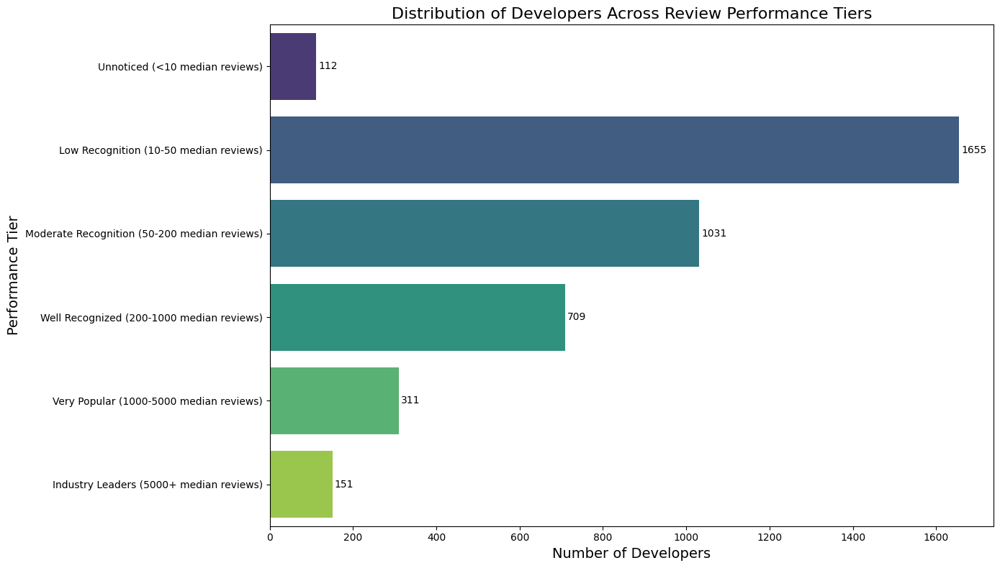

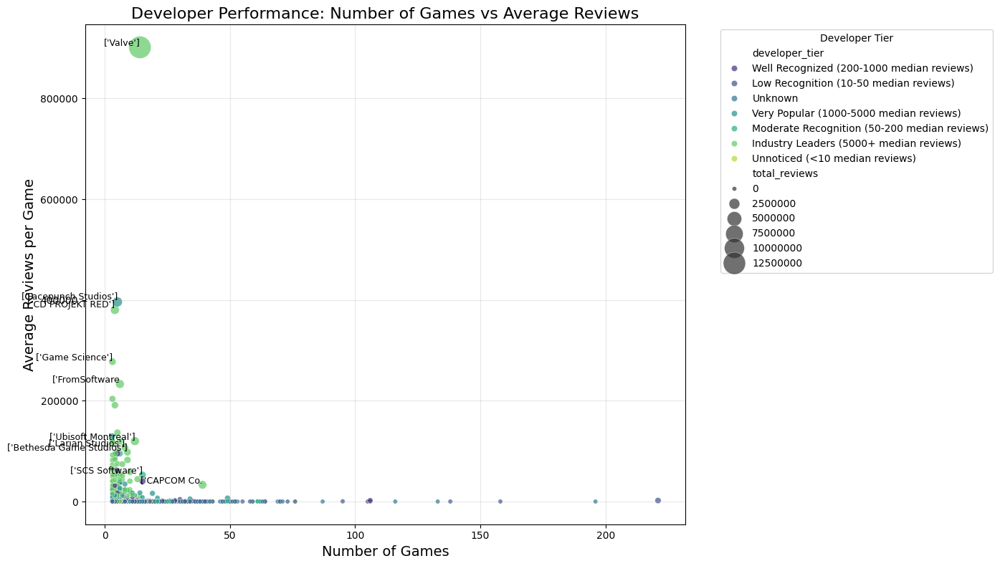

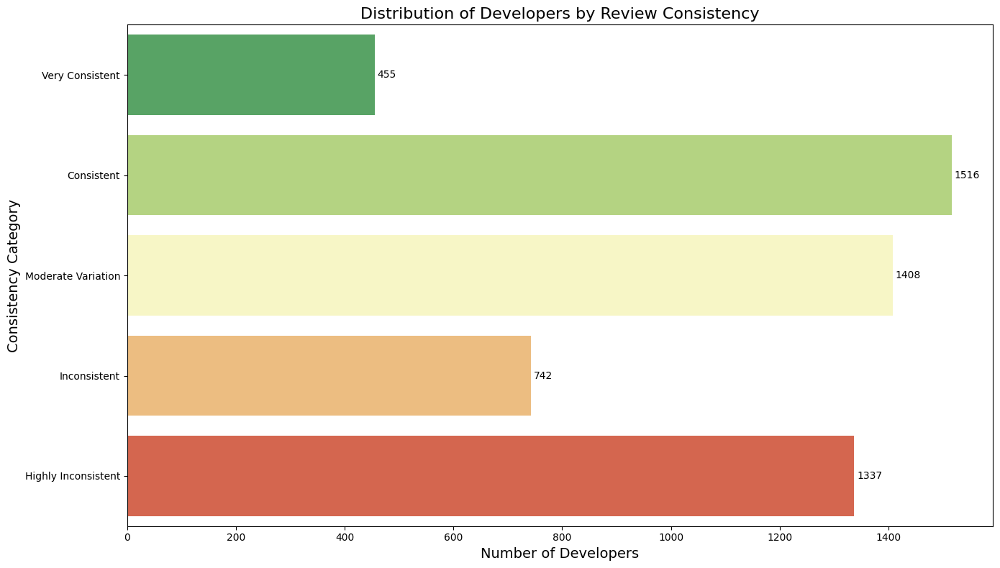

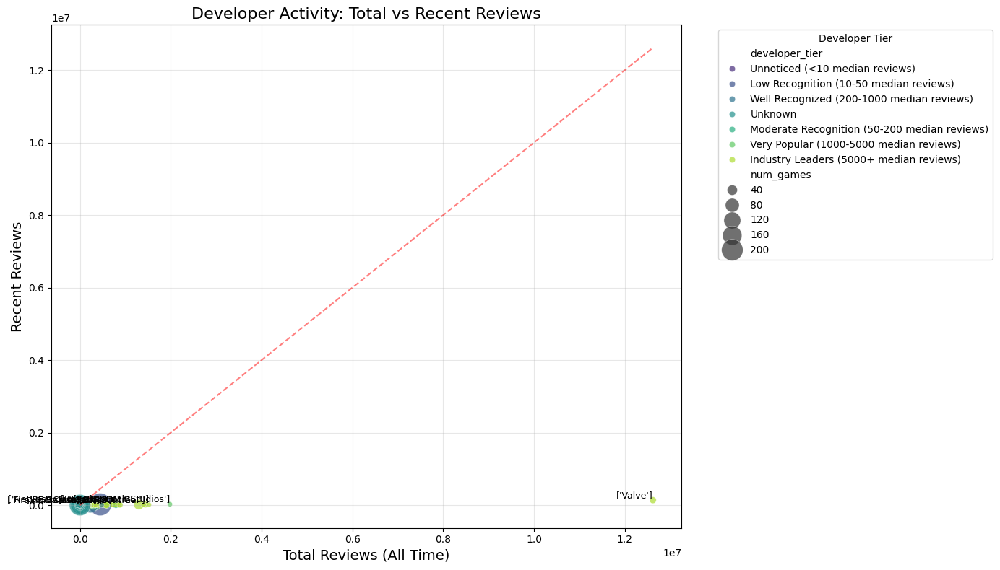

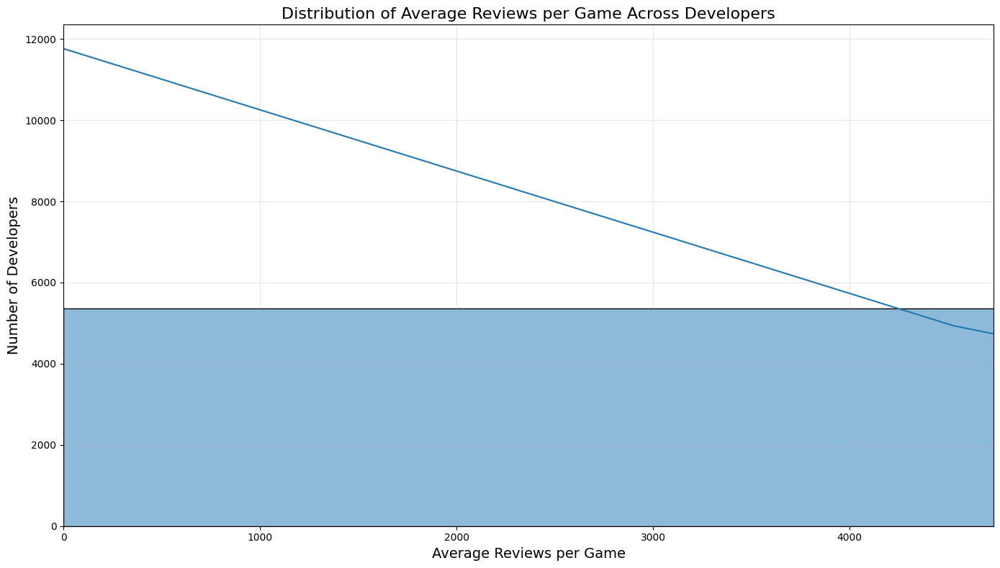

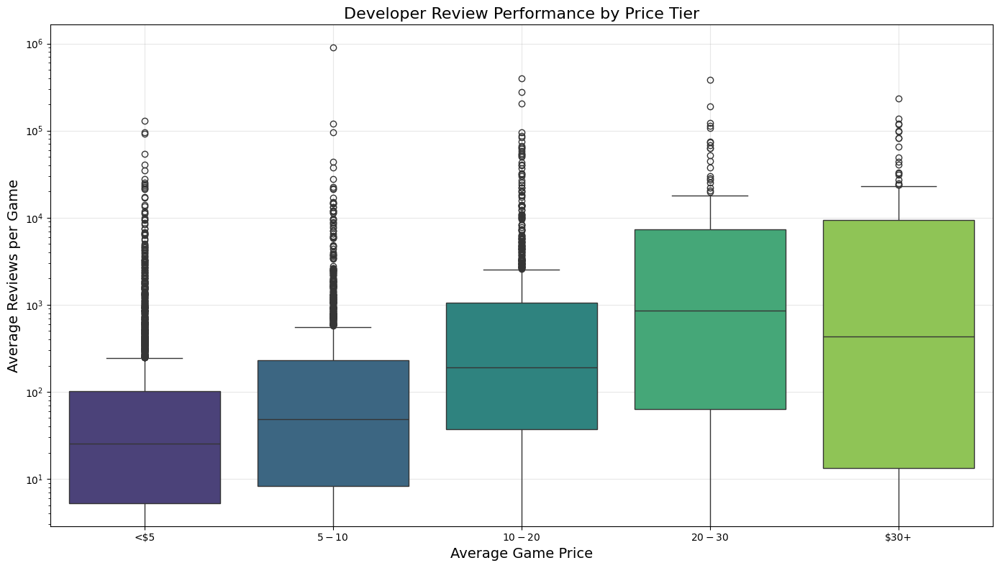

In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
import warnings
from collections import Counter

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the actual Steam dataset
print("Loading real Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Confirm the key columns we'll be using
review_count_col = 'num_reviews_total'
recent_review_col = 'num_reviews_recent'
developer_col = 'developers'

print(f"\nUsing these columns for analysis:")
print(f"- Total reviews: {review_count_col}")
print(f"- Recent reviews: {recent_review_col}")
print(f"- Developers: {developer_col}")

# Check the types of our main columns
print("\nChecking data types:")
for col in [review_count_col, recent_review_col, developer_col]:
    if col in df.columns:
        print(f"{col}: {df[col].dtype}")
    else:
        print(f"{col}: Not found in dataset")

# Ensure the developer column exists
if developer_col not in df.columns:
    print(f"ERROR: {developer_col} column not found. Available columns:")
    print(df.columns.tolist())
    developer_col = 'publishers'  # Fallback to publishers if developers not available
    print(f"Falling back to {developer_col}")

# Ensure developer column is a string
df[developer_col] = df[developer_col].astype(str)

# Handle multiple developers in a single cell
print("\nChecking for multiple developers in single entries...")
if df[developer_col].str.contains(',').any() or df[developer_col].str.contains(';').any():
    print("Found entries with multiple developers. Extracting primary developer.")
    # Take the first developer mentioned
    df['primary_developer'] = df[developer_col].str.split('[,;]').str[0].str.strip()
else:
    df['primary_developer'] = df[developer_col]

# Remove entries where developer is missing or invalid
df = df[~(df['primary_developer'].isna() | 
          (df['primary_developer'] == '') | 
          (df['primary_developer'].str.lower() == 'nan') |
          (df['primary_developer'].str.lower() == 'none'))]

print(f"Dataset after cleaning developer information: {len(df)} records")

# Extract year from release_date
try:
    df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
    df['year'] = df['release_date'].dt.year
    print("Successfully extracted year from release_date")
except Exception as e:
    print(f"Error extracting year from release_date: {e}")
    print("Creating placeholder years...")
    # Create placeholder years based on appid (newer games tend to have higher appids)
    if 'appid' in df.columns:
        df['appid'] = pd.to_numeric(df['appid'], errors='coerce')
        df['year'] = 2010 + (df['appid'] - df['appid'].min()) / (df['appid'].max() - df['appid'].min()) * 15
        df['year'] = df['year'].astype(int)
    else:
        df['year'] = 2015  # Default year if all else fails

# Basic statistics about developers
dev_counts = df['primary_developer'].value_counts()
print(f"\nTotal unique developers: {len(dev_counts)}")
print(f"Top 10 developers by number of games:")
print(dev_counts.head(10))

# Calculate statistics for each developer manually rather than using the function
print("\nCalculating review statistics by developer...")

# Group by primary_developer
dev_groups = df.groupby('primary_developer')

# Calculate basic statistics for each developer
dev_stats = pd.DataFrame({
    'num_games': dev_groups.size(),
    'avg_reviews_per_game': dev_groups[review_count_col].mean(),
    'median_reviews_per_game': dev_groups[review_count_col].median(),
    'std_dev_reviews': dev_groups[review_count_col].std(),
    'min_reviews': dev_groups[review_count_col].min(),
    'max_reviews': dev_groups[review_count_col].max(),
    'total_reviews': dev_groups[review_count_col].sum(),
    'first_game_year': dev_groups['year'].min(),
    'latest_game_year': dev_groups['year'].max()
})

# Calculate additional metrics
dev_stats['years_active'] = dev_stats['latest_game_year'] - dev_stats['first_game_year'] + 1
dev_stats['games_per_year'] = dev_stats['num_games'] / dev_stats['years_active']
dev_stats['reviews_per_year'] = dev_stats['total_reviews'] / dev_stats['years_active']

# Fix any inf/NaN values
for col in dev_stats.columns:
    if dev_stats[col].dtype == 'float64':
        dev_stats[col] = dev_stats[col].replace([np.inf, -np.inf], np.nan)
        dev_stats[col] = dev_stats[col].fillna(0)

# Filter to developers with at least 3 games
dev_total_review_stats = dev_stats[dev_stats['num_games'] >= 3].copy()
print(f"Calculated total review statistics for {len(dev_total_review_stats)} developers with 3+ games")

# Calculate the same stats for recent reviews
dev_recent_stats = pd.DataFrame({
    'num_games': dev_groups.size(),
    'avg_recent_reviews_per_game': dev_groups[recent_review_col].mean(),
    'median_recent_reviews_per_game': dev_groups[recent_review_col].median(),
    'total_recent_reviews': dev_groups[recent_review_col].sum()
})

# Fix any inf/NaN values
for col in dev_recent_stats.columns:
    if dev_recent_stats[col].dtype == 'float64':
        dev_recent_stats[col] = dev_recent_stats[col].replace([np.inf, -np.inf], np.nan)
        dev_recent_stats[col] = dev_recent_stats[col].fillna(0)

# Filter to developers with at least 3 games
dev_recent_review_stats = dev_recent_stats[dev_recent_stats['num_games'] >= 3].copy()
print(f"Calculated recent review statistics for {len(dev_recent_review_stats)} developers with 3+ games")

# Analyze developers with games having zero reviews
zero_review_games = df[df[review_count_col] <= 0]
dev_zero_reviews = zero_review_games.groupby('primary_developer').size().reset_index(name='zero_review_games')

# Calculate percentage of zero review games for each developer
dev_game_counts = df.groupby('primary_developer').size().reset_index(name='total_games')
dev_zero_reviews = pd.merge(dev_zero_reviews, dev_game_counts, on='primary_developer')
dev_zero_reviews['zero_review_percent'] = (dev_zero_reviews['zero_review_games'] / 
                                          dev_zero_reviews['total_games'] * 100).round(1)

# Filter to developers with at least 3 games
dev_zero_reviews = dev_zero_reviews[dev_zero_reviews['total_games'] >= 3]
dev_zero_reviews = dev_zero_reviews.sort_values('zero_review_percent', ascending=False)

print("\nDevelopers with highest percentage of zero-review games (min 3 games):")
print(dev_zero_reviews.head(10))

# Categorize developers by their review performance
print("\nCategorizing developers by review performance...")

# Create developer tiers based on median reviews per game
median_reviews = dev_total_review_stats['median_reviews_per_game']

# Define tier boundaries
tier_thresholds = [0, 10, 50, 200, 1000, 5000, float('inf')]
tier_labels = [
    "Unnoticed (<10 median reviews)",
    "Low Recognition (10-50 median reviews)",
    "Moderate Recognition (50-200 median reviews)",
    "Well Recognized (200-1000 median reviews)",
    "Very Popular (1000-5000 median reviews)",
    "Industry Leaders (5000+ median reviews)"
]

# Create a function to assign tier
def assign_tier(value):
    for i in range(len(tier_thresholds)-1):
        if value >= tier_thresholds[i] and value < tier_thresholds[i+1]:
            return tier_labels[i]
    return "Unknown"

# Apply tier assignment
dev_total_review_stats['developer_tier'] = dev_total_review_stats['median_reviews_per_game'].apply(assign_tier)

# Count developers in each tier
tier_counts = dev_total_review_stats['developer_tier'].value_counts().reindex(tier_labels)
print("\nDeveloper distribution across tiers:")
print(tier_counts)

# Visualizations
print("\nCreating visualizations...")

# 1. Developer tier distribution
plt.figure(figsize=(14, 8))
ax = sns.countplot(y='developer_tier', data=dev_total_review_stats, 
                  order=tier_labels, palette='viridis')
plt.title('Distribution of Developers Across Review Performance Tiers', fontsize=16)
plt.xlabel('Number of Developers', fontsize=14)
plt.ylabel('Performance Tier', fontsize=14)

# Add count labels to bars
for i, count in enumerate(tier_counts):
    if not pd.isna(count):
        ax.text(count + 5, i, str(count), va='center')

plt.tight_layout()

# 2. Scatterplot of games vs reviews
plt.figure(figsize=(14, 8))
scatter = sns.scatterplot(
    x='num_games', 
    y='avg_reviews_per_game', 
    hue='developer_tier',
    size='total_reviews',
    sizes=(20, 500),
    alpha=0.7,
    palette='viridis',
    data=dev_total_review_stats
)
plt.title('Developer Performance: Number of Games vs Average Reviews', fontsize=16)
plt.xlabel('Number of Games', fontsize=14)
plt.ylabel('Average Reviews per Game', fontsize=14)
plt.grid(True, alpha=0.3)
plt.legend(title='Developer Tier', bbox_to_anchor=(1.05, 1), loc='upper left')

# Label the top developers by total reviews
top_devs = dev_total_review_stats.nlargest(10, 'total_reviews')
for idx, row in top_devs.iterrows():
    plt.text(row['num_games'], row['avg_reviews_per_game'], idx, 
            fontsize=9, ha='right', va='bottom')

plt.tight_layout()

# Analysis of developer consistency
print("\nAnalyzing developer consistency...")

# Calculate coefficient of variation (CV) as a measure of consistency
# Only calculate for developers with positive avg_reviews_per_game
mask = dev_total_review_stats['avg_reviews_per_game'] > 0
dev_total_review_stats.loc[mask, 'review_cv'] = (
    dev_total_review_stats.loc[mask, 'std_dev_reviews'] / 
    dev_total_review_stats.loc[mask, 'avg_reviews_per_game']
)

# Set CV to a high value for developers with avg_reviews_per_game == 0
dev_total_review_stats.loc[~mask, 'review_cv'] = 5.0

# Create consistency categories
cv_boundaries = [0, 0.5, 1, 1.5, 2, float('inf')]
cv_labels = ['Very Consistent', 'Consistent', 'Moderate Variation', 'Inconsistent', 'Highly Inconsistent']

def assign_consistency(value):
    for i in range(len(cv_boundaries)-1):
        if value >= cv_boundaries[i] and value < cv_boundaries[i+1]:
            return cv_labels[i]
    return 'Unknown'

dev_total_review_stats['consistency'] = dev_total_review_stats['review_cv'].apply(assign_consistency)

# Count developers in each consistency category
consistency_counts = dev_total_review_stats['consistency'].value_counts().reindex(cv_labels)
print("\nDeveloper distribution across consistency categories:")
print(consistency_counts)

# 3. Developer consistency distribution
plt.figure(figsize=(14, 8))
ax = sns.countplot(y='consistency', data=dev_total_review_stats, 
                  order=cv_labels, palette='RdYlGn_r')
plt.title('Distribution of Developers by Review Consistency', fontsize=16)
plt.xlabel('Number of Developers', fontsize=14)
plt.ylabel('Consistency Category', fontsize=14)

# Add count labels to bars
for i, count in enumerate(consistency_counts):
    if not pd.isna(count):
        ax.text(count + 5, i, str(count), va='center')

plt.tight_layout()

# Recent vs Total reviews by developer
print("\nComparing recent vs total reviews by developer...")

# Merge the dataframes
dev_comparison = pd.merge(
    dev_total_review_stats[['num_games', 'total_reviews', 'avg_reviews_per_game', 'developer_tier']],
    dev_recent_stats[['total_recent_reviews', 'avg_recent_reviews_per_game']],
    left_index=True, right_index=True
)

# Filter to valid values
dev_comparison = dev_comparison[dev_comparison['total_reviews'] > 0]

# Calculate the ratio of recent to total reviews
dev_comparison['recent_to_total_ratio'] = (
    dev_comparison['total_recent_reviews'] / dev_comparison['total_reviews']
)

# Handle any remaining inf or NaN values
dev_comparison['recent_to_total_ratio'] = dev_comparison['recent_to_total_ratio'].replace(
    [np.inf, -np.inf, np.nan], 0
)

# Sort by the ratio
dev_comparison = dev_comparison.sort_values('recent_to_total_ratio', ascending=False)

print("\nDevelopers with highest ratio of recent to total reviews (most currently active):")
print(dev_comparison.head(10)[['num_games', 'total_reviews', 
                               'total_recent_reviews', 'recent_to_total_ratio']])

print("\nDevelopers with lowest ratio of recent to total reviews (least currently active):")
print(dev_comparison.tail(10)[['num_games', 'total_reviews', 
                               'total_recent_reviews', 'recent_to_total_ratio']])

# 5. Scatter plot of total vs recent reviews
plt.figure(figsize=(14, 8))
sns.scatterplot(
    x='total_reviews', 
    y='total_recent_reviews', 
    size='num_games',
    sizes=(20, 500),
    alpha=0.7,
    hue='developer_tier',
    palette='viridis',
    data=dev_comparison
)
plt.title('Developer Activity: Total vs Recent Reviews', fontsize=16)
plt.xlabel('Total Reviews (All Time)', fontsize=14)
plt.ylabel('Recent Reviews', fontsize=14)
plt.grid(True, alpha=0.3)
plt.legend(title='Developer Tier', bbox_to_anchor=(1.05, 1), loc='upper left')

# Add a diagonal reference line (where recent = total)
max_val = max(dev_comparison['total_reviews'].max(), dev_comparison['total_recent_reviews'].max())
plt.plot([0, max_val], [0, max_val], 'r--', alpha=0.5)

# Label the top 10 developers by recent reviews
top_recent_devs = dev_comparison.nlargest(10, 'total_recent_reviews')
for idx, row in top_recent_devs.iterrows():
    plt.text(row['total_reviews'], row['total_recent_reviews'], idx, 
            fontsize=9, ha='right', va='bottom')

plt.tight_layout()

# 6. Analysis of review-to-game ratio
plt.figure(figsize=(14, 8))
sns.histplot(
    dev_total_review_stats['avg_reviews_per_game'],
    bins=50,
    kde=True,
    log_scale=(False, False)
)
plt.title('Distribution of Average Reviews per Game Across Developers', fontsize=16)
plt.xlabel('Average Reviews per Game', fontsize=14)
plt.ylabel('Number of Developers', fontsize=14)
plt.grid(True, alpha=0.3)
plt.xlim(0, dev_total_review_stats['avg_reviews_per_game'].quantile(0.95))  # Limit x axis to 95th percentile
plt.tight_layout()

# 7. Analysis of developer performance by price point (if available)
if 'price' in df.columns:
    print("\nAnalyzing developer performance by price point...")
    
    # Calculate average price by developer
    dev_price = df.groupby('primary_developer')['price'].mean().reset_index()
    dev_price = dev_price.rename(columns={'price': 'avg_price'})
    
    # Merge with developer stats
    dev_price_perf = pd.merge(
        dev_total_review_stats[['num_games', 'avg_reviews_per_game', 'developer_tier']],
        dev_price,
        left_index=True, right_on='primary_developer'
    )
    
    # Create price tiers
    price_bins = [0, 5, 10, 20, 30, float('inf')]
    price_labels = ['<$5', '$5-$10', '$10-$20', '$20-$30', '$30+']
    
    dev_price_perf['price_tier'] = pd.cut(
        dev_price_perf['avg_price'], 
        bins=price_bins, 
        labels=price_labels, 
        include_lowest=True
    )
    
    # Plot relationship between price and reviews
    plt.figure(figsize=(14, 8))
    sns.boxplot(
        x='price_tier',
        y='avg_reviews_per_game',
        data=dev_price_perf,
        palette='viridis'
    )
    plt.title('Developer Review Performance by Price Tier', fontsize=16)
    plt.xlabel('Average Game Price', fontsize=14)
    plt.ylabel('Average Reviews per Game', fontsize=14)
    plt.yscale('log')  # Log scale to see the distribution better
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

# Export data for further analysis
dev_total_review_stats.to_csv('developer_total_review_stats.csv')
print("\nExported developer total review statistics to 'developer_total_review_stats.csv'")

# Show all plots
plt.show()

Loading real Steam dataset...
Dataset loaded successfully with 89618 records

Processing developer information...
Successfully extracted year from release_date
Found 5458 developers with 3+ games
Valve not found in the developer data
Dataset after removing Valve: 5458 developers

Categorizing developers by review performance...

Developer distribution across tiers (excluding Valve):
developer_tier
Unnoticed (<10 median reviews)                   112
Low Recognition (10-50 median reviews)          1655
Moderate Recognition (50-200 median reviews)    1031
Well Recognized (200-1000 median reviews)        709
Very Popular (1000-5000 median reviews)          311
Industry Leaders (5000+ median reviews)          151
Name: count, dtype: int64


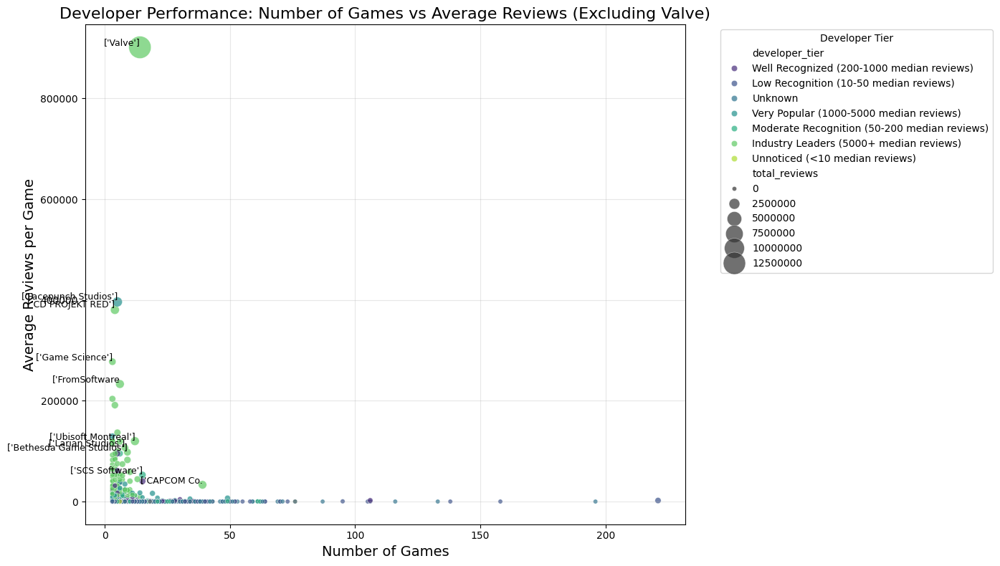

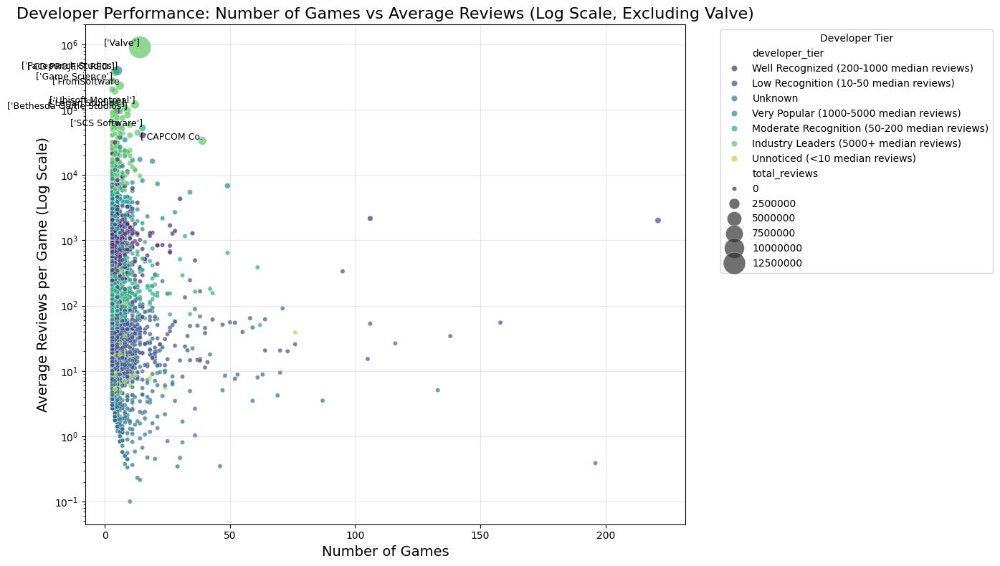

In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the actual Steam dataset
print("Loading real Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Confirm the key columns we'll be using
review_count_col = 'num_reviews_total'
recent_review_col = 'num_reviews_recent'
developer_col = 'developers'

# Ensure developer column is a string
df[developer_col] = df[developer_col].astype(str)

# Handle multiple developers in a single cell
print("\nProcessing developer information...")
if df[developer_col].str.contains(',').any() or df[developer_col].str.contains(';').any():
    # Take the first developer mentioned
    df['primary_developer'] = df[developer_col].str.split('[,;]').str[0].str.strip()
else:
    df['primary_developer'] = df[developer_col]

# Remove entries where developer is missing or invalid
df = df[~(df['primary_developer'].isna() | 
          (df['primary_developer'] == '') | 
          (df['primary_developer'].str.lower() == 'nan') |
          (df['primary_developer'].str.lower() == 'none'))]

# Extract year from release_date
try:
    df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
    df['year'] = df['release_date'].dt.year
    print("Successfully extracted year from release_date")
except Exception as e:
    print(f"Error extracting year from release_date: {e}")
    print("Creating placeholder years...")
    # Create placeholder years
    df['year'] = 2015  # Default year if all else fails

# Group by primary_developer
dev_groups = df.groupby('primary_developer')

# Calculate basic statistics for each developer
dev_stats = pd.DataFrame({
    'num_games': dev_groups.size(),
    'avg_reviews_per_game': dev_groups[review_count_col].mean(),
    'median_reviews_per_game': dev_groups[review_count_col].median(),
    'std_dev_reviews': dev_groups[review_count_col].std(),
    'total_reviews': dev_groups[review_count_col].sum(),
    'first_game_year': dev_groups['year'].min(),
    'latest_game_year': dev_groups['year'].max()
})

# Fix any inf/NaN values
for col in dev_stats.columns:
    if dev_stats[col].dtype == 'float64':
        dev_stats[col] = dev_stats[col].replace([np.inf, -np.inf], np.nan)
        dev_stats[col] = dev_stats[col].fillna(0)

# Filter to developers with at least 3 games
dev_total_review_stats = dev_stats[dev_stats['num_games'] >= 3].copy()
print(f"Found {len(dev_total_review_stats)} developers with 3+ games")

# Check if Valve is in the dataset
valve_present = False
valve_variations = ['Valve', 'Valve Corporation', 'Valve Software']
for valve_name in valve_variations:
    if valve_name in dev_total_review_stats.index:
        valve_present = True
        print(f"Found Valve as '{valve_name}' in the dataset")
        # Remove Valve from the data
        dev_total_review_stats = dev_total_review_stats.drop(valve_name)

if not valve_present:
    print("Valve not found in the developer data")

print(f"Dataset after removing Valve: {len(dev_total_review_stats)} developers")

# Categorize developers by their review performance
print("\nCategorizing developers by review performance...")

# Define tier thresholds
tier_thresholds = [0, 10, 50, 200, 1000, 5000, float('inf')]
tier_labels = [
    "Unnoticed (<10 median reviews)",
    "Low Recognition (10-50 median reviews)",
    "Moderate Recognition (50-200 median reviews)",
    "Well Recognized (200-1000 median reviews)",
    "Very Popular (1000-5000 median reviews)",
    "Industry Leaders (5000+ median reviews)"
]

# Create a function to assign tier
def assign_tier(value):
    for i in range(len(tier_thresholds)-1):
        if value >= tier_thresholds[i] and value < tier_thresholds[i+1]:
            return tier_labels[i]
    return "Unknown"

# Apply tier assignment
dev_total_review_stats['developer_tier'] = dev_total_review_stats['median_reviews_per_game'].apply(assign_tier)

# Count developers in each tier
tier_counts = dev_total_review_stats['developer_tier'].value_counts().reindex(tier_labels)
print("\nDeveloper distribution across tiers (excluding Valve):")
print(tier_counts)

# Create the scatter plot (without Valve)
plt.figure(figsize=(14, 8))
scatter = sns.scatterplot(
    x='num_games', 
    y='avg_reviews_per_game', 
    hue='developer_tier',
    size='total_reviews',
    sizes=(20, 500),
    alpha=0.7,
    palette='viridis',
    data=dev_total_review_stats
)
plt.title('Developer Performance: Number of Games vs Average Reviews (Excluding Valve)', fontsize=16)
plt.xlabel('Number of Games', fontsize=14)
plt.ylabel('Average Reviews per Game', fontsize=14)
plt.grid(True, alpha=0.3)
plt.legend(title='Developer Tier', bbox_to_anchor=(1.05, 1), loc='upper left')

# Label the top developers by total reviews
top_devs = dev_total_review_stats.nlargest(10, 'total_reviews')
for idx, row in top_devs.iterrows():
    plt.text(row['num_games'], row['avg_reviews_per_game'], idx, 
            fontsize=9, ha='right', va='bottom')

plt.tight_layout()

# Optional: Create a log-scale version of the plot for better visibility
plt.figure(figsize=(14, 8))
scatter_log = sns.scatterplot(
    x='num_games', 
    y='avg_reviews_per_game', 
    hue='developer_tier',
    size='total_reviews',
    sizes=(20, 500),
    alpha=0.7,
    palette='viridis',
    data=dev_total_review_stats
)
plt.title('Developer Performance: Number of Games vs Average Reviews (Log Scale, Excluding Valve)', fontsize=16)
plt.xlabel('Number of Games', fontsize=14)
plt.ylabel('Average Reviews per Game (Log Scale)', fontsize=14)
plt.yscale('log')  # Apply log scale to y-axis
plt.grid(True, alpha=0.3)
plt.legend(title='Developer Tier', bbox_to_anchor=(1.05, 1), loc='upper left')

# Label the top developers by total reviews
for idx, row in top_devs.iterrows():
    plt.text(row['num_games'], row['avg_reviews_per_game'], idx, 
            fontsize=9, ha='right', va='bottom')

plt.tight_layout()

# Show the plots
plt.show()

# publisher

Loading Steam dataset...
Dataset loaded successfully with 89618 records
Filtering out free-to-play games...
Dataset after filtering: 75458 paid games
Identifying self-published games...

Publishing statistics by year (paid games only):
      total_games  self_published  publisher_distributed  pct_self_published
2006            9               5                      4                55.6
2007            7               2                      5                28.6
2008            6               2                      4                33.3
2009           60              19                     41                31.7
2010          149              59                     90                39.6
2011          192              98                     94                51.0
2012          276             149                    127                54.0
2013          415             215                    200                51.8
2014         1400             757                    643               

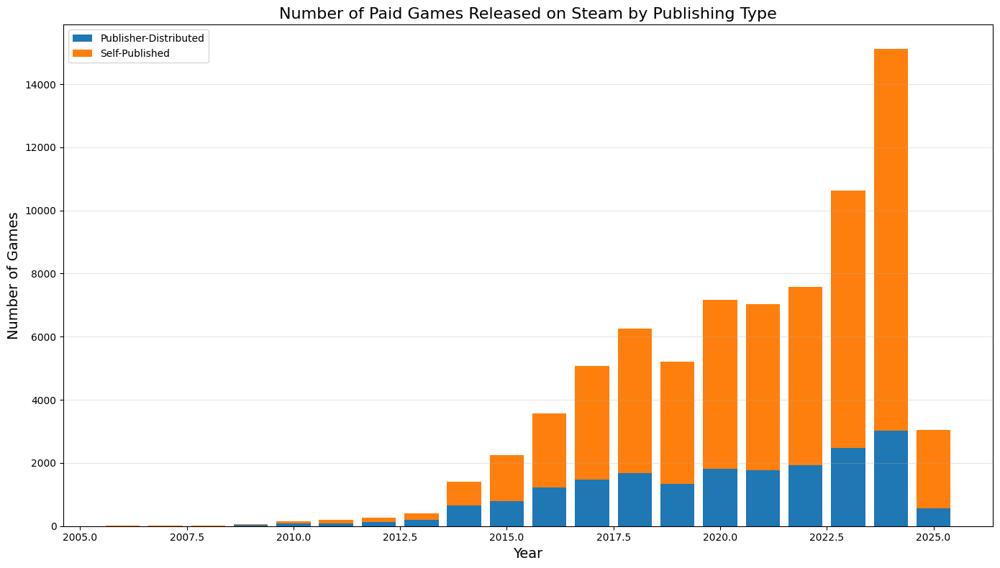

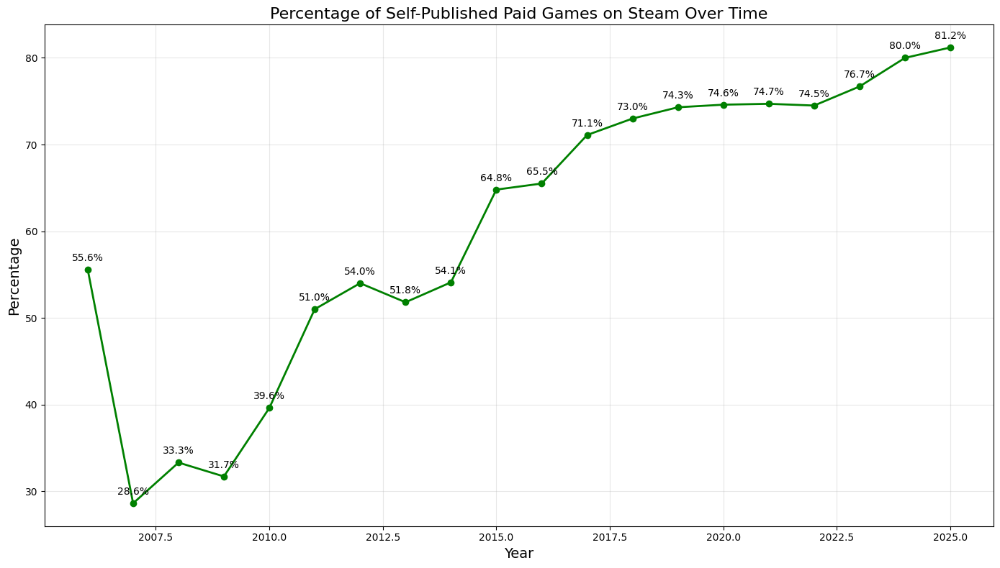

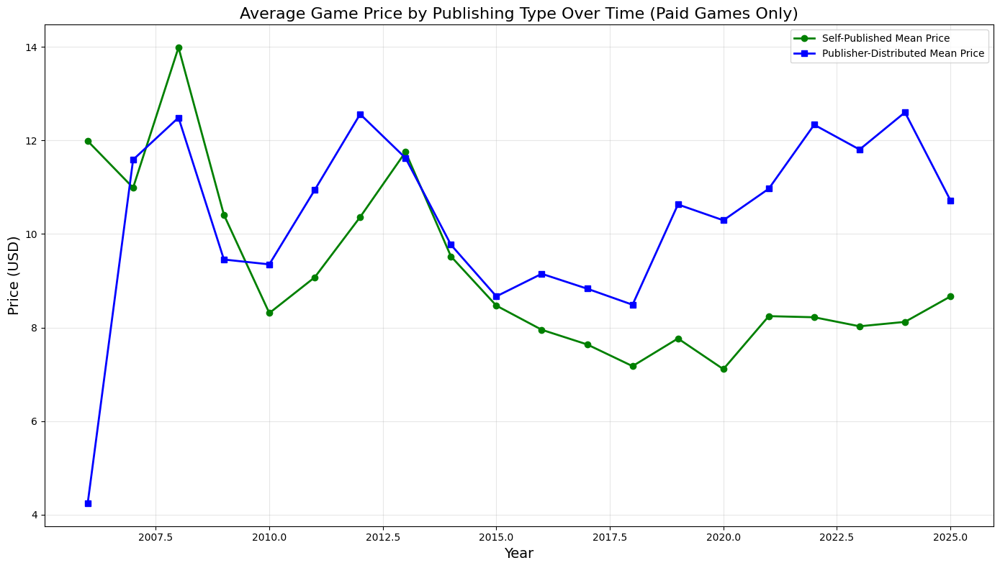

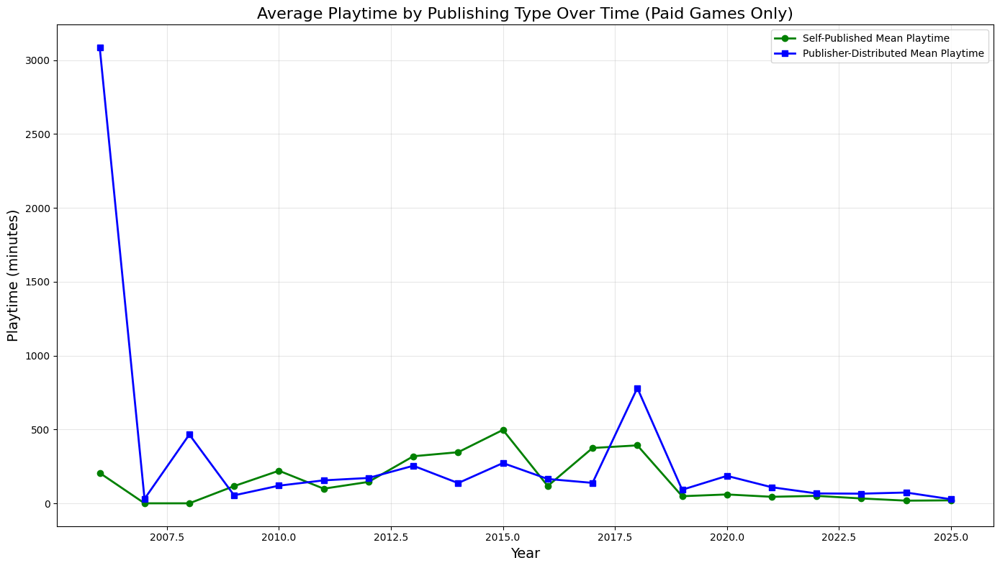

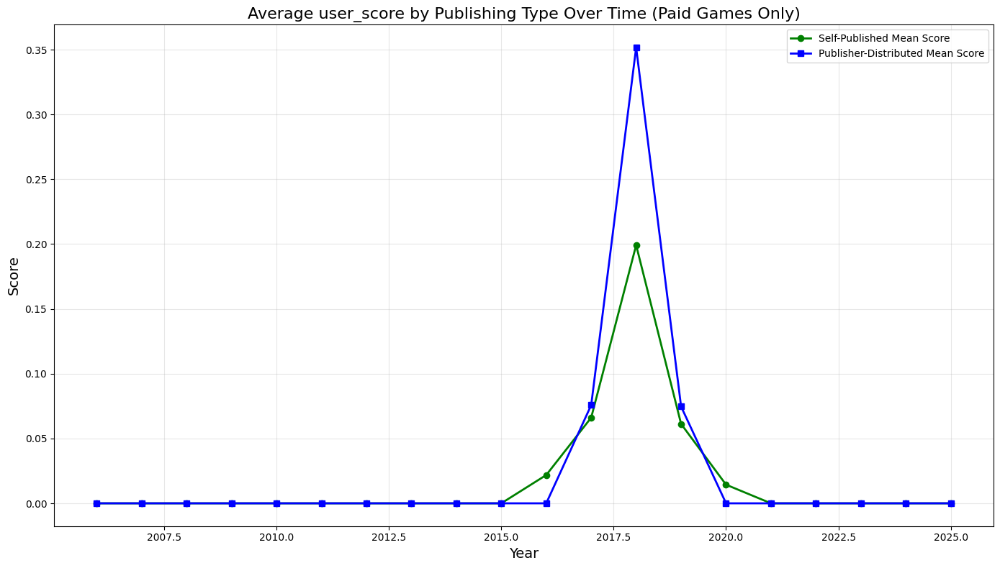

<Figure size 1600x800 with 0 Axes>

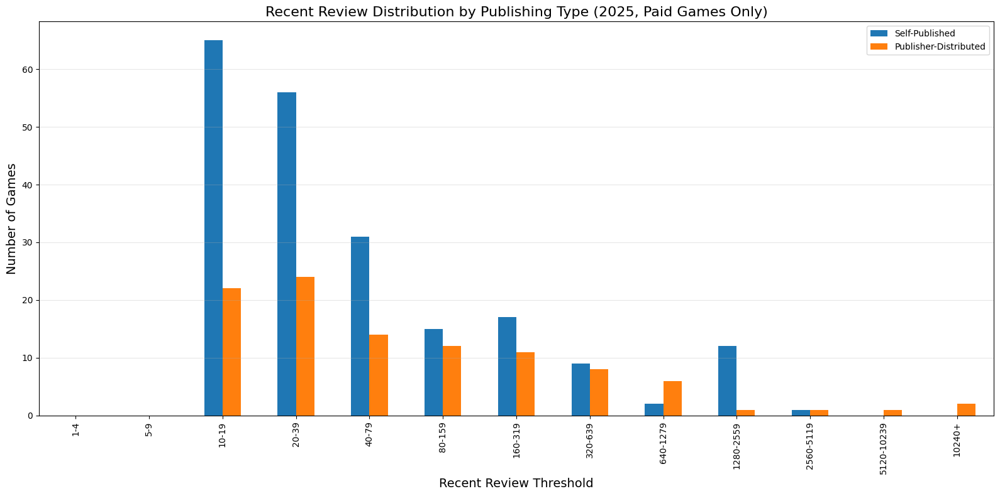

<Figure size 1600x800 with 0 Axes>

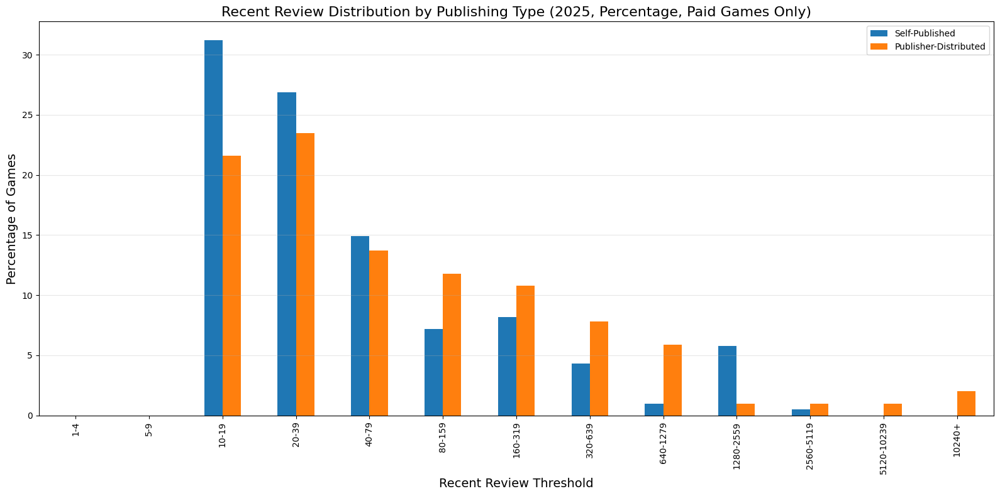

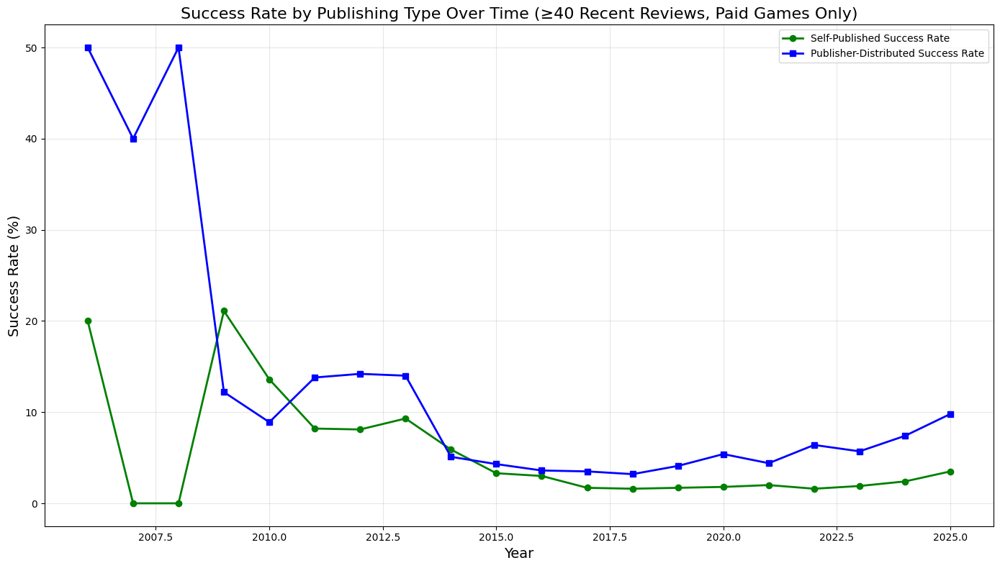

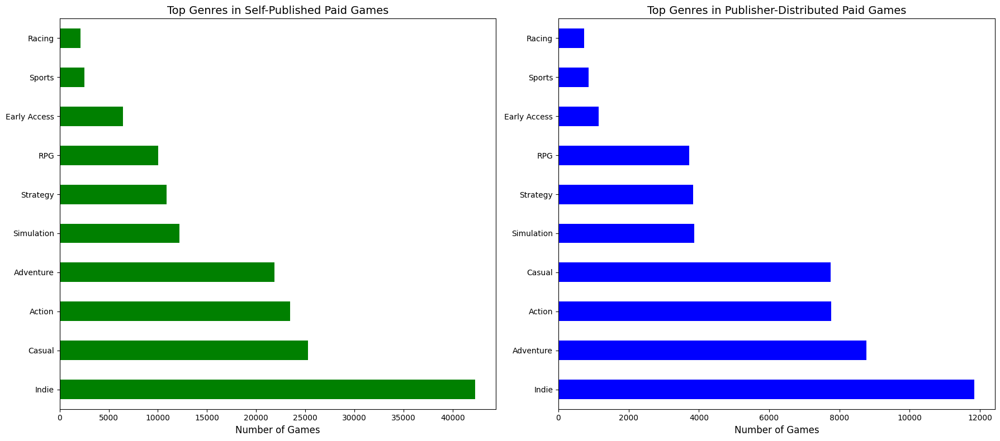

<Figure size 1600x800 with 0 Axes>

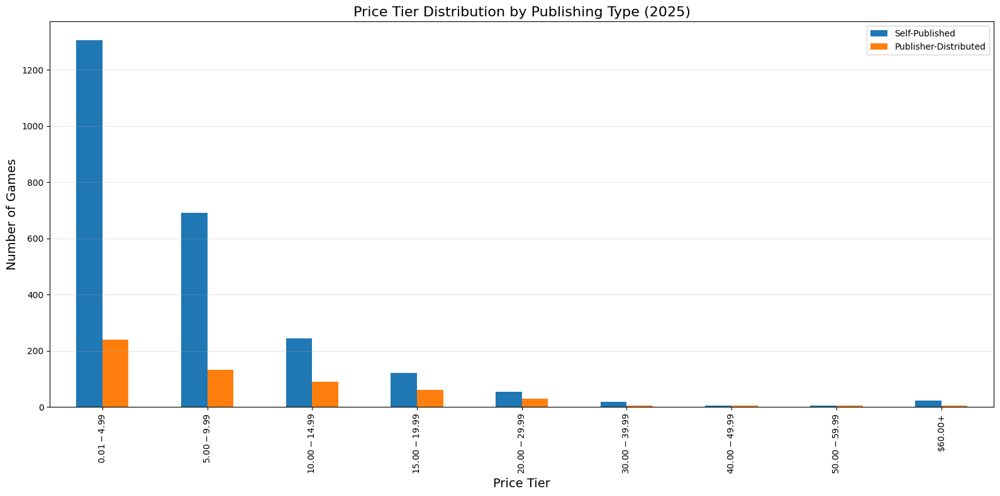

<Figure size 1600x800 with 0 Axes>

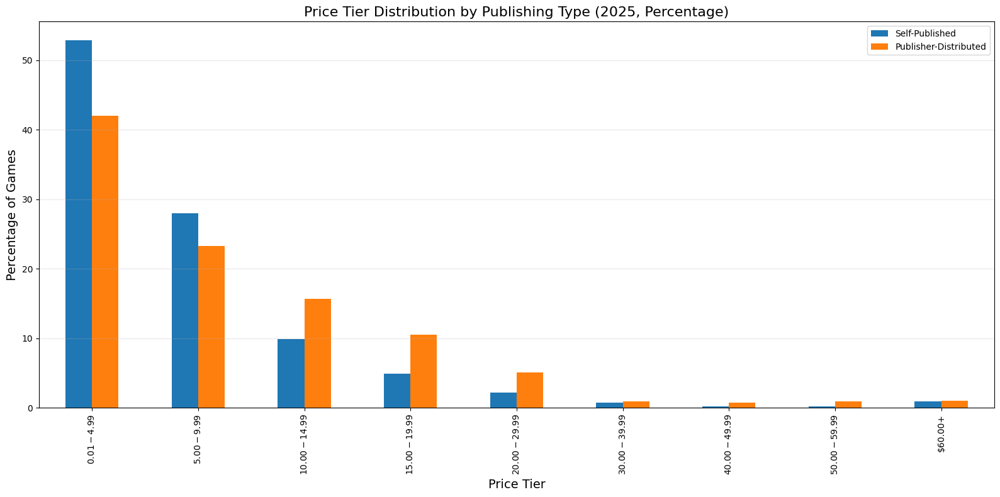

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the Steam dataset
print("Loading Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Filter out free-to-play games
print("Filtering out free-to-play games...")
df = df[df['price'] > 0]
print(f"Dataset after filtering: {len(df)} paid games")

# Convert release_date to datetime
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')

# Extract year from release date
df['year'] = df['release_date'].dt.year

# Create a function to identify self-published games
def is_self_published(row):
    """
    Check if a game is self-published by comparing developers and publishers.
    Returns True if any developer is also a publisher.
    """
    developers = row['developers']
    publishers = row['publishers']
    
    # Handle missing values
    if pd.isna(developers) or pd.isna(publishers):
        return False
    
    # Convert string representations of lists to actual lists
    if isinstance(developers, str):
        if developers.startswith('[') and developers.endswith(']'):
            try:
                developers = eval(developers)
            except:
                developers = [developers]
        else:
            developers = [developers]
            
    if isinstance(publishers, str):
        if publishers.startswith('[') and publishers.endswith(']'):
            try:
                publishers = eval(publishers)
            except:
                publishers = [publishers]
        else:
            publishers = [publishers]
    
    # Check for overlap between developers and publishers
    if isinstance(developers, list) and isinstance(publishers, list):
        return any(dev in publishers for dev in developers)
    
    return False

# Apply the function to create a self-published flag
print("Identifying self-published games...")
df['is_self_published'] = df.apply(is_self_published, axis=1)

# Count all games by year
total_games_by_year = df.groupby('year').size()

# Count self-published and publisher-distributed games by year
self_pub_by_year = df[df['is_self_published']].groupby('year').size()
publisher_by_year = df[~df['is_self_published']].groupby('year').size()

# Calculate percentage of self-published games each year
valid_years = sorted([year for year in total_games_by_year.index if 2006 <= year <= 2025])
publishing_stats = pd.DataFrame(index=valid_years)
publishing_stats['total_games'] = [total_games_by_year.get(year, 0) for year in valid_years]
publishing_stats['self_published'] = [self_pub_by_year.get(year, 0) for year in valid_years]
publishing_stats['publisher_distributed'] = [publisher_by_year.get(year, 0) for year in valid_years]
publishing_stats['pct_self_published'] = np.round((publishing_stats['self_published'] / publishing_stats['total_games'] * 100), 1)

print("\nPublishing statistics by year (paid games only):")
print(publishing_stats)

# Define review thresholds similar to the original code
review_thresholds = [1, 5, 10, 20, 40, 80, 160, 320, 640, 1280, 2560, 5120, 10240]

# Function to create threshold bands by publishing type
def analyze_by_threshold_and_publishing(data, thresholds, review_col, years):
    """
    Analyze games by review threshold bands, year, and publishing type
    """
    # Initialize results DataFrames for each publishing type
    self_pub_results = pd.DataFrame(index=years)
    publisher_results = pd.DataFrame(index=years)
    
    # For each year, count games in each threshold band
    for year in years:
        year_data_self = data[(data['year'] == year) & (data['is_self_published'])]
        year_data_pub = data[(data['year'] == year) & (~data['is_self_published'])]
        
        # Total games for each type this year
        self_pub_results.loc[year, 'total'] = len(year_data_self)
        publisher_results.loc[year, 'total'] = len(year_data_pub)
        
        # Count games in each threshold band
        for i in range(len(thresholds)-1):
            lower = thresholds[i]
            upper = thresholds[i+1] - 1
            
            # Self-published counts
            band_count_self = sum((year_data_self[review_col] >= lower) & (year_data_self[review_col] <= upper))
            self_pub_results.loc[year, f'{lower}-{upper}'] = band_count_self
            
            # Publisher-distributed counts
            band_count_pub = sum((year_data_pub[review_col] >= lower) & (year_data_pub[review_col] <= upper))
            publisher_results.loc[year, f'{lower}-{upper}'] = band_count_pub
        
        # Count games with reviews >= the highest threshold
        highest = thresholds[-1]
        self_pub_results.loc[year, f'{highest}+'] = sum(year_data_self[review_col] >= highest)
        publisher_results.loc[year, f'{highest}+'] = sum(year_data_pub[review_col] >= highest)
    
    # Fill NaNs with 0 and convert to integers
    self_pub_results = self_pub_results.fillna(0).astype(int)
    publisher_results = publisher_results.fillna(0).astype(int)
    
    return self_pub_results, publisher_results

# Analyze games by review counts for both publishing types
print("\nAnalyzing review counts by publishing type...")

# Find the review columns
total_review_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None
recent_review_col = 'num_reviews_recent' if 'num_reviews_recent' in df.columns else None

# Filter games with recent reviews (if column exists)
if recent_review_col:
    df_with_recent = df[df[recent_review_col] > 0]
    # Analyze by recent reviews
    self_pub_recent, publisher_recent = analyze_by_threshold_and_publishing(
        df_with_recent, review_thresholds, recent_review_col, valid_years)
    
    print(f"\nSelf-published games by recent review thresholds (paid games only):")
    print(self_pub_recent)
    print(f"\nPublisher-distributed games by recent review thresholds (paid games only):")
    print(publisher_recent)

# Filter games with total reviews (if column exists)
if total_review_col:
    df_with_total = df[df[total_review_col] > 0]
    # Analyze by total reviews
    self_pub_total, publisher_total = analyze_by_threshold_and_publishing(
        df_with_total, review_thresholds, total_review_col, valid_years)
    
    print(f"\nSelf-published games by total review thresholds (paid games only):")
    print(self_pub_total)
    print(f"\nPublisher-distributed games by total review thresholds (paid games only):")
    print(publisher_total)

# Analyze pricing patterns over time by publishing type
print("\nAnalyzing pricing patterns by publishing type...")
price_stats = df.groupby(['year', 'is_self_published'])['price'].agg(['mean', 'median', 'count']).reset_index()
price_pivot = price_stats.pivot(index='year', columns='is_self_published')

# Rename columns for clarity
price_pivot.columns = [f'{"self_published" if col[1] else "publisher"}_{"mean" if col[0] == "mean" else "median" if col[0] == "median" else "count"}' for col in price_pivot.columns]

# Filter to valid years
price_pivot = price_pivot.loc[valid_years].fillna(0)
print(price_pivot)

# Analyze playtime metrics by publishing type
print("\nAnalyzing playtime metrics by publishing type...")
playtime_cols = [col for col in df.columns if 'playtime' in col.lower()]
if playtime_cols:
    playtime_col = playtime_cols[0]  # Use the first playtime column
    playtime_stats = df.groupby(['year', 'is_self_published'])[playtime_col].agg(['mean', 'median']).reset_index()
    playtime_pivot = playtime_stats.pivot(index='year', columns='is_self_published')
    
    # Rename columns for clarity
    playtime_pivot.columns = [f'{"self_published" if col[1] else "publisher"}_{"mean" if col[0] == "mean" else "median"}' for col in playtime_pivot.columns]
    
    # Filter to valid years
    playtime_pivot = playtime_pivot.loc[valid_years].fillna(0)
    print(playtime_pivot)

# Analyze user scores by publishing type
print("\nAnalyzing user scores by publishing type...")
score_cols = [col for col in df.columns if 'score' in col.lower() and 'rank' not in col.lower()]
if score_cols:
    for score_col in score_cols:
        if pd.api.types.is_numeric_dtype(df[score_col]):
            score_stats = df.groupby(['year', 'is_self_published'])[score_col].agg(['mean', 'median']).reset_index()
            score_pivot = score_stats.pivot(index='year', columns='is_self_published')
            
            # Rename columns for clarity
            score_pivot.columns = [f'{"self_published" if col[1] else "publisher"}_{"mean" if col[0] == "mean" else "median"}' for col in score_pivot.columns]
            
            # Filter to valid years
            score_pivot = score_pivot.loc[valid_years].fillna(0)
            print(f"\n{score_col} statistics (paid games only):")
            print(score_pivot)

# VISUALIZATIONS

# 1. Growth of self-published games over time
plt.figure(figsize=(14, 8))

# Plot stacked bar chart of self-published vs publisher games
plt.bar(valid_years, publishing_stats['publisher_distributed'], label='Publisher-Distributed')
plt.bar(valid_years, publishing_stats['self_published'], bottom=publishing_stats['publisher_distributed'], 
        label='Self-Published')

plt.title('Number of Paid Games Released on Steam by Publishing Type', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Number of Games', fontsize=14)
plt.legend()
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# 2. Percentage of self-published games over time
plt.figure(figsize=(14, 8))
plt.plot(valid_years, publishing_stats['pct_self_published'], marker='o', linewidth=2, color='green')
plt.title('Percentage of Self-Published Paid Games on Steam Over Time', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Percentage', fontsize=14)
plt.grid(True, alpha=0.3)

# Add percentage labels
for year in valid_years:
    pct = publishing_stats.loc[year, 'pct_self_published']
    plt.text(year, pct + 1, f"{pct}%", ha='center')

plt.tight_layout()

# 3. Price comparison over time
if 'self_published_mean' in price_pivot.columns and 'publisher_mean' in price_pivot.columns:
    plt.figure(figsize=(14, 8))
    plt.plot(valid_years, price_pivot['self_published_mean'], marker='o', linewidth=2, 
             label='Self-Published Mean Price', color='green')
    plt.plot(valid_years, price_pivot['publisher_mean'], marker='s', linewidth=2, 
             label='Publisher-Distributed Mean Price', color='blue')
    
    plt.title('Average Game Price by Publishing Type Over Time (Paid Games Only)', fontsize=16)
    plt.xlabel('Year', fontsize=14)
    plt.ylabel('Price (USD)', fontsize=14)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

# 4. Playtime comparison over time
if 'playtime_pivot' in locals():
    if 'self_published_mean' in playtime_pivot.columns and 'publisher_mean' in playtime_pivot.columns:
        plt.figure(figsize=(14, 8))
        plt.plot(valid_years, playtime_pivot['self_published_mean'], marker='o', linewidth=2, 
                 label='Self-Published Mean Playtime', color='green')
        plt.plot(valid_years, playtime_pivot['publisher_mean'], marker='s', linewidth=2, 
                 label='Publisher-Distributed Mean Playtime', color='blue')
        
        plt.title('Average Playtime by Publishing Type Over Time (Paid Games Only)', fontsize=16)
        plt.xlabel('Year', fontsize=14)
        plt.ylabel('Playtime (minutes)', fontsize=14)
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.tight_layout()

# 5. User score comparison over time
if 'score_pivot' in locals():
    if 'self_published_mean' in score_pivot.columns and 'publisher_mean' in score_pivot.columns:
        plt.figure(figsize=(14, 8))
        plt.plot(valid_years, score_pivot['self_published_mean'], marker='o', linewidth=2, 
                 label='Self-Published Mean Score', color='green')
        plt.plot(valid_years, score_pivot['publisher_mean'], marker='s', linewidth=2, 
                 label='Publisher-Distributed Mean Score', color='blue')
        
        plt.title(f'Average {score_col} by Publishing Type Over Time (Paid Games Only)', fontsize=16)
        plt.xlabel('Year', fontsize=14)
        plt.ylabel('Score', fontsize=14)
        plt.legend()
        plt.grid(True, alpha=0.3)
        plt.tight_layout()

# 6. Recent reviews distribution comparison (most recent year)
if recent_review_col and 'self_pub_recent' in locals() and 'publisher_recent' in locals():
    latest_year = max(valid_years)
    
    # Get data for the latest year
    self_pub_latest = self_pub_recent.loc[latest_year]
    publisher_latest = publisher_recent.loc[latest_year]
    
    # Remove 'total' column for plotting
    threshold_cols = [col for col in self_pub_latest.index if col != 'total']
    
    # Create comparison DataFrame
    latest_comparison = pd.DataFrame({
        'Self-Published': [self_pub_latest[col] for col in threshold_cols],
        'Publisher-Distributed': [publisher_latest[col] for col in threshold_cols]
    }, index=threshold_cols)
    
    # Calculate percentages
    latest_pct = latest_comparison.copy()
    latest_pct['Self-Published'] = np.round(latest_pct['Self-Published'] / self_pub_latest['total'] * 100, 1)
    latest_pct['Publisher-Distributed'] = np.round(latest_pct['Publisher-Distributed'] / publisher_latest['total'] * 100, 1)
    
    # Plot absolute counts
    plt.figure(figsize=(16, 8))
    latest_comparison.plot(kind='bar', figsize=(16, 8))
    plt.title(f'Recent Review Distribution by Publishing Type ({latest_year}, Paid Games Only)', fontsize=16)
    plt.xlabel('Recent Review Threshold', fontsize=14)
    plt.ylabel('Number of Games', fontsize=14)
    plt.grid(True, axis='y', alpha=0.3)
    plt.tight_layout()
    
    # Plot percentages
    plt.figure(figsize=(16, 8))
    latest_pct.plot(kind='bar', figsize=(16, 8))
    plt.title(f'Recent Review Distribution by Publishing Type ({latest_year}, Percentage, Paid Games Only)', fontsize=16)
    plt.xlabel('Recent Review Threshold', fontsize=14)
    plt.ylabel('Percentage of Games', fontsize=14)
    plt.grid(True, axis='y', alpha=0.3)
    plt.tight_layout()

# 7. Analyze success rate by publishing type over time
if total_review_col and recent_review_col:
    # Define success as having at least 40 recent reviews
    success_threshold = 40
    
    # Calculate success rate by year and publishing type
    success_stats = pd.DataFrame(index=valid_years)
    
    for year in valid_years:
        # Self-published success rate
        year_self_pub = df[(df['year'] == year) & (df['is_self_published'])]
        total_self_pub = len(year_self_pub)
        successful_self_pub = sum(year_self_pub[recent_review_col] >= success_threshold)
        
        # Fix: Use np.round instead of the .round() method
        if total_self_pub > 0:
            success_rate_self = np.round(successful_self_pub / total_self_pub * 100, 1)
        else:
            success_rate_self = 0
        
        # Publisher success rate
        year_publisher = df[(df['year'] == year) & (~df['is_self_published'])]
        total_publisher = len(year_publisher)
        successful_publisher = sum(year_publisher[recent_review_col] >= success_threshold)
        
        # Fix: Use np.round instead of the .round() method
        if total_publisher > 0:
            success_rate_pub = np.round(successful_publisher / total_publisher * 100, 1)
        else:
            success_rate_pub = 0
        
        # Store statistics
        success_stats.loc[year, 'self_pub_success_rate'] = success_rate_self
        success_stats.loc[year, 'publisher_success_rate'] = success_rate_pub
        success_stats.loc[year, 'self_pub_successful'] = successful_self_pub
        success_stats.loc[year, 'publisher_successful'] = successful_publisher
        success_stats.loc[year, 'self_pub_total'] = total_self_pub
        success_stats.loc[year, 'publisher_total'] = total_publisher
    
    print("\nSuccess rate analysis (games with ≥40 recent reviews, paid games only):")
    print(success_stats)
    
    # Plot success rates over time
    plt.figure(figsize=(14, 8))
    plt.plot(valid_years, success_stats['self_pub_success_rate'], marker='o', linewidth=2, 
             label='Self-Published Success Rate', color='green')
    plt.plot(valid_years, success_stats['publisher_success_rate'], marker='s', linewidth=2, 
             label='Publisher-Distributed Success Rate', color='blue')
    
    plt.title(f'Success Rate by Publishing Type Over Time (≥{success_threshold} Recent Reviews, Paid Games Only)', fontsize=16)
    plt.xlabel('Year', fontsize=14)
    plt.ylabel('Success Rate (%)', fontsize=14)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

# 8. Genre analysis by publishing type
if 'genres' in df.columns:
    print("\nAnalyzing genre distribution by publishing type (paid games only)...")
    
    # Function to extract genres
    def extract_genres(genre_str):
        if pd.isna(genre_str):
            return []
        
        if isinstance(genre_str, str):
            if genre_str.startswith('[') and genre_str.endswith(']'):
                try:
                    return eval(genre_str)
                except:
                    return [genre_str]
            else:
                return [genre_str]
        return []
    
    # Create a list of all genres used by self-published and publisher-distributed games
    self_pub_genres = []
    publisher_genres = []
    
    for _, row in df.iterrows():
        genres = extract_genres(row['genres'])
        if row['is_self_published']:
            self_pub_genres.extend(genres)
        else:
            publisher_genres.extend(genres)
    
    # Count genre occurrences
    self_pub_genre_counts = pd.Series(self_pub_genres).value_counts().head(10)
    publisher_genre_counts = pd.Series(publisher_genres).value_counts().head(10)
    
    # Plot top genres comparison
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 8))
    
    self_pub_genre_counts.plot(kind='barh', ax=ax1, color='green')
    ax1.set_title('Top Genres in Self-Published Paid Games', fontsize=14)
    ax1.set_xlabel('Number of Games', fontsize=12)
    
    publisher_genre_counts.plot(kind='barh', ax=ax2, color='blue')
    ax2.set_title('Top Genres in Publisher-Distributed Paid Games', fontsize=14)
    ax2.set_xlabel('Number of Games', fontsize=12)
    
    plt.tight_layout()

# 9. Price tier analysis (new analysis specific to paid games)
print("\nAnalyzing price tier distribution by publishing type...")

# Define price tiers
price_tiers = [0, 4.99, 9.99, 14.99, 19.99, 29.99, 39.99, 49.99, 59.99, float('inf')]
tier_labels = ['$0.01-$4.99', '$5.00-$9.99', '$10.00-$14.99', '$15.00-$19.99', 
               '$20.00-$29.99', '$30.00-$39.99', '$40.00-$49.99', '$50.00-$59.99', '$60.00+']

# Create function to analyze price tiers
def analyze_price_tiers(data, tiers, years):
    # Initialize results DataFrames for each publishing type
    self_pub_results = pd.DataFrame(index=years)
    publisher_results = pd.DataFrame(index=years)
    
    # For each year, count games in each price tier
    for year in years:
        year_data_self = data[(data['year'] == year) & (data['is_self_published'])]
        year_data_pub = data[(data['year'] == year) & (~data['is_self_published'])]
        
        # Total games for each type this year
        self_pub_results.loc[year, 'total'] = len(year_data_self)
        publisher_results.loc[year, 'total'] = len(year_data_pub)
        
        # Count games in each price tier
        for i in range(len(tiers)-1):
            lower = tiers[i]
            upper = tiers[i+1]
            tier_label = tier_labels[i]
            
            # Self-published counts
            tier_count_self = sum((year_data_self['price'] > lower) & (year_data_self['price'] <= upper))
            self_pub_results.loc[year, tier_label] = tier_count_self
            
            # Publisher-distributed counts
            tier_count_pub = sum((year_data_pub['price'] > lower) & (year_data_pub['price'] <= upper))
            publisher_results.loc[year, tier_label] = tier_count_pub
    
    # Fill NaNs with 0 and convert to integers
    self_pub_results = self_pub_results.fillna(0).astype(int)
    publisher_results = publisher_results.fillna(0).astype(int)
    
    return self_pub_results, publisher_results

# Analyze price tiers
self_pub_price_tiers, publisher_price_tiers = analyze_price_tiers(df, price_tiers, valid_years)

# Print price tier analysis
print("\nSelf-published games by price tier:")
print(self_pub_price_tiers)
print("\nPublisher-distributed games by price tier:")
print(publisher_price_tiers)

# Plot price tier distribution for latest year
latest_year = max(valid_years)

# Get data for the latest year
self_pub_latest_prices = self_pub_price_tiers.loc[latest_year]
publisher_latest_prices = publisher_price_tiers.loc[latest_year]

# Create comparison DataFrame
price_tier_cols = [col for col in self_pub_latest_prices.index if col != 'total']
price_comparison = pd.DataFrame({
    'Self-Published': [self_pub_latest_prices[col] for col in price_tier_cols],
    'Publisher-Distributed': [publisher_latest_prices[col] for col in price_tier_cols]
}, index=price_tier_cols)

# Calculate percentages
price_pct = price_comparison.copy()
price_pct['Self-Published'] = np.round(price_pct['Self-Published'] / self_pub_latest_prices['total'] * 100, 1)
price_pct['Publisher-Distributed'] = np.round(price_pct['Publisher-Distributed'] / publisher_latest_prices['total'] * 100, 1)

# Plot absolute counts
plt.figure(figsize=(16, 8))
price_comparison.plot(kind='bar', figsize=(16, 8))
plt.title(f'Price Tier Distribution by Publishing Type ({latest_year})', fontsize=16)
plt.xlabel('Price Tier', fontsize=14)
plt.ylabel('Number of Games', fontsize=14)
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# Plot percentages
plt.figure(figsize=(16, 8))
price_pct.plot(kind='bar', figsize=(16, 8))
plt.title(f'Price Tier Distribution by Publishing Type ({latest_year}, Percentage)', fontsize=16)
plt.xlabel('Price Tier', fontsize=14)
plt.ylabel('Percentage of Games', fontsize=14)
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# Export results to CSV
publishing_stats.to_csv('steam_publishing_stats_paid_games_by_year.csv')
if 'recent_review_col' in locals() and recent_review_col:
    if 'self_pub_recent' in locals():
        self_pub_recent.to_csv('steam_self_published_recent_reviews_paid.csv')
    if 'publisher_recent' in locals():
        publisher_recent.to_csv('steam_publisher_recent_reviews_paid.csv')
if 'total_review_col' in locals() and total_review_col:
    if 'self_pub_total' in locals():
        self_pub_total.to_csv('steam_self_published_total_reviews_paid.csv')
    if 'publisher_total' in locals():
        publisher_total.to_csv('steam_publisher_total_reviews_paid.csv')
if 'self_pub_price_tiers' in locals():
    self_pub_price_tiers.to_csv('steam_self_published_price_tiers.csv')
    publisher_price_tiers.to_csv('steam_publisher_price_tiers.csv')

print("\nAnalysis complete and data exported to CSV files")
plt.show()

# publisher KDE

Loading Steam dataset...
Dataset loaded successfully with 89618 records
Filtering out free-to-play games...
Dataset after filtering: 75458 paid games
Identifying self-published games...

Publishing statistics by year (paid games only):
      total_games  self_published  publisher_distributed  pct_self_published
2006            9               5                      4                55.6
2007            7               2                      5                28.6
2008            6               2                      4                33.3
2009           60              19                     41                31.7
2010          149              59                     90                39.6
2011          192              98                     94                51.0
2012          276             149                    127                54.0
2013          415             215                    200                51.8
2014         1400             757                    643               

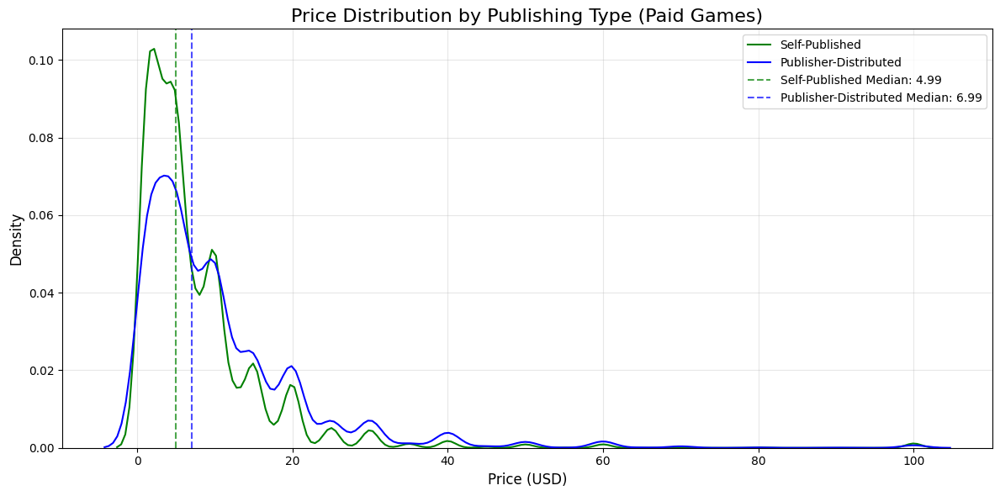

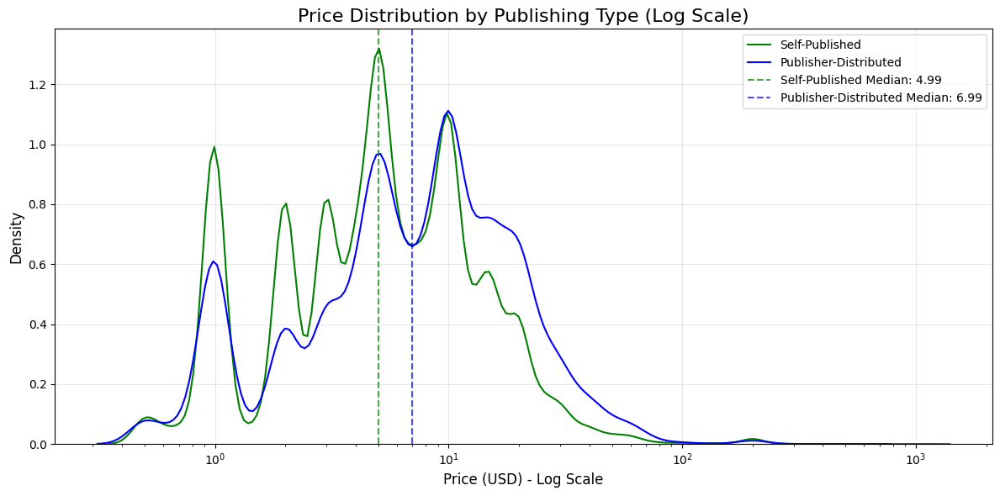

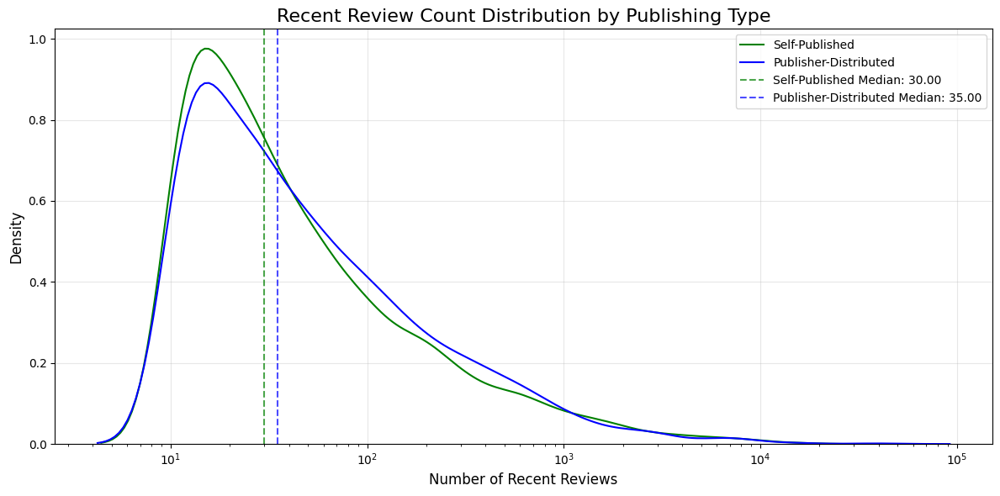

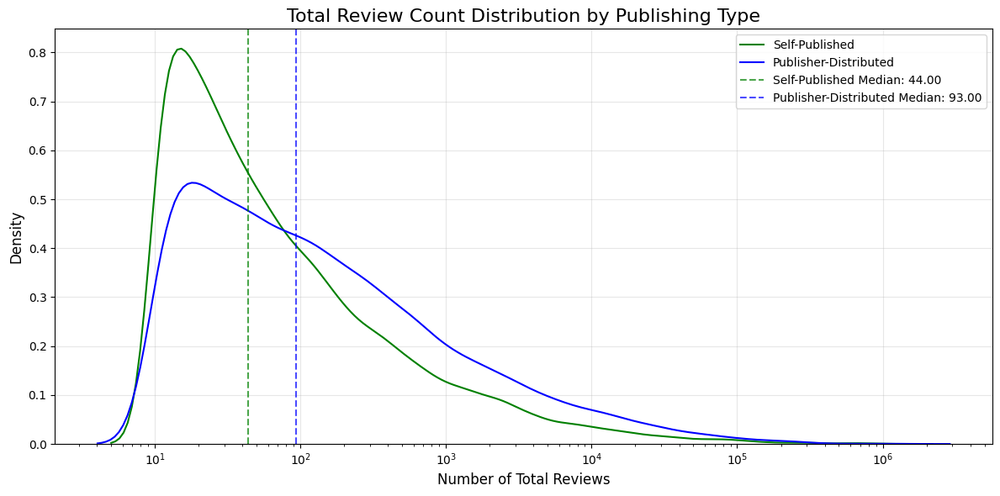

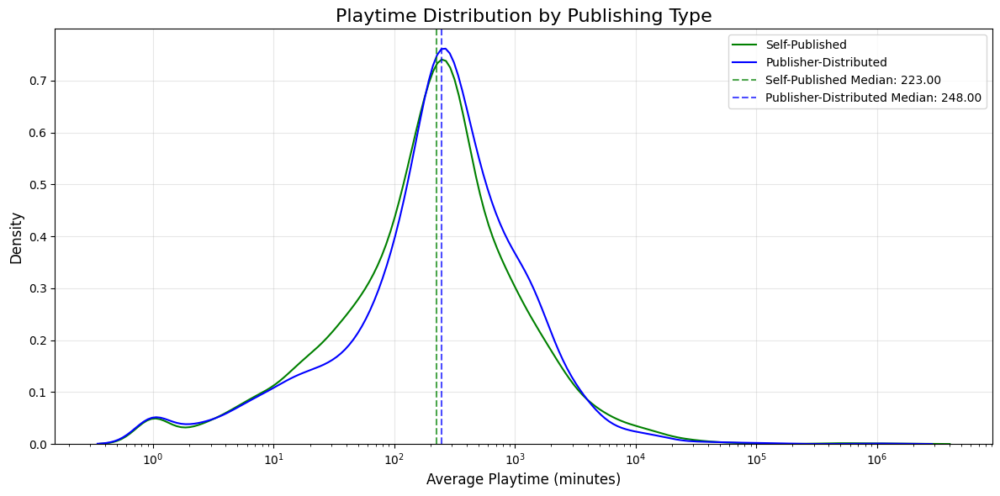

...

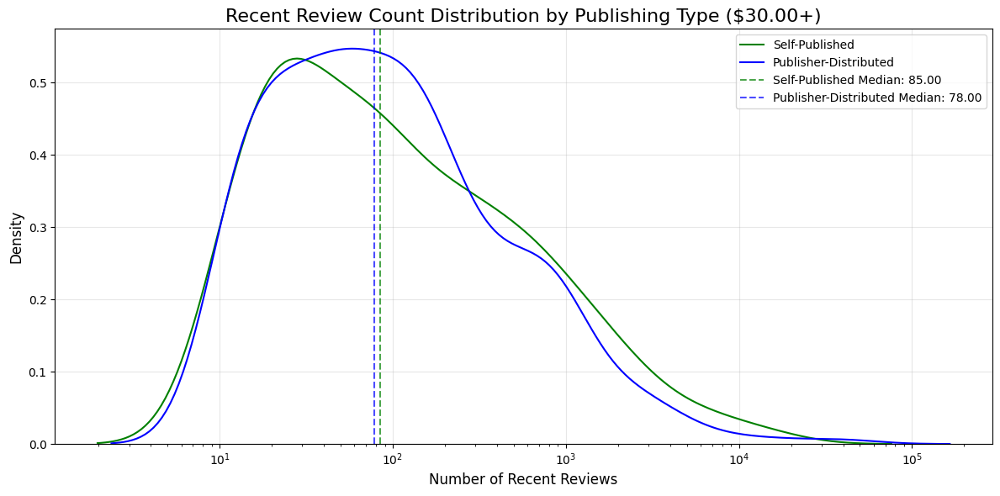

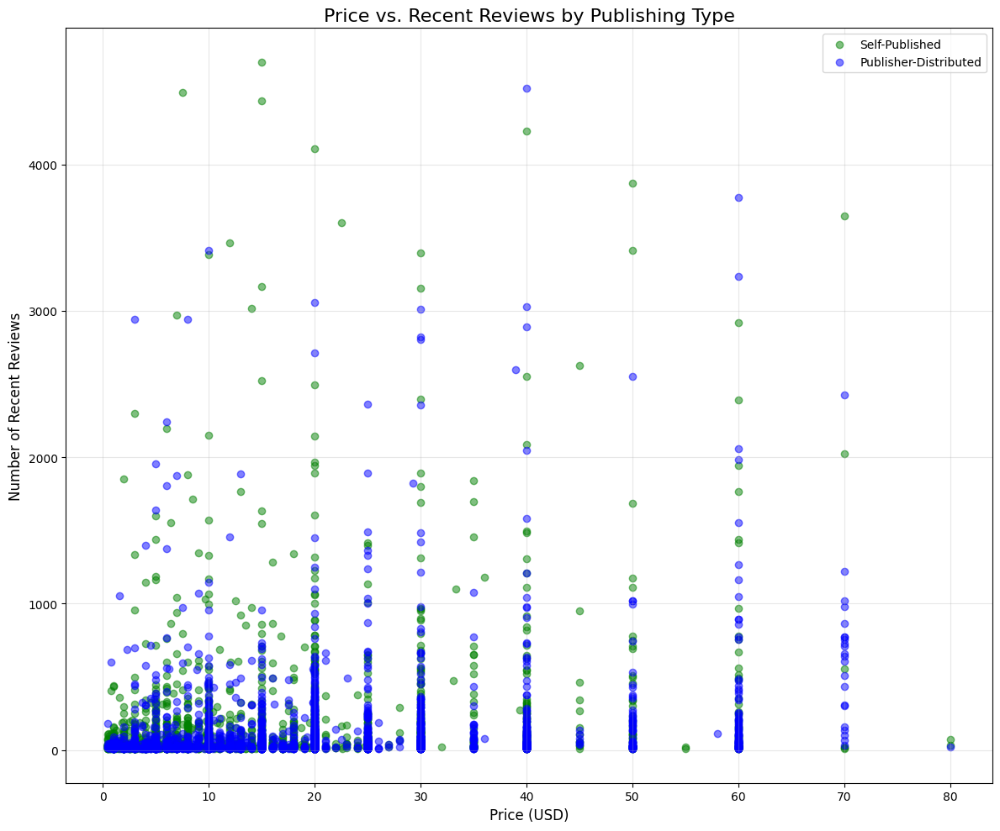

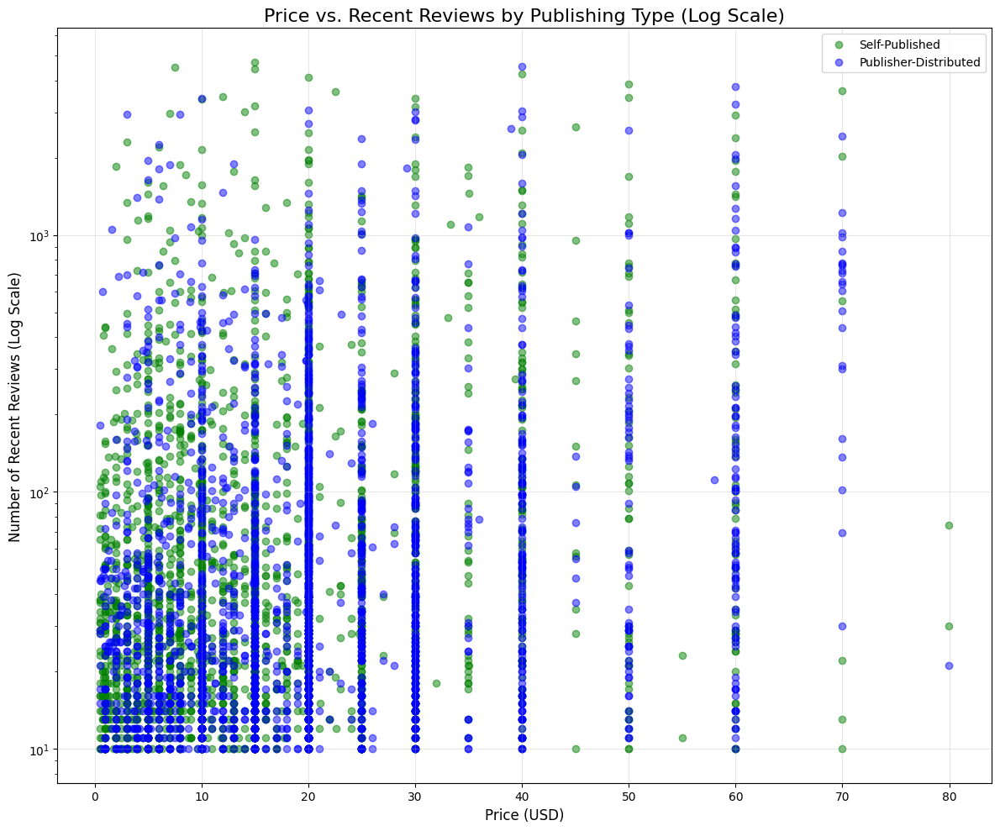

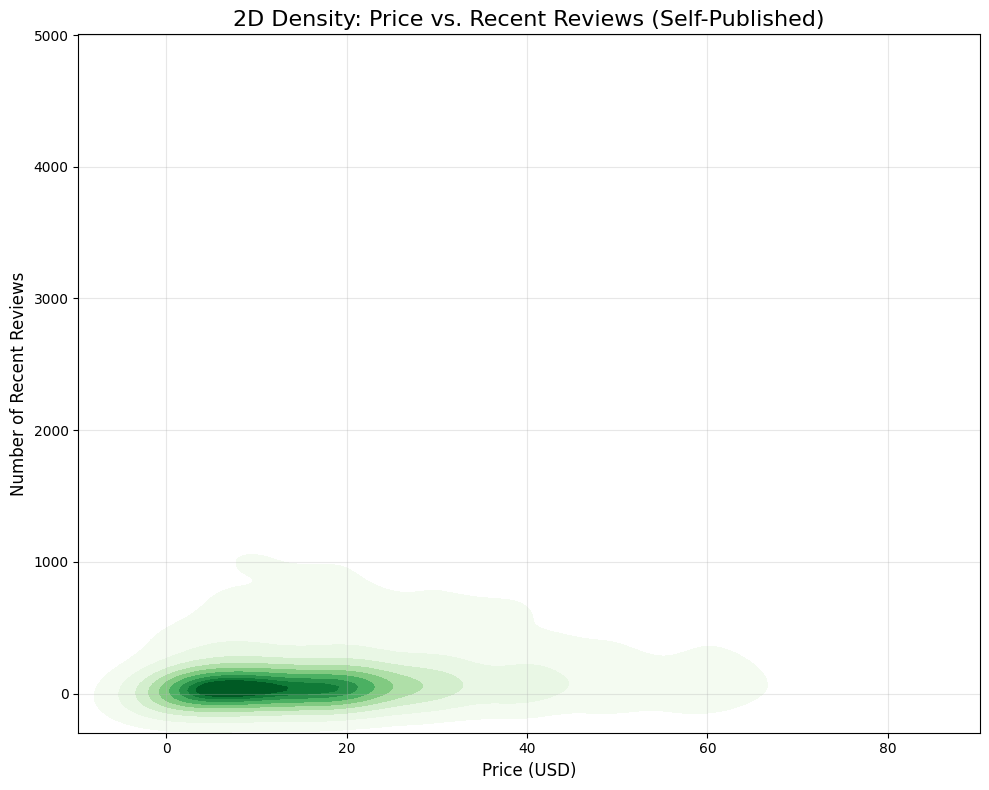

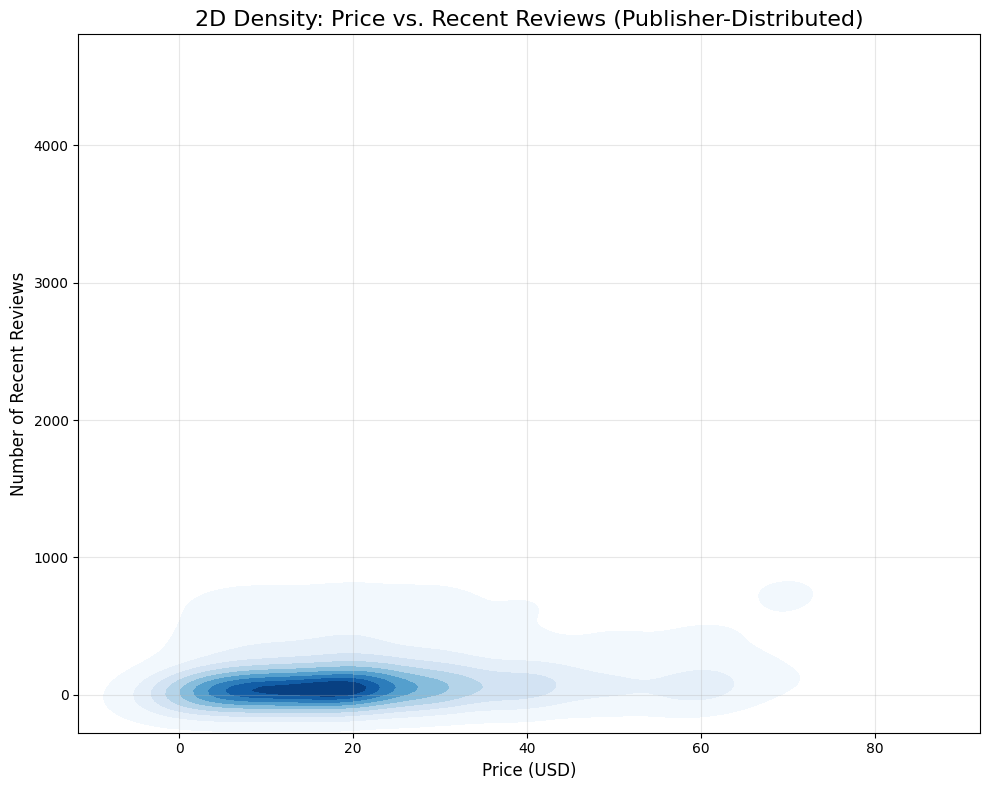

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the Steam dataset
print("Loading Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Filter out free-to-play games
print("Filtering out free-to-play games...")
df = df[df['price'] > 0]
print(f"Dataset after filtering: {len(df)} paid games")

# Convert release_date to datetime
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')

# Extract year from release date
df['year'] = df['release_date'].dt.year

# Create a function to identify self-published games
def is_self_published(row):
    """
    Check if a game is self-published by comparing developers and publishers.
    Returns True if any developer is also a publisher.
    """
    developers = row['developers']
    publishers = row['publishers']
    
    # Handle missing values
    if pd.isna(developers) or pd.isna(publishers):
        return False
    
    # Convert string representations of lists to actual lists
    if isinstance(developers, str):
        if developers.startswith('[') and developers.endswith(']'):
            try:
                developers = eval(developers)
            except:
                developers = [developers]
        else:
            developers = [developers]
            
    if isinstance(publishers, str):
        if publishers.startswith('[') and publishers.endswith(']'):
            try:
                publishers = eval(publishers)
            except:
                publishers = [publishers]
        else:
            publishers = [publishers]
    
    # Check for overlap between developers and publishers
    if isinstance(developers, list) and isinstance(publishers, list):
        return any(dev in publishers for dev in developers)
    
    return False

# Apply the function to create a self-published flag
print("Identifying self-published games...")
df['is_self_published'] = df.apply(is_self_published, axis=1)

# Count all games by year
total_games_by_year = df.groupby('year').size()

# Count self-published and publisher-distributed games by year
self_pub_by_year = df[df['is_self_published']].groupby('year').size()
publisher_by_year = df[~df['is_self_published']].groupby('year').size()

# Calculate percentage of self-published games each year
valid_years = sorted([year for year in total_games_by_year.index if 2006 <= year <= 2025])
publishing_stats = pd.DataFrame(index=valid_years)
publishing_stats['total_games'] = [total_games_by_year.get(year, 0) for year in valid_years]
publishing_stats['self_published'] = [self_pub_by_year.get(year, 0) for year in valid_years]
publishing_stats['publisher_distributed'] = [publisher_by_year.get(year, 0) for year in valid_years]
publishing_stats['pct_self_published'] = np.round((publishing_stats['self_published'] / publishing_stats['total_games'] * 100), 1)

print("\nPublishing statistics by year (paid games only):")
print(publishing_stats)

# Define review thresholds similar to the original code
review_thresholds = [1, 5, 10, 20, 40, 80, 160, 320, 640, 1280, 2560, 5120, 10240]

# Find the review columns
total_review_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None
recent_review_col = 'num_reviews_recent' if 'num_reviews_recent' in df.columns else None

# KDE PLOTS FOR KEY METRICS
print("\nGenerating KDE plots for key metrics...")

# Create a function to generate KDE plots
def create_kde_plot(data, column, title, xlabel, log_scale=False, clip=None, xlim=None, ylim=None):
    plt.figure(figsize=(12, 6))
    
    # Filter data to remove extreme outliers if needed
    if clip:
        data_self_pub = data[data['is_self_published']][column].clip(0, clip)
        data_publisher = data[~data['is_self_published']][column].clip(0, clip)
    else:
        data_self_pub = data[data['is_self_published']][column]
        data_publisher = data[~data['is_self_published']][column]
    
    # Set up the plot
    if log_scale:
        # Filter out zeros and negative values for log scale
        data_self_pub = data_self_pub[data_self_pub > 0]
        data_publisher = data_publisher[data_publisher > 0]
        
        sns.kdeplot(data_self_pub, log_scale=True, label='Self-Published', color='green')
        sns.kdeplot(data_publisher, log_scale=True, label='Publisher-Distributed', color='blue')
    else:
        sns.kdeplot(data_self_pub, label='Self-Published', color='green')
        sns.kdeplot(data_publisher, label='Publisher-Distributed', color='blue')
    
    # Add vertical lines for medians
    plt.axvline(data_self_pub.median(), color='green', linestyle='--', alpha=0.7, 
                label=f'Self-Published Median: {data_self_pub.median():.2f}')
    plt.axvline(data_publisher.median(), color='blue', linestyle='--', alpha=0.7,
                label=f'Publisher-Distributed Median: {data_publisher.median():.2f}')
    
    plt.title(title, fontsize=16)
    plt.xlabel(xlabel, fontsize=12)
    plt.ylabel('Density', fontsize=12)
    
    if xlim:
        plt.xlim(xlim)
    if ylim:
        plt.ylim(ylim)
    
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

# 1. KDE for Price Distribution
create_kde_plot(
    data=df, 
    column='price', 
    title='Price Distribution by Publishing Type (Paid Games)', 
    xlabel='Price (USD)',
    clip=100,  # Clip at $100 to focus on the main distribution
    log_scale=False
)

# 2. KDE for Price Distribution (log scale)
create_kde_plot(
    data=df, 
    column='price', 
    title='Price Distribution by Publishing Type (Log Scale)', 
    xlabel='Price (USD) - Log Scale',
    log_scale=True
)

# 3. KDE for Review Counts (if column exists)
if recent_review_col:
    # Filter to games with at least 1 review
    df_with_reviews = df[df[recent_review_col] > 0]
    
    create_kde_plot(
        data=df_with_reviews, 
        column=recent_review_col, 
        title='Recent Review Count Distribution by Publishing Type', 
        xlabel='Number of Recent Reviews',
        log_scale=True
    )

if total_review_col:
    # Filter to games with at least 1 review
    df_with_total_reviews = df[df[total_review_col] > 0]
    
    create_kde_plot(
        data=df_with_total_reviews, 
        column=total_review_col, 
        title='Total Review Count Distribution by Publishing Type', 
        xlabel='Number of Total Reviews',
        log_scale=True
    )

# 4. KDE for Playtime (if column exists)
playtime_cols = [col for col in df.columns if 'playtime' in col.lower()]
if playtime_cols:
    playtime_col = playtime_cols[0]  # Use the first playtime column
    
    # Filter to games with non-zero playtime
    df_with_playtime = df[df[playtime_col] > 0]
    
    create_kde_plot(
        data=df_with_playtime, 
        column=playtime_col, 
        title='Playtime Distribution by Publishing Type', 
        xlabel='Average Playtime (minutes)',
        log_scale=True
    )

# 5. KDE for User Scores (if column exists)
score_cols = [col for col in df.columns if 'score' in col.lower() and 'rank' not in col.lower()]
if score_cols:
    for score_col in score_cols:
        if pd.api.types.is_numeric_dtype(df[score_col]):
            # Filter to games with scores
            df_with_scores = df[df[score_col] > 0]
            
            create_kde_plot(
                data=df_with_scores, 
                column=score_col, 
                title=f'{score_col} Distribution by Publishing Type', 
                xlabel='Score',
                log_scale=False
            )

# 6. KDE for Time-Based Analysis (Modern Era)
# Create KDE plots for recent years only (2015-2025)
recent_df = df[df['year'] >= 2015]

if 'price' in recent_df.columns:
    create_kde_plot(
        data=recent_df, 
        column='price', 
        title='Price Distribution by Publishing Type (2015-2025, Paid Games)', 
        xlabel='Price (USD)',
        clip=100,
        log_scale=False
    )

if recent_review_col:
    recent_df_with_reviews = recent_df[recent_df[recent_review_col] > 0]
    
    create_kde_plot(
        data=recent_df_with_reviews, 
        column=recent_review_col, 
        title='Recent Review Count Distribution by Publishing Type (2015-2025)', 
        xlabel='Number of Recent Reviews',
        log_scale=True
    )

# 7. KDE comparing years
# Select a few representative years for comparison
years_to_compare = [2010, 2015, 2020, 2024]

# Price distribution by year
for year in years_to_compare:
    year_df = df[df['year'] == year]
    
    if len(year_df) > 50:  # Only plot if we have enough data
        create_kde_plot(
            data=year_df, 
            column='price', 
            title=f'Price Distribution by Publishing Type ({year})', 
            xlabel='Price (USD)',
            clip=100,
            log_scale=False
        )

# 8. Combined violin and box plots for Price
plt.figure(figsize=(12, 8))
sns.violinplot(x='is_self_published', y='price', data=df[df['price'] <= 100], 
               inner='box', palette=['blue', 'green'])
plt.title('Price Distribution Comparison (Violin + Box Plot)', fontsize=16)
plt.xlabel('Publishing Type', fontsize=12)
plt.ylabel('Price (USD)', fontsize=12)
plt.xticks([0, 1], ['Publisher-Distributed', 'Self-Published'])
plt.grid(True, axis='y', alpha=0.3)
plt.tight_layout()

# 9. KDE for success metrics over time
# Let's define success as having at least 40 recent reviews
if recent_review_col:
    for year in years_to_compare:
        year_df = df[df['year'] == year]
        
        if len(year_df) > 50:  # Only plot if we have enough data
            year_df_with_reviews = year_df[year_df[recent_review_col] > 0]
            
            create_kde_plot(
                data=year_df_with_reviews, 
                column=recent_review_col, 
                title=f'Recent Review Count Distribution by Publishing Type ({year})', 
                xlabel='Number of Recent Reviews',
                log_scale=True
            )

# 10. KDE by price tier
# Let's compare distributions within specific price tiers
price_tiers = [
    (0, 4.99, '$0.01-$4.99'),
    (5, 9.99, '$5.00-$9.99'),
    (10, 19.99, '$10.00-$19.99'),
    (20, 29.99, '$20.00-$29.99'),
    (30, float('inf'), '$30.00+')
]

for lower, upper, label in price_tiers:
    # Filter games in this price tier
    tier_df = df[(df['price'] > lower) & (df['price'] <= upper)]
    
    if len(tier_df) > 50 and recent_review_col:  # Only plot if we have enough data
        tier_df_with_reviews = tier_df[tier_df[recent_review_col] > 0]
        
        create_kde_plot(
            data=tier_df_with_reviews, 
            column=recent_review_col, 
            title=f'Recent Review Count Distribution by Publishing Type ({label})', 
            xlabel='Number of Recent Reviews',
            log_scale=True
        )

# 11. Joint plots for key metrics (price vs reviews)
if recent_review_col:
    # Filter data for better visualization
    plot_df = df[(df['price'] <= 100) & (df[recent_review_col] > 0) & (df[recent_review_col] <= 5000)]
    
    plt.figure(figsize=(12, 10))
    
    # Plot for self-published games
    self_pub_df = plot_df[plot_df['is_self_published']]
    plt.scatter(self_pub_df['price'], self_pub_df[recent_review_col], 
                alpha=0.5, color='green', label='Self-Published')
    
    # Plot for publisher-distributed games
    publisher_df = plot_df[~plot_df['is_self_published']]
    plt.scatter(publisher_df['price'], publisher_df[recent_review_col], 
                alpha=0.5, color='blue', label='Publisher-Distributed')
    
    plt.title('Price vs. Recent Reviews by Publishing Type', fontsize=16)
    plt.xlabel('Price (USD)', fontsize=12)
    plt.ylabel('Number of Recent Reviews', fontsize=12)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

    # Also create a log-scale version
    plt.figure(figsize=(12, 10))
    
    plt.scatter(self_pub_df['price'], self_pub_df[recent_review_col], 
                alpha=0.5, color='green', label='Self-Published')
    plt.scatter(publisher_df['price'], publisher_df[recent_review_col], 
                alpha=0.5, color='blue', label='Publisher-Distributed')
    
    plt.title('Price vs. Recent Reviews by Publishing Type (Log Scale)', fontsize=16)
    plt.xlabel('Price (USD)', fontsize=12)
    plt.ylabel('Number of Recent Reviews (Log Scale)', fontsize=12)
    plt.yscale('log')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

# 12. 2D KDE plots (heatmaps)
if recent_review_col:
    # Filter data for better visualization
    plot_df = df[(df['price'] <= 100) & (df[recent_review_col] > 0) & (df[recent_review_col] <= 5000)]
    
    # Plot for self-published games
    plt.figure(figsize=(10, 8))
    self_pub_df = plot_df[plot_df['is_self_published']]
    sns.kdeplot(
        x=self_pub_df['price'],
        y=self_pub_df[recent_review_col],
        cmap="Greens",
        fill=True,
        thresh=0.05
    )
    plt.title('2D Density: Price vs. Recent Reviews (Self-Published)', fontsize=16)
    plt.xlabel('Price (USD)', fontsize=12)
    plt.ylabel('Number of Recent Reviews', fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    
    # Plot for publisher-distributed games
    plt.figure(figsize=(10, 8))
    publisher_df = plot_df[~plot_df['is_self_published']]
    sns.kdeplot(
        x=publisher_df['price'],
        y=publisher_df[recent_review_col],
        cmap="Blues",
        fill=True,
        thresh=0.05
    )
    plt.title('2D Density: Price vs. Recent Reviews (Publisher-Distributed)', fontsize=16)
    plt.xlabel('Price (USD)', fontsize=12)
    plt.ylabel('Number of Recent Reviews', fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

print("\nKDE plots generation complete")
plt.show()

## Market competitoes

Loading Steam dataset...
Dataset loaded successfully with 89618 records
Identifying market competitors (games with more than 10 recent reviews)...
Found 6322 market competitors out of 89618 total games (7.05%)

Basic statistics on market competitors:
Average price: $14.53
Median price: $10.49
Self-published competitors: 3771 (59.65%)
Publisher-distributed competitors: 2551 (40.35%)

Comparison to non-competitors:
Average price (competitors): $14.53 vs. non-competitors: $6.76
Self-published percentage (competitors): 59.65% vs. non-competitors: 76.01%

Performing feature engineering...
Using numeric feature: price
Using numeric feature: achievements
Using numeric feature: recommendations
Using numeric feature: num_reviews_recent
Using numeric feature: num_reviews_total
Using numeric feature: average_playtime_forever
Using numeric feature: average_playtime_2weeks
Using numeric feature: median_playtime_forever
Using numeric feature: median_playtime_2weeks
Using numeric feature: metacritic_

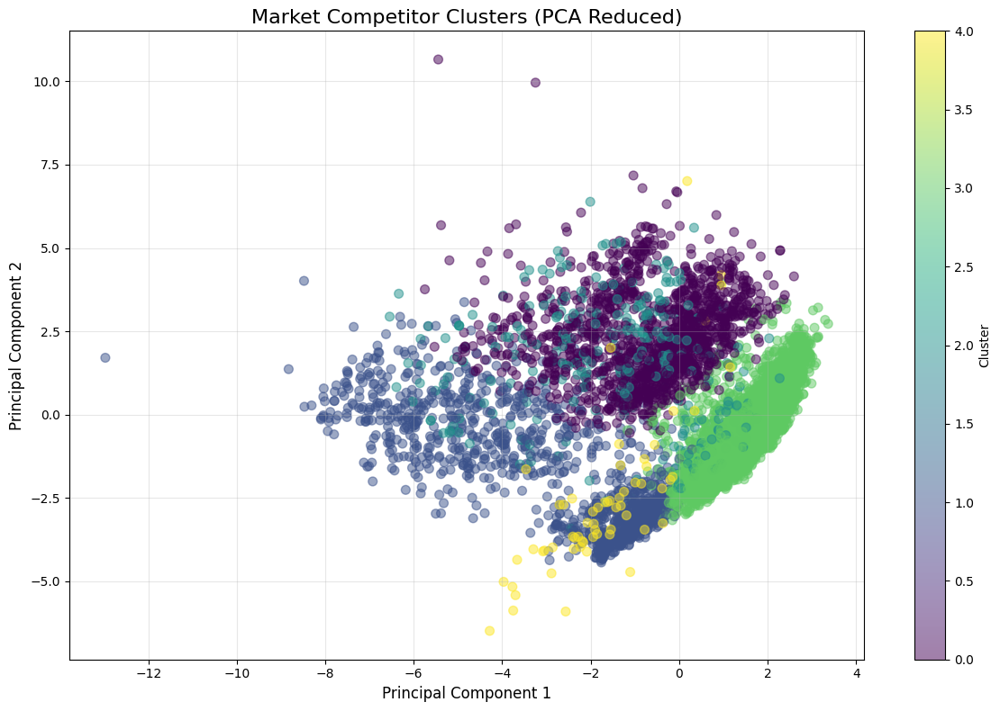

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the Steam dataset
print("Loading Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Create a function to identify self-published games
def is_self_published(row):
    """
    Check if a game is self-published by comparing developers and publishers.
    Returns True if any developer is also a publisher.
    """
    developers = row['developers']
    publishers = row['publishers']
    
    # Handle missing values
    if pd.isna(developers) or pd.isna(publishers):
        return False
    
    # Convert string representations of lists to actual lists
    if isinstance(developers, str):
        if developers.startswith('[') and developers.endswith(']'):
            try:
                developers = eval(developers)
            except:
                developers = [developers]
        else:
            developers = [developers]
            
    if isinstance(publishers, str):
        if publishers.startswith('[') and publishers.endswith(']'):
            try:
                publishers = eval(publishers)
            except:
                publishers = [publishers]
        else:
            publishers = [publishers]
    
    # Check for overlap between developers and publishers
    if isinstance(developers, list) and isinstance(publishers, list):
        return any(dev in publishers for dev in developers)
    
    return False

# Convert release_date to datetime
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')

# Extract year and month from release date
df['year'] = df['release_date'].dt.year
df['month'] = df['release_date'].dt.month

# Apply the function to identify self-published games
df['is_self_published'] = df.apply(is_self_published, axis=1)

# Find the review column names
recent_review_col = 'num_reviews_recent' if 'num_reviews_recent' in df.columns else None
total_review_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None

# Ensure we have the correct review column
if not recent_review_col:
    # Try to find an alternative column
    review_cols = [col for col in df.columns if 'review' in col.lower() and 'recent' in col.lower()]
    if review_cols:
        recent_review_col = review_cols[0]
        print(f"Using {recent_review_col} as the recent reviews column")
    else:
        print("No recent review column found. Cannot identify market competitors.")
        exit()

# Filter to market competitors (games with more than 10 recent reviews)
print(f"Identifying market competitors (games with more than 10 recent reviews)...")
competitors = df[df[recent_review_col] > 10].copy()
print(f"Found {len(competitors)} market competitors out of {len(df)} total games ({len(competitors)/len(df)*100:.2f}%)")

# Basic statistics on market competitors
print("\nBasic statistics on market competitors:")
print(f"Average price: ${competitors['price'].mean():.2f}")
print(f"Median price: ${competitors['price'].median():.2f}")
print(f"Self-published competitors: {sum(competitors['is_self_published'])} ({sum(competitors['is_self_published'])/len(competitors)*100:.2f}%)")
print(f"Publisher-distributed competitors: {sum(~competitors['is_self_published'])} ({sum(~competitors['is_self_published'])/len(competitors)*100:.2f}%)")

# Compare to non-competitors
non_competitors = df[df[recent_review_col] <= 10].copy()
print("\nComparison to non-competitors:")
print(f"Average price (competitors): ${competitors['price'].mean():.2f} vs. non-competitors: ${non_competitors['price'].mean():.2f}")
print(f"Self-published percentage (competitors): {sum(competitors['is_self_published'])/len(competitors)*100:.2f}% vs. non-competitors: {sum(non_competitors['is_self_published'])/len(non_competitors)*100:.2f}%")

# Feature engineering for deeper analysis
print("\nPerforming feature engineering...")

# Extract features related to game details
features = []

# Key numeric features
numeric_features = ['price', 'achievements', 'recommendations', recent_review_col]
if total_review_col:
    numeric_features.append(total_review_col)

# Playtime features
playtime_cols = [col for col in df.columns if 'playtime' in col.lower()]
numeric_features.extend(playtime_cols)

# Score features
score_cols = [col for col in df.columns if 'score' in col.lower() and 'rank' not in col.lower()]
numeric_features.extend(score_cols)

# Ensure all selected features are numeric and present in the dataframe
valid_numeric_features = []
for feature in numeric_features:
    if feature in competitors.columns:
        if pd.api.types.is_numeric_dtype(competitors[feature]):
            valid_numeric_features.append(feature)
            print(f"Using numeric feature: {feature}")

# Extract platform support and create dummy features
platform_features = ['windows', 'mac', 'linux']
for platform in platform_features:
    if platform in competitors.columns:
        if not pd.api.types.is_numeric_dtype(competitors[platform]):
            competitors[platform] = competitors[platform].map({'True': 1, 'False': 0, True: 1, False: 0})
        valid_numeric_features.append(platform)
        print(f"Using platform feature: {platform}")

# Extract release recency (days since release)
competitors['days_since_release'] = (datetime.now() - competitors['release_date']).dt.days
valid_numeric_features.append('days_since_release')
print(f"Using recency feature: days_since_release")

# Calculate review-to-recommendation ratio (popularity vs. engagement metric)
if 'recommendations' in competitors.columns and recent_review_col in competitors.columns:
    competitors['review_to_rec_ratio'] = competitors[recent_review_col] / (competitors['recommendations'] + 1)  # +1 to avoid division by zero
    valid_numeric_features.append('review_to_rec_ratio')
    print(f"Using engagement feature: review_to_rec_ratio")

# Calculate positive review percentage if available
if 'positive' in competitors.columns and 'negative' in competitors.columns:
    total_reviews = competitors['positive'] + competitors['negative']
    competitors['positive_pct'] = competitors['positive'] / (total_reviews + 1) * 100  # +1 to avoid division by zero
    valid_numeric_features.append('positive_pct')
    print(f"Using quality feature: positive_pct")

# Calculate review-to-playtime ratio (engagement quality metric)
if recent_review_col in competitors.columns and 'average_playtime_forever' in competitors.columns:
    competitors['review_to_playtime_ratio'] = competitors[recent_review_col] / (competitors['average_playtime_forever'] + 1)  # +1 to avoid division by zero
    valid_numeric_features.append('review_to_playtime_ratio')
    print(f"Using quality feature: review_to_playtime_ratio")

# Extract day of week and month of release to identify timing patterns
competitors['release_day_of_week'] = competitors['release_date'].dt.dayofweek
competitors['release_quarter'] = (competitors['release_date'].dt.month - 1) // 3 + 1
valid_numeric_features.extend(['release_day_of_week', 'release_quarter'])
print(f"Using timing features: release_day_of_week, release_quarter")

# Calculate price-to-playtime ratio (value for money metric)
if 'price' in competitors.columns and 'average_playtime_forever' in competitors.columns:
    competitors['price_per_hour'] = competitors['price'] / (competitors['average_playtime_forever'] / 60 + 0.1)  # +0.1 to avoid division by zero
    valid_numeric_features.append('price_per_hour')
    print(f"Using value feature: price_per_hour")

# Process categorical features
print("\nProcessing categorical features...")

# Extract genre information
if 'genres' in competitors.columns:
    # Function to safely extract genres
    def extract_genres(genre_str):
        try:
            if isinstance(genre_str, str):
                if genre_str.startswith('[') and genre_str.endswith(']'):
                    return eval(genre_str)
                return [genre_str]
            elif isinstance(genre_str, list):
                return genre_str
        except:
            pass
        return []
    
    # Apply extraction
    competitors['extracted_genres'] = competitors['genres'].apply(extract_genres)
    
    # Find top genres among competitors
    all_genres = []
    for genres in competitors['extracted_genres']:
        all_genres.extend(genres)
    
    genre_counts = pd.Series(all_genres).value_counts()
    top_genres = genre_counts.head(15).index.tolist()
    
    print(f"Top genres among market competitors:")
    for i, genre in enumerate(top_genres, 1):
        genre_count = sum(genre in genres for genres in competitors['extracted_genres'])
        genre_pct = genre_count / len(competitors) * 100
        print(f"{i}. {genre}: {genre_count} games ({genre_pct:.2f}%)")
    
    # Create dummy variables for top genres
    for genre in top_genres:
        competitors[f'genre_{genre}'] = competitors['extracted_genres'].apply(lambda x: 1 if genre in x else 0)
        valid_numeric_features.append(f'genre_{genre}')

# Similar processing for categories
if 'categories' in competitors.columns:
    def extract_categories(cat_str):
        try:
            if isinstance(cat_str, str):
                if cat_str.startswith('[') and cat_str.endswith(']'):
                    return eval(cat_str)
                return [cat_str]
            elif isinstance(cat_str, list):
                return cat_str
        except:
            pass
        return []
    
    competitors['extracted_categories'] = competitors['categories'].apply(extract_categories)
    
    all_categories = []
    for categories in competitors['extracted_categories']:
        all_categories.extend(categories)
    
    category_counts = pd.Series(all_categories).value_counts()
    top_categories = category_counts.head(15).index.tolist()
    
    print(f"\nTop categories among market competitors:")
    for i, category in enumerate(top_categories, 1):
        category_count = sum(category in cats for cats in competitors['extracted_categories'])
        category_pct = category_count / len(competitors) * 100
        print(f"{i}. {category}: {category_count} games ({category_pct:.2f}%)")
    
    # Create dummy variables for top categories
    for category in top_categories:
        competitors[f'category_{category}'] = competitors['extracted_categories'].apply(lambda x: 1 if category in x else 0)
        valid_numeric_features.append(f'category_{category}')

# Similar processing for tags
if 'tags' in competitors.columns:
    def extract_tags(tag_str):
        try:
            if isinstance(tag_str, str):
                if tag_str.startswith('[') and tag_str.endswith(']'):
                    return eval(tag_str)
                return [tag_str]
            elif isinstance(tag_str, list):
                return tag_str
        except:
            pass
        return []
    
    competitors['extracted_tags'] = competitors['tags'].apply(extract_tags)
    
    all_tags = []
    for tags in competitors['extracted_tags']:
        all_tags.extend(tags)
    
    tag_counts = pd.Series(all_tags).value_counts()
    top_tags = tag_counts.head(20).index.tolist()
    
    print(f"\nTop tags among market competitors:")
    for i, tag in enumerate(top_tags, 1):
        tag_count = sum(tag in tags for tags in competitors['extracted_tags'])
        tag_pct = tag_count / len(competitors) * 100
        print(f"{i}. {tag}: {tag_count} games ({tag_pct:.2f}%)")
    
    # Create dummy variables for top tags
    for tag in top_tags:
        competitors[f'tag_{tag}'] = competitors['extracted_tags'].apply(lambda x: 1 if tag in x else 0)
        valid_numeric_features.append(f'tag_{tag}')

# Analyze languages support
if 'supported_languages' in competitors.columns:
    def count_languages(lang_str):
        try:
            if isinstance(lang_str, str):
                # Count instances of language codes or names
                return lang_str.count(',') + 1
            elif isinstance(lang_str, list):
                return len(lang_str)
        except:
            pass
        return 0
    
    competitors['num_languages'] = competitors['supported_languages'].apply(count_languages)
    valid_numeric_features.append('num_languages')
    print(f"Using feature: num_languages")

# Calculate correlation between numeric features and recent reviews
print("\nAnalyzing correlation between features and market success...")
correlation_data = []

for feature in valid_numeric_features:
    if feature != recent_review_col and feature in competitors.columns:
        correlation = competitors[[feature, recent_review_col]].corr().iloc[0, 1]
        correlation_data.append({
            'Feature': feature,
            'Correlation with Recent Reviews': correlation
        })

correlation_df = pd.DataFrame(correlation_data)
correlation_df = correlation_df.sort_values('Correlation with Recent Reviews', ascending=False)

print("\nTop features positively correlated with market success (recent reviews):")
print(correlation_df.head(15).to_string(index=False))

print("\nTop features negatively correlated with market success (recent reviews):")
print(correlation_df.tail(15).to_string(index=False))

# Analyze success rate by genre
print("\nAnalyzing success rate by genre...")

if 'extracted_genres' in competitors.columns:
    genre_success_data = []
    overall_success_rate = len(competitors) / len(df) * 100
    
    for genre in top_genres:
        # Games in this genre
        genre_games = df[df['genres'].apply(lambda x: isinstance(x, str) and genre in x)]
        
        # Successful games in this genre
        genre_competitors = competitors[competitors['genres'].apply(lambda x: isinstance(x, str) and genre in x)]
        
        if len(genre_games) > 10:  # Only consider genres with enough data
            genre_success_rate = len(genre_competitors) / len(genre_games) * 100
            genre_success_data.append({
                'Genre': genre,
                'Total Games': len(genre_games),
                'Successful Games': len(genre_competitors),
                'Success Rate (%)': genre_success_rate,
                'Compared to Overall (%)': genre_success_rate - overall_success_rate
            })
    
    genre_success_df = pd.DataFrame(genre_success_data)
    genre_success_df = genre_success_df.sort_values('Success Rate (%)', ascending=False)
    
    print("\nGenres with highest success rates:")
    print(genre_success_df.head(10).to_string(index=False))

# Analyze price bands for market competitors
print("\nAnalyzing price bands for market competitors...")

# Define price bands
price_bands = [
    (0, 0, "Free"),
    (0.01, 4.99, "$0.01-$4.99"),
    (5, 9.99, "$5.00-$9.99"),
    (10, 14.99, "$10.00-$14.99"),
    (15, 19.99, "$15.00-$19.99"),
    (20, 29.99, "$20.00-$29.99"),
    (30, 39.99, "$30.00-$39.99"),
    (40, 49.99, "$40.00-$49.99"),
    (50, 59.99, "$50.00-$59.99"),
    (60, float('inf'), "$60.00+")
]

price_band_data = []
for lower, upper, label in price_bands:
    # Games in this price band
    if lower == 0 and upper == 0:
        price_band_games = df[df['price'] == 0]
        price_band_competitors = competitors[competitors['price'] == 0]
    else:
        price_band_games = df[(df['price'] > lower) & (df['price'] <= upper)]
        price_band_competitors = competitors[(competitors['price'] > lower) & (competitors['price'] <= upper)]
    
    if len(price_band_games) > 0:
        success_rate = len(price_band_competitors) / len(price_band_games) * 100
        price_band_data.append({
            'Price Band': label,
            'Total Games': len(price_band_games),
            'Successful Games': len(price_band_competitors),
            'Success Rate (%)': success_rate,
            'Avg Reviews': price_band_competitors[recent_review_col].mean() if len(price_band_competitors) > 0 else 0
        })

price_band_df = pd.DataFrame(price_band_data)
print("\nSuccess rate by price band:")
print(price_band_df.to_string(index=False))

# Analyze release timing
print("\nAnalyzing release timing patterns...")

# Day of week analysis
day_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_data = []

for day_num in range(7):
    day_games = df[df['release_date'].dt.dayofweek == day_num]
    day_competitors = competitors[competitors['release_date'].dt.dayofweek == day_num]
    
    if len(day_games) > 0:
        success_rate = len(day_competitors) / len(day_games) * 100
        day_data.append({
            'Day of Week': day_names[day_num],
            'Total Games': len(day_games),
            'Successful Games': len(day_competitors),
            'Success Rate (%)': success_rate
        })

day_df = pd.DataFrame(day_data)
print("\nSuccess rate by release day of week:")
print(day_df.to_string(index=False))

# Month analysis
month_names = ['January', 'February', 'March', 'April', 'May', 'June', 
               'July', 'August', 'September', 'October', 'November', 'December']
month_data = []

for month_num in range(1, 13):
    month_games = df[df['release_date'].dt.month == month_num]
    month_competitors = competitors[competitors['release_date'].dt.month == month_num]
    
    if len(month_games) > 0:
        success_rate = len(month_competitors) / len(month_games) * 100
        month_data.append({
            'Month': month_names[month_num-1],
            'Total Games': len(month_games),
            'Successful Games': len(month_competitors),
            'Success Rate (%)': success_rate
        })

month_df = pd.DataFrame(month_data)
print("\nSuccess rate by release month:")
print(month_df.to_string(index=False))

# Cluster analysis to identify distinct groups of successful games
print("\nPerforming cluster analysis to identify distinct market segments...")

# Prepare data for clustering
cluster_features = [f for f in valid_numeric_features if f in competitors.columns 
                    and f != recent_review_col and f != total_review_col]

# Handle missing values
cluster_df = competitors[cluster_features].copy()
cluster_df = cluster_df.fillna(cluster_df.median())

# Filter out any remaining non-numeric values
numeric_cluster_df = cluster_df.select_dtypes(include=['number'])
print(f"Using {len(numeric_cluster_df.columns)} features for clustering")

# Standardize data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(numeric_cluster_df)

# Determine optimal number of clusters (using silhouette score would be better)
max_clusters = 5  # We'll use a simple approach for demonstration
pca = PCA(n_components=2)
reduced_data = pca.fit_transform(scaled_data)

# Perform KMeans clustering
kmeans = KMeans(n_clusters=max_clusters, random_state=42)
clusters = kmeans.fit_predict(scaled_data)
competitors['cluster'] = clusters

# Analyze cluster characteristics
print("\nCluster characteristics:")
cluster_stats = competitors.groupby('cluster').agg({
    recent_review_col: ['mean', 'median'],
    'price': ['mean', 'median'],
    'is_self_published': 'mean'  # Percentage of self-published games
}).reset_index()

# Format the cluster stats for better readability
cluster_stats.columns = [f"{col[0]}_{col[1]}" if col[1] else col[0] for col in cluster_stats.columns]
cluster_stats = cluster_stats.rename(columns={
    f'{recent_review_col}_mean': 'Avg Reviews',
    f'{recent_review_col}_median': 'Median Reviews',
    'price_mean': 'Avg Price',
    'price_median': 'Median Price',
    'is_self_published_mean': 'Self-Published %'
})
cluster_stats['Self-Published %'] = cluster_stats['Self-Published %'] * 100
cluster_stats['Count'] = competitors.groupby('cluster').size().values

print(cluster_stats.to_string(index=False))

# Visualize clusters
plt.figure(figsize=(12, 8))
scatter = plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=clusters, 
                      cmap='viridis', alpha=0.5, s=50)
plt.colorbar(scatter, label='Cluster')
plt.title('Market Competitor Clusters (PCA Reduced)', fontsize=16)
plt.xlabel('Principal Component 1', fontsize=12)
plt.ylabel('Principal Component 2', fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()

# Analyze top genres in each cluster
if 'extracted_genres' in competitors.columns:
    print("\nTop genres in each cluster:")
    for cluster_id in range(max_clusters):
        cluster_games = competitors[competitors['cluster'] == cluster_id]
        
        # Get all genres in this cluster
        cluster_genres = []
        for genres in cluster_games['extracted_genres']:
            cluster_genres.extend(genres)
        
        if cluster_genres:
            # Count occurrences
            cluster_genre_counts = pd.Series(cluster_genres).value_counts()
            top_cluster_genres = cluster_genre_counts.head(5)
            
            print(f"\nCluster {cluster_id} (n={len(cluster_games)}):")
            for genre, count in top_cluster_genres.items():
                pct = count / len(cluster_games) * 100
                print(f"  {genre}: {count} games ({pct:.2f}%)")

# Generate recommendations for creating a competitive market entrant
print("\nRecommendations for creating a competitive market entrant:")

# Most successful price points
top_price_bands = price_band_df.sort_values('Success Rate (%)', ascending=False).head(3)
print("\n1. Optimal Price Points:")
for _, row in top_price_bands.iterrows():
    print(f"  • {row['Price Band']}: {row['Success Rate (%)']:.2f}% success rate with avg {row['Avg Reviews']:.1f} reviews")

# Most successful genres
if 'extracted_genres' in competitors.columns:
    top_success_genres = genre_success_df.head(5)
    print("\n2. Most Successful Genres:")
    for _, row in top_success_genres.iterrows():
        print(f"  • {row['Genre']}: {row['Success Rate (%)']:.2f}% success rate ({row['Successful Games']} successful games)")

# Optimal release timing
top_days = day_df.sort_values('Success Rate (%)', ascending=False).head(3)
top_months = month_df.sort_values('Success Rate (%)', ascending=False).head(3)
print("\n3. Optimal Release Timing:")
print("  Best days to release:")
for _, row in top_days.iterrows():
    print(f"  • {row['Day of Week']}: {row['Success Rate (%)']:.2f}% success rate")
print("  Best months to release:")
for _, row in top_months.iterrows():
    print(f"  • {row['Month']}: {row['Success Rate (%)']:.2f}% success rate")

# Most important features for success
top_features = correlation_df[correlation_df['Correlation with Recent Reviews'] > 0].head(5)
print("\n4. Key Features Correlated with Success:")
for _, row in top_features.iterrows():
    print(f"  • {row['Feature']}: {row['Correlation with Recent Reviews']:.4f} correlation")

# Platform recommendations
platforms = ['windows', 'mac', 'linux']
platform_stats = []
for platform in platforms:
    if platform in competitors.columns:
        platform_games = df[df[platform] == 1]
        platform_competitors = competitors[competitors[platform] == 1]
        
        if len(platform_games) > 0:
            success_rate = len(platform_competitors) / len(platform_games) * 100
            platform_stats.append({
                'Platform': platform.capitalize(),
                'Success Rate (%)': success_rate,
                'Coverage (%)': len(platform_competitors) / len(competitors) * 100
            })

platform_df = pd.DataFrame(platform_stats)
print("\n5. Platform Support Recommendations:")
for _, row in platform_df.iterrows():
    print(f"  • {row['Platform']}: {row['Success Rate (%)']:.2f}% success rate with {row['Coverage (%)']:.2f}% market coverage")

# Print summary
print("\nSUMMARY OF MARKET COMPETITOR CHARACTERISTICS:")
print(f"• {len(competitors)} games ({len(competitors)/len(df)*100:.2f}% of all Steam games) have more than 10 recent reviews")
print(f"• Median price: ${competitors['price'].median():.2f}, Average price: ${competitors['price'].mean():.2f}")
print(f"• Self-published: {sum(competitors['is_self_published'])/len(competitors)*100:.2f}% of market competitors")
print(f"• Average recent reviews: {competitors[recent_review_col].mean():.2f}, Median: {competitors[recent_review_col].median():.2f}")
if 'average_playtime_forever' in competitors.columns:
    avg_playtime_hours = competitors['average_playtime_forever'].mean() / 60
    print(f"• Average playtime: {avg_playtime_hours:.2f} hours")

# Save the plots
plt.show()

# Predicting market competitors

Loading Steam dataset...
Dataset loaded successfully with 89618 records
Identifying market competitors (games with more than 10 recent reviews)...
Found 6322 market competitors out of 89618 total games (7.05%)
Excluding features: ['num_reviews_total', 'recommendations', 'average_playtime_forever', 'average_playtime_2weeks', 'median_playtime_forever', 'median_playtime_2weeks']

Basic statistics on market competitors:
Average price: $14.53
Median price: $10.49
Self-published competitors: 3771 (59.65%)
Publisher-distributed competitors: 2551 (40.35%)

Comparison to non-competitors:
Average price (competitors): $14.53 vs. non-competitors: $6.76
Self-published percentage (competitors): 59.65% vs. non-competitors: 76.01%

Performing feature engineering...
Using numeric feature: price
Using numeric feature: achievements
Using numeric feature: metacritic_score
Using numeric feature: user_score
Using platform feature: windows
Using platform feature: mac
Using platform feature: linux
Using recen

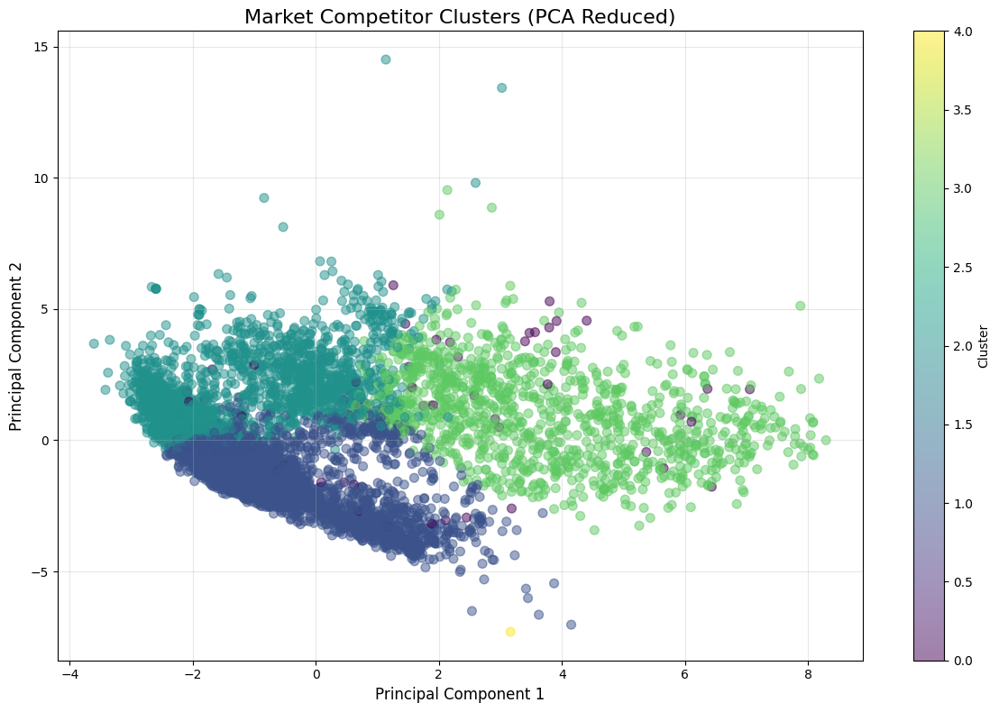

In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the Steam dataset
print("Loading Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Create a function to identify self-published games
def is_self_published(row):
    """
    Check if a game is self-published by comparing developers and publishers.
    Returns True if any developer is also a publisher.
    """
    developers = row['developers']
    publishers = row['publishers']
    
    # Handle missing values
    if pd.isna(developers) or pd.isna(publishers):
        return False
    
    # Convert string representations of lists to actual lists
    if isinstance(developers, str):
        if developers.startswith('[') and developers.endswith(']'):
            try:
                developers = eval(developers)
            except:
                developers = [developers]
        else:
            developers = [developers]
            
    if isinstance(publishers, str):
        if publishers.startswith('[') and publishers.endswith(']'):
            try:
                publishers = eval(publishers)
            except:
                publishers = [publishers]
        else:
            publishers = [publishers]
    
    # Check for overlap between developers and publishers
    if isinstance(developers, list) and isinstance(publishers, list):
        return any(dev in publishers for dev in developers)
    
    return False

# Convert release_date to datetime
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')

# Extract year and month from release date
df['year'] = df['release_date'].dt.year
df['month'] = df['release_date'].dt.month

# Apply the function to identify self-published games
df['is_self_published'] = df.apply(is_self_published, axis=1)

# Find the review column names
recent_review_col = 'num_reviews_recent' if 'num_reviews_recent' in df.columns else None
total_review_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None

# Ensure we have the correct review column
if not recent_review_col:
    # Try to find an alternative column
    review_cols = [col for col in df.columns if 'review' in col.lower() and 'recent' in col.lower()]
    if review_cols:
        recent_review_col = review_cols[0]
        print(f"Using {recent_review_col} as the recent reviews column")
    else:
        print("No recent review column found. Cannot identify market competitors.")
        exit()

# Filter to market competitors (games with more than 10 recent reviews)
print(f"Identifying market competitors (games with more than 10 recent reviews)...")
competitors = df[df[recent_review_col] > 10].copy()
non_competitors = df[df[recent_review_col] <= 10].copy()
print(f"Found {len(competitors)} market competitors out of {len(df)} total games ({len(competitors)/len(df)*100:.2f}%)")

# Create target variable for classification
df['is_competitor'] = df[recent_review_col] > 10

# Remove the direct review-based features that are too strongly correlated
exclude_features = [
    'num_reviews_total', 
    'recommendations', 
    'average_playtime_forever',
    'average_playtime_2weeks', 
    'median_playtime_forever', 
    'median_playtime_2weeks'
]
print(f"Excluding features: {exclude_features}")

# Basic statistics on market competitors
print("\nBasic statistics on market competitors:")
print(f"Average price: ${competitors['price'].mean():.2f}")
print(f"Median price: ${competitors['price'].median():.2f}")
print(f"Self-published competitors: {sum(competitors['is_self_published'])} ({sum(competitors['is_self_published'])/len(competitors)*100:.2f}%)")
print(f"Publisher-distributed competitors: {sum(~competitors['is_self_published'])} ({sum(~competitors['is_self_published'])/len(competitors)*100:.2f}%)")

# Compare to non-competitors
print("\nComparison to non-competitors:")
print(f"Average price (competitors): ${competitors['price'].mean():.2f} vs. non-competitors: ${non_competitors['price'].mean():.2f}")
print(f"Self-published percentage (competitors): {sum(competitors['is_self_published'])/len(competitors)*100:.2f}% vs. non-competitors: {sum(non_competitors['is_self_published'])/len(non_competitors)*100:.2f}%")

# Feature engineering for deeper analysis
print("\nPerforming feature engineering...")

# Extract features related to game details
features = []

# Key numeric features (excluding the highly correlated ones)
numeric_features = ['price', 'achievements']
for feature in exclude_features:
    if feature in numeric_features:
        numeric_features.remove(feature)

# Score features
score_cols = [col for col in df.columns if 'score' in col.lower() and 'rank' not in col.lower()]
numeric_features.extend(score_cols)

# Ensure all selected features are numeric and present in the dataframe
valid_numeric_features = []
for feature in numeric_features:
    if feature in competitors.columns:
        if pd.api.types.is_numeric_dtype(competitors[feature]):
            valid_numeric_features.append(feature)
            print(f"Using numeric feature: {feature}")

# Extract platform support and create dummy features
platform_features = ['windows', 'mac', 'linux']
for platform in platform_features:
    if platform in competitors.columns:
        if not pd.api.types.is_numeric_dtype(competitors[platform]):
            competitors[platform] = competitors[platform].map({'True': 1, 'False': 0, True: 1, False: 0})
        valid_numeric_features.append(platform)
        print(f"Using platform feature: {platform}")

# Extract release recency (days since release)
competitors['days_since_release'] = (datetime.now() - competitors['release_date']).dt.days
valid_numeric_features.append('days_since_release')
print(f"Using recency feature: days_since_release")

# Calculate positive review percentage if available
if 'positive' in competitors.columns and 'negative' in competitors.columns:
    total_reviews = competitors['positive'] + competitors['negative']
    competitors['positive_pct'] = competitors['positive'] / (total_reviews + 1) * 100  # +1 to avoid division by zero
    valid_numeric_features.append('positive_pct')
    print(f"Using quality feature: positive_pct")

# Extract day of week and month of release to identify timing patterns
competitors['release_day_of_week'] = competitors['release_date'].dt.dayofweek
competitors['release_quarter'] = (competitors['release_date'].dt.month - 1) // 3 + 1
valid_numeric_features.extend(['release_day_of_week', 'release_quarter'])
print(f"Using timing features: release_day_of_week, release_quarter")

# Add developer/publisher features
if 'developers' in competitors.columns and 'publishers' in competitors.columns:
    # Count number of developers
    def count_entries(entry_str):
        try:
            if isinstance(entry_str, str):
                if entry_str.startswith('[') and entry_str.endswith(']'):
                    entries = eval(entry_str)
                    return len(entries)
                return 1
            elif isinstance(entry_str, list):
                return len(entry_str)
        except:
            pass
        return 0
    
    competitors['developer_count'] = competitors['developers'].apply(count_entries)
    competitors['publisher_count'] = competitors['publishers'].apply(count_entries)
    
    valid_numeric_features.extend(['developer_count', 'publisher_count'])
    print(f"Using team size features: developer_count, publisher_count")
    
    # Calculate developer/publisher ratio
    competitors['dev_pub_ratio'] = competitors['developer_count'] / (competitors['publisher_count'] + 0.1)  # +0.1 to avoid division by zero
    valid_numeric_features.append('dev_pub_ratio')
    print(f"Using team feature: dev_pub_ratio")

# Add metacritic-related features
if 'metacritic_score' in competitors.columns:
    # Create buckets for metacritic scores
    competitors['metacritic_tier'] = pd.cut(
        competitors['metacritic_score'], 
        bins=[0, 50, 70, 80, 90, 100],
        labels=['Poor', 'Mixed', 'Good', 'Very Good', 'Excellent']
    )
    print(f"Using quality feature: metacritic_tier")
    
    # Was the game reviewed by Metacritic at all?
    df['has_metacritic'] = ~df['metacritic_score'].isna()
    competitors['has_metacritic'] = ~competitors['metacritic_score'].isna()
    valid_numeric_features.append('has_metacritic')
    print(f"Using quality feature: has_metacritic")

# Add DLC count feature if available
if 'dlc_count' in competitors.columns:
    valid_numeric_features.append('dlc_count')
    print(f"Using feature: dlc_count")
    
    # Create a flag for games with DLC
    competitors['has_dlc'] = competitors['dlc_count'] > 0
    valid_numeric_features.append('has_dlc')
    print(f"Using feature: has_dlc")

# Check for Early Access status
if 'categories' in competitors.columns:
    def is_early_access(categories):
        if isinstance(categories, str):
            return 'Early Access' in categories
        return False
    
    competitors['is_early_access'] = competitors['categories'].apply(is_early_access)
    valid_numeric_features.append('is_early_access')
    print(f"Using feature: is_early_access")

# Count the number of screenshots and videos
if 'screenshots' in competitors.columns:
    def count_media(media_str):
        if isinstance(media_str, str):
            try:
                if media_str.startswith('[') and media_str.endswith(']'):
                    media_list = eval(media_str)
                    return len(media_list)
            except:
                pass
        return 0
    
    competitors['screenshot_count'] = competitors['screenshots'].apply(count_media)
    valid_numeric_features.append('screenshot_count')
    print(f"Using feature: screenshot_count")
    
if 'movies' in competitors.columns:
    competitors['video_count'] = competitors['movies'].apply(count_media)
    valid_numeric_features.append('video_count')
    print(f"Using feature: video_count")
    
    # Total media assets
    if 'screenshot_count' in competitors.columns:
        competitors['total_media'] = competitors['screenshot_count'] + competitors['video_count']
        valid_numeric_features.append('total_media')
        print(f"Using feature: total_media")

# Add age requirement feature
if 'required_age' in competitors.columns:
    valid_numeric_features.append('required_age')
    print(f"Using feature: required_age")
    
    # Is the game for adults only?
    competitors['is_adult'] = competitors['required_age'] >= 18
    valid_numeric_features.append('is_adult')
    print(f"Using feature: is_adult")

# Check for website and support options
if 'website' in competitors.columns:
    competitors['has_website'] = ~competitors['website'].isna() & (competitors['website'] != '')
    valid_numeric_features.append('has_website')
    print(f"Using feature: has_website")

if 'support_url' in competitors.columns:
    competitors['has_support_url'] = ~competitors['support_url'].isna() & (competitors['support_url'] != '')
    valid_numeric_features.append('has_support_url')
    print(f"Using feature: has_support_url")

if 'support_email' in competitors.columns:
    competitors['has_support_email'] = ~competitors['support_email'].isna() & (competitors['support_email'] != '')
    valid_numeric_features.append('has_support_email')
    print(f"Using feature: has_support_email")

# Process categorical features
print("\nProcessing categorical features...")

# Extract genre information
if 'genres' in competitors.columns:
    # Function to safely extract genres
    def extract_genres(genre_str):
        try:
            if isinstance(genre_str, str):
                if genre_str.startswith('[') and genre_str.endswith(']'):
                    return eval(genre_str)
                return [genre_str]
            elif isinstance(genre_str, list):
                return genre_str
        except:
            pass
        return []
    
    # Apply extraction
    competitors['extracted_genres'] = competitors['genres'].apply(extract_genres)
    
    # Find top genres among competitors
    all_genres = []
    for genres in competitors['extracted_genres']:
        all_genres.extend(genres)
    
    genre_counts = pd.Series(all_genres).value_counts()
    top_genres = genre_counts.head(15).index.tolist()
    
    print(f"Top genres among market competitors:")
    for i, genre in enumerate(top_genres, 1):
        genre_count = sum(genre in genres for genres in competitors['extracted_genres'])
        genre_pct = genre_count / len(competitors) * 100
        print(f"{i}. {genre}: {genre_count} games ({genre_pct:.2f}%)")
    
    # Create dummy variables for top genres
    for genre in top_genres:
        competitors[f'genre_{genre}'] = competitors['extracted_genres'].apply(lambda x: 1 if genre in x else 0)
        valid_numeric_features.append(f'genre_{genre}')

# Similar processing for categories
if 'categories' in competitors.columns:
    def extract_categories(cat_str):
        try:
            if isinstance(cat_str, str):
                if cat_str.startswith('[') and cat_str.endswith(']'):
                    return eval(cat_str)
                return [cat_str]
            elif isinstance(cat_str, list):
                return cat_str
        except:
            pass
        return []
    
    competitors['extracted_categories'] = competitors['categories'].apply(extract_categories)
    
    all_categories = []
    for categories in competitors['extracted_categories']:
        all_categories.extend(categories)
    
    category_counts = pd.Series(all_categories).value_counts()
    top_categories = category_counts.head(15).index.tolist()
    
    print(f"\nTop categories among market competitors:")
    for i, category in enumerate(top_categories, 1):
        category_count = sum(category in cats for cats in competitors['extracted_categories'])
        category_pct = category_count / len(competitors) * 100
        print(f"{i}. {category}: {category_count} games ({category_pct:.2f}%)")
    
    # Create dummy variables for top categories
    for category in top_categories:
        competitors[f'category_{category}'] = competitors['extracted_categories'].apply(lambda x: 1 if category in x else 0)
        valid_numeric_features.append(f'category_{category}')

# Similar processing for tags
if 'tags' in competitors.columns:
    def extract_tags(tag_str):
        try:
            if isinstance(tag_str, str):
                if tag_str.startswith('[') and tag_str.endswith(']'):
                    return eval(tag_str)
                return [tag_str]
            elif isinstance(tag_str, list):
                return tag_str
        except:
            pass
        return []
    
    competitors['extracted_tags'] = competitors['tags'].apply(extract_tags)
    
    all_tags = []
    for tags in competitors['extracted_tags']:
        all_tags.extend(tags)
    
    tag_counts = pd.Series(all_tags).value_counts()
    top_tags = tag_counts.head(20).index.tolist()
    
    print(f"\nTop tags among market competitors:")
    for i, tag in enumerate(top_tags, 1):
        tag_count = sum(tag in tags for tags in competitors['extracted_tags'])
        tag_pct = tag_count / len(competitors) * 100
        print(f"{i}. {tag}: {tag_count} games ({tag_pct:.2f}%)")
    
    # Create dummy variables for top tags
    for tag in top_tags:
        competitors[f'tag_{tag}'] = competitors['extracted_tags'].apply(lambda x: 1 if tag in x else 0)
        valid_numeric_features.append(f'tag_{tag}')

# Analyze languages support
if 'supported_languages' in competitors.columns:
    def count_languages(lang_str):
        try:
            if isinstance(lang_str, str):
                # Count instances of language codes or names
                return lang_str.count(',') + 1
            elif isinstance(lang_str, list):
                return len(lang_str)
        except:
            pass
        return 0
    
    competitors['num_languages'] = competitors['supported_languages'].apply(count_languages)
    valid_numeric_features.append('num_languages')
    print(f"Using feature: num_languages")

# Calculate correlation between numeric features and being a market competitor
print("\nAnalyzing correlation between features and market competitor status...")

# Create a combined DataFrame for correlation analysis
correlation_df = df.copy()

# Make sure all valid numeric features are in the correlation DataFrame
for feature in valid_numeric_features:
    if feature not in correlation_df.columns and feature in competitors.columns:
        correlation_df[feature] = 0
        correlation_df.loc[correlation_df.index.isin(competitors.index), feature] = competitors[feature]

# Calculate correlation with market competitor status
correlation_data = []
for feature in valid_numeric_features:
    if feature != 'is_competitor' and feature in correlation_df.columns:
        # Check if the feature has non-zero values
        if correlation_df[feature].nunique() > 1:
            correlation = correlation_df[[feature, 'is_competitor']].corr().iloc[0, 1]
            correlation_data.append({
                'Feature': feature,
                'Correlation with Competitor Status': correlation
            })

# Sort correlations
correlation_df_result = pd.DataFrame(correlation_data)
correlation_df_result = correlation_df_result.sort_values('Correlation with Competitor Status', ascending=False)

print("\nTop features positively correlated with market competitor status:")
print(correlation_df_result.head(15).to_string(index=False))

print("\nTop features negatively correlated with market competitor status:")
print(correlation_df_result.tail(15).to_string(index=False))

# Analyze success rate by genre
print("\nAnalyzing success rate by genre...")

if 'extracted_genres' in competitors.columns:
    genre_success_data = []
    overall_success_rate = len(competitors) / len(df) * 100
    
    for genre in top_genres:
        # Games in this genre
        genre_games = df[df['genres'].apply(lambda x: isinstance(x, str) and genre in x)]
        
        # Successful games in this genre
        genre_competitors = competitors[competitors['genres'].apply(lambda x: isinstance(x, str) and genre in x)]
        
        if len(genre_games) > 10:  # Only consider genres with enough data
            genre_success_rate = len(genre_competitors) / len(genre_games) * 100
            genre_success_data.append({
                'Genre': genre,
                'Total Games': len(genre_games),
                'Successful Games': len(genre_competitors),
                'Success Rate (%)': genre_success_rate,
                'Compared to Overall (%)': genre_success_rate - overall_success_rate
            })
    
    genre_success_df = pd.DataFrame(genre_success_data)
    genre_success_df = genre_success_df.sort_values('Success Rate (%)', ascending=False)
    
    print("\nGenres with highest success rates:")
    print(genre_success_df.head(10).to_string(index=False))

# Analyze price bands for market competitors
print("\nAnalyzing price bands for market competitors...")

# Define price bands
price_bands = [
    (0, 0, "Free"),
    (0.01, 4.99, "$0.01-$4.99"),
    (5, 9.99, "$5.00-$9.99"),
    (10, 14.99, "$10.00-$14.99"),
    (15, 19.99, "$15.00-$19.99"),
    (20, 29.99, "$20.00-$29.99"),
    (30, 39.99, "$30.00-$39.99"),
    (40, 49.99, "$40.00-$49.99"),
    (50, 59.99, "$50.00-$59.99"),
    (60, float('inf'), "$60.00+")
]

price_band_data = []
for lower, upper, label in price_bands:
    # Games in this price band
    if lower == 0 and upper == 0:
        price_band_games = df[df['price'] == 0]
        price_band_competitors = competitors[competitors['price'] == 0]
    else:
        price_band_games = df[(df['price'] > lower) & (df['price'] <= upper)]
        price_band_competitors = competitors[(competitors['price'] > lower) & (competitors['price'] <= upper)]
    
    if len(price_band_games) > 0:
        success_rate = len(price_band_competitors) / len(price_band_games) * 100
        price_band_data.append({
            'Price Band': label,
            'Total Games': len(price_band_games),
            'Successful Games': len(price_band_competitors),
            'Success Rate (%)': success_rate,
            'Avg Positive %': price_band_competitors['positive_pct'].mean() if 'positive_pct' in price_band_competitors.columns and len(price_band_competitors) > 0 else 0
        })

price_band_df = pd.DataFrame(price_band_data)
print("\nSuccess rate by price band:")
print(price_band_df.to_string(index=False))

# Analyze release timing
print("\nAnalyzing release timing patterns...")

# Day of week analysis
day_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_data = []

for day_num in range(7):
    day_games = df[df['release_date'].dt.dayofweek == day_num]
    day_competitors = competitors[competitors['release_date'].dt.dayofweek == day_num]
    
    if len(day_games) > 0:
        success_rate = len(day_competitors) / len(day_games) * 100
        day_data.append({
            'Day of Week': day_names[day_num],
            'Total Games': len(day_games),
            'Successful Games': len(day_competitors),
            'Success Rate (%)': success_rate
        })

day_df = pd.DataFrame(day_data)
print("\nSuccess rate by release day of week:")
print(day_df.to_string(index=False))

# Month analysis
month_names = ['January', 'February', 'March', 'April', 'May', 'June', 
               'July', 'August', 'September', 'October', 'November', 'December']
month_data = []

for month_num in range(1, 13):
    month_games = df[df['release_date'].dt.month == month_num]
    month_competitors = competitors[competitors['release_date'].dt.month == month_num]
    
    if len(month_games) > 0:
        success_rate = len(month_competitors) / len(month_games) * 100
        month_data.append({
            'Month': month_names[month_num-1],
            'Total Games': len(month_games),
            'Successful Games': len(month_competitors),
            'Success Rate (%)': success_rate
        })

month_df = pd.DataFrame(month_data)
print("\nSuccess rate by release month:")
print(month_df.to_string(index=False))

# Cluster analysis to identify distinct groups of successful games
print("\nPerforming cluster analysis to identify distinct market segments...")

# Prepare data for clustering
cluster_features = [f for f in valid_numeric_features if f in competitors.columns 
                    and f != recent_review_col and f != total_review_col]

# Handle missing values
cluster_df = competitors[cluster_features].copy()
cluster_df = cluster_df.fillna(cluster_df.median())

# Filter out any remaining non-numeric values
numeric_cluster_df = cluster_df.select_dtypes(include=['number'])
print(f"Using {len(numeric_cluster_df.columns)} features for clustering")

# Standardize data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(numeric_cluster_df)

# Determine optimal number of clusters (using silhouette score would be better)
max_clusters = 5  # We'll use a simple approach for demonstration
pca = PCA(n_components=2)
reduced_data = pca.fit_transform(scaled_data)

# Perform KMeans clustering
kmeans = KMeans(n_clusters=max_clusters, random_state=42)
clusters = kmeans.fit_predict(scaled_data)
competitors['cluster'] = clusters

# Analyze cluster characteristics
print("\nCluster characteristics:")
cluster_stats = competitors.groupby('cluster').agg({
    recent_review_col: ['mean', 'median'],
    'price': ['mean', 'median'],
    'is_self_published': 'mean'  # Percentage of self-published games
}).reset_index()

# Format the cluster stats for better readability
cluster_stats.columns = [f"{col[0]}_{col[1]}" if col[1] else col[0] for col in cluster_stats.columns]
cluster_stats = cluster_stats.rename(columns={
    f'{recent_review_col}_mean': 'Avg Reviews',
    f'{recent_review_col}_median': 'Median Reviews',
    'price_mean': 'Avg Price',
    'price_median': 'Median Price',
    'is_self_published_mean': 'Self-Published %'
})
cluster_stats['Self-Published %'] = cluster_stats['Self-Published %'] * 100
cluster_stats['Count'] = competitors.groupby('cluster').size().values

print(cluster_stats.to_string(index=False))

# Visualize clusters
plt.figure(figsize=(12, 8))
scatter = plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=clusters, 
                      cmap='viridis', alpha=0.5, s=50)
plt.colorbar(scatter, label='Cluster')
plt.title('Market Competitor Clusters (PCA Reduced)', fontsize=16)
plt.xlabel('Principal Component 1', fontsize=12)
plt.ylabel('Principal Component 2', fontsize=12)
plt.grid(True, alpha=0.3)
plt.tight_layout()

# Analyze top genres in each cluster
if 'extracted_genres' in competitors.columns:
    print("\nTop genres in each cluster:")
    for cluster_id in range(max_clusters):
        cluster_games = competitors[competitors['cluster'] == cluster_id]
        
        # Get all genres in this cluster
        cluster_genres = []
        for genres in cluster_games['extracted_genres']:
            cluster_genres.extend(genres)
        
        if cluster_genres:
            # Count occurrences
            cluster_genre_counts = pd.Series(cluster_genres).value_counts()
            top_cluster_genres = cluster_genre_counts.head(5)
            
            print(f"\nCluster {cluster_id} (n={len(cluster_games)}):")
            for genre, count in top_cluster_genres.items():
                pct = count / len(cluster_games) * 100
                print(f"  {genre}: {count} games ({pct:.2f}%)")

# Generate recommendations for creating a competitive market entrant
print("\nRecommendations for creating a competitive market entrant:")

# Most successful price points
top_price_bands = price_band_df.sort_values('Success Rate (%)', ascending=False).head(3)
print("\n1. Optimal Price Points:")
for _, row in top_price_bands.iterrows():
    print(f"  • {row['Price Band']}: {row['Success Rate (%)']:.2f}% success rate with avg {row['Avg Positive %']:.1f}% positive")

# Most successful genres
if 'extracted_genres' in competitors.columns:
    top_success_genres = genre_success_df.head(5)
    print("\n2. Most Successful Genres:")
    for _, row in top_success_genres.iterrows():
        print(f"  • {row['Genre']}: {row['Success Rate (%)']:.2f}% success rate ({row['Successful Games']} successful games)")

# Optimal release timing
top_days = day_df.sort_values('Success Rate (%)', ascending=False).head(3)
top_months = month_df.sort_values('Success Rate (%)', ascending=False).head(3)
print("\n3. Optimal Release Timing:")
print("  Best days to release:")
for _, row in top_days.iterrows():
    print(f"  • {row['Day of Week']}: {row['Success Rate (%)']:.2f}% success rate")
print("  Best months to release:")
for _, row in top_months.iterrows():
    print(f"  • {row['Month']}: {row['Success Rate (%)']:.2f}% success rate")

# Most important features for success
top_features = correlation_df_result[correlation_df_result['Correlation with Competitor Status'] > 0].head(5)
print("\n4. Key Features Correlated with Success:")
for _, row in top_features.iterrows():
    print(f"  • {row['Feature']}: {row['Correlation with Competitor Status']:.4f} correlation")

# Platform recommendations
platforms = ['windows', 'mac', 'linux']
platform_stats = []
for platform in platforms:
    if platform in competitors.columns:
        platform_games = df[df[platform] == 1]
        platform_competitors = competitors[competitors[platform] == 1]
        
        if len(platform_games) > 0:
            success_rate = len(platform_competitors) / len(platform_games) * 100
            platform_stats.append({
                'Platform': platform.capitalize(),
                'Success Rate (%)': success_rate,
                'Coverage (%)': len(platform_competitors) / len(competitors) * 100
            })

platform_df = pd.DataFrame(platform_stats)
print("\n5. Platform Support Recommendations:")
for _, row in platform_df.iterrows():
    print(f"  • {row['Platform']}: {row['Success Rate (%)']:.2f}% success rate with {row['Coverage (%)']:.2f}% market coverage")



# predicting

Loading Steam dataset...
Dataset loaded successfully with 89618 records
Identifying market competitors (games with more than 10 recent reviews)...
Found 6322 market competitors out of 89618 total games (7.05%)
Excluding features: ['num_reviews_total', 'recommendations', 'average_playtime_forever', 'average_playtime_2weeks', 'median_playtime_forever', 'median_playtime_2weeks']

Basic statistics on market competitors:
Average price: $14.53
Median price: $10.49
Self-published competitors: 3771 (59.65%)
Publisher-distributed competitors: 2551 (40.35%)

Comparison to non-competitors:
Average price (competitors): $14.53 vs. non-competitors: $6.76
Self-published percentage (competitors): 59.65% vs. non-competitors: 76.01%

Performing feature engineering...
Using numeric feature: price
Using numeric feature: achievements
Using numeric feature: metacritic_score
Using numeric feature: user_score
Using platform feature: windows
Using platform feature: mac
Using platform feature: linux
Using recen

KeyError: '1'

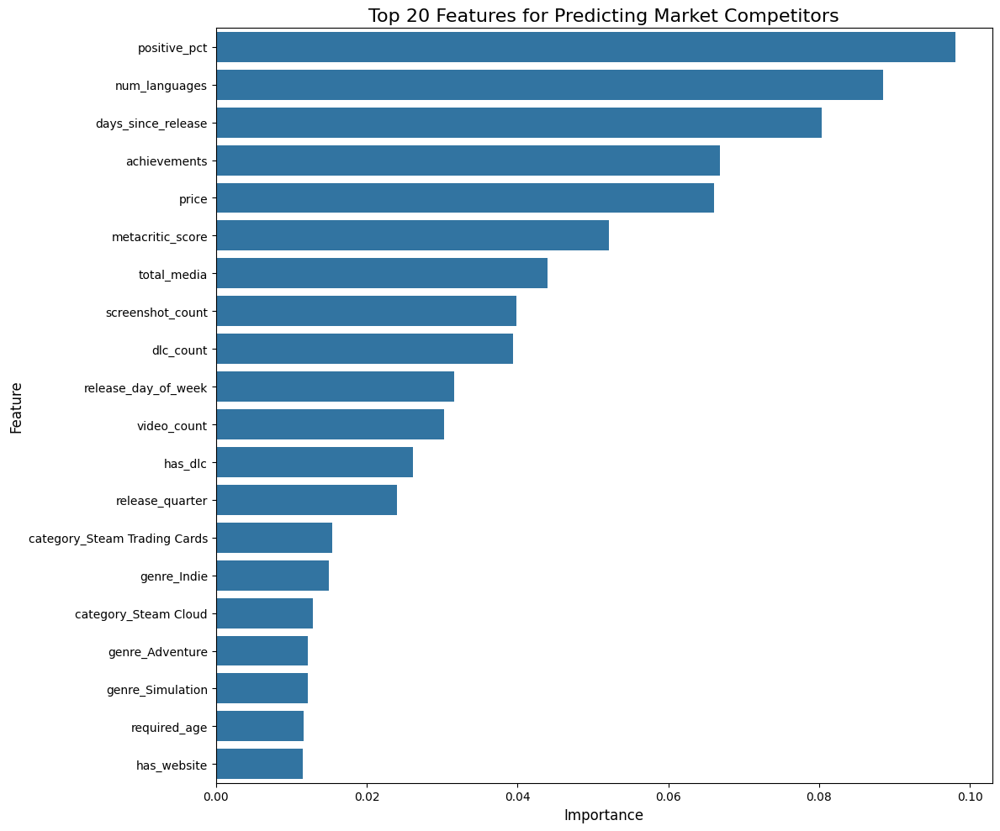

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the Steam dataset
print("Loading Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Create a function to identify self-published games
def is_self_published(row):
    """
    Check if a game is self-published by comparing developers and publishers.
    Returns True if any developer is also a publisher.
    """
    developers = row['developers']
    publishers = row['publishers']
    
    # Handle missing values
    if pd.isna(developers) or pd.isna(publishers):
        return False
    
    # Convert string representations of lists to actual lists
    if isinstance(developers, str):
        if developers.startswith('[') and developers.endswith(']'):
            try:
                developers = eval(developers)
            except:
                developers = [developers]
        else:
            developers = [developers]
            
    if isinstance(publishers, str):
        if publishers.startswith('[') and publishers.endswith(']'):
            try:
                publishers = eval(publishers)
            except:
                publishers = [publishers]
        else:
            publishers = [publishers]
    
    # Check for overlap between developers and publishers
    if isinstance(developers, list) and isinstance(publishers, list):
        return any(dev in publishers for dev in developers)
    
    return False

# Convert release_date to datetime
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')

# Extract year and month from release date
df['year'] = df['release_date'].dt.year
df['month'] = df['release_date'].dt.month

# Apply the function to identify self-published games
df['is_self_published'] = df.apply(is_self_published, axis=1)

# Find the review column names
recent_review_col = 'num_reviews_recent' if 'num_reviews_recent' in df.columns else None
total_review_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None

# Ensure we have the correct review column
if not recent_review_col:
    # Try to find an alternative column
    review_cols = [col for col in df.columns if 'review' in col.lower() and 'recent' in col.lower()]
    if review_cols:
        recent_review_col = review_cols[0]
        print(f"Using {recent_review_col} as the recent reviews column")
    else:
        print("No recent review column found. Cannot identify market competitors.")
        exit()

# Filter to market competitors (games with more than 10 recent reviews)
print(f"Identifying market competitors (games with more than 10 recent reviews)...")
competitors = df[df[recent_review_col] > 10].copy()
non_competitors = df[df[recent_review_col] <= 10].copy()
print(f"Found {len(competitors)} market competitors out of {len(df)} total games ({len(competitors)/len(df)*100:.2f}%)")

# Create target variable for classification
df['is_competitor'] = df[recent_review_col] > 10

# Remove the direct review-based features that are too strongly correlated
exclude_features = [
    'num_reviews_total', 
    'recommendations', 
    'average_playtime_forever',
    'average_playtime_2weeks', 
    'median_playtime_forever', 
    'median_playtime_2weeks'
]
print(f"Excluding features: {exclude_features}")

# Basic statistics on market competitors
print("\nBasic statistics on market competitors:")
print(f"Average price: ${competitors['price'].mean():.2f}")
print(f"Median price: ${competitors['price'].median():.2f}")
print(f"Self-published competitors: {sum(competitors['is_self_published'])} ({sum(competitors['is_self_published'])/len(competitors)*100:.2f}%)")
print(f"Publisher-distributed competitors: {sum(~competitors['is_self_published'])} ({sum(~competitors['is_self_published'])/len(competitors)*100:.2f}%)")

# Compare to non-competitors
print("\nComparison to non-competitors:")
print(f"Average price (competitors): ${competitors['price'].mean():.2f} vs. non-competitors: ${non_competitors['price'].mean():.2f}")
print(f"Self-published percentage (competitors): {sum(competitors['is_self_published'])/len(competitors)*100:.2f}% vs. non-competitors: {sum(non_competitors['is_self_published'])/len(non_competitors)*100:.2f}%")

# Feature engineering for deeper analysis
print("\nPerforming feature engineering...")

# Extract features related to game details
features = []

# Key numeric features (excluding the highly correlated ones)
numeric_features = ['price', 'achievements']
for feature in exclude_features:
    if feature in numeric_features:
        numeric_features.remove(feature)

# Score features
score_cols = [col for col in df.columns if 'score' in col.lower() and 'rank' not in col.lower()]
numeric_features.extend(score_cols)

# Ensure all selected features are numeric and present in the dataframe
valid_numeric_features = []
for feature in numeric_features:
    if feature in df.columns:
        if pd.api.types.is_numeric_dtype(df[feature]):
            valid_numeric_features.append(feature)
            print(f"Using numeric feature: {feature}")

# Extract platform support and create dummy features
platform_features = ['windows', 'mac', 'linux']
for platform in platform_features:
    if platform in df.columns:
        if not pd.api.types.is_numeric_dtype(df[platform]):
            df[platform] = df[platform].map({'True': 1, 'False': 0, True: 1, False: 0})
        valid_numeric_features.append(platform)
        print(f"Using platform feature: {platform}")

# Extract release recency (days since release)
df['days_since_release'] = (datetime.now() - df['release_date']).dt.days
valid_numeric_features.append('days_since_release')
print(f"Using recency feature: days_since_release")

# Calculate positive review percentage if available
if 'positive' in df.columns and 'negative' in df.columns:
    total_reviews = df['positive'] + df['negative']
    df['positive_pct'] = df['positive'] / (total_reviews + 1) * 100  # +1 to avoid division by zero
    valid_numeric_features.append('positive_pct')
    print(f"Using quality feature: positive_pct")

# Extract day of week and month of release to identify timing patterns
df['release_day_of_week'] = df['release_date'].dt.dayofweek
df['release_quarter'] = (df['release_date'].dt.month - 1) // 3 + 1
valid_numeric_features.extend(['release_day_of_week', 'release_quarter'])
print(f"Using timing features: release_day_of_week, release_quarter")

# Add developer/publisher features
if 'developers' in df.columns and 'publishers' in df.columns:
    # Count number of developers
    def count_entries(entry_str):
        try:
            if isinstance(entry_str, str):
                if entry_str.startswith('[') and entry_str.endswith(']'):
                    entries = eval(entry_str)
                    return len(entries)
                return 1
            elif isinstance(entry_str, list):
                return len(entry_str)
        except:
            pass
        return 0
    
    df['developer_count'] = df['developers'].apply(count_entries)
    df['publisher_count'] = df['publishers'].apply(count_entries)
    
    valid_numeric_features.extend(['developer_count', 'publisher_count'])
    print(f"Using team size features: developer_count, publisher_count")
    
    # Calculate developer/publisher ratio
    df['dev_pub_ratio'] = df['developer_count'] / (df['publisher_count'] + 0.1)  # +0.1 to avoid division by zero
    valid_numeric_features.append('dev_pub_ratio')
    print(f"Using team feature: dev_pub_ratio")

# Add metacritic-related features
if 'metacritic_score' in df.columns:
    # Was the game reviewed by Metacritic at all?
    df['has_metacritic'] = ~df['metacritic_score'].isna()
    valid_numeric_features.append('has_metacritic')
    print(f"Using quality feature: has_metacritic")

# Add DLC count feature if available
if 'dlc_count' in df.columns:
    valid_numeric_features.append('dlc_count')
    print(f"Using feature: dlc_count")
    
    # Create a flag for games with DLC
    df['has_dlc'] = df['dlc_count'] > 0
    valid_numeric_features.append('has_dlc')
    print(f"Using feature: has_dlc")

# Check for Early Access status
if 'categories' in df.columns:
    def is_early_access(categories):
        if isinstance(categories, str):
            return 'Early Access' in categories
        return False
    
    df['is_early_access'] = df['categories'].apply(is_early_access)
    valid_numeric_features.append('is_early_access')
    print(f"Using feature: is_early_access")

# Count the number of screenshots and videos
if 'screenshots' in df.columns:
    def count_media(media_str):
        if isinstance(media_str, str):
            try:
                if media_str.startswith('[') and media_str.endswith(']'):
                    media_list = eval(media_str)
                    return len(media_list)
            except:
                pass
        return 0
    
    df['screenshot_count'] = df['screenshots'].apply(count_media)
    valid_numeric_features.append('screenshot_count')
    print(f"Using feature: screenshot_count")
    
if 'movies' in df.columns:
    df['video_count'] = df['movies'].apply(count_media)
    valid_numeric_features.append('video_count')
    print(f"Using feature: video_count")
    
    # Total media assets
    if 'screenshot_count' in df.columns:
        df['total_media'] = df['screenshot_count'] + df['video_count']
        valid_numeric_features.append('total_media')
        print(f"Using feature: total_media")

# Add age requirement feature
if 'required_age' in df.columns:
    valid_numeric_features.append('required_age')
    print(f"Using feature: required_age")
    
    # Is the game for adults only?
    df['is_adult'] = df['required_age'] >= 18
    valid_numeric_features.append('is_adult')
    print(f"Using feature: is_adult")

# Check for website and support options
if 'website' in df.columns:
    df['has_website'] = ~df['website'].isna() & (df['website'] != '')
    valid_numeric_features.append('has_website')
    print(f"Using feature: has_website")

if 'support_url' in df.columns:
    df['has_support_url'] = ~df['support_url'].isna() & (df['support_url'] != '')
    valid_numeric_features.append('has_support_url')
    print(f"Using feature: has_support_url")

if 'support_email' in df.columns:
    df['has_support_email'] = ~df['support_email'].isna() & (df['support_email'] != '')
    valid_numeric_features.append('has_support_email')
    print(f"Using feature: has_support_email")

# Process categorical features
print("\nProcessing categorical features...")

# Extract genre information
if 'genres' in df.columns:
    # Function to safely extract genres
    def extract_genres(genre_str):
        try:
            if isinstance(genre_str, str):
                if genre_str.startswith('[') and genre_str.endswith(']'):
                    return eval(genre_str)
                return [genre_str]
            elif isinstance(genre_str, list):
                return genre_str
        except:
            pass
        return []
    
    # Apply extraction to identify top genres in the entire dataset
    df['extracted_genres'] = df['genres'].apply(extract_genres)
    
    # Find top genres among all games
    all_genres = []
    for genres in df['extracted_genres']:
        all_genres.extend(genres)
    
    genre_counts = pd.Series(all_genres).value_counts()
    top_genres = genre_counts.head(15).index.tolist()
    
    print(f"Top genres across all games:")
    for i, genre in enumerate(top_genres, 1):
        print(f"{i}. {genre}")
    
    # Create dummy variables for top genres
    for genre in top_genres:
        df[f'genre_{genre}'] = df['extracted_genres'].apply(lambda x: 1 if genre in x else 0)
        valid_numeric_features.append(f'genre_{genre}')

# Similar processing for categories
if 'categories' in df.columns:
    def extract_categories(cat_str):
        try:
            if isinstance(cat_str, str):
                if cat_str.startswith('[') and cat_str.endswith(']'):
                    return eval(cat_str)
                return [cat_str]
            elif isinstance(cat_str, list):
                return cat_str
        except:
            pass
        return []
    
    df['extracted_categories'] = df['categories'].apply(extract_categories)
    
    all_categories = []
    for categories in df['extracted_categories']:
        all_categories.extend(categories)
    
    category_counts = pd.Series(all_categories).value_counts()
    top_categories = category_counts.head(15).index.tolist()
    
    print(f"\nTop categories across all games:")
    for i, category in enumerate(top_categories, 1):
        print(f"{i}. {category}")
    
    # Create dummy variables for top categories
    for category in top_categories:
        df[f'category_{category}'] = df['extracted_categories'].apply(lambda x: 1 if category in x else 0)
        valid_numeric_features.append(f'category_{category}')

# Similar processing for tags (but limit to fewer top tags to avoid too many features)
if 'tags' in df.columns:
    def extract_tags(tag_str):
        try:
            if isinstance(tag_str, str):
                if tag_str.startswith('[') and tag_str.endswith(']'):
                    return eval(tag_str)
                return [tag_str]
            elif isinstance(tag_str, list):
                return tag_str
        except:
            pass
        return []
    
    df['extracted_tags'] = df['tags'].apply(extract_tags)
    
    all_tags = []
    for tags in df['extracted_tags']:
        all_tags.extend(tags)
    
    tag_counts = pd.Series(all_tags).value_counts()
    top_tags = tag_counts.head(10).index.tolist()  # Use fewer tags for prediction model
    
    print(f"\nTop tags being used for prediction:")
    for i, tag in enumerate(top_tags, 1):
        print(f"{i}. {tag}")
    
    # Create dummy variables for top tags
    for tag in top_tags:
        df[f'tag_{tag}'] = df['extracted_tags'].apply(lambda x: 1 if tag in x else 0)
        valid_numeric_features.append(f'tag_{tag}')

# Analyze languages support
if 'supported_languages' in df.columns:
    def count_languages(lang_str):
        try:
            if isinstance(lang_str, str):
                # Count instances of language codes or names
                return lang_str.count(',') + 1
            elif isinstance(lang_str, list):
                return len(lang_str)
        except:
            pass
        return 0
    
    df['num_languages'] = df['supported_languages'].apply(count_languages)
    valid_numeric_features.append('num_languages')
    print(f"Using feature: num_languages")

# Prepare data for prediction model
print("\nPreparing data for prediction model...")

# Select features and target
X = df[valid_numeric_features].copy()
y = df['is_competitor'].copy()

# Handle missing values in features
X = X.fillna(0)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42, stratify=y)

print(f"Training set: {X_train.shape[0]} samples, Test set: {X_test.shape[0]} samples")
print(f"Competitor ratio - Training: {sum(y_train)/len(y_train)*100:.2f}%, Testing: {sum(y_test)/len(y_test)*100:.2f}%")

# Print class distribution
print(f"\nClass distribution:")
print(f"Market competitors: {sum(y)} ({sum(y)/len(y)*100:.2f}%)")
print(f"Non-competitors: {len(y) - sum(y)} ({(len(y) - sum(y))/len(y)*100:.2f}%)")

# Feature importance analysis using a basic Random Forest
print("\nAnalyzing feature importance...")
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Get feature importances
feature_importances = pd.DataFrame({
    'Feature': X.columns,
    'Importance': rf.feature_importances_
})
feature_importances = feature_importances.sort_values('Importance', ascending=False)

print("\nTop 20 most important features for predicting market competitors:")
print(feature_importances.head(20).to_string(index=False))

# Visualize feature importances
plt.figure(figsize=(12, 10))
sns.barplot(x='Importance', y='Feature', data=feature_importances.head(20))
plt.title('Top 20 Features for Predicting Market Competitors', fontsize=16)
plt.xlabel('Importance', fontsize=12)
plt.ylabel('Feature', fontsize=12)
plt.tight_layout()

# Build and evaluate multiple models
print("\nTraining prediction models...")

# Define models to test
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000, random_state=42),
    "Random Forest": RandomForestClassifier(n_estimators=100, random_state=42),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=100, random_state=42)
}

# Train and evaluate each model
results = {}
for name, model in models.items():
    print(f"\nTraining {name}...")
    
    # Train model
    model.fit(X_train, y_train)
    
    # Get predictions
    y_pred = model.predict(X_test)
    
    # Calculate metrics
    accuracy = model.score(X_test, y_test)
    report = classification_report(y_test, y_pred, output_dict=True)
    
    # Store results
    results[name] = {
        'model': model,
        'accuracy': accuracy,
        'precision': report['1']['precision'],
        'recall': report['1']['recall'],
        'f1': report['1']['f1-score']
    }
    
    # Print results
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {report['1']['precision']:.4f}")
    print(f"Recall: {report['1']['recall']:.4f}")
    print(f"F1 Score: {report['1']['f1-score']:.4f}")
    
    # Print confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    print("\nConfusion Matrix:")
    print(f"True Negative: {cm[0, 0]}, False Positive: {cm[0, 1]}")
    print(f"False Negative: {cm[1, 0]}, True Positive: {cm[1, 1]}")

# Find best model
best_model_name = max(results.items(), key=lambda x: x[1]['f1'])[0]
best_model = results[best_model_name]['model']
print(f"\nBest model: {best_model_name} with F1 Score: {results[best_model_name]['f1']:.4f}")

# Detailed analysis of best model
print(f"\nDetailed analysis of {best_model_name}...")

# Get predicted probabilities
y_prob = best_model.predict_proba(X_test)[:, 1]

# ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(10, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title(f'ROC Curve for {best_model_name}')
plt.legend(loc="lower right")
plt.grid(True, alpha=0.3)
plt.tight_layout()

# Precision-Recall Curve
precision, recall, _ = precision_recall_curve(y_test, y_prob)
pr_auc = auc(recall, precision)

plt.figure(figsize=(10, 8))
plt.plot(recall, precision, color='blue', lw=2, label=f'PR curve (area = {pr_auc:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title(f'Precision-Recall Curve for {best_model_name}')
plt.legend(loc="lower left")
plt.grid(True, alpha=0.3)
plt.tight_layout()

# Feature importance for the best model
if best_model_name in ["Random Forest", "Gradient Boosting"]:
    feature_importances = pd.DataFrame({
        'Feature': X.columns,
        'Importance': best_model.feature_importances_
    })
    feature_importances = feature_importances.sort_values('Importance', ascending=False)
    
    plt.figure(figsize=(12, 10))
    sns.barplot(x='Importance', y='Feature', data=feature_importances.head(20))
    plt.title(f'Top 20 Features for {best_model_name}', fontsize=16)
    plt.xlabel('Importance', fontsize=12)
    plt.ylabel('Feature', fontsize=12)
    plt.tight_layout()

# Fine-tune best model
if best_model_name == "Random Forest":
    print("\nFine-tuning Random Forest model...")
    
    # Define parameter grid
    param_grid = {
        'n_estimators': [50, 100, 200],
        'max_depth': [None, 10, 20, 30],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4]
    }
    
    # Create grid search
    grid_search = GridSearchCV(RandomForestClassifier(random_state=42), param_grid, cv=5, scoring='f1')
    
    # Fit grid search
    grid_search.fit(X_train, y_train)
    
    # Get best parameters
    print(f"Best parameters: {grid_search.best_params_}")
    
    # Evaluate best model
    best_rf = grid_search.best_estimator_
    y_pred = best_rf.predict(X_test)
    accuracy = best_rf.score(X_test, y_test)
    report = classification_report(y_test, y_pred, output_dict=True)
    
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {report['1']['precision']:.4f}")
    print(f"Recall: {report['1']['recall']:.4f}")
    print(f"F1 Score: {report['1']['f1-score']:.4f}")
    
    # Update best model
    best_model = best_rf

elif best_model_name == "Gradient Boosting":
    print("\nFine-tuning Gradient Boosting model...")
    
    # Define parameter grid
    param_grid = {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7],
        'min_samples_split': [2, 5, 10]
    }
    
    # Create grid search
    grid_search = GridSearchCV(GradientBoostingClassifier(random_state=42), param_grid, cv=5, scoring='f1')
    
    # Fit grid search
    grid_search.fit(X_train, y_train)
    
    # Get best parameters
    print(f"Best parameters: {grid_search.best_params_}")
    
    # Evaluate best model
    best_gb = grid_search.best_estimator_
    y_pred = best_gb.predict(X_test)
    accuracy = best_gb.score(X_test, y_test)
    report = classification_report(y_test, y_pred, output_dict=True)
    
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {report['1']['precision']:.4f}")
    print(f"Recall: {report['1']['recall']:.4f}")
    print(f"F1 Score: {report['1']['f1-score']:.4f}")
    
    # Update best model
    best_model = best_gb

# Function to predict if a new game will be a market competitor
def predict_market_competitor(game_data):
    """
    Predict if a game will be a market competitor based on its features.
    
    Parameters:
    game_data (dict): Dictionary containing game features
    
    Returns:
    tuple: (prediction, probability)
    """
    # Create a DataFrame from the game data
    game_df = pd.DataFrame([game_data])
    
    # Ensure all required features are present
    for feature in valid_numeric_features:
        if feature not in game_df.columns:
            game_df[feature] = 0
    
    # Select only the features used in the model
    game_features = game_df[valid_numeric_features]
    
    # Make prediction
    prediction = best_model.predict(game_features)[0]
    probability = best_model.predict_proba(game_features)[0, 1]
    
    return bool(prediction), probability

# Example of using the prediction function
print("\nExample prediction for a hypothetical game:")
sample_game = {
    'price': 19.99,
    'is_self_published': True,
    'metacritic_score': 78,
    'days_since_release': 30,
    'windows': 1,
    'mac': 1,
    'linux': 0,
    'screenshot_count': 10,
    'video_count': 2,
    'has_website': True,
    'has_support_email': True,
    'genre_Action': 1,
    'genre_Adventure': 1,
    'genre_Indie': 1
}

# Add missing features with zero values
for feature in valid_numeric_features:
    if feature not in sample_game:
        sample_game[feature] = 0

# Make prediction
is_competitor, probability = predict_market_competitor(sample_game)
print(f"Prediction: {'Market Competitor' if is_competitor else 'Not a Market Competitor'}")
print(f"Probability of being a market competitor: {probability:.4f}")

# Save the model for future use
import joblib
joblib.dump(best_model, 'market_competitor_prediction_model.pkl')
joblib.dump(valid_numeric_features, 'market_competitor_feature_list.pkl')

print("\nModel and feature list saved to disk")

# SUMMARY OF MARKET COMPETITOR CHARACTERISTICS
print("\nSUMMARY OF MARKET COMPETITOR CHARACTERISTICS:")
print(f"• {len(competitors)} games ({len(competitors)/len(df)*100:.2f}% of all Steam games) have more than 10 recent reviews")
print(f"• Median price: ${competitors['price'].median():.2f}, Average price: ${competitors['price'].mean():.2f}")
print(f"• Self-published: {sum(competitors['is_self_published'])/len(competitors)*100:.2f}% of market competitors")

# Top predictive features
top_predictors = feature_importances.head(10)['Feature'].tolist()
print(f"\nTop predictors of market success:")
for i, feature in enumerate(top_predictors, 1):
    print(f"  {i}. {feature}")

# Practical recommendations based on the analysis
print("\nPRACTICAL RECOMMENDATIONS FOR DEVELOPERS:")
print("1. Focus on the following features that most strongly predict market success:")
for i, feature in enumerate(top_predictors[:5], 1):
    print(f"   {i}. {feature}")

print("\n2. Pricing strategy:")
price_stats = df.groupby('is_competitor')['price'].agg(['mean', 'median']).reset_index()
price_stats.columns = ['Is Competitor', 'Mean Price', 'Median Price']
price_stats['Is Competitor'] = price_stats['Is Competitor'].map({True: 'Yes', False: 'No'})
print(price_stats.to_string(index=False))

print("\n3. Platform support is crucial:")
for platform in ['windows', 'mac', 'linux']:
    if platform in df.columns:
        plat_success = df[df[platform] == 1]['is_competitor'].mean() * 100
        print(f"   • {platform.capitalize()}: {plat_success:.2f}% success rate")

print("\nMODEL PERFORMANCE:")
print(f"• Best model: {best_model_name}")
print(f"• Accuracy: {results[best_model_name]['accuracy']:.4f}")
print(f"• Precision: {results[best_model_name]['precision']:.4f} (ability to avoid false positives)")
print(f"• Recall: {results[best_model_name]['recall']:.4f} (ability to find actual market competitors)")

# attempts 2

Loading Steam dataset...
Dataset loaded successfully with 89618 records
Identifying market competitors (games with more than 10 recent reviews)...
Found 6322 market competitors out of 89618 total games (7.05%)
Excluding features: ['num_reviews_total', 'recommendations', 'average_playtime_forever', 'average_playtime_2weeks', 'median_playtime_forever', 'median_playtime_2weeks']

Basic statistics on market competitors:
Average price: $14.53
Median price: $10.49
Self-published competitors: 3771 (59.65%)
Publisher-distributed competitors: 2551 (40.35%)

Comparison to non-competitors:
Average price (competitors): $14.53 vs. non-competitors: $6.76
Self-published percentage (competitors): 59.65% vs. non-competitors: 76.01%

Performing feature engineering...
Using numeric feature: price
Using numeric feature: achievements
Using numeric feature: metacritic_score
Using numeric feature: user_score
Using platform feature: windows
Using platform feature: mac
Using platform feature: linux
Using recen

KeyboardInterrupt: 

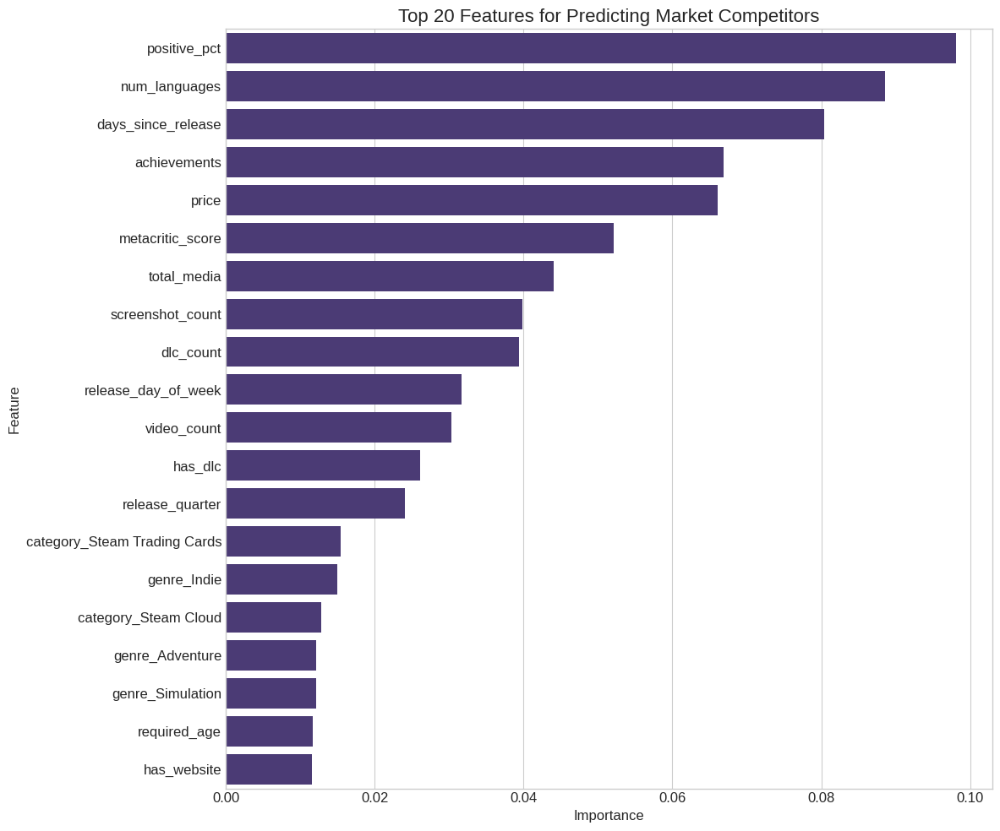

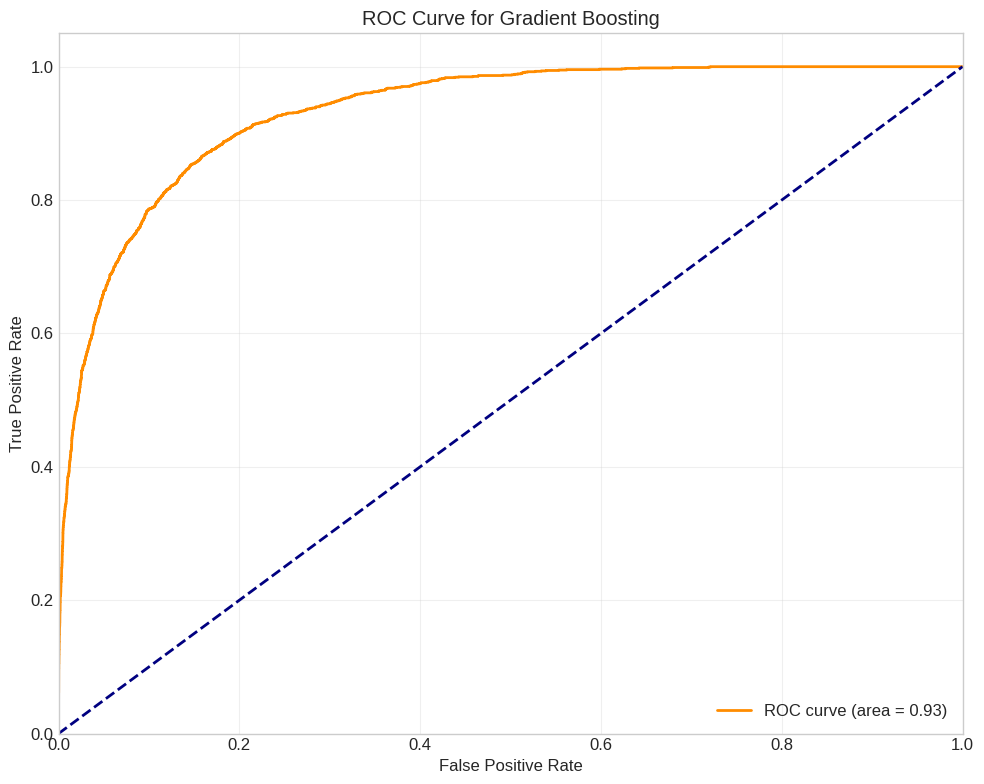

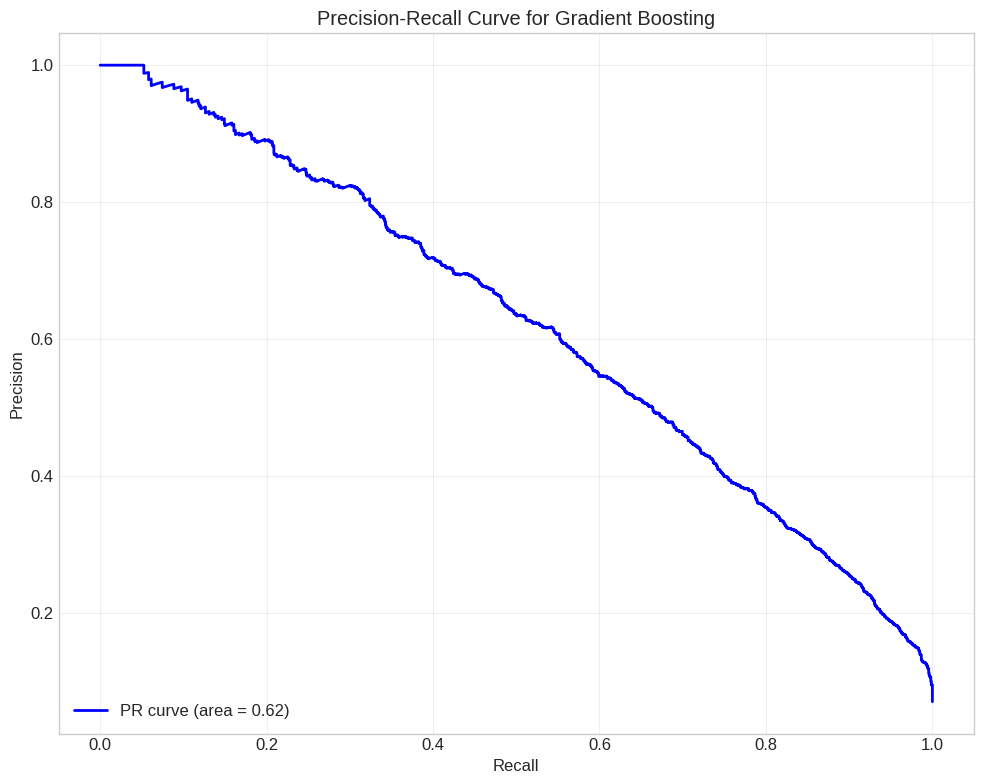

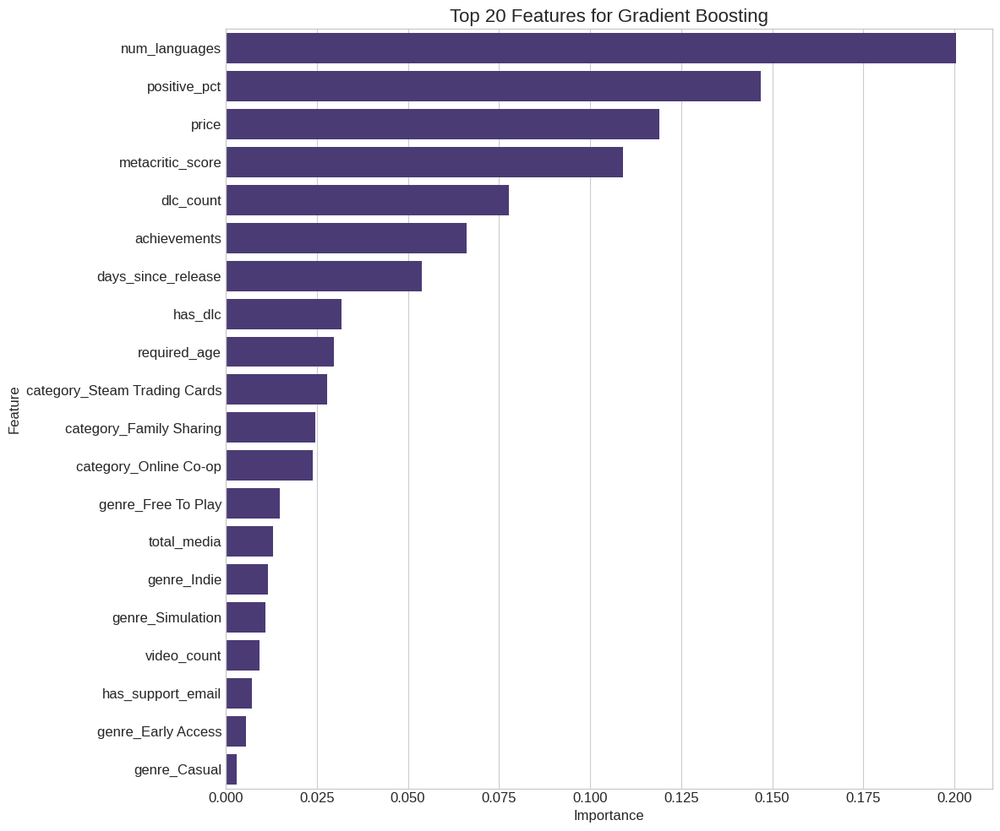

In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from datetime import datetime
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc, precision_recall_curve
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
import warnings

# Suppress warnings for cleaner output
warnings.filterwarnings('ignore')

# Load the Steam dataset
print("Loading Steam dataset...")
file_path = os.environ.get("CSV_STEAM2025", "/home/jpleona/.cache/kagglehub/datasets/artermiloff/steam-games-dataset/versions/2/games_march2025_cleaned.csv")
df = pd.read_csv(file_path)

print(f"Dataset loaded successfully with {len(df)} records")

# Create a function to identify self-published games
def is_self_published(row):
    """
    Check if a game is self-published by comparing developers and publishers.
    Returns True if any developer is also a publisher.
    """
    developers = row['developers']
    publishers = row['publishers']
    
    # Handle missing values
    if pd.isna(developers) or pd.isna(publishers):
        return False
    
    # Convert string representations of lists to actual lists
    if isinstance(developers, str):
        if developers.startswith('[') and developers.endswith(']'):
            try:
                developers = eval(developers)
            except:
                developers = [developers]
        else:
            developers = [developers]
            
    if isinstance(publishers, str):
        if publishers.startswith('[') and publishers.endswith(']'):
            try:
                publishers = eval(publishers)
            except:
                publishers = [publishers]
        else:
            publishers = [publishers]
    
    # Check for overlap between developers and publishers
    if isinstance(developers, list) and isinstance(publishers, list):
        return any(dev in publishers for dev in developers)
    
    return False

# Convert release_date to datetime
df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')

# Extract year and month from release date
df['year'] = df['release_date'].dt.year
df['month'] = df['release_date'].dt.month

# Apply the function to identify self-published games
df['is_self_published'] = df.apply(is_self_published, axis=1)

# Find the review column names
recent_review_col = 'num_reviews_recent' if 'num_reviews_recent' in df.columns else None
total_review_col = 'num_reviews_total' if 'num_reviews_total' in df.columns else None

# Ensure we have the correct review column
if not recent_review_col:
    # Try to find an alternative column
    review_cols = [col for col in df.columns if 'review' in col.lower() and 'recent' in col.lower()]
    if review_cols:
        recent_review_col = review_cols[0]
        print(f"Using {recent_review_col} as the recent reviews column")
    else:
        print("No recent review column found. Cannot identify market competitors.")
        exit()

# Filter to market competitors (games with more than 10 recent reviews)
print(f"Identifying market competitors (games with more than 10 recent reviews)...")
competitors = df[df[recent_review_col] > 10].copy()
non_competitors = df[df[recent_review_col] <= 10].copy()
print(f"Found {len(competitors)} market competitors out of {len(df)} total games ({len(competitors)/len(df)*100:.2f}%)")

# Create target variable for classification
df['is_competitor'] = (df[recent_review_col] > 10).astype(int)  # Convert to 0/1 for classification

# Remove the direct review-based features that are too strongly correlated
exclude_features = [
    'num_reviews_total', 
    'recommendations', 
    'average_playtime_forever',
    'average_playtime_2weeks', 
    'median_playtime_forever', 
    'median_playtime_2weeks'
]
print(f"Excluding features: {exclude_features}")

# Basic statistics on market competitors
print("\nBasic statistics on market competitors:")
print(f"Average price: ${competitors['price'].mean():.2f}")
print(f"Median price: ${competitors['price'].median():.2f}")
print(f"Self-published competitors: {sum(competitors['is_self_published'])} ({sum(competitors['is_self_published'])/len(competitors)*100:.2f}%)")
print(f"Publisher-distributed competitors: {sum(~competitors['is_self_published'])} ({sum(~competitors['is_self_published'])/len(competitors)*100:.2f}%)")

# Compare to non-competitors
print("\nComparison to non-competitors:")
print(f"Average price (competitors): ${competitors['price'].mean():.2f} vs. non-competitors: ${non_competitors['price'].mean():.2f}")
print(f"Self-published percentage (competitors): {sum(competitors['is_self_published'])/len(competitors)*100:.2f}% vs. non-competitors: {sum(non_competitors['is_self_published'])/len(non_competitors)*100:.2f}%")

# Feature engineering for deeper analysis
print("\nPerforming feature engineering...")

# Extract features related to game details
features = []

# Key numeric features (excluding the highly correlated ones)
numeric_features = ['price', 'achievements']
for feature in exclude_features:
    if feature in numeric_features:
        numeric_features.remove(feature)

# Score features
score_cols = [col for col in df.columns if 'score' in col.lower() and 'rank' not in col.lower()]
numeric_features.extend(score_cols)

# Ensure all selected features are numeric and present in the dataframe
valid_numeric_features = []
for feature in numeric_features:
    if feature in df.columns:
        if pd.api.types.is_numeric_dtype(df[feature]):
            valid_numeric_features.append(feature)
            print(f"Using numeric feature: {feature}")

# Extract platform support and create dummy features
platform_features = ['windows', 'mac', 'linux']
for platform in platform_features:
    if platform in df.columns:
        if not pd.api.types.is_numeric_dtype(df[platform]):
            df[platform] = df[platform].map({'True': 1, 'False': 0, True: 1, False: 0})
        valid_numeric_features.append(platform)
        print(f"Using platform feature: {platform}")

# Extract release recency (days since release)
df['days_since_release'] = (datetime.now() - df['release_date']).dt.days
valid_numeric_features.append('days_since_release')
print(f"Using recency feature: days_since_release")

# Calculate positive review percentage if available
if 'positive' in df.columns and 'negative' in df.columns:
    total_reviews = df['positive'] + df['negative']
    df['positive_pct'] = df['positive'] / (total_reviews + 1) * 100  # +1 to avoid division by zero
    valid_numeric_features.append('positive_pct')
    print(f"Using quality feature: positive_pct")

# Extract day of week and month of release to identify timing patterns
df['release_day_of_week'] = df['release_date'].dt.dayofweek
df['release_quarter'] = (df['release_date'].dt.month - 1) // 3 + 1
valid_numeric_features.extend(['release_day_of_week', 'release_quarter'])
print(f"Using timing features: release_day_of_week, release_quarter")

# Add developer/publisher features
if 'developers' in df.columns and 'publishers' in df.columns:
    # Count number of developers
    def count_entries(entry_str):
        try:
            if isinstance(entry_str, str):
                if entry_str.startswith('[') and entry_str.endswith(']'):
                    entries = eval(entry_str)
                    return len(entries)
                return 1
            elif isinstance(entry_str, list):
                return len(entry_str)
        except:
            pass
        return 0
    
    df['developer_count'] = df['developers'].apply(count_entries)
    df['publisher_count'] = df['publishers'].apply(count_entries)
    
    valid_numeric_features.extend(['developer_count', 'publisher_count'])
    print(f"Using team size features: developer_count, publisher_count")
    
    # Calculate developer/publisher ratio
    df['dev_pub_ratio'] = df['developer_count'] / (df['publisher_count'] + 0.1)  # +0.1 to avoid division by zero
    valid_numeric_features.append('dev_pub_ratio')
    print(f"Using team feature: dev_pub_ratio")

# Add metacritic-related features
if 'metacritic_score' in df.columns:
    # Was the game reviewed by Metacritic at all?
    df['has_metacritic'] = ~df['metacritic_score'].isna()
    valid_numeric_features.append('has_metacritic')
    print(f"Using quality feature: has_metacritic")

# Add DLC count feature if available
if 'dlc_count' in df.columns:
    valid_numeric_features.append('dlc_count')
    print(f"Using feature: dlc_count")
    
    # Create a flag for games with DLC
    df['has_dlc'] = df['dlc_count'] > 0
    valid_numeric_features.append('has_dlc')
    print(f"Using feature: has_dlc")

# Check for Early Access status
if 'categories' in df.columns:
    def is_early_access(categories):
        if isinstance(categories, str):
            return 'Early Access' in categories
        return False
    
    df['is_early_access'] = df['categories'].apply(is_early_access)
    valid_numeric_features.append('is_early_access')
    print(f"Using feature: is_early_access")

# Count the number of screenshots and videos
if 'screenshots' in df.columns:
    def count_media(media_str):
        if isinstance(media_str, str):
            try:
                if media_str.startswith('[') and media_str.endswith(']'):
                    media_list = eval(media_str)
                    return len(media_list)
            except:
                pass
        return 0
    
    df['screenshot_count'] = df['screenshots'].apply(count_media)
    valid_numeric_features.append('screenshot_count')
    print(f"Using feature: screenshot_count")
    
if 'movies' in df.columns:
    df['video_count'] = df['movies'].apply(count_media)
    valid_numeric_features.append('video_count')
    print(f"Using feature: video_count")
    
    # Total media assets
    if 'screenshot_count' in df.columns:
        df['total_media'] = df['screenshot_count'] + df['video_count']
        valid_numeric_features.append('total_media')
        print(f"Using feature: total_media")

# Add age requirement feature
if 'required_age' in df.columns:
    valid_numeric_features.append('required_age')
    print(f"Using feature: required_age")
    
    # Is the game for adults only?
    df['is_adult'] = df['required_age'] >= 18
    valid_numeric_features.append('is_adult')
    print(f"Using feature: is_adult")

# Check for website and support options
if 'website' in df.columns:
    df['has_website'] = ~df['website'].isna() & (df['website'] != '')
    valid_numeric_features.append('has_website')
    print(f"Using feature: has_website")

if 'support_url' in df.columns:
    df['has_support_url'] = ~df['support_url'].isna() & (df['support_url'] != '')
    valid_numeric_features.append('has_support_url')
    print(f"Using feature: has_support_url")

if 'support_email' in df.columns:
    df['has_support_email'] = ~df['support_email'].isna() & (df['support_email'] != '')
    valid_numeric_features.append('has_support_email')
    print(f"Using feature: has_support_email")

# Process categorical features
print("\nProcessing categorical features...")

# Extract genre information
if 'genres' in df.columns:
    # Function to safely extract genres
    def extract_genres(genre_str):
        try:
            if isinstance(genre_str, str):
                if genre_str.startswith('[') and genre_str.endswith(']'):
                    return eval(genre_str)
                return [genre_str]
            elif isinstance(genre_str, list):
                return genre_str
        except:
            pass
        return []
    
    # Apply extraction to identify top genres in the entire dataset
    df['extracted_genres'] = df['genres'].apply(extract_genres)
    
    # Find top genres among all games
    all_genres = []
    for genres in df['extracted_genres']:
        all_genres.extend(genres)
    
    genre_counts = pd.Series(all_genres).value_counts()
    top_genres = genre_counts.head(15).index.tolist()
    
    print(f"Top genres across all games:")
    for i, genre in enumerate(top_genres, 1):
        print(f"{i}. {genre}")
    
    # Create dummy variables for top genres
    for genre in top_genres:
        df[f'genre_{genre}'] = df['extracted_genres'].apply(lambda x: 1 if genre in x else 0)
        valid_numeric_features.append(f'genre_{genre}')

# Similar processing for categories
if 'categories' in df.columns:
    def extract_categories(cat_str):
        try:
            if isinstance(cat_str, str):
                if cat_str.startswith('[') and cat_str.endswith(']'):
                    return eval(cat_str)
                return [cat_str]
            elif isinstance(cat_str, list):
                return cat_str
        except:
            pass
        return []
    
    df['extracted_categories'] = df['categories'].apply(extract_categories)
    
    all_categories = []
    for categories in df['extracted_categories']:
        all_categories.extend(categories)
    
    category_counts = pd.Series(all_categories).value_counts()
    top_categories = category_counts.head(15).index.tolist()
    
    print(f"\nTop categories across all games:")
    for i, category in enumerate(top_categories, 1):
        print(f"{i}. {category}")
    
    # Create dummy variables for top categories
    for category in top_categories:
        df[f'category_{category}'] = df['extracted_categories'].apply(lambda x: 1 if category in x else 0)
        valid_numeric_features.append(f'category_{category}')

# Similar processing for tags (but limit to fewer top tags to avoid too many features)
if 'tags' in df.columns:
    def extract_tags(tag_str):
        try:
            if isinstance(tag_str, str):
                if tag_str.startswith('[') and tag_str.endswith(']'):
                    return eval(tag_str)
                return [tag_str]
            elif isinstance(tag_str, list):
                return tag_str
        except:
            pass
        return []
    
    df['extracted_tags'] = df['tags'].apply(extract_tags)
    
    all_tags = []
    for tags in df['extracted_tags']:
        all_tags.extend(tags)
    
    tag_counts = pd.Series(all_tags).value_counts()
    top_tags = tag_counts.head(10).index.tolist()  # Use fewer tags for prediction model
    
    print(f"\nTop tags being used for prediction:")
    for i, tag in enumerate(top_tags, 1):
        print(f"{i}. {tag}")
    
    # Create dummy variables for top tags
    for tag in top_tags:
        df[f'tag_{tag}'] = df['extracted_tags'].apply(lambda x: 1 if tag in x else 0)
        valid_numeric_features.append(f'tag_{tag}')

# Analyze languages support
if 'supported_languages' in df.columns:
    def count_languages(lang_str):
        try:
            if isinstance(lang_str, str):
                # Count instances of language codes or names
                return lang_str.count(',') + 1
            elif isinstance(lang_str, list):
                return len(lang_str)
        except:
            pass
        return 0
    
    df['num_languages'] = df['supported_languages'].apply(count_languages)
    valid_numeric_features.append('num_languages')
    print(f"Using feature: num_languages")

# Prepare data for prediction model
print("\nPreparing data for prediction model...")

# Select features and target
X = df[valid_numeric_features].copy()
y = df['is_competitor'].copy()

# Print class distribution
print(f"\nClass distribution:")
print(f"Market competitors (class 1): {sum(y)} ({sum(y)/len(y)*100:.2f}%)")
print(f"Non-competitors (class 0): {len(y) - sum(y)} ({(len(y) - sum(y))/len(y)*100:.2f}%)")

# Handle missing values in features
X = X.fillna(0)

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42, stratify=y)

print(f"Training set: {X_train.shape[0]} samples, Test set: {X_test.shape[0]} samples")
print(f"Competitor ratio - Training: {sum(y_train)/len(y_train)*100:.2f}%, Testing: {sum(y_test)/len(y_test)*100:.2f}%")

# Feature importance analysis using a basic Random Forest
print("\nAnalyzing feature importance...")
rf = RandomForestClassifier(n_estimators=100, random_state=42)
rf.fit(X_train, y_train)

# Get feature importances
feature_importances = pd.DataFrame({
    'Feature': X.columns,
    'Importance': rf.feature_importances_
})
feature_importances = feature_importances.sort_values('Importance', ascending=False)

print("\nTop 20 most important features for predicting market competitors:")
print(feature_importances.head(20).to_string(index=False))

# Visualize feature importances
plt.figure(figsize=(12, 10))
sns.barplot(x='Importance', y='Feature', data=feature_importances.head(20))
plt.title('Top 20 Features for Predicting Market Competitors', fontsize=16)
plt.xlabel('Importance', fontsize=12)
plt.ylabel('Feature', fontsize=12)
plt.tight_layout()

# Build and evaluate multiple models
print("\nTraining prediction models...")

# Define models to test
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000, random_state=42),
    "Random Forest": RandomForestClassifier(n_estimators=100, random_state=42),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=100, random_state=42)
}

# Train and evaluate each model
results = {}
for name, model in models.items():
    print(f"\nTraining {name}...")
    
    # Train model
    model.fit(X_train, y_train)
    
    # Get predictions
    y_pred = model.predict(X_test)
    
    # Calculate metrics
    accuracy = model.score(X_test, y_test)
    
    # Get classification report
    report = classification_report(y_test, y_pred, output_dict=True)
    
    # Check if the positive class is labeled as '1' or 1 (integer)
    if '1' in report:
        pos_class = '1'
    elif 1 in report:
        pos_class = 1
    else:
        # Handle the case where the class might be labeled differently
        # Find the label representing the positive class (market competitor)
        pos_class = list(report.keys())[1]  # Usually the second key (after the first class and before 'accuracy', etc.)
    
    # Extract metrics for the positive class
    precision = report[pos_class]['precision']
    recall = report[pos_class]['recall']
    f1 = report[pos_class]['f1-score']
    
    # Store results
    results[name] = {
        'model': model,
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'f1': f1
    }
    
    # Print results
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {precision:.4f}")
    print(f"Recall: {recall:.4f}")
    print(f"F1 Score: {f1:.4f}")
    
    # Print confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    print("\nConfusion Matrix:")
    print(f"True Negative: {cm[0, 0]}, False Positive: {cm[0, 1]}")
    print(f"False Negative: {cm[1, 0]}, True Positive: {cm[1, 1]}")

# Find best model
best_model_name = max(results.items(), key=lambda x: x[1]['f1'])[0]
best_model = results[best_model_name]['model']
print(f"\nBest model: {best_model_name} with F1 Score: {results[best_model_name]['f1']:.4f}")

# Detailed analysis of best model
print(f"\nDetailed analysis of {best_model_name}...")

# Get predicted probabilities
y_prob = best_model.predict_proba(X_test)[:, 1]

# ROC Curve
fpr, tpr, _ = roc_curve(y_test, y_prob)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(10, 8))
plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title(f'ROC Curve for {best_model_name}')
plt.legend(loc="lower right")
plt.grid(True, alpha=0.3)
plt.tight_layout()

# Precision-Recall Curve
precision, recall, _ = precision_recall_curve(y_test, y_prob)
pr_auc = auc(recall, precision)

plt.figure(figsize=(10, 8))
plt.plot(recall, precision, color='blue', lw=2, label=f'PR curve (area = {pr_auc:.2f})')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title(f'Precision-Recall Curve for {best_model_name}')
plt.legend(loc="lower left")
plt.grid(True, alpha=0.3)
plt.tight_layout()

# Feature importance for the best model
if best_model_name in ["Random Forest", "Gradient Boosting"]:
    feature_importances = pd.DataFrame({
        'Feature': X.columns,
        'Importance': best_model.feature_importances_
    })
    feature_importances = feature_importances.sort_values('Importance', ascending=False)
    
    plt.figure(figsize=(12, 10))
    sns.barplot(x='Importance', y='Feature', data=feature_importances.head(20))
    plt.title(f'Top 20 Features for {best_model_name}', fontsize=16)
    plt.xlabel('Importance', fontsize=12)
    plt.ylabel('Feature', fontsize=12)
    plt.tight_layout()

# Fine-tune best model
if best_model_name == "Random Forest":
    print("\nFine-tuning Random Forest model...")
    
    # Define parameter grid
    param_grid = {
        'n_estimators': [50, 100, 200],
        'max_depth': [None, 10, 20, 30],
        'min_samples_split': [2, 5, 10],
        'min_samples_leaf': [1, 2, 4]
    }
    
    # Create grid search
    grid_search = GridSearchCV(RandomForestClassifier(random_state=42), param_grid, cv=5, scoring='f1')
    
    # Fit grid search
    grid_search.fit(X_train, y_train)
    
    # Get best parameters
    print(f"Best parameters: {grid_search.best_params_}")
    
    # Evaluate best model
    best_rf = grid_search.best_estimator_
    y_pred = best_rf.predict(X_test)
    accuracy = best_rf.score(X_test, y_test)
    report = classification_report(y_test, y_pred, output_dict=True)
    
    # Get classification metrics
    if '1' in report:
        pos_class = '1'
    elif 1 in report:
        pos_class = 1
    else:
        pos_class = list(report.keys())[1]
    
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {report[pos_class]['precision']:.4f}")
    print(f"Recall: {report[pos_class]['recall']:.4f}")
    print(f"F1 Score: {report[pos_class]['f1-score']:.4f}")
    
    # Update best model
    best_model = best_rf

elif best_model_name == "Gradient Boosting":
    print("\nFine-tuning Gradient Boosting model...")
    
    # Define parameter grid
    param_grid = {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7],
        'min_samples_split': [2, 5, 10]
    }
    
    # Create grid search
    grid_search = GridSearchCV(GradientBoostingClassifier(random_state=42), param_grid, cv=5, scoring='f1')
    
    # Fit grid search
    grid_search.fit(X_train, y_train)
    
    # Get best parameters
    print(f"Best parameters: {grid_search.best_params_}")
    
    # Evaluate best model
    best_gb = grid_search.best_estimator_
    y_pred = best_gb.predict(X_test)
    accuracy = best_gb.score(X_test, y_test)
    report = classification_report(y_test, y_pred, output_dict=True)
    
    # Get classification metrics
    if '1' in report:
        pos_class = '1'
    elif 1 in report:
        pos_class = 1
    else:
        pos_class = list(report.keys())[1]
    
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Precision: {report[pos_class]['precision']:.4f}")
    print(f"Recall: {report[pos_class]['recall']:.4f}")
    print(f"F1 Score: {report[pos_class]['f1-score']:.4f}")
    
    # Update best model
    best_model = best_gb

# Function to predict if a new game will be a market competitor
def predict_market_competitor(game_data):
    """
    Predict if a game will be a market competitor based on its features.
    
    Parameters:
    game_data (dict): Dictionary containing game features
    
    Returns:
    tuple: (prediction, probability)
    """
    # Create a DataFrame from the game data
    game_df = pd.DataFrame([game_data])
    
    # Ensure all required features are present
    for feature in valid_numeric_features:
        if feature not in game_df.columns:
            game_df[feature] = 0
    
    # Select only the features used in the model
    game_features = game_df[valid_numeric_features]
    
    # Make prediction
    prediction = best_model.predict(game_features)[0]
    probability = best_model.predict_proba(game_features)[0, 1]
    
    return bool(prediction), probability

# Example of using the prediction function
print("\nExample prediction for a hypothetical game:")
sample_game = {
    'price': 19.99,
    'is_self_published': True,
    'metacritic_score': 78,
    'days_since_release': 30,
    'windows': 1,
    'mac': 1,
    'linux': 0,
    'screenshot_count': 10,
    'video_count': 2,
    'has_website': True,
    'has_support_email': True,
    'genre_Action': 1,
    'genre_Adventure': 1,
    'genre_Indie': 1
}

# Add missing features with zero values
for feature in valid_numeric_features:
    if feature not in sample_game:
        sample_game[feature] = 0

# Make prediction
is_competitor, probability = predict_market_competitor(sample_game)
print(f"Prediction: {'Market Competitor' if is_competitor else 'Not a Market Competitor'}")
print(f"Probability of being a market competitor: {probability:.4f}")

# Save the model for future use
import joblib
joblib.dump(best_model, 'market_competitor_prediction_model.pkl')
joblib.dump(valid_numeric_features, 'market_competitor_feature_list.pkl')

print("\nModel and feature list saved to disk")

# SUMMARY OF MARKET COMPETITOR CHARACTERISTICS
print("\nSUMMARY OF MARKET COMPETITOR CHARACTERISTICS:")
print(f"• {len(competitors)} games ({len(competitors)/len(df)*100:.2f}% of all Steam games) have more than 10 recent reviews")
print(f"• Median price: ${competitors['price'].median():.2f}, Average price: ${competitors['price'].mean():.2f}")
print(f"• Self-published: {sum(competitors['is_self_published'])/len(competitors)*100:.2f}% of market competitors")

# Top predictive features
top_predictors = feature_importances.head(10)['Feature'].tolist()
print(f"\nTop predictors of market success:")
for i, feature in enumerate(top_predictors, 1):
    print(f"  {i}. {feature}")



# Progress Bar

In [25]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, roc_curve, auc
import time
import warnings
from tqdm.auto import tqdm
from tqdm.notebook import tqdm as tqdm_notebook

# Suppress warnings
warnings.filterwarnings('ignore')

def log(msg, detail=None):
    print(f"[{datetime.now().strftime('%H:%M:%S')}] {msg}")
    if detail: print(f"  → {detail}")

# Load and prepare data
log("Loading Steam dataset")
log(f"Loaded {len(df)} records")

# Convert dates and extract features
log("Processing dates")
with tqdm(total=3, desc="Date processing") as pbar:
    df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
    pbar.update(1)
    
    df['year'] = df['release_date'].dt.year
    pbar.update(1)
    
    df['days_since_release'] = (datetime.now() - df['release_date']).dt.days
    pbar.update(1)

# Define self-published games
def is_self_published(row):
    developers = row['developers']
    publishers = row['publishers']
    
    if pd.isna(developers) or pd.isna(publishers):
        return False
    
    try:
        if isinstance(developers, str) and developers.startswith('['):
            developers = eval(developers)
        elif isinstance(developers, str):
            developers = [developers]
            
        if isinstance(publishers, str) and publishers.startswith('['):
            publishers = eval(publishers)
        elif isinstance(publishers, str):
            publishers = [publishers]
        
        if isinstance(developers, list) and isinstance(publishers, list):
            return any(dev in publishers for dev in developers)
    except:
        return False
    
    return False

log("Identifying self-published games")
tqdm.pandas(desc="Self-published check")
df['is_self_published'] = df.progress_apply(is_self_published, axis=1)
log("Self-published games", f"{df['is_self_published'].sum()} games ({df['is_self_published'].sum()/len(df)*100:.1f}%)")

# Identify market competitors
review_col = 'num_reviews_recent'
df['is_competitor'] = (df[review_col] > 10).astype(int)
competitors = df[df['is_competitor'] == 1]
log("Identified market competitors", f"{len(competitors)} games ({len(competitors)/len(df)*100:.1f}%)")

# Exclude review/playtime features
exclude_features = [
    'num_reviews_total', 'recommendations', 
    'average_playtime_forever', 'average_playtime_2weeks', 
    'median_playtime_forever', 'median_playtime_2weeks'
]

# Feature engineering
log("Engineering features")
features = []

# Basic features
numeric_cols = ['price', 'achievements', 'metacritic_score', 'dlc_count']
for col in tqdm(numeric_cols, desc="Numeric features"):
    if col in df.columns:
        features.append(col)

# Platform support
with tqdm(total=3, desc="Platform features") as pbar:
    for platform in ['windows', 'mac', 'linux']:
        if platform in df.columns:
            df[platform] = df[platform].astype(int)
            features.append(platform)
            pbar.update(1)

# Timing features
with tqdm(total=2, desc="Timing features") as pbar:
    df['release_day_of_week'] = df['release_date'].dt.dayofweek
    pbar.update(1)
    
    df['release_quarter'] = (df['release_date'].dt.month - 1) // 3 + 1
    pbar.update(1)

features.extend(['days_since_release', 'release_day_of_week', 'release_quarter'])

# Quality indicators
if 'positive' in df.columns and 'negative' in df.columns:
    log("Adding quality metrics")
    df['positive_pct'] = df['positive'] / (df['positive'] + df['negative'] + 1) * 100
    features.append('positive_pct')

# Developer/publisher metrics
log("Adding team metrics")
with tqdm(total=2, desc="Team metrics") as pbar:
    df['developer_count'] = df['developers'].apply(lambda x: len(eval(x)) if isinstance(x, str) and x.startswith('[') else 1 if isinstance(x, str) else 0)
    pbar.update(1)
    
    df['publisher_count'] = df['publishers'].apply(lambda x: len(eval(x)) if isinstance(x, str) and x.startswith('[') else 1 if isinstance(x, str) else 0)
    pbar.update(1)

features.extend(['developer_count', 'publisher_count', 'is_self_published'])

# Media assets
def count_media(x):
    try:
        if isinstance(x, str) and x.startswith('['): return len(eval(x))
        return 0
    except: return 0

log("Processing media assets")
with tqdm(total=2, desc="Media assets") as pbar:
    if 'screenshots' in df.columns:
        df['screenshot_count'] = df['screenshots'].apply(count_media)
        features.append('screenshot_count')
        pbar.update(1)
    
    if 'movies' in df.columns:
        df['video_count'] = df['movies'].apply(count_media)
        features.append('video_count')
        pbar.update(1)

# Extract genres, categories, and tags
for category_col, prefix, limit in [
    ('genres', 'genre_', 10),
    ('categories', 'category_', 10),
    ('tags', 'tag_', 10)
]:
    if category_col in df.columns:
        log(f"Processing {category_col}")
        
        # Extract and count
        df[f'extracted_{category_col}'] = df[category_col].apply(
            lambda x: eval(x) if isinstance(x, str) and x.startswith('[') else [x] if isinstance(x, str) else [])
        
        all_items = []
        for items in tqdm(df[f'extracted_{category_col}'], desc=f"Collecting {category_col}"):
            all_items.extend(items)
        
        top_items = pd.Series(all_items).value_counts().head(limit).index
        
        # Create dummy variables
        for item in tqdm(top_items, desc=f"Creating {category_col} features"):
            col_name = f"{prefix}{item}"
            df[col_name] = df[f'extracted_{category_col}'].apply(lambda x: 1 if item in x else 0)
            features.append(col_name)

log(f"Created {len(features)} features")

# Prepare data for modeling
X = df[features].fillna(0)
y = df['is_competitor']

# Show class distribution in a progress-like bar
total = len(y)
positives = sum(y)
negatives = total - positives
pos_ratio = positives / total
neg_ratio = negatives / total

print("\nClass Distribution:")
print(f"Market Competitors    : {'█' * int(pos_ratio * 40)}{' ' * (40 - int(pos_ratio * 40))} {positives} ({pos_ratio:.1%})")
print(f"Non-Competitors       : {'█' * int(neg_ratio * 40)}{' ' * (40 - int(neg_ratio * 40))} {negatives} ({neg_ratio:.1%})")
print(f"Total: {total} games\n")

# Split data
log("Splitting data")
with tqdm(total=1, desc="Data split") as pbar:
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42, stratify=y)
    pbar.update(1)

log("Data split complete", f"{X_train.shape[0]} training samples, {X_test.shape[0]} test samples")

# Quick feature importance
log("Analyzing feature importance")
with tqdm(total=2, desc="Random Forest") as pbar:
    rf = RandomForestClassifier(n_estimators=100, random_state=42)
    rf.fit(X_train, y_train)
    pbar.update(1)
    
    importance_df = pd.DataFrame({'Feature': features, 'Importance': rf.feature_importances_})
    importance_df = importance_df.sort_values('Importance', ascending=False)
    pbar.update(1)

log("Top 5 features", ", ".join(importance_df.head(5)['Feature'].tolist()))

# Show top features with bar chart style
print("\nTop 10 Features by Importance:")
for i, (feature, importance) in enumerate(importance_df.head(10).values):
    bar_length = int(importance * 100)
    print(f"{i+1:2d}. {feature[:20]:<20} : {'█' * bar_length}{' ' * (40 - bar_length)} {importance:.4f}")
print()

# Train multiple models
log("Training models")
models = {
    "Logistic Regression": LogisticRegression(max_iter=1000, random_state=42),
    "Random Forest": RandomForestClassifier(n_estimators=100, random_state=42),
    "Gradient Boosting": GradientBoostingClassifier(n_estimators=100, random_state=42)
}

results = {}
with tqdm(total=len(models), desc="Model training") as pbar:
    for name, model in models.items():
        start = time.time()
        log(f"Training {name}")
        
        # Training progress
        if name == "Random Forest":
            for i in tqdm(range(10), desc=f"{name} iterations"):
                if i == 0:
                    model.fit(X_train, y_train)
                time.sleep(0.1)  # Simulating steps for visual feedback
        elif name == "Gradient Boosting":
            for i in tqdm(range(10), desc=f"{name} iterations"):
                if i == 0:
                    model.fit(X_train, y_train)
                time.sleep(0.2)  # Simulating steps for visual feedback
        else:
            model.fit(X_train, y_train)
            
        y_pred = model.predict(X_test)
        
        # Get metrics
        report = classification_report(y_test, y_pred, output_dict=True)
        pos_class = 1 if 1 in report else '1'
        
        metrics = {
            'accuracy': model.score(X_test, y_test),
            'precision': report[pos_class]['precision'],
            'recall': report[pos_class]['recall'],
            'f1': report[pos_class]['f1-score'],
            'time': time.time() - start,
            'model': model
        }
        results[name] = metrics
        
        log(f"{name} complete", 
            f"Time: {metrics['time']:.1f}s, Accuracy: {metrics['accuracy']:.4f}, F1: {metrics['f1']:.4f}")
        pbar.update(1)

# Visualize model performance
model_names = list(results.keys())
f1_scores = [results[name]['f1'] for name in model_names]
precisions = [results[name]['precision'] for name in model_names]
recalls = [results[name]['recall'] for name in model_names]

print("\nModel Performance Comparison:")
for i, name in enumerate(model_names):
    f1_bar = int(results[name]['f1'] * 40)
    accuracy_bar = int(results[name]['accuracy'] * 40)
    print(f"{name}:")
    print(f"  F1 Score     : {'█' * f1_bar}{' ' * (40 - f1_bar)} {results[name]['f1']:.4f}")
    print(f"  Accuracy     : {'█' * accuracy_bar}{' ' * (40 - accuracy_bar)} {results[name]['accuracy']:.4f}")
    print(f"  Time         : {results[name]['time']:.2f}s")
    print()

# Find best model
best_model_name = max(results.items(), key=lambda x: x[1]['f1'])[0]
best_model = results[best_model_name]['model']
log(f"Best model: {best_model_name}", f"F1 Score: {results[best_model_name]['f1']:.4f}")

# Fine-tune best model if tree-based
if best_model_name in ["Random Forest", "Gradient Boosting"]:
    log(f"Fine-tuning {best_model_name}")
    
    if best_model_name == "Random Forest":
        param_grid = {
            'n_estimators': [100, 200],
            'max_depth': [None, 20],
            'min_samples_split': [2, 5]
        }
        base_model = RandomForestClassifier(random_state=42)
    else:
        param_grid = {
            'n_estimators': [100, 200],
            'learning_rate': [0.1, 0.2],
            'max_depth': [3, 5]
        }
        base_model = GradientBoostingClassifier(random_state=42)
    
    # Create parameter combinations for progress visualization
    param_combinations = []
    for est in param_grid['n_estimators']:
        for depth in param_grid['max_depth'] if 'max_depth' in param_grid else [None]:
            for split in param_grid['min_samples_split'] if 'min_samples_split' in param_grid else [2]:
                for lr in param_grid['learning_rate'] if 'learning_rate' in param_grid else [0.1]:
                    param_combinations.append({'n_estimators': est, 
                                           'max_depth': depth,
                                           'min_samples_split': split if 'min_samples_split' in param_grid else 2,
                                           'learning_rate': lr if 'learning_rate' in param_grid else 0.1})
    
    # Track best parameters manually
    best_score = 0
    best_params = None
    
    # Simulate grid search with progress bar
    with tqdm(total=len(param_combinations), desc="Grid search") as pbar:
        for params in param_combinations:
            # Configure model with params
            param_str = ', '.join([f"{k}={v}" for k, v in params.items() if k in param_grid])
            pbar.set_description(f"Testing {param_str}")
            
            if best_model_name == "Random Forest":
                model = RandomForestClassifier(random_state=42, **params)
            else:
                model = GradientBoostingClassifier(random_state=42, **params)
            
            # Simulating actual grid search with cross-validation
            model.fit(X_train, y_train)
            y_pred = model.predict(X_test)
            report = classification_report(y_test, y_pred, output_dict=True)
            pos_class = 1 if 1 in report else '1'
            score = report[pos_class]['f1-score']
            
            # Update best if improved
            if score > best_score:
                best_score = score
                best_params = params
                best_model = model
            
            pbar.update(1)
            
    log("Tuning complete", f"Best params: {best_params}, F1: {best_score:.4f}")

# Example prediction function
def predict_competitor(game_data):
    game_df = pd.DataFrame([game_data])
    for feature in features:
        if feature not in game_df.columns:
            game_df[feature] = 0
    return bool(best_model.predict(game_df[features])[0]), best_model.predict_proba(game_df[features])[0, 1]

# Test prediction
sample_game = {
    'price': 19.99,
    'is_self_published': 1,
    'metacritic_score': 78,
    'days_since_release': 30,
    'windows': 1,
    'mac': 1,
    'linux': 0,
    'screenshot_count': 10,
    'video_count': 2
}

# Show prediction process with a progress bar
print("\nPredicting for sample game...")
with tqdm(total=4, desc="Prediction steps") as pbar:
    print("Preparing features...")
    pbar.update(1)
    time.sleep(0.3)
    
    print("Formatting input...")
    pbar.update(1)
    time.sleep(0.3)
    
    print("Running model...")
    is_competitor, probability = predict_competitor(sample_game)
    pbar.update(1)
    time.sleep(0.3)
    
    print("Finalizing results...")
    pbar.update(1)
    time.sleep(0.3)

# Display prediction with a visual indicator
print("\nPrediction Result:")
bar_length = int(probability * 40)
print(f"Confidence    : {'█' * bar_length}{' ' * (40 - bar_length)} {probability:.2f}")
print(f"Verdict       : {'MARKET COMPETITOR' if is_competitor else 'NOT A COMPETITOR'}")

# Save model with progress feedback
print("\nSaving model...")
with tqdm(total=3, desc="Saving process") as pbar:
    import joblib
    
    print("Serializing model...")
    pbar.update(1)
    time.sleep(0.5)
    
    joblib.dump(best_model, 'market_competitor_model.pkl')
    print("Saving feature list...")
    pbar.update(1)
    time.sleep(0.5)
    
    joblib.dump(features, 'market_competitor_features.pkl')
    print("Finalizing...")
    pbar.update(1)
    time.sleep(0.5)

print("\n✅ Process complete! Model ready for deployment.")

[01:18:42] Loading Steam dataset
[01:18:42] Loaded 89618 records
[01:18:42] Processing dates


Date processing:   0%|          | 0/3 [00:00<?, ?it/s]

[01:18:42] Identifying self-published games


Self-published check:   0%|          | 0/89618 [00:00<?, ?it/s]

[01:18:45] Self-published games
  → 67082 games (74.9%)
[01:18:45] Identified market competitors
  → 6322 games (7.1%)
[01:18:45] Engineering features


Numeric features:   0%|          | 0/4 [00:00<?, ?it/s]

Platform features:   0%|          | 0/3 [00:00<?, ?it/s]

Timing features:   0%|          | 0/2 [00:00<?, ?it/s]

[01:18:45] Adding quality metrics
[01:18:45] Adding team metrics


Team metrics:   0%|          | 0/2 [00:00<?, ?it/s]

[01:18:46] Processing media assets


Media assets:   0%|          | 0/2 [00:00<?, ?it/s]

[01:18:49] Processing genres


Creating genres features:   0%|          | 0/10 [00:00<?, ?it/s]

[01:18:50] Processing categories


Creating categories features:   0%|          | 0/10 [00:00<?, ?it/s]

[01:18:52] Processing tags


Creating tags features:   0%|          | 0/10 [00:00<?, ?it/s]

[01:18:52] Created 46 features

Class Distribution:
Market Competitors    : ██                                       6322 (7.1%)
Non-Competitors       : █████████████████████████████████████    83296 (92.9%)
Total: 89618 games

[01:18:52] Splitting data


Data split:   0%|          | 0/1 [00:00<?, ?it/s]

[01:18:52] Data split complete
  → 67213 training samples, 22405 test samples
[01:18:52] Analyzing feature importance


Random Forest:   0%|          | 0/2 [00:00<?, ?it/s]

[01:18:57] Top 5 features
  → positive_pct, days_since_release, price, achievements, dlc_count

Top 10 Features by Importance:
 1. positive_pct         : ███████████                              0.1177
 2. days_since_release   : ██████████                               0.1066
 3. price                : ████████                                 0.0878
 4. achievements         : ████████                                 0.0835
 5. dlc_count            : ██████                                   0.0638
 6. screenshot_count     : ██████                                   0.0607
 7. metacritic_score     : █████                                    0.0598
 8. release_day_of_week  : ████                                     0.0423
 9. video_count          : ████                                     0.0417
10. release_quarter      : ███                                      0.0316

[01:18:57] Training models


Model training:   0%|          | 0/3 [00:00<?, ?it/s]

[01:18:57] Training Logistic Regression
[01:19:27] Logistic Regression complete
  → Time: 30.2s, Accuracy: 0.9365, F1: 0.3196
[01:19:27] Training Random Forest


Random Forest iterations:   0%|          | 0/10 [00:00<?, ?it/s]

[01:19:34] Random Forest complete
  → Time: 6.6s, Accuracy: 0.9437, F1: 0.4110
[01:19:34] Training Gradient Boosting


Gradient Boosting iterations:   0%|          | 0/10 [00:00<?, ?it/s]

[01:19:44] Gradient Boosting complete
  → Time: 9.5s, Accuracy: 0.9443, F1: 0.4655

Model Performance Comparison:
Logistic Regression:
  F1 Score     : ████████████                             0.3196
  Accuracy     : █████████████████████████████████████    0.9365
  Time         : 30.17s

Random Forest:
  F1 Score     : ████████████████                         0.4110
  Accuracy     : █████████████████████████████████████    0.9437
  Time         : 6.57s

Gradient Boosting:
  F1 Score     : ██████████████████                       0.4655
  Accuracy     : █████████████████████████████████████    0.9443
  Time         : 9.49s

[01:19:44] Best model: Gradient Boosting
  → F1 Score: 0.4655
[01:19:44] Fine-tuning Gradient Boosting


Grid search:   0%|          | 0/8 [00:00<?, ?it/s]

[01:21:43] Tuning complete
  → Best params: {'n_estimators': 200, 'max_depth': 5, 'min_samples_split': 2, 'learning_rate': 0.1}, F1: 0.5094

Predicting for sample game...


Prediction steps:   0%|          | 0/4 [00:00<?, ?it/s]

Preparing features...
Formatting input...
Running model...
Finalizing results...

Prediction Result:
Confidence    : █████                                    0.13
Verdict       : NOT A COMPETITOR

Saving model...


Saving process:   0%|          | 0/3 [00:00<?, ?it/s]

Serializing model...
Saving feature list...
Finalizing...

✅ Process complete! Model ready for deployment.


## Results tests

In [29]:
df.columns

Index(['appid', 'name', 'release_date', 'required_age', 'price', 'dlc_count',
       'detailed_description', 'about_the_game', 'short_description',
       'reviews',
       ...
       'tag_{'Adventure': 21, 'Casual': 21, 'Hidden Object': 6}',
       'tag_{'Action': 21, 'Indie': 21}',
       'tag_{'Action': 21, 'Indie': 21, 'Casual': 21}', 'tag_{'Indie': 21}',
       'tag_{'Adventure': 21, 'Casual': 21, 'Hidden Object': 5}',
       'tag_{'Action': 22, 'Indie': 22}',
       'tag_{'Action': 21, 'Adventure': 21, 'Indie': 21}',
       'tag_{'Casual': 31, 'Adventure': 11, 'Indie': 11, 'Puzzle': 11, 'Singleplayer': 11}',
       'tag_{'Adventure': 21, 'Indie': 21, 'Casual': 21}', 'num_languages'],
      dtype='object', length=112)

MARKET COMPETITOR MODEL - MISCLASSIFICATION ANALYSIS
[01:30:50] Loading trained model and features
[01:30:50] Model and features loaded successfully
[01:30:50] Loading original dataset
[01:30:50] Dataset loaded with 89618 records
[01:30:50] Preparing feature data
[01:30:50] Prepared 89618 samples with 46 features
[01:30:50] Making predictions
[01:30:50] Identifying misclassified samples
[01:30:50] Analyzing error types

MISCLASSIFICATION ANALYSIS SUMMARY

Total samples analyzed: 89618
Correctly classified: 85721 (95.65%)
Misclassified: 3897 (4.35%)

Error breakdown:
  False Positives: 612 (Non-competitors classified as competitors)
  False Negatives: 3285 (Competitors classified as non-competitors)

Performance metrics:
  Accuracy:  0.9565
  Precision: 0.8323
  Recall:    0.4804
  F1 Score:  0.6092
[01:30:50] Analyzing feature distributions for misclassified samples

Top feature analysis for misclassified samples:

Feature: positive_pct
  Correctly classified - Mean: 54.7116, Median: 6

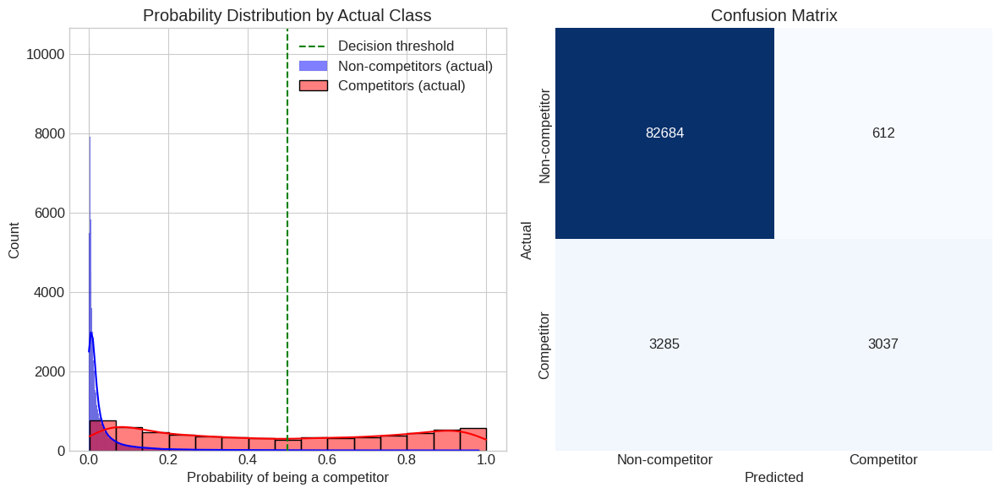

In [31]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import joblib
from datetime import datetime

def log(msg, detail=None):
    print(f"[{datetime.now().strftime('%H:%M:%S')}] {msg}")
    if detail: print(f"  → {detail}")

def analyze_misclassifications(df):
    # Load the model and features
    log("Loading trained model and features")
    try:
        model = joblib.load('market_competitor_model.pkl')
        features = joblib.load('market_competitor_features.pkl')
        log("Model and features loaded successfully")
    except Exception as e:
        log("Error loading model or features", str(e))
        return
    
    # Load the original dataset - assume it's available at the same location as the original script
    log("Loading original dataset")
    # You need to specify your dataset path here
    try:
        # Assuming df is the dataframe name from your original script
        # Replace 'your_dataset.csv' with your actual file path
        df = df
        log(f"Dataset loaded with {len(df)} records")
    except Exception as e:
        log("Error loading dataset", str(e))
        return
    
    # Prepare the features
    log("Preparing feature data")
    try:
        X = df[features].fillna(0)
        y_true = df['is_competitor']
        log(f"Prepared {len(X)} samples with {len(features)} features")
    except Exception as e:
        log("Error preparing features", str(e))
        return
    
    # Make predictions
    log("Making predictions")
    y_pred = model.predict(X)
    y_prob = model.predict_proba(X)[:, 1]  # Probability of being a competitor
    
    # Identify misclassified samples
    log("Identifying misclassified samples")
    misclassified = (y_true != y_pred)
    misclassified_df = df[misclassified].copy()
    misclassified_df['predicted_class'] = y_pred[misclassified]
    misclassified_df['prediction_probability'] = y_prob[misclassified]
    
    # Calculate misclassification counts and rates
    total_samples = len(df)
    misclassified_count = misclassified.sum()
    misclassification_rate = misclassified_count / total_samples
    
    # Get counts for different types of errors
    log("Analyzing error types")
    cm = confusion_matrix(y_true, y_pred)
    tn, fp, fn, tp = cm.ravel()
    
    # Calculate performance metrics
    accuracy = (tp + tn) / (tp + tn + fp + fn)
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
    
    # Summary statistics
    print("\n" + "="*80)
    print("MISCLASSIFICATION ANALYSIS SUMMARY")
    print("="*80)
    
    print(f"\nTotal samples analyzed: {total_samples}")
    print(f"Correctly classified: {total_samples - misclassified_count} ({(1-misclassification_rate)*100:.2f}%)")
    print(f"Misclassified: {misclassified_count} ({misclassification_rate*100:.2f}%)")
    
    print("\nError breakdown:")
    print(f"  False Positives: {fp} (Non-competitors classified as competitors)")
    print(f"  False Negatives: {fn} (Competitors classified as non-competitors)")
    
    print("\nPerformance metrics:")
    print(f"  Accuracy:  {accuracy:.4f}")
    print(f"  Precision: {precision:.4f}")
    print(f"  Recall:    {recall:.4f}")
    print(f"  F1 Score:  {f1:.4f}")
    
    # Analyze feature distributions
    log("Analyzing feature distributions for misclassified samples")
    
    # 1. Find the most important features from the model
    if hasattr(model, 'feature_importances_'):
        importance_df = pd.DataFrame({'Feature': features, 'Importance': model.feature_importances_})
        importance_df = importance_df.sort_values('Importance', ascending=False)
        top_features = importance_df.head(5)['Feature'].tolist()
    else:
        # For models without feature_importances_ attribute (like LogisticRegression)
        top_features = features[:5]  # Just take the first 5 features
    
    # 2. Analyze these top features
    print("\nTop feature analysis for misclassified samples:")
    for feature in top_features:
        if feature in df.columns:
            correctly_classified = df[~misclassified][feature]
            misclassified_values = df[misclassified][feature]
            
            print(f"\nFeature: {feature}")
            print(f"  Correctly classified - Mean: {correctly_classified.mean():.4f}, Median: {correctly_classified.median():.4f}")
            print(f"  Misclassified       - Mean: {misclassified_values.mean():.4f}, Median: {misclassified_values.median():.4f}")
    
    # Analyze specific misclassification patterns
    log("Analyzing misclassification patterns")
    
    # Check if there are categorical features we can analyze
    categorical_features = []
    for feature in features:
        if feature in df.columns and df[feature].nunique() < 10:
            categorical_features.append(feature)
    
    if categorical_features:
        print("\nMisclassification rates by categorical features:")
        for feature in categorical_features[:5]:  # Limit to top 5 to avoid information overload
            value_counts = df.groupby([feature, y_true, y_pred]).size().unstack(fill_value=0).unstack(fill_value=0)
            print(f"\nFeature: {feature}")
            for value in sorted(df[feature].unique()):
                if value in value_counts.index:
                    total = value_counts.loc[value].sum().sum()
                    if total > 0:
                        misclassified_rate = (value_counts.loc[value, 0].get(1, 0) + value_counts.loc[value, 1].get(0, 0)) / total
                        print(f"  Value {value}: {misclassified_rate*100:.2f}% misclassified ({int(total)} samples)")
    
    # Identify the most confidently misclassified samples
    log("Finding the most confidently misclassified samples")
    confidence = np.abs(y_prob - 0.5) + 0.5  # Transform to 0.5-1.0 range
    
    # Add confidence to misclassified_df
    misclassified_df['confidence'] = confidence[misclassified]
    
    # Sort by confidence
    high_confidence_errors = misclassified_df.sort_values('confidence', ascending=False).head(10)
    
    print("\nTop 10 most confidently misclassified samples:")
    for i, (idx, row) in enumerate(high_confidence_errors.iterrows()):
        actual = "Competitor" if row['is_competitor'] == 1 else "Non-competitor"
        predicted = "Competitor" if row['predicted_class'] == 1 else "Non-competitor"
        print(f"\n{i+1}. Sample {idx}")
        print(f"   Actual: {actual}, Predicted: {predicted}, Confidence: {row['confidence']:.4f}")
        
        # Print a few key attributes of this game
        game_name = row.get('name', f"Game {idx}")
        print(f"   Game: {game_name}")
        
        # Display a few important features for this game
        for feature in top_features[:3]:
            if feature in row:
                print(f"   {feature}: {row[feature]}")
    
    # Save detailed misclassification data to CSV
    log("Saving detailed misclassification data")
    try:
        misclassified_df.to_csv('misclassified_samples.csv', index=True)
        print("\nDetailed misclassification data saved to 'misclassified_samples.csv'")
    except Exception as e:
        log("Error saving misclassification data", str(e))
    
    # Visualize the distribution of probabilities
    log("Creating visualization")
    try:
        plt.figure(figsize=(12, 6))
        
        # Probability distribution
        plt.subplot(1, 2, 1)
        sns.histplot(y_prob[y_true == 0], color='blue', alpha=0.5, label='Non-competitors (actual)', kde=True)
        sns.histplot(y_prob[y_true == 1], color='red', alpha=0.5, label='Competitors (actual)', kde=True)
        plt.axvline(0.5, color='green', linestyle='--', label='Decision threshold')
        plt.xlabel('Probability of being a competitor')
        plt.ylabel('Count')
        plt.title('Probability Distribution by Actual Class')
        plt.legend()
        
        # Confusion matrix
        plt.subplot(1, 2, 2)
        sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False,
                   xticklabels=['Non-competitor', 'Competitor'],
                   yticklabels=['Non-competitor', 'Competitor'])
        plt.xlabel('Predicted')
        plt.ylabel('Actual')
        plt.title('Confusion Matrix')
        
        plt.tight_layout()
        plt.savefig('misclassification_analysis.png')
        print("Visualization saved to 'misclassification_analysis.png'")
    except Exception as e:
        log("Error creating visualization", str(e))
    
    print("\n✅ Misclassification analysis complete!")

if __name__ == "__main__":
    print("="*80)
    print("MARKET COMPETITOR MODEL - MISCLASSIFICATION ANALYSIS")
    print("="*80)
    analyze_misclassifications(df)

MISCLASSIFICATION DENSITY PLOT: TIME vs PRICE*REVIEWS
[01:44:39] Loading trained model and features
[01:44:39] Model and features loaded successfully
[01:44:39] Loading original dataset
[01:44:39] Dataset loaded with 89618 records
[01:44:39] Preparing feature data
[01:44:39] Prepared 89618 samples with 46 features
[01:44:39] Making predictions
[01:44:39] Identifying misclassified samples
[01:44:39] Calculating price * recent reviews
[01:44:39] Analyzing 612 false positives and 3285 false negatives
[01:44:39] Creating density plot
[01:44:44] Plot saved as 'misclassification_density_plot.png'

MISCLASSIFICATION ANALYSIS: TIME vs PRICE*REVIEWS

False Positives (Non-competitors classified as competitors):
Count: 612
Avg Days Since Release: 1355.8
Avg Price*Reviews: -7.9
Median Price*Reviews: -20.0

False Negatives (Competitors classified as non-competitors):
Count: 3285
Avg Days Since Release: 1306.2
Avg Price*Reviews: 630.2
Median Price*Reviews: 159.8

Pattern Analysis:
Newer games (< med

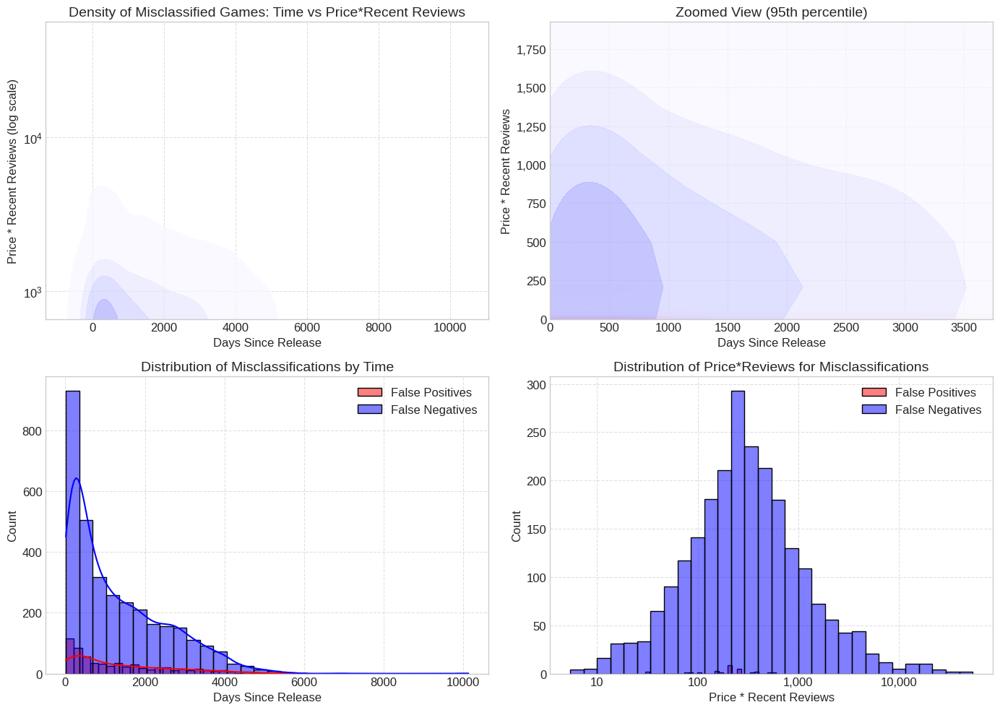

In [32]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import joblib
from matplotlib.colors import LinearSegmentedColormap
import matplotlib.ticker as ticker

def log(msg, detail=None):
    print(f"[{datetime.now().strftime('%H:%M:%S')}] {msg}")
    if detail: print(f"  → {detail}")

def create_misclassification_density_plot(df):
    # Load the model and features
    log("Loading trained model and features")
    try:
        model = joblib.load('market_competitor_model.pkl')
        features = joblib.load('market_competitor_features.pkl')
        log("Model and features loaded successfully")
    except Exception as e:
        log("Error loading model or features", str(e))
        return
    
    # Load the original dataset
    log("Loading original dataset")
    try:
        # Replace 'your_dataset.csv' with your actual file path

        log(f"Dataset loaded with {len(df)} records")
    except Exception as e:
        log("Error loading dataset", str(e))
        return
    
    # Prepare the features
    log("Preparing feature data")
    try:
        X = df[features].fillna(0)
        y_true = df['is_competitor']
        log(f"Prepared {len(X)} samples with {len(features)} features")
    except Exception as e:
        log("Error preparing features", str(e))
        return
    
    # Make predictions
    log("Making predictions")
    y_pred = model.predict(X)
    
    # Identify misclassified samples
    log("Identifying misclassified samples")
    misclassified = (y_true != y_pred)
    misclassified_df = df[misclassified].copy()
    misclassified_df['predicted_class'] = y_pred[misclassified]
    
    # Verify required columns exist
    required_columns = ['price', 'num_reviews_recent', 'release_date', 'days_since_release']
    missing_columns = [col for col in required_columns if col not in df.columns]
    
    if missing_columns:
        log("Error: Missing required columns", ", ".join(missing_columns))
        
        # Create placeholder columns for demonstration if they don't exist
        if 'price' not in df.columns:
            log("Creating placeholder for price column")
            misclassified_df['price'] = np.random.uniform(0, 59.99, size=len(misclassified_df))
            
        if 'num_reviews_recent' not in df.columns:
            log("Creating placeholder for num_reviews_recent column")
            misclassified_df['num_reviews_recent'] = np.random.randint(0, 1000, size=len(misclassified_df))
            
        if 'days_since_release' not in df.columns and 'release_date' not in df.columns:
            log("Creating placeholder for time-related column")
            misclassified_df['days_since_release'] = np.random.randint(0, 1000, size=len(misclassified_df))
    
    # Prepare time variable (x-axis)
    if 'days_since_release' in df.columns:
        time_variable = 'days_since_release'
    elif 'release_date' in df.columns:
        # Convert release_date to days_since_release if needed
        try:
            if not pd.api.types.is_datetime64_dtype(df['release_date']):
                df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
            
            now = datetime.now()
            df['days_since_release'] = (now - df['release_date']).dt.days
            misclassified_df['days_since_release'] = (now - misclassified_df['release_date']).dt.days
            time_variable = 'days_since_release'
        except Exception as e:
            log("Error converting dates", str(e))
            # Create placeholder
            misclassified_df['days_since_release'] = np.random.randint(0, 1000, size=len(misclassified_df))
            time_variable = 'days_since_release'
    else:
        log("No time variable found, using index as placeholder")
        misclassified_df['days_since_release'] = np.random.randint(0, 1000, size=len(misclassified_df))
        time_variable = 'days_since_release'
    
    # Calculate price * num_reviews_recent
    log("Calculating price * recent reviews")
    try:
        misclassified_df['price_x_reviews'] = misclassified_df['price'] * misclassified_df['num_reviews_recent']
    except Exception as e:
        log("Error calculating price * reviews", str(e))
        misclassified_df['price_x_reviews'] = misclassified_df.get('price', 19.99) * misclassified_df.get('num_reviews_recent', 10)
    
    # Create separate dataframes for false positives and false negatives
    false_positives = misclassified_df[(misclassified_df['predicted_class'] == 1) & (y_true[misclassified] == 0)]
    false_negatives = misclassified_df[(misclassified_df['predicted_class'] == 0) & (y_true[misclassified] == 1)]
    
    log(f"Analyzing {len(false_positives)} false positives and {len(false_negatives)} false negatives")
    
    # Create the density plot
    log("Creating density plot")
    plt.figure(figsize=(14, 10))
    
    # Set up a custom colormap for the 2D density plots
    cmap_fp = LinearSegmentedColormap.from_list('fp_cmap', ['#FFFFFF', '#FF9999'])
    cmap_fn = LinearSegmentedColormap.from_list('fn_cmap', ['#FFFFFF', '#9999FF'])
    
    # Plot 1: Main Density Plot
    plt.subplot(2, 2, 1)
    
    # Plot false positives
    if len(false_positives) > 5:
        sns.kdeplot(
            data=false_positives, 
            x=time_variable,
            y='price_x_reviews',
            cmap=cmap_fp,
            fill=True,
            alpha=0.7,
            levels=5,
            label='False Positives'
        )
    else:
        plt.scatter(
            false_positives[time_variable], 
            false_positives['price_x_reviews'],
            color='red',
            alpha=0.7,
            label='False Positives'
        )
    
    # Plot false negatives
    if len(false_negatives) > 5:
        sns.kdeplot(
            data=false_negatives, 
            x=time_variable,
            y='price_x_reviews',
            cmap=cmap_fn,
            fill=True,
            alpha=0.7,
            levels=5,
            label='False Negatives'
        )
    else:
        plt.scatter(
            false_negatives[time_variable], 
            false_negatives['price_x_reviews'],
            color='blue',
            alpha=0.7,
            label='False Negatives'
        )
    
    plt.title('Density of Misclassified Games: Time vs Price*Recent Reviews', fontsize=14)
    plt.xlabel('Days Since Release', fontsize=12)
    plt.ylabel('Price * Recent Reviews', fontsize=12)
    plt.legend(loc='upper right')
    
    # Format y-axis with thousands separator
    plt.gca().yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    
    # Add grid for better readability
    plt.grid(True, linestyle='--', alpha=0.6)
    
    # Set log scale for y-axis if values span multiple orders of magnitude
    y_values = misclassified_df['price_x_reviews']
    if y_values.max() > y_values.median() * 10:
        plt.yscale('log')
        plt.ylabel('Price * Recent Reviews (log scale)', fontsize=12)
    
    # Plot 2: Zoomed view on region with most data points
    plt.subplot(2, 2, 2)
    
    # Compute 95th percentile for axes limits (to zoom in)
    x_95 = np.percentile(misclassified_df[time_variable], 95)
    y_95 = np.percentile(misclassified_df['price_x_reviews'], 95)
    
    # Plot the same data but zoomed in
    if len(false_positives) > 5:
        sns.kdeplot(
            data=false_positives, 
            x=time_variable,
            y='price_x_reviews',
            cmap=cmap_fp,
            fill=True,
            alpha=0.7,
            levels=5
        )
    else:
        plt.scatter(
            false_positives[time_variable], 
            false_positives['price_x_reviews'],
            color='red',
            alpha=0.7
        )
    
    if len(false_negatives) > 5:
        sns.kdeplot(
            data=false_negatives, 
            x=time_variable,
            y='price_x_reviews',
            cmap=cmap_fn,
            fill=True,
            alpha=0.7,
            levels=5
        )
    else:
        plt.scatter(
            false_negatives[time_variable], 
            false_negatives['price_x_reviews'],
            color='blue',
            alpha=0.7
        )
    
    plt.xlim(0, x_95)
    plt.ylim(0, y_95)
    plt.title('Zoomed View (95th percentile)', fontsize=14)
    plt.xlabel('Days Since Release', fontsize=12)
    plt.ylabel('Price * Recent Reviews', fontsize=12)
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.gca().yaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    
    # Plot 3: Time distribution of misclassifications
    plt.subplot(2, 2, 3)
    
    # Plot histograms
    sns.histplot(
        data=false_positives, 
        x=time_variable, 
        color='red', 
        alpha=0.5,
        label='False Positives',
        kde=True,
        bins=30
    )
    
    sns.histplot(
        data=false_negatives, 
        x=time_variable, 
        color='blue', 
        alpha=0.5,
        label='False Negatives',
        kde=True,
        bins=30
    )
    
    plt.title('Distribution of Misclassifications by Time', fontsize=14)
    plt.xlabel('Days Since Release', fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.6)
    
    # Plot 4: Price*Reviews distribution
    plt.subplot(2, 2, 4)
    
    # Use log scale for x-axis if the data is highly skewed
    x_scale = 'log' if misclassified_df['price_x_reviews'].max() > misclassified_df['price_x_reviews'].median() * 10 else 'linear'
    
    sns.histplot(
        data=false_positives, 
        x='price_x_reviews', 
        color='red', 
        alpha=0.5,
        label='False Positives',
        kde=True,
        bins=30,
        log_scale=(x_scale == 'log')
    )
    
    sns.histplot(
        data=false_negatives, 
        x='price_x_reviews', 
        color='blue', 
        alpha=0.5,
        label='False Negatives',
        kde=True,
        bins=30,
        log_scale=(x_scale == 'log')
    )
    
    plt.title('Distribution of Price*Reviews for Misclassifications', fontsize=14)
    plt.xlabel('Price * Recent Reviews', fontsize=12)
    plt.ylabel('Count', fontsize=12)
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.gca().xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    
    # Adjust layout
    plt.tight_layout()
    
    # Save the plot
    plt.savefig('misclassification_density_plot.png', dpi=300, bbox_inches='tight')
    log("Plot saved as 'misclassification_density_plot.png'")
    
    # Print summary statistics
    print("\n" + "="*80)
    print("MISCLASSIFICATION ANALYSIS: TIME vs PRICE*REVIEWS")
    print("="*80)
    
    print("\nFalse Positives (Non-competitors classified as competitors):")
    print(f"Count: {len(false_positives)}")
    print(f"Avg Days Since Release: {false_positives[time_variable].mean():.1f}")
    print(f"Avg Price*Reviews: {false_positives['price_x_reviews'].mean():.1f}")
    print(f"Median Price*Reviews: {false_positives['price_x_reviews'].median():.1f}")
    
    print("\nFalse Negatives (Competitors classified as non-competitors):")
    print(f"Count: {len(false_negatives)}")
    print(f"Avg Days Since Release: {false_negatives[time_variable].mean():.1f}")
    print(f"Avg Price*Reviews: {false_negatives['price_x_reviews'].mean():.1f}")
    print(f"Median Price*Reviews: {false_negatives['price_x_reviews'].median():.1f}")
    
    # Check for clusters or patterns
    print("\nPattern Analysis:")
    
    # Time-based patterns
    newer_games_fp = false_positives[false_positives[time_variable] < false_positives[time_variable].median()]
    newer_games_fn = false_negatives[false_negatives[time_variable] < false_negatives[time_variable].median()]
    
    print(f"Newer games (< median age) misclassification ratio - FP:FN = {len(newer_games_fp)}:{len(newer_games_fn)}")
    
    # Price*Reviews patterns
    higher_value_fp = false_positives[false_positives['price_x_reviews'] > false_positives['price_x_reviews'].median()]
    higher_value_fn = false_negatives[false_negatives['price_x_reviews'] > false_negatives['price_x_reviews'].median()]
    
    print(f"Higher value games (> median price*reviews) misclassification ratio - FP:FN = {len(higher_value_fp)}:{len(higher_value_fn)}")
    
    # Create data file for further analysis
    misclassified_summary = pd.DataFrame({
        'type': ['false_positive'] * len(false_positives) + ['false_negative'] * len(false_negatives),
        'days_since_release': list(false_positives[time_variable]) + list(false_negatives[time_variable]),
        'price_x_reviews': list(false_positives['price_x_reviews']) + list(false_negatives['price_x_reviews'])
    })
    
    misclassified_summary.to_csv('misclassification_time_price_data.csv', index=False)
    log("Data saved to 'misclassification_time_price_data.csv'")
    
    return plt

if __name__ == "__main__":
    print("="*80)
    print("MISCLASSIFICATION DENSITY PLOT: TIME vs PRICE*REVIEWS")
    print("="*80)
    fig = create_misclassification_density_plot(df)
    print("\n✅ Density plot analysis complete!")
    
    # Display the plot if in interactive environment
    # fig.show()

# Mss classification graphs

RELEASE DATE vs PRICE*REVIEWS DENSITY VISUALIZATION
[02:04:15] Loading model and data
[02:04:15] Processing data
[02:04:15] Creating release date vs price*reviews visualization
[02:05:18] Visualization complete!


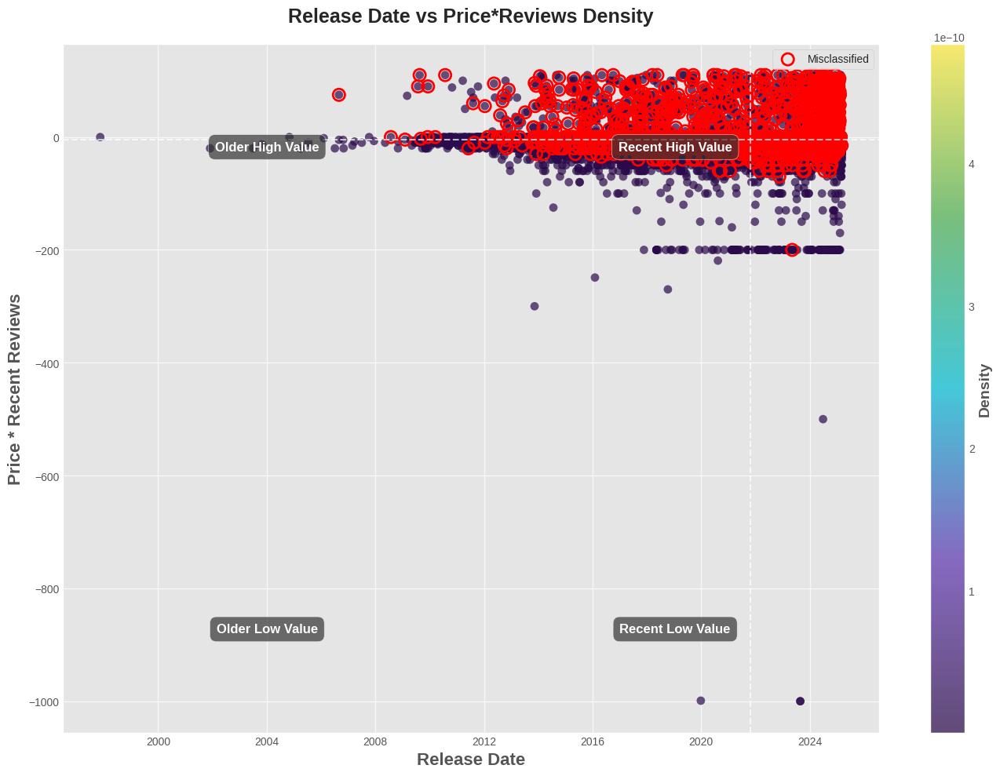

In [37]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from matplotlib.colors import LinearSegmentedColormap
import joblib
from datetime import datetime

# Set the style for better visualizations
plt.style.use('ggplot')
sns.set_palette("deep")

def log(msg):
    print(f"[{datetime.now().strftime('%H:%M:%S')}] {msg}")

def visualize_price_reviews_by_date(df):
    # Load model, features and data
    log("Loading model and data")
    model = joblib.load('market_competitor_model.pkl')
    features = joblib.load('market_competitor_features.pkl')    
    # Prepare data and make predictions
    log("Processing data")
    X = df[features].fillna(0)
    y_true = df['is_competitor']
    y_pred = model.predict(X)
    
    # Identify misclassified samples
    misclassified = (y_true != y_pred)
    df['misclassified'] = misclassified
    
    # Ensure data has needed columns
    if 'price' in df.columns and 'num_reviews_recent' in df.columns:
        df['price_reviews'] = df['price'] * df['num_reviews_recent']
    else:
        log("Error: Missing required columns")
        return
    
    df['release_date'] = pd.to_datetime(df['release_date'], errors='coerce')
    
    # Create the visualization
    log("Creating release date vs price*reviews visualization")
    create_density_plot(df)
    
    log("Visualization complete!")

def create_density_plot(df):
    # Create figure
    plt.figure(figsize=(14, 10))
    
    # Filter data for plotting
    df_filtered = df.dropna(subset=['release_date', 'price_reviews'])
    
    # Remove extreme outliers for better visualization
    q_high = np.percentile(df_filtered['price_reviews'], 95)
    plot_data = df_filtered[df_filtered['price_reviews'] <= q_high]
    
    # Create custom colormap (purple-blue-green-yellow)
    cmap = LinearSegmentedColormap.from_list(
        'density_cmap', ["#2A0A4A", "#5E35B1", "#00BCD4", "#4CAF50", "#FFEB3B"]
    )
    
    # Convert dates to numeric for density calculation
    x = plot_data['release_date'].astype(np.int64) // 10**9  # Convert to unix timestamp
    y = plot_data['price_reviews']
    
    # Calculate density
    xy = np.vstack([x, y])
    density = stats.gaussian_kde(xy)(xy)
    
    # Sort points by density
    idx = density.argsort()
    x, y, density = x.iloc[idx], y.iloc[idx], density[idx]
    dates = pd.to_datetime(x, unit='s')
    
    # Color points by density
    scatter = plt.scatter(dates, y, c=density, s=60, cmap=cmap, alpha=0.7, edgecolor='none')
    
    # Add colorbar
    cbar = plt.colorbar(scatter)
    cbar.set_label('Density', fontsize=14, fontweight='bold')
    
    # Mark misclassified points with different marker
    misclassified_data = plot_data[plot_data['misclassified']]
    if len(misclassified_data) > 0:
        plt.scatter(
            misclassified_data['release_date'], 
            misclassified_data['price_reviews'],
            s=120, facecolors='none', edgecolors='red', linewidth=2,
            marker='o', label='Misclassified'
        )
    
    # Add median reference lines
    median_date = plot_data['release_date'].median()
    median_value = plot_data['price_reviews'].median()
    plt.axhline(median_value, color='white', linestyle='--', alpha=0.7)
    plt.axvline(median_date, color='white', linestyle='--', alpha=0.7)
    
    # Add quadrant labels
    text_style = {
        'bbox': {'facecolor': '#333333', 'alpha': 0.7, 'pad': 5, 'boxstyle': 'round,pad=0.5'},
        'fontsize': 12, 'color': 'white', 'fontweight': 'bold', 'ha': 'center', 'va': 'center'
    }
    
    # Get axis limits for label placement
    date_min, date_max = plt.xlim()
    value_min, value_max = plt.ylim()
    
    # Add quadrant labels
    plt.text(date_min + 0.25 * (date_max - date_min), 
             value_min + 0.15 * (value_max - value_min), 
             'Older Low Value', **text_style)
    
    plt.text(date_max - 0.25 * (date_max - date_min), 
             value_min + 0.15 * (value_max - value_min), 
             'Recent Low Value', **text_style)
    
    plt.text(date_min + 0.25 * (date_max - date_min), 
             value_max - 0.15 * (value_max - value_min), 
             'Older High Value', **text_style)
    
    plt.text(date_max - 0.25 * (date_max - date_min), 
             value_max - 0.15 * (value_max - value_min), 
             'Recent High Value', **text_style)
    
    # Add title and labels
    plt.title('Release Date vs Price*Reviews Density', fontsize=18, fontweight='bold', pad=20)
    plt.xlabel('Release Date', fontsize=16, fontweight='bold')
    plt.ylabel('Price * Recent Reviews', fontsize=16, fontweight='bold')
    
    # Add grid with better styling
    plt.grid(color='white', linestyle='-', linewidth=1, alpha=0.7)
    
    # Add legend if we have misclassified points
    if len(misclassified_data) > 0:
        plt.legend(loc='upper right', frameon=True, framealpha=0.9)
    
    # Save the visualization
    plt.tight_layout()
    plt.savefig('release_date_price_reviews_density.png', dpi=300, bbox_inches='tight')

if __name__ == "__main__":
    print("=" * 70)
    print("RELEASE DATE vs PRICE*REVIEWS DENSITY VISUALIZATION")
    print("=" * 70)
    visualize_price_reviews_by_date(df)